# CLASSIFICATION USING SPATIO-TEMPORAL DNNs

### Deep Learning

### Miguel Ángel Fernández Torres
### IMAGE AND SIGNAL PROCESSING GROUP, UNIVERSITAT DE VALÈNCIA




1. INTRODUCTION AND OBJECTIVES

2. DATABASE

> 2.1 DATASET: TRAINING SUBSET

> 2.2 DATALOADER: TRAINING SUBSET

> 2.3 VISUALIZATION

> 2.4 STANDARDIZATION USING THE TRAINING SUBSET

3. LONG SHORT-TERM MEMORY (LSTM) NETWORKS

> 3.1 DATASET AND DATALOADER: TRAINING, VALIDATION AND TEST SUBSET

> 3.2 NEURAL NETWORK DEFINITION

> 3.3 TRAINING LOOOP AND EXECUTION

4. CONVOLUTIONAL NEURAL NETWORK (CNN) + LSTM

> 4.1 DATASET AND DATALOADER: TRAINING, VALIDATION AND TEST SUBSET

> 4.2 NEURAL NETWORK DEFINITION

> 4.3 TRAINING LOOOP AND EXECUTION

#### Mount Google Drive

In [26]:
# # Load the Drive helper and mount
# from google.colab import drive

# # This will prompt for authorization.
# drive.mount('/content/drive')

# # Change to assignment directory ('DL4ES/Lab Sessions/LS4_RNNs_3DCONVs' by default)
# import os
# os.chdir('/content/drive/My Drive/ISP-UV/DL4ES_2023/Lab Sessions/LS4_RNNs_3DCONVs')

#### Required libraries for the lab session

In [1]:
# Json
import json
# Os
import os
# Datetime
from datetime import datetime

# Numpy
import numpy  as np

# Matplotlib
import matplotlib.pyplot as plt
plt.style.use('default')
import matplotlib.colors as mcolors

# Geopandas
# !pip install geopandas
import geopandas as gpd
import pandas as pd

# Itertools
import itertools

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F  # useful stateless functions
import torch.optim as optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import sampler
# torchvision
import torchvision.transforms as T

# PASTIS database
# Classes
PASTIS_classes = ["0: Background","1: Meadow","2: Soft winter wheat","3: Corn",
  "4: Winter barley","5: Winter rapeseed","6: Spring barley","7: Sunflower",
  "8: Grapevine","9: Beet","10: Winter triticale","11: Winter durum wheat",
  "12: Fruits,  vegetables, flowers","13: Potatoes","14: Leguminous fodder",
  "15: Soybeans","16: Orchard","17: Mixed cereal","18: Sorghum","19: Void label"]
# Colormap
PASTIS_colormap = mcolors.ListedColormap(np.array(((0, 0, 0),
                                                (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
                                                (1.0, 0.4980392156862745, 0.054901960784313725),
                                                (1.0, 0.7333333333333333, 0.47058823529411764),
                                                (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
                                                (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
                                                (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
                                                (1.0, 0.596078431372549, 0.5882352941176471),
                                                (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
                                                (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
                                                (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
                                                (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
                                                (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
                                                (0.9686274509803922, 0.7137254901960784, 0.8235294117647058),
                                                (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
                                                (0.7803921568627451, 0.7803921568627451, 0.7803921568627451),
                                                (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
                                                (0.8588235294117647, 0.8588235294117647, 0.5529411764705883),
                                                (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
                                                (1, 1, 1))))

---
## 1. INTRODUCTION AND OBJECTIVES
---

This lab session makes an introduction to the use of spatio-temporal DNNs (LSTM and CNN+LSTM) for pixel-level image classification, also known as semantic segmentation.

For that purpose, we will make use of the [PyTorch](https://pytorch.org/) open source machine learning framework. PyTorch is a system for executing dynamic computational graphs over Tensor objects that behave similarly as numpy ndarray. It comes with a powerful automatic differentiation engine that removes the need for manual back-propagation.


---
## 2. DATABASE
---

A short version of the recently introduced [PASTIS database](https://arxiv.org/abs/2107.07933) for semantic segmentation of agricultural parcels from satellite time series will be used.

This short version of the dataset is composed of 300 square 128×128 patches (200 training patches, 50 validation patches and 50 test patches) within the French metropolitan territory with 10 spectral bands and at 10m resolution, obtained from the open-access Sentinel-2 platform. For each patch, all available acquisitions between
September 2018 and November 2019 are stacked, forming a four dimensional multi-spectral Satellite Image Time Series (SITS): T × C × H × W. Indeed, each patch is a Sentinel-2 multispectral image time series of variable lentgh: T (variable length) x 10 x 128 x 128.  

Semantic labels for each spatial location or pixel are provided. The agricultural parcels are grouped into 18 different crop classes as shown in the table below. The backgroud class corresponds to non-agricultural land, and the void label for parcels that are mostly outside their patch. It should be noted that the number of parcels indicated corresponds to the full version of the database and not to the short one used in this lab session.

![PASTIS_classes](https://github.com/VSainteuf/pastis-benchmark/blob/main/images/Nomenclature.png?raw=true)

The objective will be to classify each pixel in these patches according to the class they belong to. Therefore, we will solve a multi-class classification problem with 20 classes.

Additional information about the dataset can be found [here](https://github.com/VSainteuf/pastis-benchmark/blob/main/documentation/pastis-documentation.pdf).

To access the data through Google Drive follow the following steps:



*   Open the following link: https://drive.google.com/drive/folders/1RXs0CgcceG6YYfxYzDMwmqUqrK1riCf9?usp=sharing
*   Click on 'PASTIS_DL4ES' in the header and choose 'Organize' --> 'Add shortcut'
*   Out of the listed options add to 'My Drive' or the folder used for the lab session



---
#### 2.1 DATASET: TRAINING SUBSET
---

First, we load the PASTIS dataset. For that purpose, we will make use of an adapted version of the Dataset function provided by the authors, which is defined here below. For more information about Dataset class in PyTorch, see the library documentation [here](https://pytorch.org/docs/stable/data.html#torch.utils.data.Dataset).

In [2]:
class PASTIS_DL4ES_Dataset(Dataset):
    def __init__(
        self,
        folder='./PASTIS_DL4ES',
        norm=True,
        norm_mean=None,
        norm_std=None,
        folds=None,
        reference_date="2018-09-01",
        class_mapping=None,
        mono_date=None,
        nn_type='3d',
        mode='test',
        num_training_samples=128,
    ):
        """
        Pytorch Dataset class to load samples from the PASTIS dataset, for semantic and
        panoptic segmentation.

        The Dataset yields (data, dates, target), where:
            - data contains the image time series
            - dates contains the date sequence of the observations expressed in number
              of days since a reference date
            - target is the semantic target, containing the class of each pixel

        Args:
            folder (str): Path to the dataset
            norm (bool): If true, images are standardised using norm_mean and norm_std
            norm_mean (list, optional): Channel-wise means, pre-computed using
                the training set.
            norm_std (list, optional): Channel-wise standard deviations, pre-computed
                using the training set.
            reference_date (str, Format : 'YYYY-MM-DD'): Defines the reference date
                based on which all observation dates are expressed. Along with the image
                time series and the target tensor, this dataloader yields the sequence
                of observation dates (in terms of number of days since the reference
                date). This sequence of dates is used for instance for the positional
                encoding in attention based approaches.
            folds (list, optional): List of ints specifying which of the 3
                folds to load. By default (when None is specified) all folds are loaded.
            class_mapping (dict, optional): Dictionary to define a mapping between the
                default 20 class nomenclature and another class grouping, optional.
            mono_date (int or str, optional): If provided only one date of the
                available time series is loaded. If argument is a string equal to 'all',
                all available time steps are used independently. If it is an int it defines the
                position of the date that is loaded. If it is a string, it should be
                in format 'YYYY-MM-DD' and the closest available date will be selected.
            nn_type (str, '1d', '2d' or '3d'; optional): Dataset mode, to be defined depending on the
                type of neural network used ('1d' for pixel-wise, '2d' for spatial,
                '3d_dense' for spatio-temporal dense, '3d_cnn_lstm' for spatio-temporal
                CNN + LSTM, '3d' for spatio-temporal 3D-CNN).
            mode (str, 'train' or 'test'; optional): Dataset sampling mode, depending on if it is used
                during a training or a test/evaluation/inference stage. Only used if nn_type='1d'.
            num_training_samples (int, optional): Number of samples used if mode='train'.
                If model='test', all samples/pixels/spatial locations are used.
        """
        super(PASTIS_DL4ES_Dataset, self).__init__()
        self.nn_type = nn_type
        self.mode = mode
        self.num_training_samples = num_training_samples
        self.folder = folder
        self.norm = norm
        self.reference_date = datetime(*map(int, reference_date.split("-")))
        self.mono_date = (
            datetime(*map(int, mono_date.split("-")))
            if isinstance(mono_date, str) and mono_date!='all'
            else mono_date
        )
        self.class_mapping = (
            np.vectorize(lambda x: class_mapping[x])
            if class_mapping is not None
            else class_mapping
        )
        self.folds = folds
        # Get metadata
        print("Reading patch metadata . . .")
        self.meta_patch = gpd.read_file(os.path.join(folder, "metadata.dl4es.geojson"))
        self.meta_patch.index = self.meta_patch["ID_PATCH"].astype(int)
        self.meta_patch.sort_index(inplace=True)

        self.date_tables = {'S2': None}
        self.date_range = np.array(range(-200, 600))
        dates = self.meta_patch["dates-S2"]
        date_table = pd.DataFrame(
            index=self.meta_patch.index, columns=self.date_range, dtype=int
        )

        for pid, date_seq in dates.items():
            d = pd.DataFrame().from_dict(eval(date_seq), orient="index") ######################################################
            d = d[0].apply(
                lambda x: (
                    datetime(int(str(x)[:4]), int(str(x)[4:6]), int(str(x)[6:]))
                    - self.reference_date
                ).days
            )
            date_table.loc[pid, d.values] = 1
        date_table = date_table.fillna(0)
        self.date_tables['S2'] = {
            index: np.array(list(d.values()))
            for index, d in date_table.to_dict(orient="index").items()
        }

        print("Done.")

        # Select Fold samples
        if self.folds is not None:
            self.meta_patch = pd.concat(
                [self.meta_patch[self.meta_patch["Fold"] == f] for f in self.folds]
            )

        if self.mono_date == 'all':
          dates = self.meta_patch["dates-S2"]
          self.date_len = [len(date) for date in dates]
          self.len = np.sum(self.date_len)
        else:
          self.len = self.meta_patch.shape[0]
        self.id_patches = self.meta_patch.index

        # Get normalisation values
        if self.norm:
            self.norm_mean = norm_mean
            self.norm_std = norm_std
        else:
            self.norm_mean = None
            self.norm_std = None

        print("Dataset ready.")

    def __len__(self):
        return self.len

    def get_dates(self, id_patch, sat):
        return self.date_range[np.where(self.date_tables[sat][id_patch] == 1)[0]]

    def __getitem__(self, item):
        if self.mono_date == 'all':
            id_patch = self.id_patches[np.argmin(np.abs(np.cumsum(self.date_len)-item))]
            id_date = np.min(np.abs(np.cumsum(self.date_len)-item))-1
        else:
            id_patch = self.id_patches[item]

        # Retrieve and prepare satellite data
        data = np.load(os.path.join(self.folder,"DATA_S2","S2_{}.npy".format(id_patch))).astype(np.float32)
        if self.norm:
            data = (data - self.norm_mean[None, :, None, None]) / self.norm_std[None, :, None, None]

        target = np.load(os.path.join(self.folder, "ANNOTATIONS", "TARGET_{}.npy".format(id_patch)))
        target = torch.from_numpy(target[0].astype(int))

        if self.class_mapping is not None:
            target = self.class_mapping(target)

        # Retrieve date sequences
        dates = torch.from_numpy(self.get_dates(id_patch, 'S2'))

        if self.mono_date is not None:
            if isinstance(self.mono_date, int):
                data = data[self.mono_date]
                dates = dates[self.mono_date]
            elif self.mono_date!='all':
                mono_delta = (self.mono_date - self.reference_date).days
                mono_date = (dates - mono_delta).abs().argmin()
                data = data[mono_date]
                dates = dates[mono_date]
            else:
                data = data[id_date]
                dates = dates[id_date]

        # Define item depending on dataset mode ('1d','2d','3d')
        if self.nn_type == '1d':
          # Flatten data and target to be used as
          # input/output to a fully connected neural network
          if self.mode == 'train':
            # Return only num_training samples
            random_train_samples = np.random.permutation(np.shape(data)[-2]*np.shape(data)[-1])
            random_train_samples = random_train_samples[:self.num_training_samples]
            data = np.reshape(data,(np.shape(data)[0],-1))
            data = data[:,random_train_samples]
            data = np.transpose(data) # channels last
            target = np.reshape(target,(np.shape(target)[0]*np.shape(target)[1]))
            target = target[random_train_samples]
            target = np.transpose(target) # channels last
          else:
            data = np.transpose(data,(1,2,0)) # channels last
        elif self.nn_type == '3d_dense':
          if self.mode == 'train':
            # Return only num_training samples
            random_train_samples = np.random.permutation(np.shape(data)[-2]*np.shape(data)[-1])
            random_train_samples = random_train_samples[:self.num_training_samples]
            data = np.reshape(data,(np.shape(data)[0],np.shape(data)[1],-1))
            data = data[:,:,random_train_samples]
            data = np.transpose(data,(2,0,1)) # channels last
            target = np.reshape(target,(np.shape(target)[0]*np.shape(target)[1]))
            target = target[random_train_samples]
          else:
            data = np.transpose(data,(2,3,0,1)) # channels last
        elif self.nn_type == '3d_cnn_lstm':
            pass
        elif self.nn_type == '3d':
            data = np.transpose(data,(1,0,2,3)) # channels first

        return data, dates, target

def prepare_dates(date_dict, reference_date):
    """Date formating."""
    d = pd.DataFrame().from_dict(date_dict, orient="index")
    d = d[0].apply(
        lambda x: (
            datetime(int(str(x)[:4]), int(str(x)[4:6]), int(str(x)[6:]))
            - reference_date
        ).days
    )
    return d.values

---
#### [EXERCISE 1]
---
Execute the following lines of code in order to define the PASTIS training (folds=[1]) subset, still without considering normalization (norm=False), to perform pixel-level image classification using a spatio-temporal deep neural network (mode='3d').

Before executing the lines of code, have a look at the definition of the __getitem__ function for a spatio-temporal deep neural network.

In [3]:
PASTIS_train = PASTIS_DL4ES_Dataset(folder='PASTIS_DL4ES',
                                    norm=False,
                                    folds=[1],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d')

Reading patch metadata . . .
Done.
Dataset ready.


---
#### 2.2 DATALOADER: TRAINING SUBSET
---

Then, we will define a DataLoader to make use of the PASTIS training subset. For more information about DataLoader class in PyTorch and its attributes, see the library documentation [here](https://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader).

---
#### [EXERCISE 2]
---
Execute the following lines of code in order to define the PASTIS training data loader. Use batch_size=1.

In [4]:
batch_size = 1

PASTIS_train_dataloader = DataLoader(PASTIS_train, batch_size=batch_size, shuffle=True)

---
#### 2.3 VISUALIZATION
---

---
#### [EXERCISE 3]
---
Visualize a batch of images/patches from the training set.

For that purpose, use the subplot command from Matplotlib library to visualize all the input channels corresponding to the patch in a batch (`batch_size=1`, defined above). The number of timesteps per batch (variable) and the number of input channels (`num_channels=10`) are taken into account to define the subplot.

Use a second subplot to visualize the target associated to the patch in the batch.

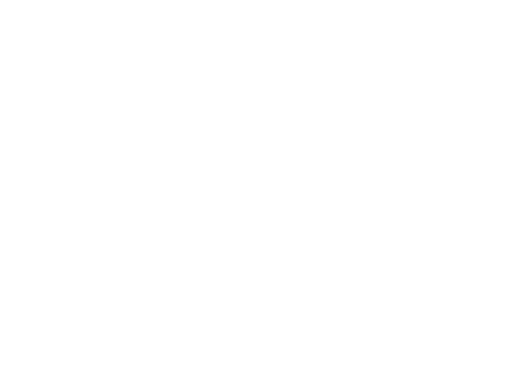

<Figure size 640x480 with 0 Axes>

In [5]:
# Get a batch of training images
data, dates, target = next(iter(PASTIS_train_dataloader))

##############################################################
# Show data using subplot from Matplotlib.
# Each timestep is a row, each channel (num_channels=10) is a column
num_channels = 10
num_timesteps = np.shape(data)[2]

plt.figure()
for i in np.arange(num_timesteps):
  for j in np.arange(num_channels):
    plt.subplot(num_timesteps,num_channels,num_channels*i+j+1)
    # - - - WRITE YOUR CODE HERE - - -
    # ...
    # - - - - - - - - - - - - - - - - -
    plt.axis('off')
plt.show()

# Show target using subplot from Matplotlib
plt.figure()
# - - - WRITE YOUR CODE HERE - - -
# ... Hint: Use cmap=PASTIS_colormap to preserve database code
# - - - - - - - - - - - - - - - - -
plt.show()

#
##############################################################

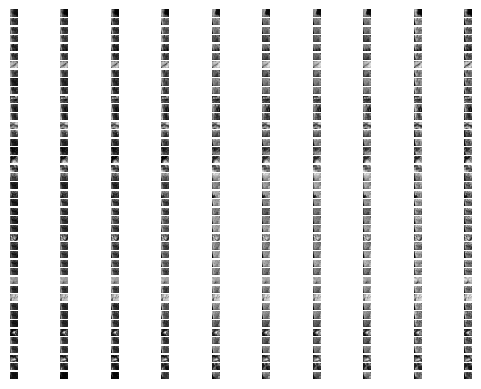

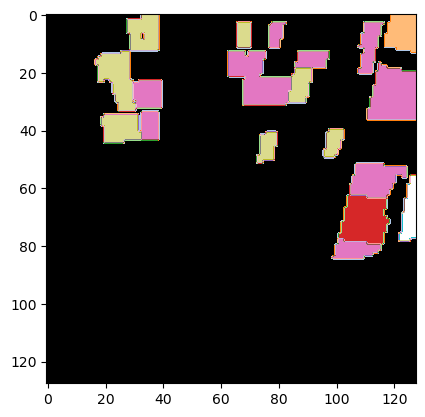

In [6]:
# Get a batch of training images
data, dates, target = next(iter(PASTIS_train_dataloader))

##############################################################
# - - - WRITE YOUR CODE HERE - - -
# Show data using subplot from Matplotlib.
# Each timestep is a row, each channel (num_channels=10) is a column
num_channels = 10
num_timesteps = np.shape(data)[2]

plt.figure()
for i in np.arange(num_timesteps):
  for j in np.arange(num_channels):
    plt.subplot(num_timesteps,num_channels,num_channels*i+j+1)
    plt.imshow(data[0][j][i,:,:].numpy(),cmap='gray')
    plt.axis('off')
plt.show()

# Show targets using subplot from Matplotlib
# sqrt(batch_size) rows and cols
plt.figure()
for i in np.arange(batch_size):
    plt.subplot(int(np.sqrt(batch_size)),int(np.sqrt(batch_size)),i+1)
    plt.imshow(target[i].numpy(),cmap=PASTIS_colormap)
plt.show()

#
##############################################################

---
#### 2.4 STANDARDIZATION USING THE TRAINING SUBSET
---

Given the defined training subset, we will compute the channel-wise mean and standard deviation statistics, in order to normalize the input data (training, validation and test subsets) before being introduced to the NN architecture.

---
#### [EXERCISE 4]
---

Complete the following lines of code to compute the mean and standard deviation of the training subset.

In [7]:
num_channels = 10

norm_mean_aux = np.zeros(num_channels)
norm_std_aux = np.zeros(num_channels)
norm_counts = 0

for t, (data,dates,target) in enumerate(PASTIS_train_dataloader):
  # data -> batch_size x T x C x H x W
  # norm_mean_aux += ...
  # norm_counts += ...
  pass
# norm_mean = ...
# print('Mean:')
# print(norm_mean)

for t, (data,dates,target) in enumerate(PASTIS_train_dataloader):
  # data -> batch_size x T x C x H x W
  # norm_std_aux += ...
  pass
# norm_std = ...
# print('Std:')
# print(norm_std)

In [8]:
num_channels = 10

norm_mean_aux = np.zeros(num_channels)
norm_std_aux = np.zeros(num_channels)
norm_counts = 0

for t, (data,dates,target) in enumerate(PASTIS_train_dataloader):
  # data -> batch_size x C x T x H x W
  norm_mean_aux += np.sum(data.numpy(), axis=(0,2,3,4)) # C (channels) is dim=2
  norm_counts += np.shape(data)[0]*np.shape(data)[2]*np.shape(data)[3]*np.shape(data)[4]
norm_mean = norm_mean_aux / norm_counts
print('Mean:')
print(norm_mean)

for t, (data,dates,target) in enumerate(PASTIS_train_dataloader):
  # data -> batch_size x C x T x H x W
  norm_std_aux += np.sum(np.power(data.numpy()-np.expand_dims(norm_mean,axis=(0,2,3,4)),2), axis=(0,2,3,4)) # C (channels) is dim=2
norm_std = np.sqrt(norm_std_aux / norm_counts)
print('Std:')
print(norm_std)

Mean:
[1093.15701481 1311.43414767 1371.3420844  1712.64636241 2634.93171111
 2952.85115916 3101.58055656 3209.51660608 2376.33088922 1592.9386305 ]
Std:
[2086.78038157 2034.56963023 2109.56253017 2030.522972   1959.74364919
 1980.55737109 1994.49683215 1984.9882538  1637.25288153 1466.27415343]


In [9]:
norm_mean = np.array([1093.15701481,1311.43414767,1371.3420844,1712.64636241,2634.93171111,
 2952.85115916,3101.58055656,3209.51660608,2376.33088922,1592.9386305])
norm_std = np.array([2086.78038157,2034.56963023,2109.56253017,2030.522972,1959.74364919,
 1980.55737109,1994.49683215,1984.9882538,1637.25288153,1466.27415343])


---
## 3. LONG SHORT-TERM MEMORY (LSTM) NETWORKS
---

First we are going to deal with Recurrent Neural Networks (RNNs), in particular with Long-Short Term Memory (LSTM) units.


---
### 3.1 DATASET AND DATALOADER: TRAINING, VALIDATION AND TEST SUBSET
---

---
### [EXERCISE 5]
---

Now execute the following lines of code in order to define the normalized (norm=True) PASTIS training (folds=[1]), validation (folds=[2]) and test (folds=[3]) subsets and data loaders to perform pixel-level image classification using a spatio-temporal DNN composed of dense and long short-term memory (LSTM) layers (mode='3d_dense').

In [11]:
batch_size = 1

PASTIS_train = PASTIS_DL4ES_Dataset(folder='./PASTIS_DL4ES',
                                    norm=True,
                                    norm_mean=norm_mean,
                                    norm_std=norm_std,
                                    folds=[1],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d_dense',
                                    mode='train',
                                    num_training_samples=128)

PASTIS_train_dataloader = DataLoader(PASTIS_train, batch_size=batch_size, shuffle=True)

PASTIS_validation = PASTIS_DL4ES_Dataset(folder='./PASTIS_DL4ES',
                                    norm=True,
                                    norm_mean=norm_mean,
                                    norm_std=norm_std,
                                    folds=[2],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d_dense',
                                    mode='train',
                                    num_training_samples=128)

PASTIS_validation_dataloader = DataLoader(PASTIS_validation, batch_size=batch_size, shuffle=False)

PASTIS_test = PASTIS_DL4ES_Dataset(folder='./PASTIS_DL4ES',
                                    norm=True,
                                    norm_mean=norm_mean,
                                    norm_std=norm_std,
                                    folds=[3],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d_dense',
                                    mode='test',
                                    num_training_samples=128)

PASTIS_test_dataloader = DataLoader(PASTIS_test, batch_size=batch_size, shuffle=False)

Reading patch metadata . . .
Done.
Dataset ready.
Reading patch metadata . . .
Done.
Dataset ready.
Reading patch metadata . . .
Done.
Dataset ready.


---
### 3.2 NEURAL NETWORK DEFINITION
---

PyTorch provides the `nn.Module` API for you to define arbitrary network architectures, while tracking every learnable parameters for you. PyTorch also provides the `torch.optim` package that implements all the common optimizers, such as RMSProp, Adagrad, and Adam. You can refer to the [doc](http://pytorch.org/docs/master/optim.html) for the exact specifications of each optimizer.

To use the Module API, follow the steps below:

1. Subclass `nn.Module`. Give your network class an intuitive name like `FCNet`.

2. In the constructor `__init__()`, define all the layers you need as class attributes. Layer objects like `nn.Linear` and `nn.Conv2d` are themselves `nn.Module` subclasses and contain learnable parameters. Refer to the [doc](http://pytorch.org/docs/master/nn.html) to learn more about the dozens of builtin layers. **Warning**: don't forget to call the `super().__init__()` first!

3. In the `forward()` method, define the *connectivity* of your network. You should use the attributes defined in `__init__` as function calls that take tensor as input and output the "transformed" tensor. Do *not* create any new layers with learnable parameters in `forward()`! All of them must be declared upfront in `__init__`.

After you define your Module subclass, you can instantiate it as an object and call it.

Here is an example of a class for a 3-layer fully connected network to learn the pixel-level image classification problem stated above, which performs the forward pass on a batch of image data.

1) Read and understand the implementation.

2) Use the function 'test_FCNet' to check that the forward pass doesn't crash and produces outputs of the right shape, by running zeros through the network.

In [13]:
class FCNet(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super().__init__()
        self.input_size = input_size
        # assign layer objects to class attributes
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, int(hidden_size/2))
        self.fcout = nn.Linear(int(hidden_size/2), num_classes)

    def forward(self, x):
        # forward always defines connectivity
        x = torch.reshape(x,(-1,self.input_size)) # Reshape data (N x num_training_samples x C or N x H x W x C) to (-1,C)
        scores = self.fcout(F.relu(self.fc2(F.relu(self.fc1(x)))))
        return scores

def test_FCNet():
    input_size = 10
    x = torch.zeros((64, input_size), dtype=torch.float32)  # minibatch size 64, feature dimension 50
    model = FCNet(input_size, 42, 20)
    scores = model(x)
    print(scores.size())  # you should see [64, 20]

test_FCNet()

torch.Size([64, 20])


---
### [EXERCISE 6]
---

1) Let's modify the 3-layer fully connected neural network by replacing its first hidden layer by a [LSTM](https://pytorch.org/docs/1.9.1/generated/torch.nn.LSTM.html) one! The new version of its class will be named LSTMNet.

2) Use the function 'test_LSTMNet' to check that the forward pass doesn't crash and produces outputs of the right shape, by running zeros through the network.

In [15]:
class LSTMNet(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super().__init__()
        self.input_size = input_size
        # assign layer objects to class attributes
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, int(hidden_size/2))
        self.fcout = nn.Linear(int(hidden_size/2), num_classes)

    def forward(self, x):
        # forward always defines connectivity
        num_timesteps = np.shape(x)[-2]
        x = torch.reshape(x,(-1,num_timesteps,self.input_size)) # Reshape data (N x num_training_samples x T x C or N x H x W x T x C) to (-1,T,C)
        x, (h_n, c_n) = self.lstm(x)
        scores = self.fcout(F.relu(self.fc(x[:,-1,:])))
        return scores

def test_LSTMNet():
    input_size = 10
    num_input_timesteps = 30
    x = torch.zeros((64, num_input_timesteps, input_size), dtype=torch.float32)  # minibatch size 64, number of timesteps 30, feature dimension 50
    model = LSTMNet(input_size, 42, 20)
    scores = model(x)
    print(scores.size())  # you should see [64, 20]

test_LSTMNet()

torch.Size([64, 20])


---
### 3.3 TRAINING LOOP AND EXECUTION
---

---
### [EXERCISE 7]
---

**Training loop**

You can train the LSTMNet using a training loop like the one defined here below (including Early Stopping, together with the evaluation using the confusion matrix).

In [16]:
# Constant to control how frequently we print train loss
print_every = 100

def confusion_matrix(targets, preds, num_classes=20):
    '''
    The function computes the confusion matrix, given a vector of Ground-Truth (GT)
    labels and its corresponding vector of hard predictions provided by a
    classification model.
    Inputs:
    - targets: Vector of GT labels
    - preds: Vector of hard predictions provided by a classification model.
    - num_classes: Total number of classes considered by the classifier. The default
      value is equal to 20, which is the number of classes considered in
      PASTIS database.
    Output:
    - cm: Confusion matrix computed.
    '''
    cm = np.zeros((num_classes,num_classes)).astype('int')
    stacked = np.stack((targets, preds),axis=1)
    for p in stacked:
      tl, pl = p.tolist()
      cm[tl, pl] = cm[tl, pl] + 1
    return cm

def plot_confusion_matrix(cm, classes=PASTIS_classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    '''
    This function serves to plot the confusion matrix 'cm'.
    - cm: Confusion matrix to be plotted.
    - classes: Name of the classes considered by the classifier.
      We make use of the names for the classes in PASTIS database by default.
    - normalize: Whether to normalize the confusion matrix or not.
    - title: Title to be shown at the top of the plot.
    - cmap: Colormap to plot the confusion matrix.
    '''
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    #print(cm)
    plt.figure(figsize = (20,20))
    plt.imshow(cm, interpolation='nearest', cmap=cmap, aspect='auto')
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

def eval_model(loader, model, device = torch.device('cuda')):
    print('Checking accuracy on validation/test set')
    loss = []
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for data, dates, target in loader:
            data = data.to(device=device, dtype=torch.float32)  # move to device, e.g. GPU
            target = target.to(device=device, dtype=torch.long)
            scores = model(data)
            loss.append(F.cross_entropy(scores, torch.flatten(target)).data.cpu().numpy())
            _, preds = scores.max(1)
            num_correct += (preds == torch.flatten(target)).sum()
            num_samples += preds.size(0)
        acc = float(num_correct) / num_samples
        mean_loss = np.mean(loss)
        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        print('Loss=%.2f' % mean_loss)
    return acc, mean_loss

def eval_model_cm(loader, model, device = torch.device('cuda')):
    print('Checking accuracy on validation/test set')
    loss = []
    num_correct = 0
    num_samples = 0
    y_all = []
    preds_all = []
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for data, dates, target in loader:
            data = data.to(device=device, dtype=torch.float32)  # move to device, e.g. GPU
            target = target.to(device=device, dtype=torch.long)
            scores = model(data)
            loss.append(F.cross_entropy(scores, torch.flatten(target)).data.cpu().numpy())
            _, preds = scores.max(1)
            num_correct += (preds == torch.flatten(target)).sum()
            num_samples += preds.size(0)
            y_all.append(torch.flatten(target).cpu().numpy())
            preds_all.append(preds.data.cpu().numpy())
        acc = float(num_correct) / num_samples
        mean_loss = np.mean(loss)
        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        print('Loss=%.2f' % mean_loss)
        # compute and plot confusion matrix
        y_all = np.concatenate(y_all)
        preds_all = np.concatenate(preds_all)
        cm = confusion_matrix(y_all, preds_all, num_classes=20)
        plot_confusion_matrix(cm, classes=PASTIS_classes, normalize=True, title='Confusion matrix', cmap=plt.cm.Blues)
        #
    return acc, mean_loss, cm

def training_loop_early_stopping(model, optimizer, epochs=1, stop_epochs=5, category_weights=None, device = torch.device('cuda')):
    """
    Train a model on PASTIS database using the PyTorch Module API.

    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for

    Returns: Nothing, but prints model accuracies during training.
    """
    iter_loss_aux = []
    iter_loss_aux_val = []
    epoch_loss = []
    epoch_loss_val = []
    best_val_loss = np.inf
    stop_count = 0
    plt.figure(1)
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in range(epochs):
        for t, (data, dates, target) in enumerate(PASTIS_train_dataloader):
            model.train()  # put model to training mode
            data = data.to(device=device, dtype=torch.float32)  # move to device, e.g. GPU
            target = target.to(device=device, dtype=torch.long)

            scores = model(data)
            loss = F.cross_entropy(scores, torch.flatten(target))
            iter_loss_aux.append(loss.data.cpu().numpy())

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()

            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                acc, loss, cm = eval_model_cm(PASTIS_validation_dataloader, model)
                iter_loss_aux_val.append(loss)
                print()
        epoch_loss.append(np.mean(iter_loss_aux))
        epoch_loss_val.append(np.mean(iter_loss_aux_val))
        iter_loss_aux = []
        iter_loss_aux_val = []
        # plot loss
        plt.clf()
        plt.plot(np.arange(np.size(epoch_loss)),epoch_loss)
        plt.plot(np.arange(np.size(epoch_loss_val)),epoch_loss_val)
        plt.xlabel('Number of epochs')
        plt.ylabel('Loss')
        plt.show()
        # Early stopping
        acc, loss = eval_model(PASTIS_validation_dataloader, model)
        if loss <= best_val_loss:
          stop_count = 0
          best_val_loss = loss
          torch.save(model.state_dict(), 'best_model_weights_LSTM.pt')
        else:
          stop_count+=1
          if stop_count == stop_epochs:
            model.load_state_dict(torch.load('best_model_weights_LSTM.pt'))
            break

**Execution**

You should now use the Module API to train LSTMNet on PASTIS.

---
### [EXERCISE 8]
---

a) Use the constructor of `LSTMNet` to define the model. Indicate the input size, the number of units in the first hidden layer and the number of classes (i.e. output size).

b) We will train the model using the Adam optimizer. Define the optimizer which tracks all the learnable parameters inside `LSTMNet`.

c) Peform the training stage during 50 epochs, using an appropriate learning rate and Early Stopping.

d) Classify the test set using the best model obtained. Determine the loss and the accuracy obtained over it, and represent the confusion matrix.

e) Analyze the results obtained. According to the confusion matrix, what are the most confused classes? Do the results make sense?

Iteration 0, loss = 3.0279
Checking accuracy on validation/test set
Got 34 / 6400 correct (0.53)
Loss=3.01
Normalized confusion matrix


<Figure size 640x480 with 0 Axes>

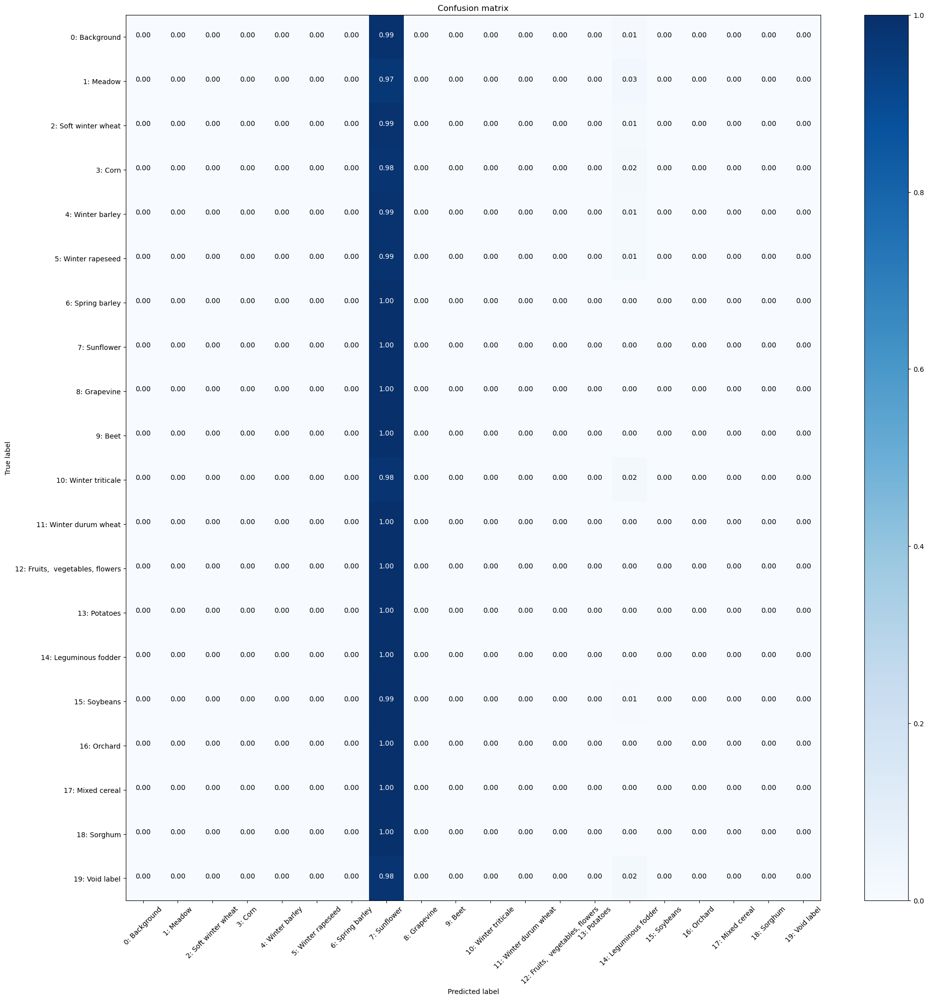


Iteration 100, loss = 1.4716
Checking accuracy on validation/test set
Got 2565 / 6400 correct (40.08)
Loss=1.99
Normalized confusion matrix


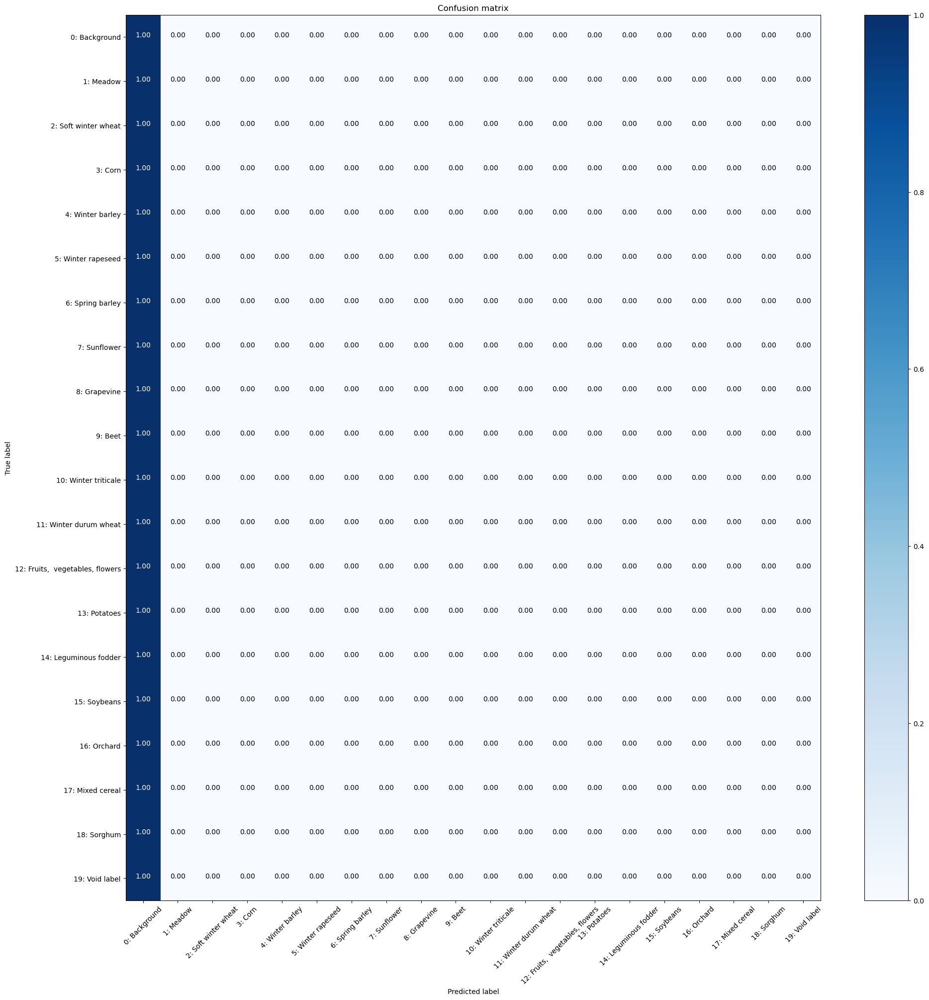

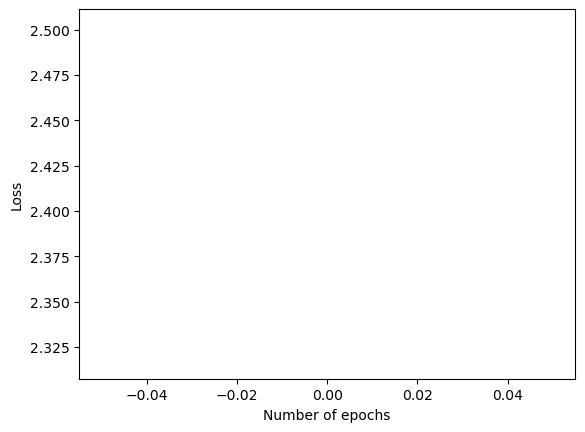

Checking accuracy on validation/test set
Got 2566 / 6400 correct (40.09)
Loss=1.94
Iteration 0, loss = 1.5413
Checking accuracy on validation/test set
Got 2580 / 6400 correct (40.31)
Loss=1.95
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


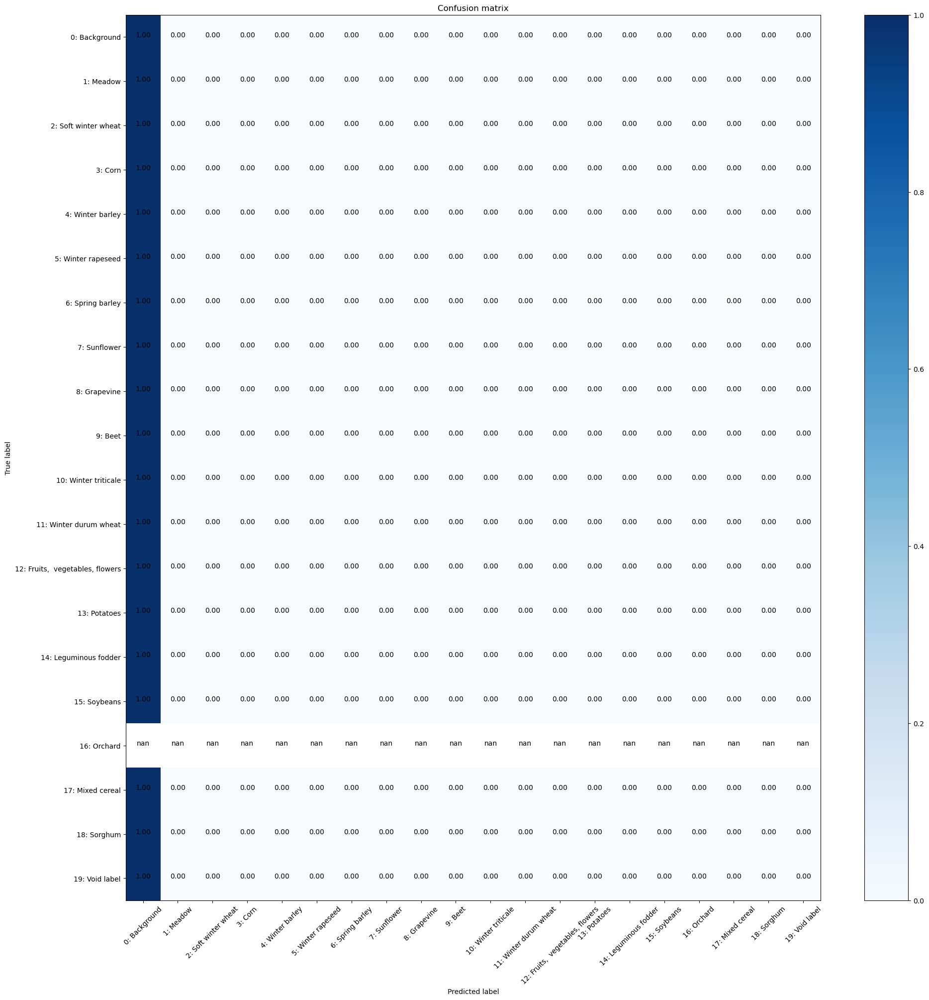


Iteration 100, loss = 2.1446
Checking accuracy on validation/test set
Got 2630 / 6400 correct (41.09)
Loss=1.85
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


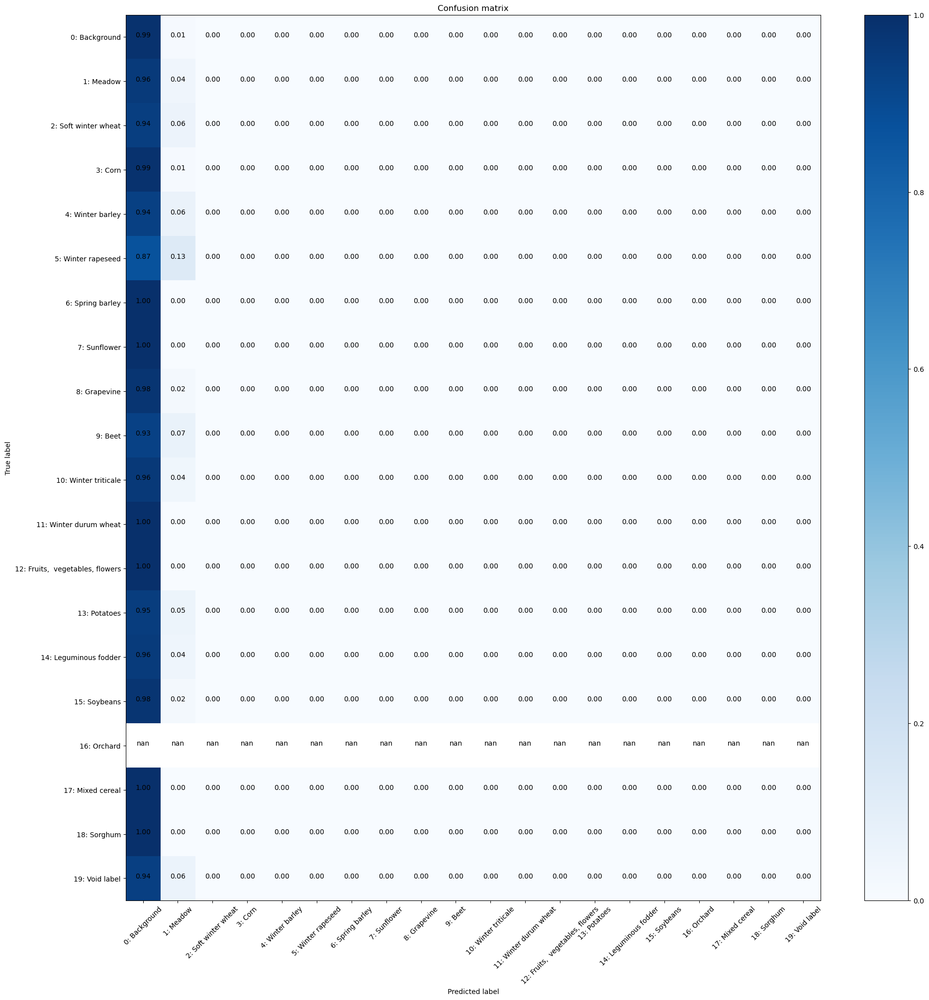

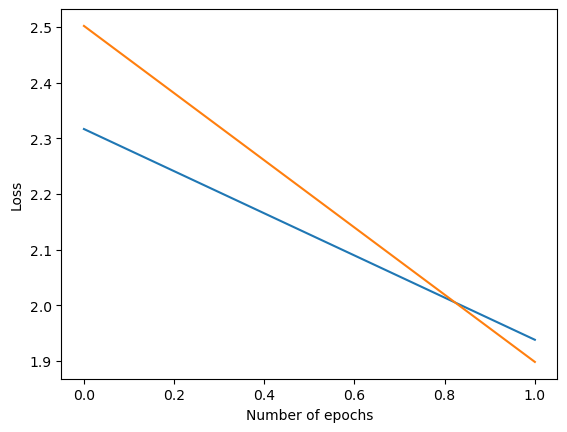

Checking accuracy on validation/test set
Got 2576 / 6400 correct (40.25)
Loss=1.86
Iteration 0, loss = 1.4945
Checking accuracy on validation/test set
Got 2595 / 6400 correct (40.55)
Loss=1.86
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


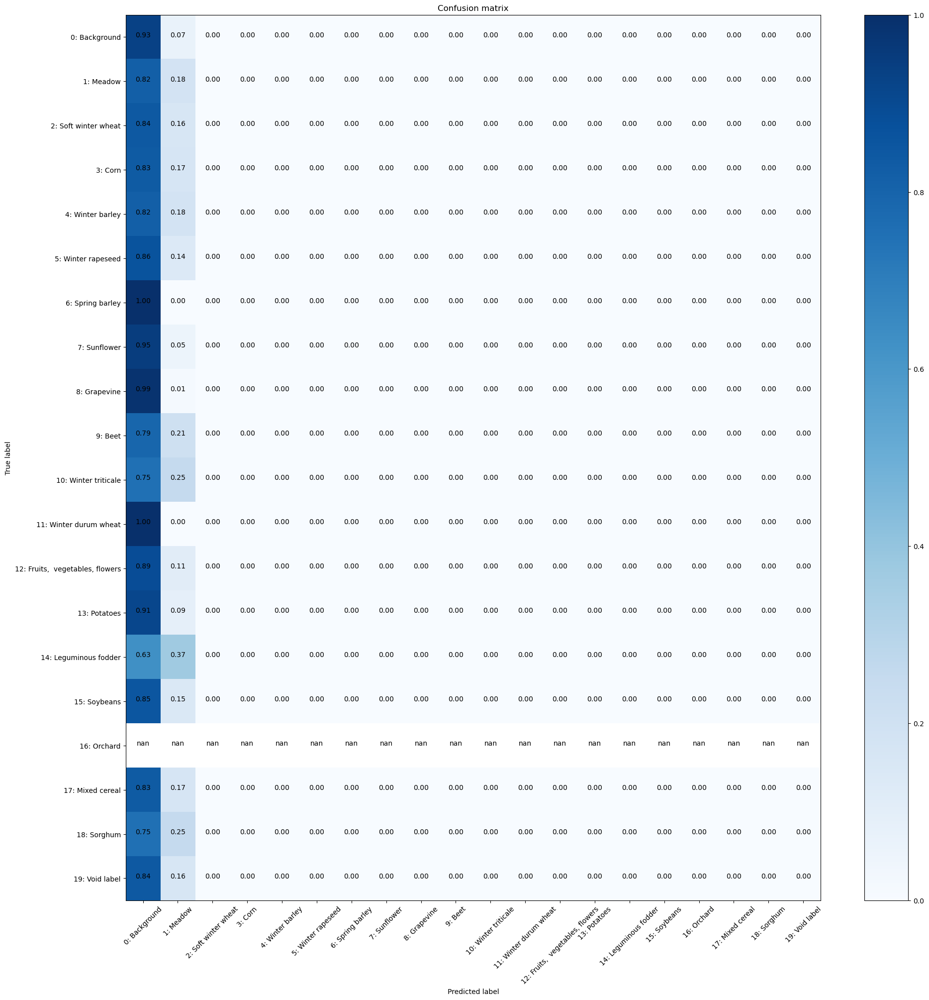


Iteration 100, loss = 1.2457
Checking accuracy on validation/test set
Got 2523 / 6400 correct (39.42)
Loss=1.80
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


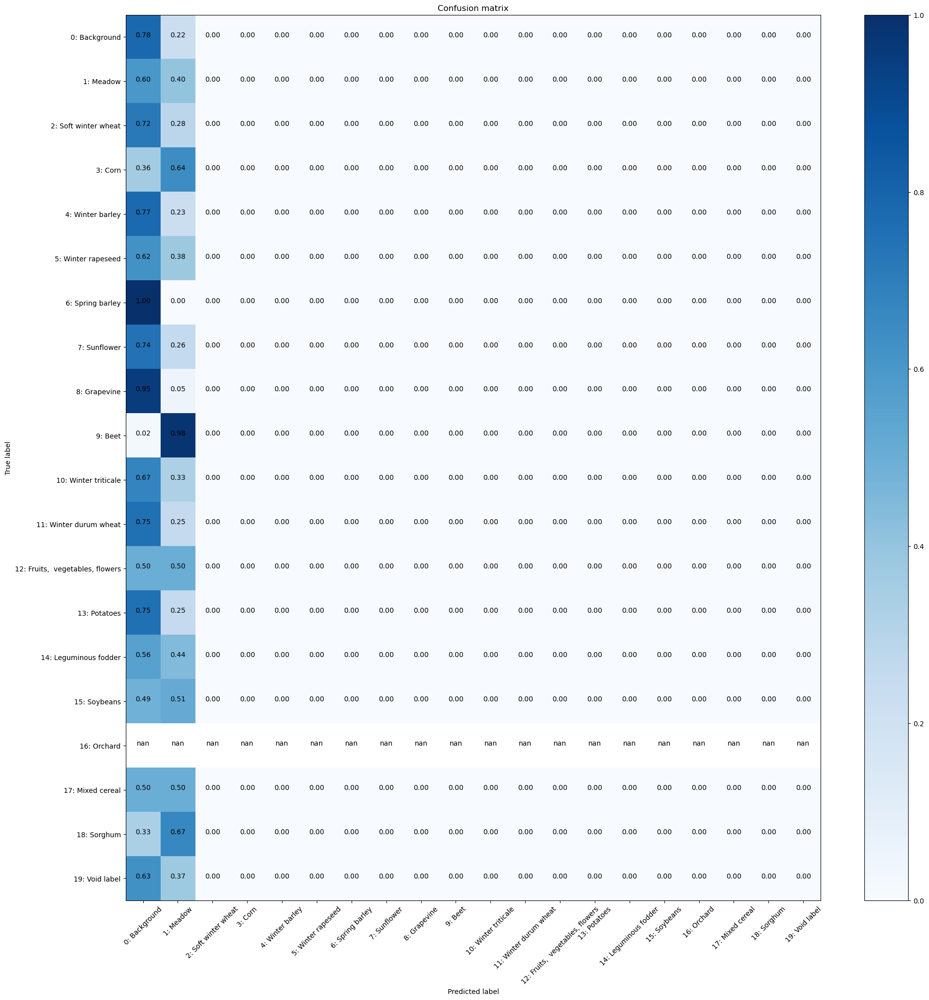

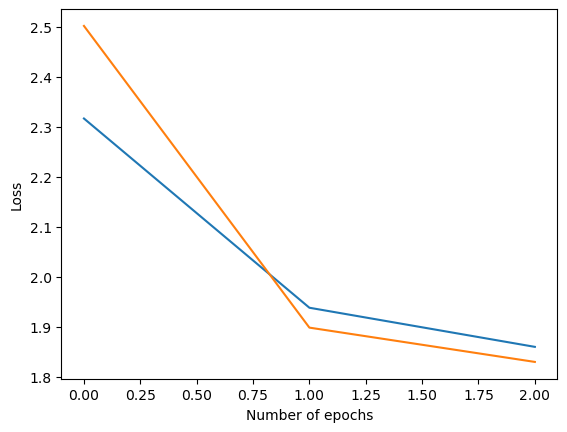

Checking accuracy on validation/test set
Got 2762 / 6400 correct (43.16)
Loss=1.77
Iteration 0, loss = 1.4302
Checking accuracy on validation/test set
Got 2751 / 6400 correct (42.98)
Loss=1.76
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


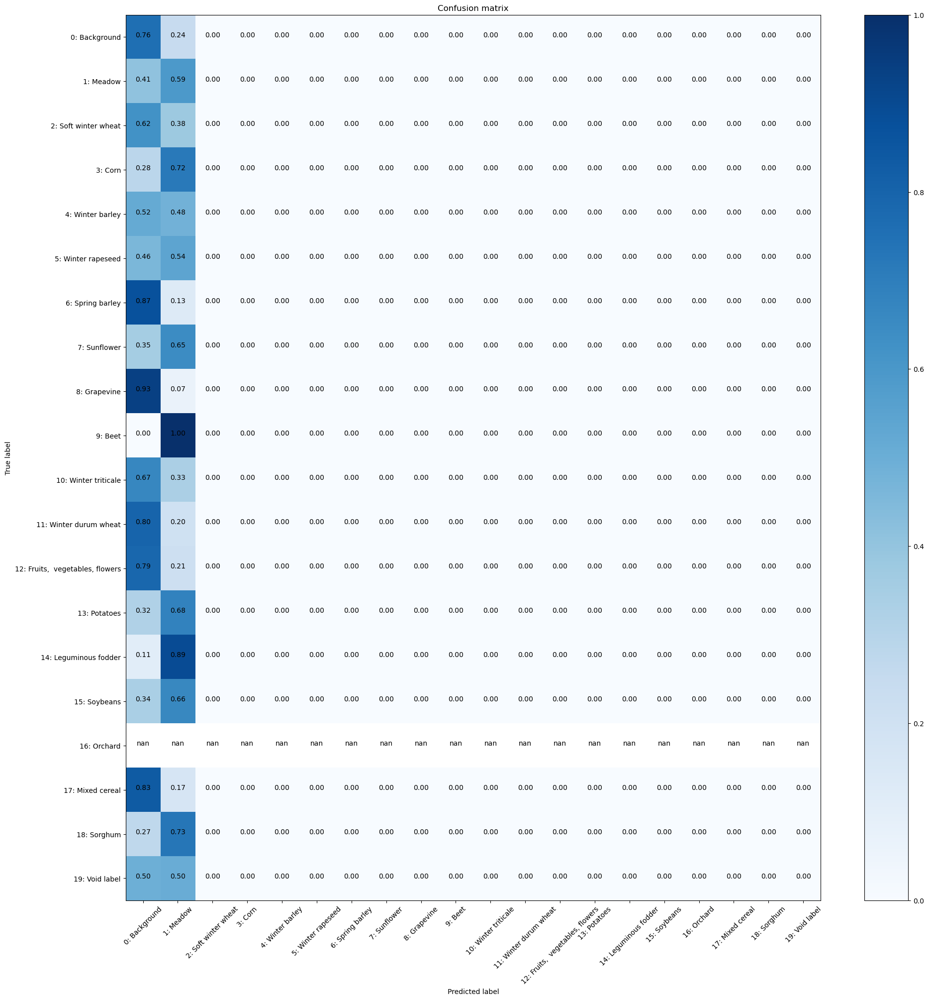


Iteration 100, loss = 2.8781
Checking accuracy on validation/test set
Got 2834 / 6400 correct (44.28)
Loss=1.75
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


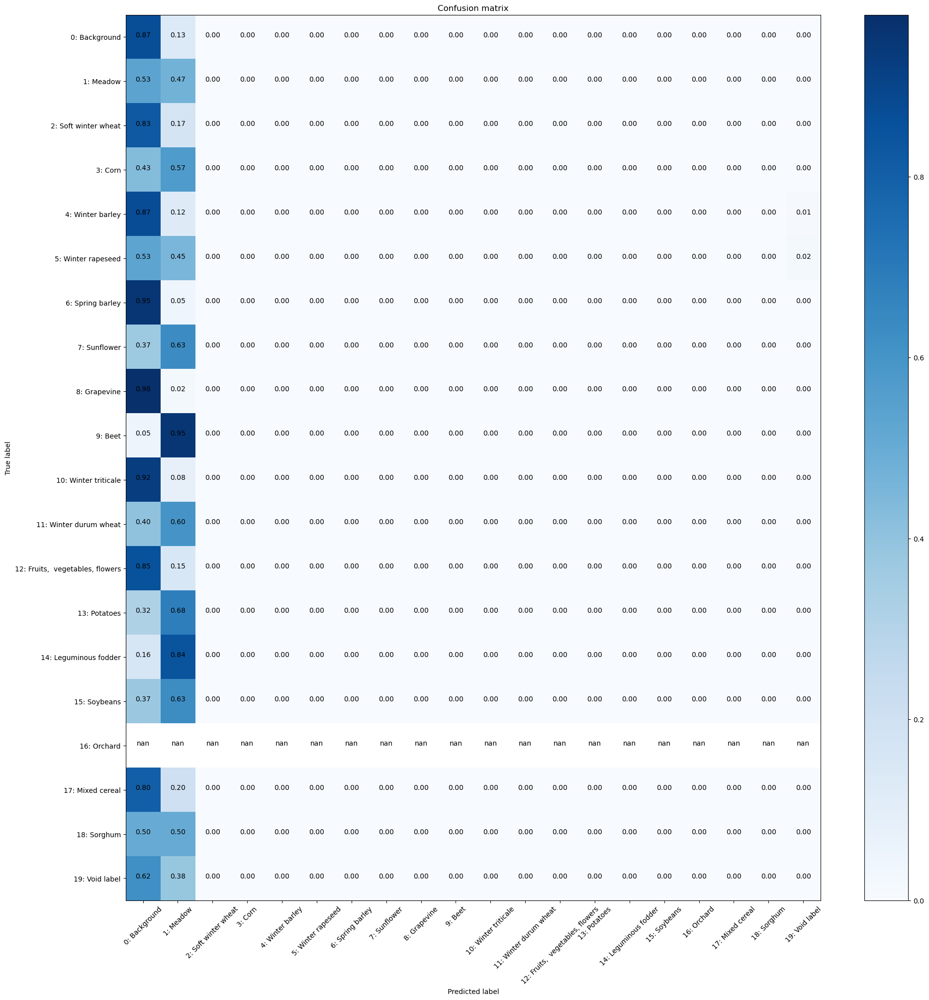

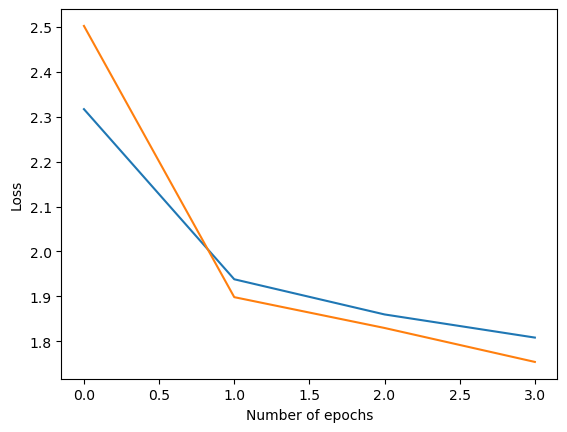

Checking accuracy on validation/test set
Got 2926 / 6400 correct (45.72)
Loss=1.67
Iteration 0, loss = 1.7272
Checking accuracy on validation/test set
Got 2993 / 6400 correct (46.77)
Loss=1.63
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


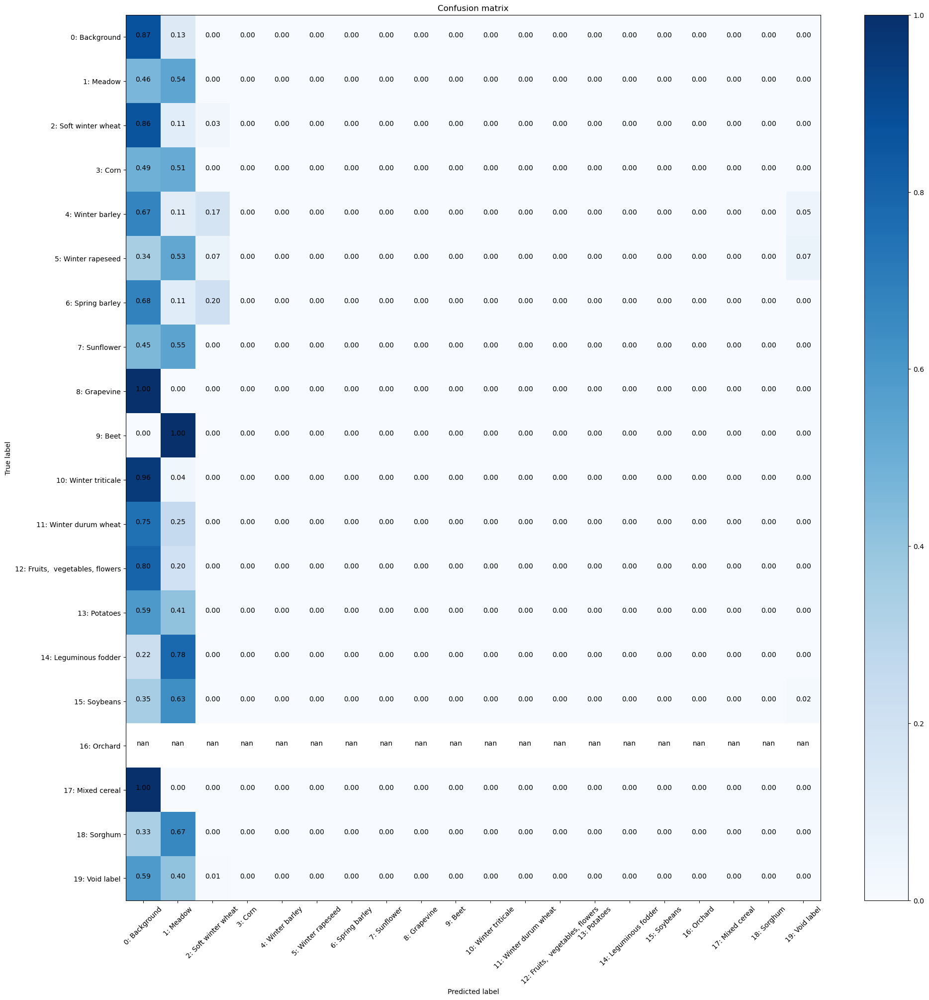


Iteration 100, loss = 3.3567
Checking accuracy on validation/test set
Got 3135 / 6400 correct (48.98)
Loss=1.63
Normalized confusion matrix


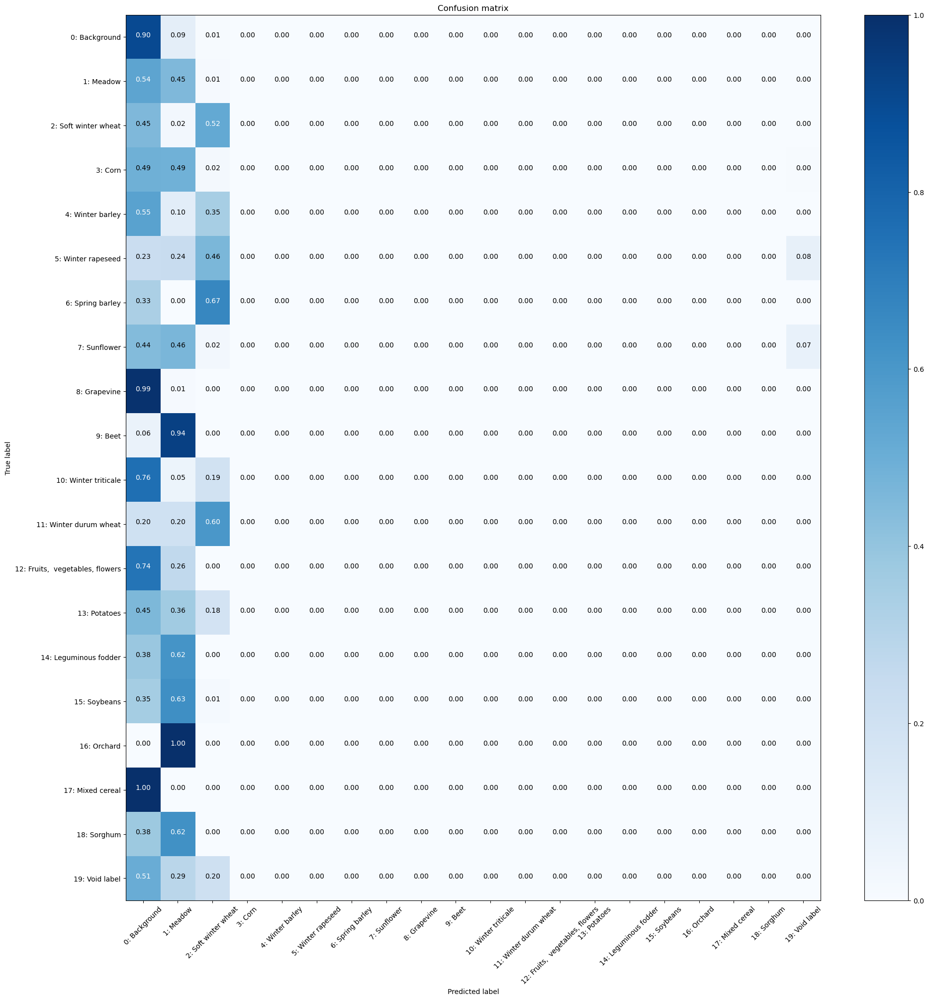

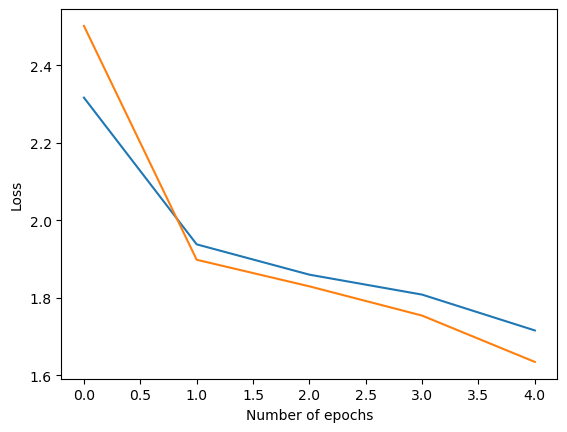

Checking accuracy on validation/test set
Got 3175 / 6400 correct (49.61)
Loss=1.53
Iteration 0, loss = 1.9999
Checking accuracy on validation/test set
Got 3149 / 6400 correct (49.20)
Loss=1.54
Normalized confusion matrix


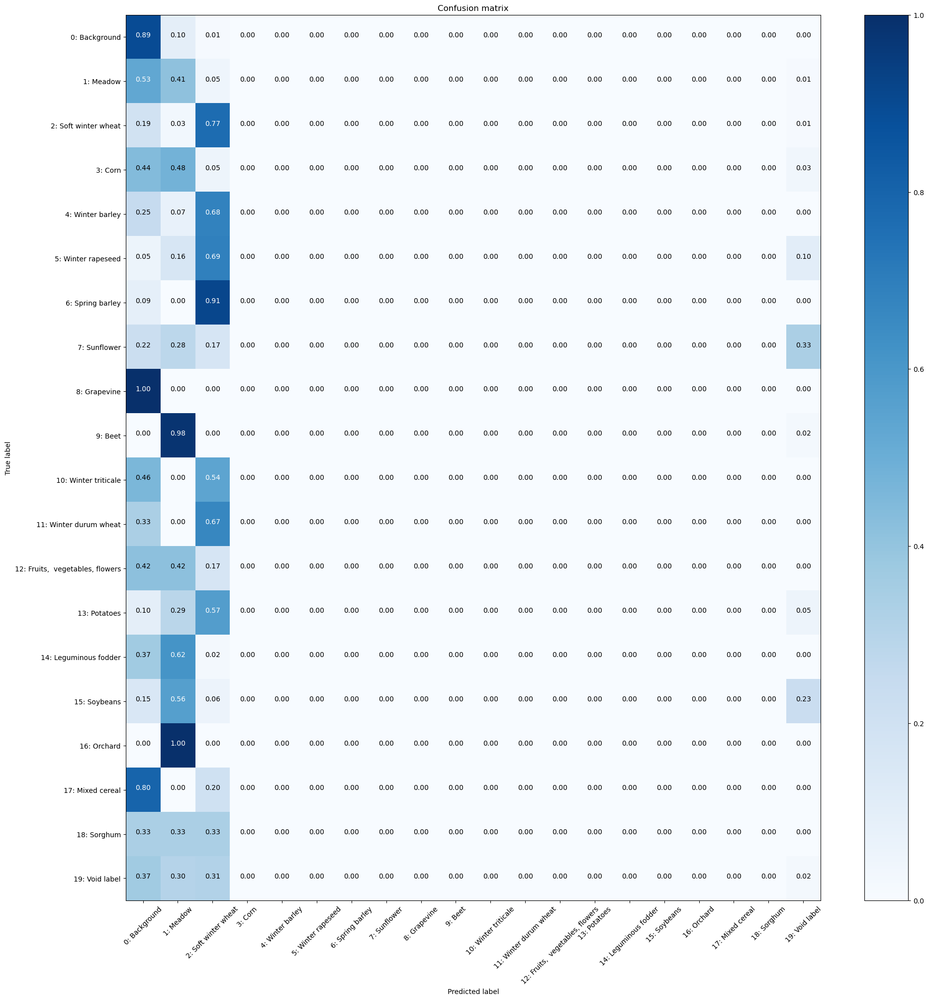


Iteration 100, loss = 0.9192
Checking accuracy on validation/test set
Got 3719 / 6400 correct (58.11)
Loss=1.48
Normalized confusion matrix


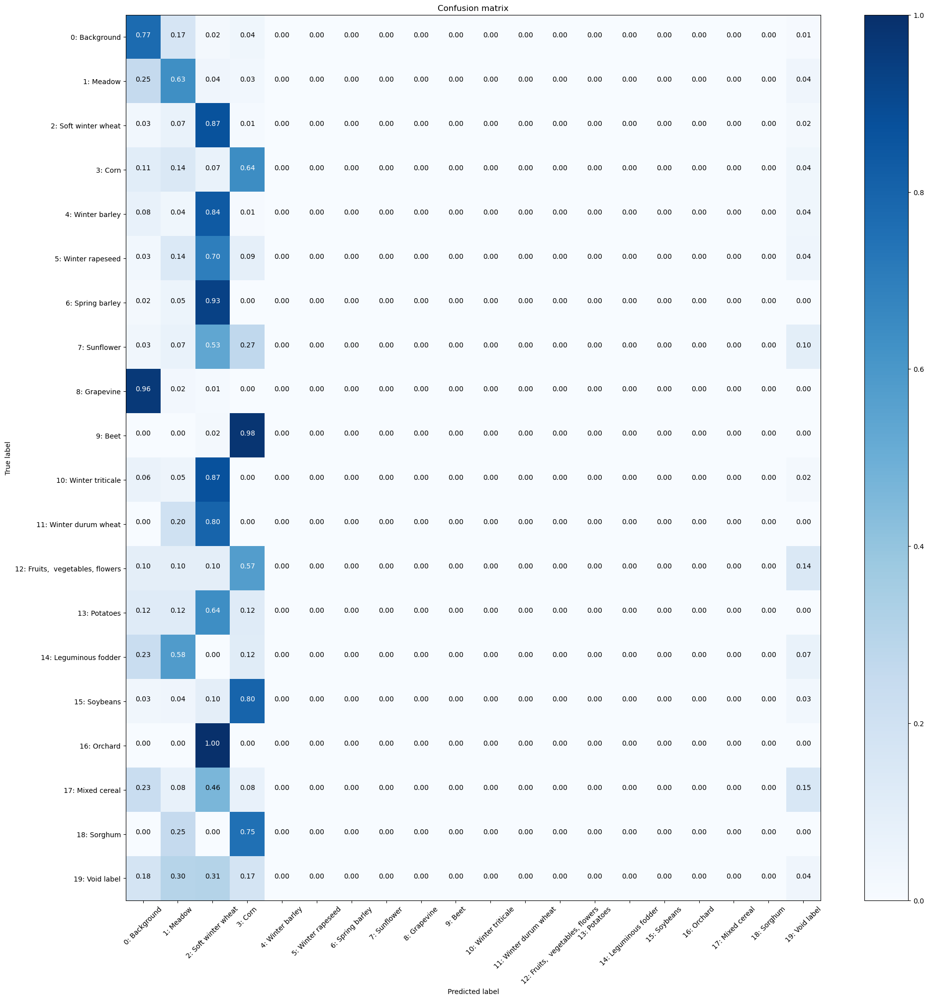

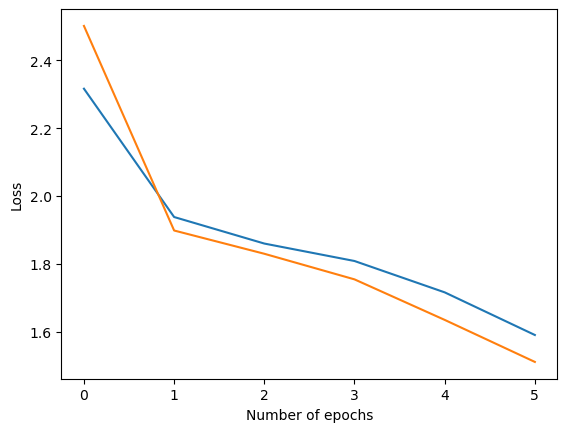

Checking accuracy on validation/test set
Got 3702 / 6400 correct (57.84)
Loss=1.39
Iteration 0, loss = 1.2518
Checking accuracy on validation/test set
Got 3657 / 6400 correct (57.14)
Loss=1.43
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


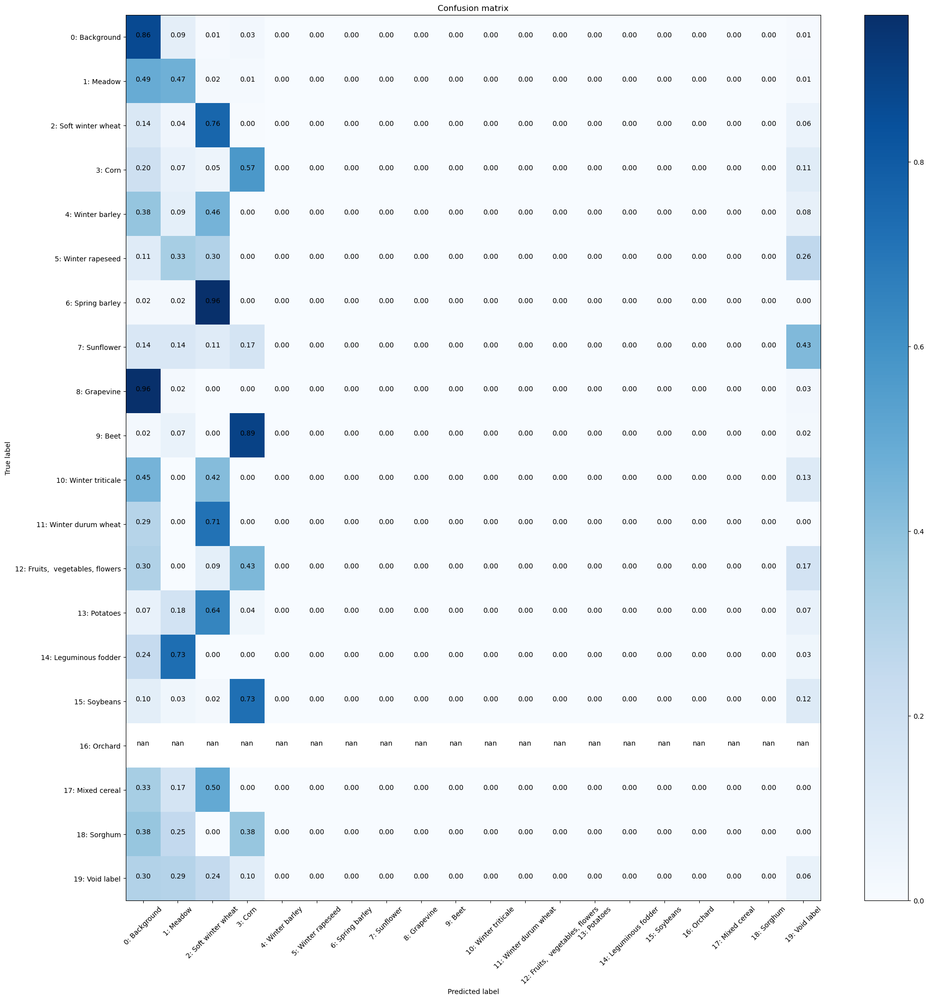


Iteration 100, loss = 1.7818
Checking accuracy on validation/test set
Got 3843 / 6400 correct (60.05)
Loss=1.31
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


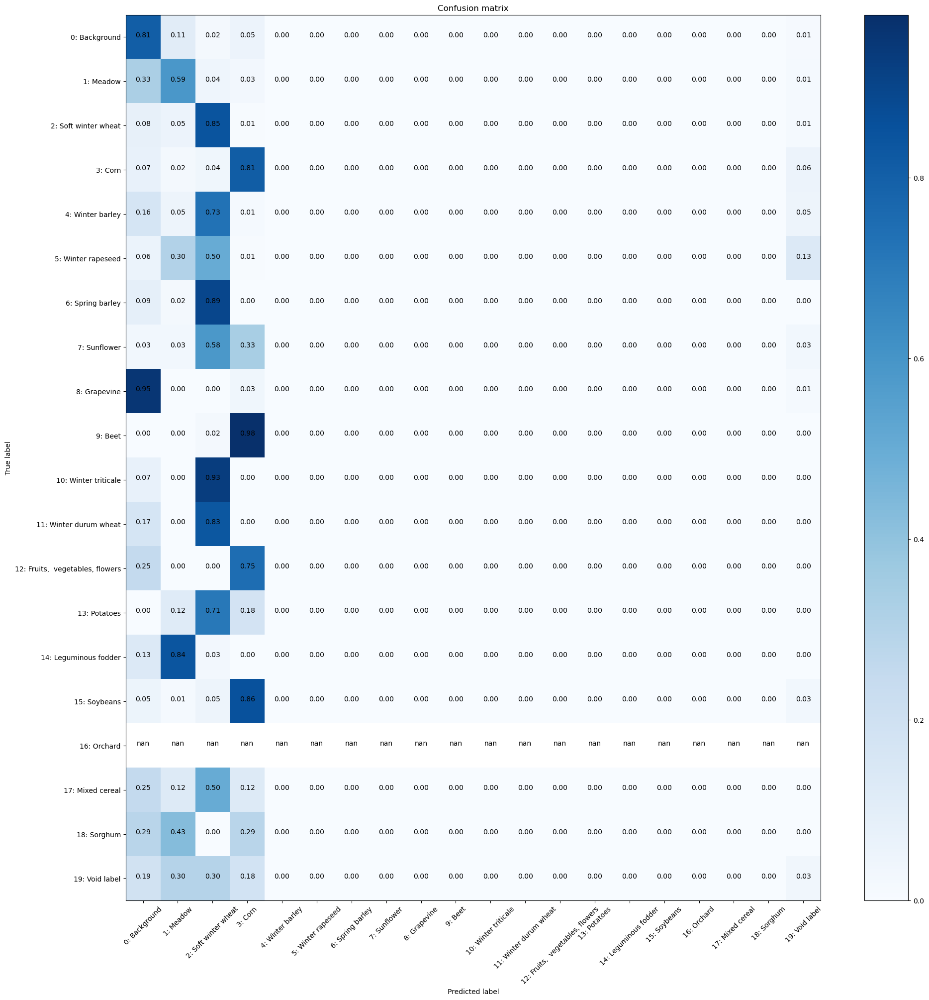

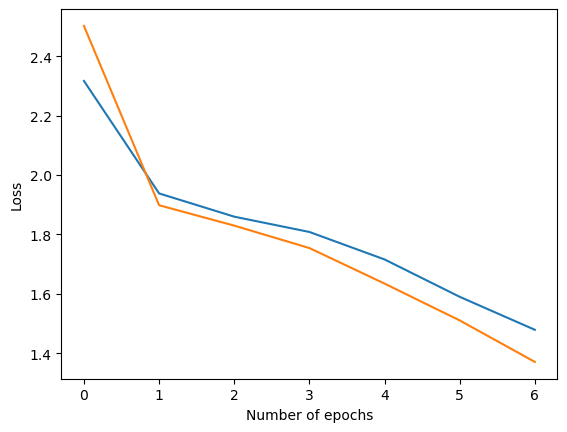

Checking accuracy on validation/test set
Got 3775 / 6400 correct (58.98)
Loss=1.34
Iteration 0, loss = 1.2078
Checking accuracy on validation/test set
Got 3798 / 6400 correct (59.34)
Loss=1.36
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


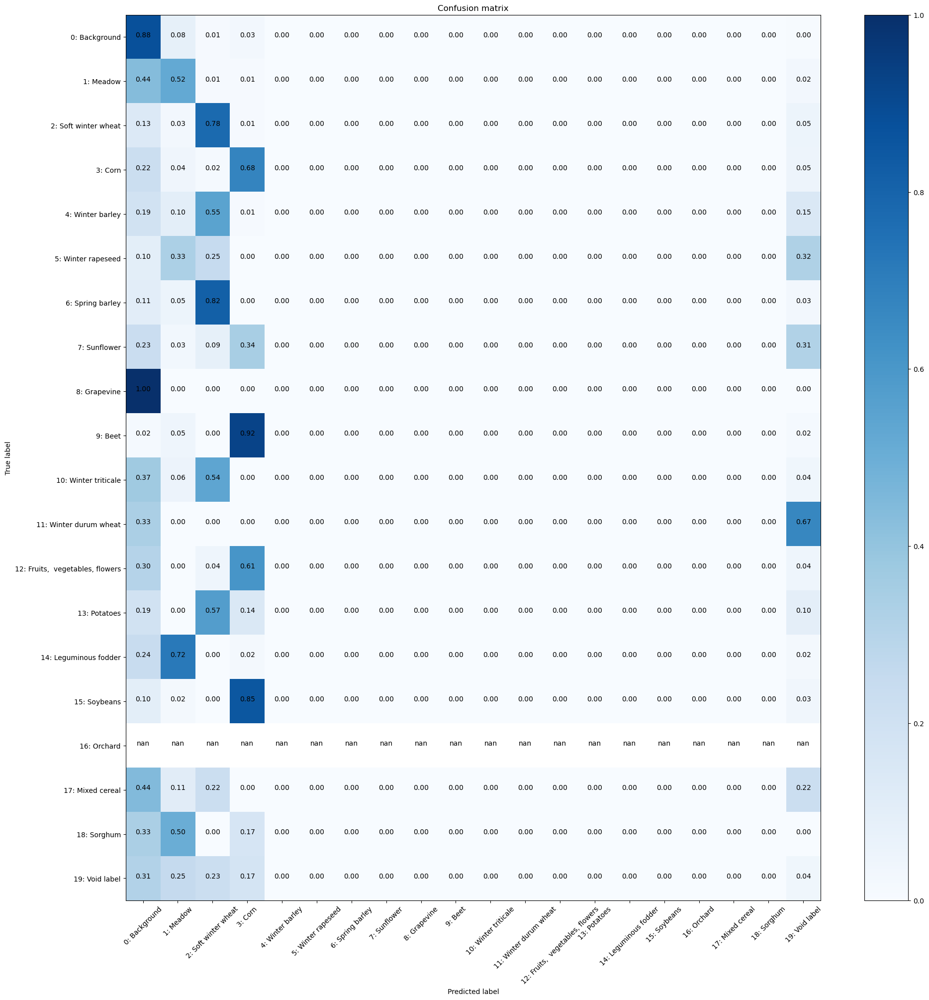


Iteration 100, loss = 1.1790
Checking accuracy on validation/test set
Got 3836 / 6400 correct (59.94)
Loss=1.29
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


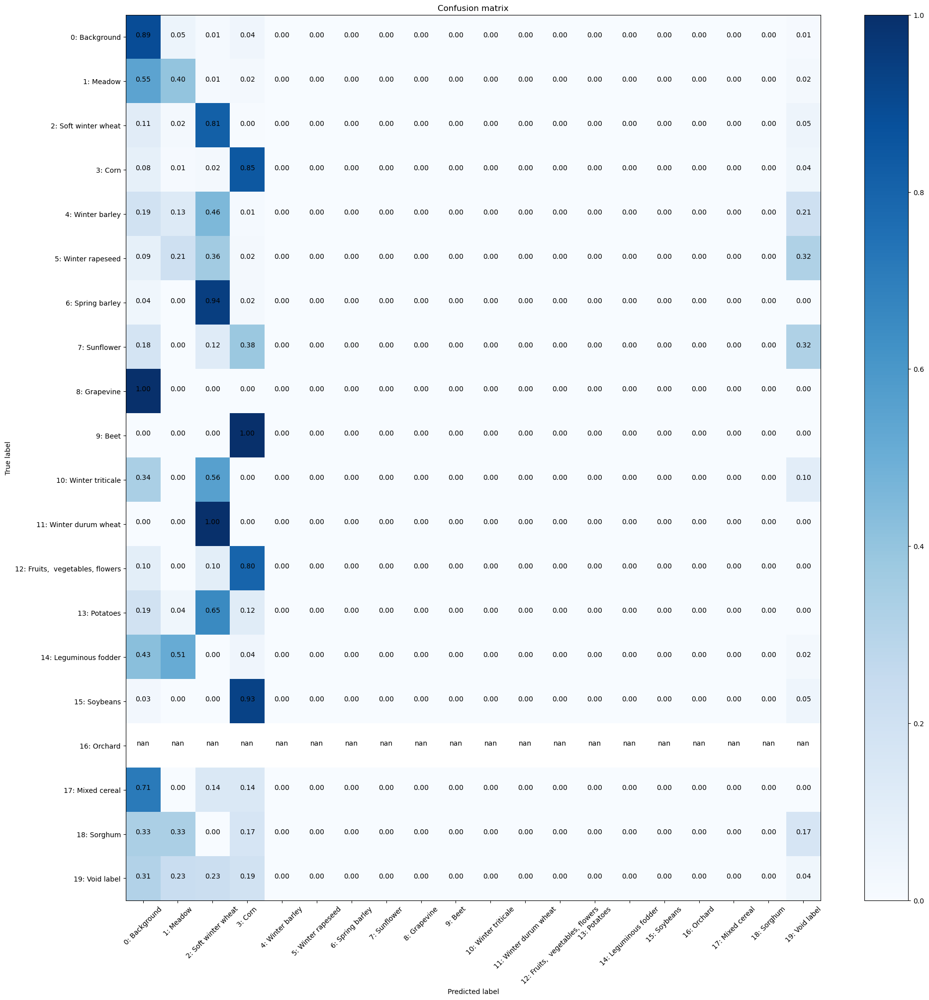

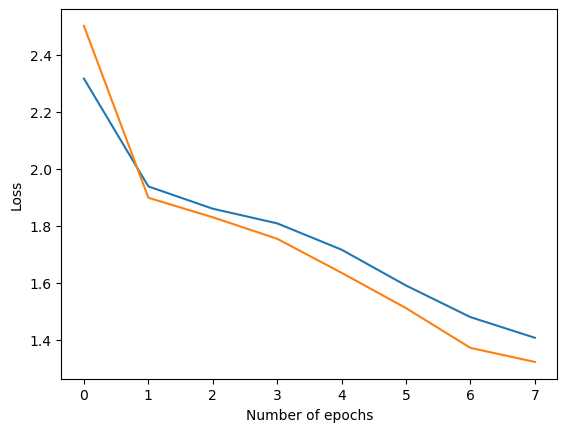

Checking accuracy on validation/test set
Got 4064 / 6400 correct (63.50)
Loss=1.19
Iteration 0, loss = 1.8215
Checking accuracy on validation/test set
Got 4109 / 6400 correct (64.20)
Loss=1.18
Normalized confusion matrix


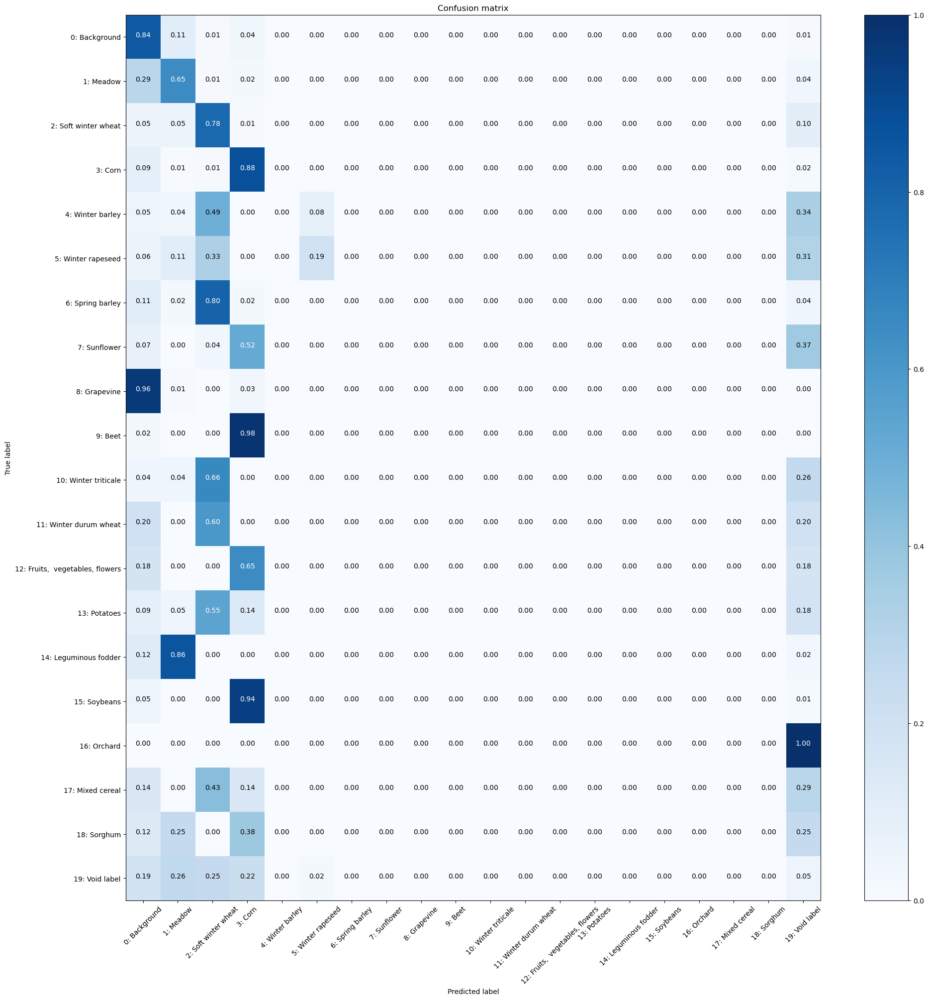


Iteration 100, loss = 1.1284
Checking accuracy on validation/test set
Got 4033 / 6400 correct (63.02)
Loss=1.23
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


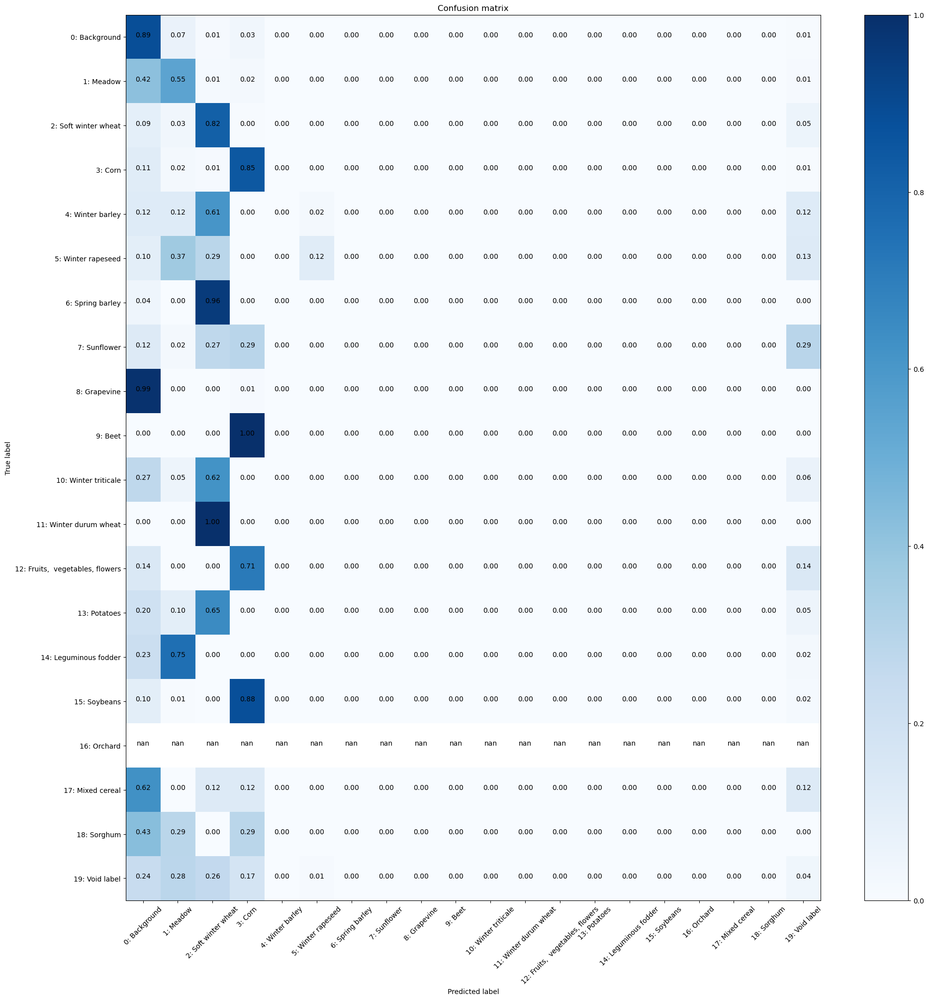

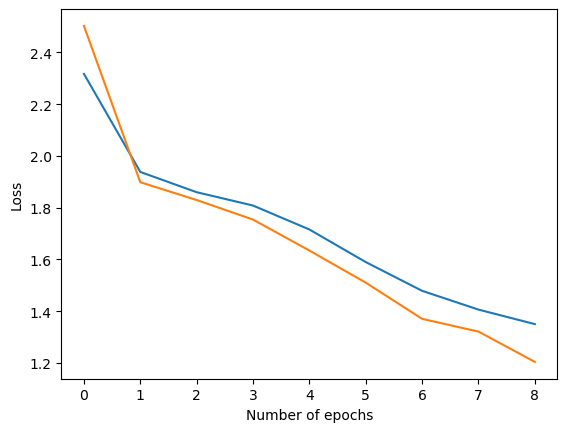

Checking accuracy on validation/test set
Got 4095 / 6400 correct (63.98)
Loss=1.19
Iteration 0, loss = 1.9045
Checking accuracy on validation/test set
Got 4081 / 6400 correct (63.77)
Loss=1.18
Normalized confusion matrix


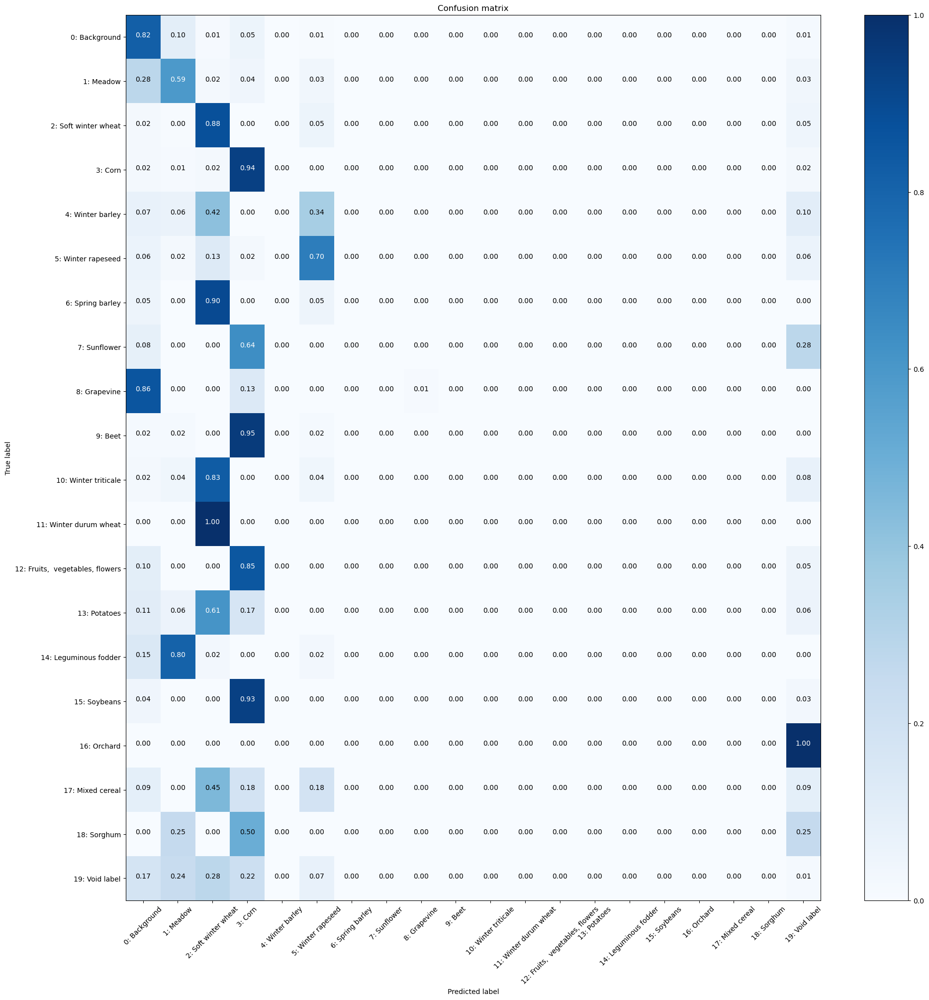


Iteration 100, loss = 1.0666
Checking accuracy on validation/test set
Got 4075 / 6400 correct (63.67)
Loss=1.15
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


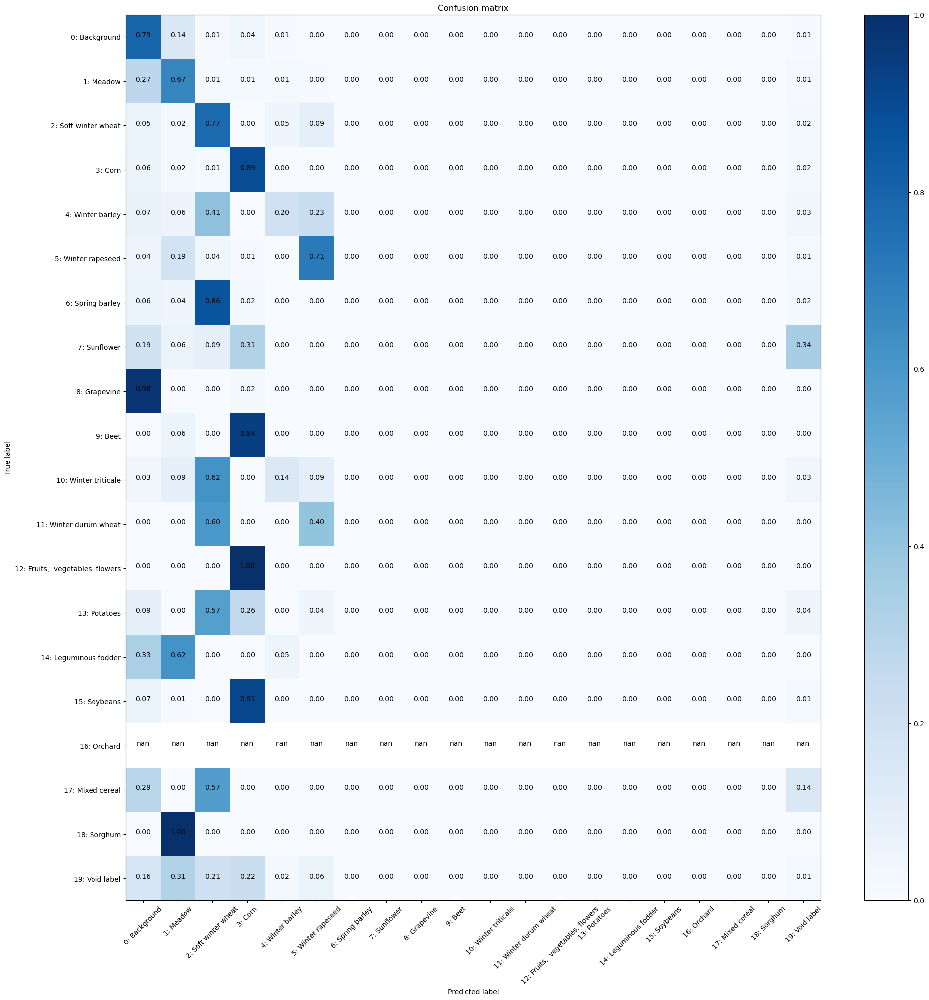

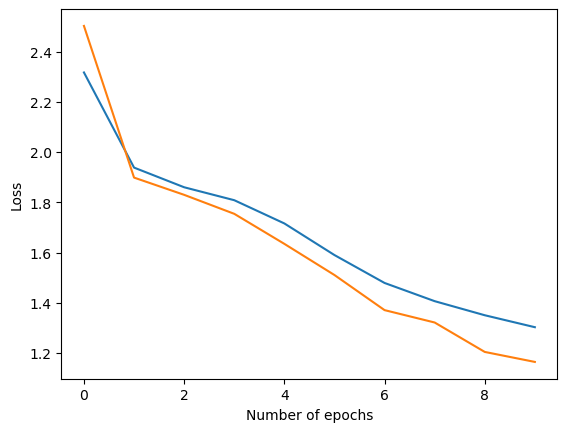

Checking accuracy on validation/test set
Got 4200 / 6400 correct (65.62)
Loss=1.10
Iteration 0, loss = 1.9166
Checking accuracy on validation/test set
Got 4171 / 6400 correct (65.17)
Loss=1.13
Normalized confusion matrix


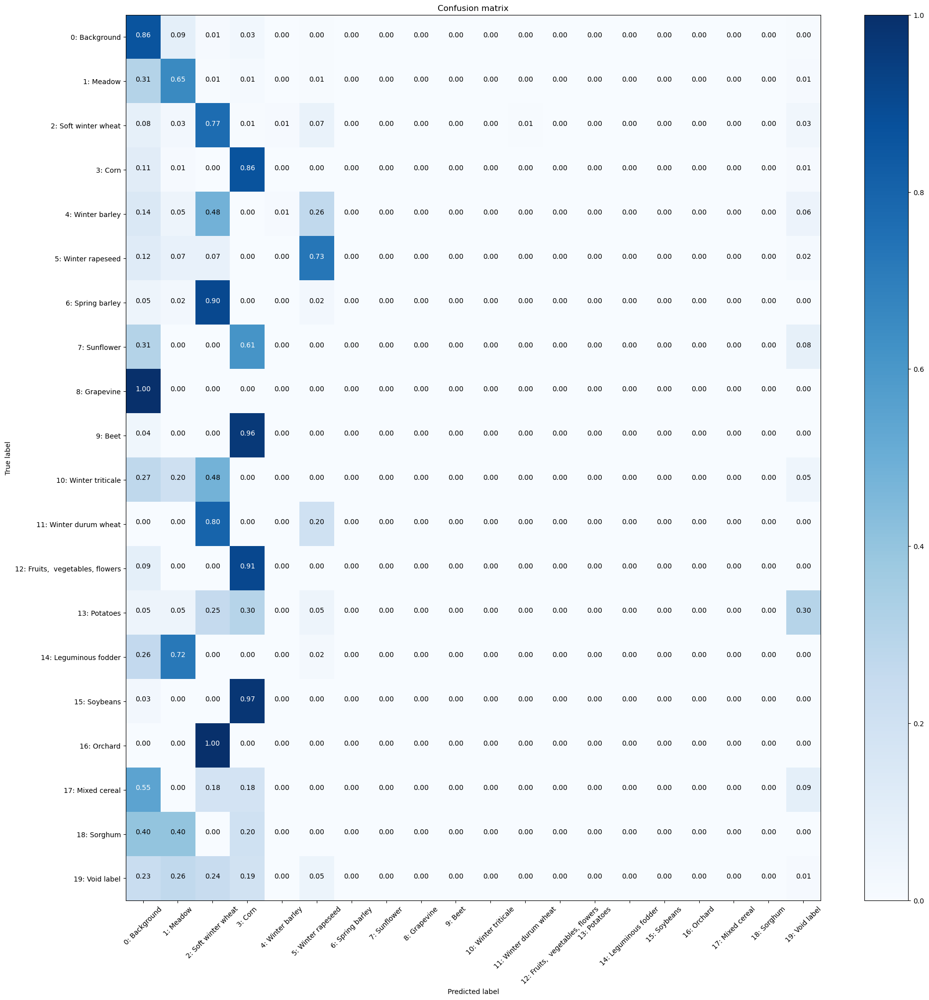


Iteration 100, loss = 1.3796
Checking accuracy on validation/test set
Got 4163 / 6400 correct (65.05)
Loss=1.15
Normalized confusion matrix


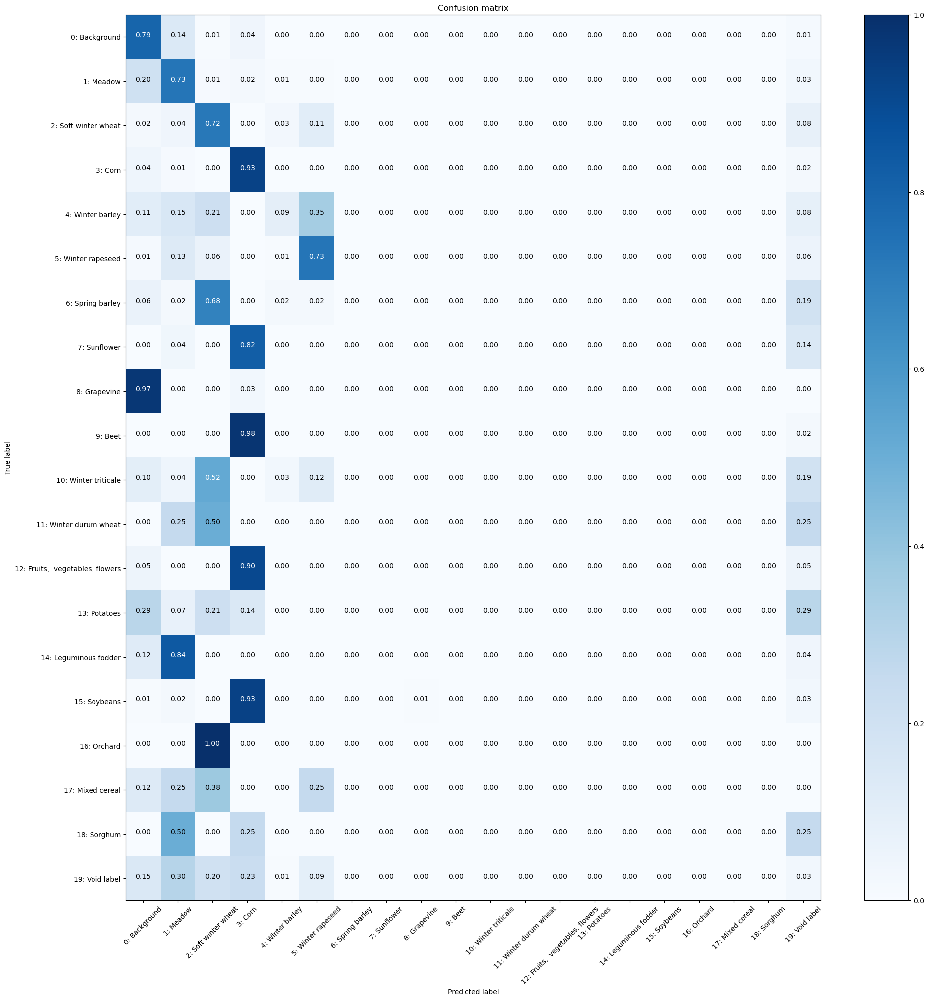

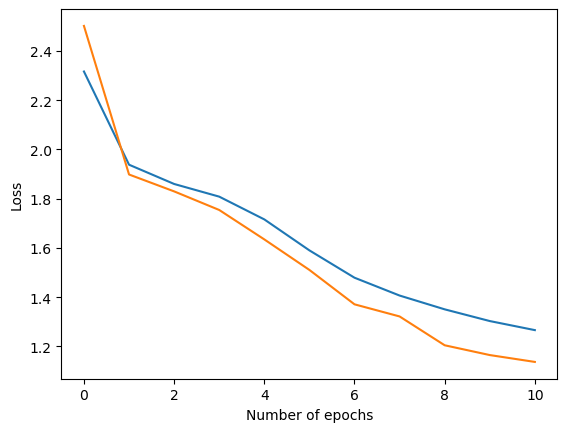

Checking accuracy on validation/test set
Got 4060 / 6400 correct (63.44)
Loss=1.18
Iteration 0, loss = 0.8915
Checking accuracy on validation/test set
Got 4050 / 6400 correct (63.28)
Loss=1.18
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


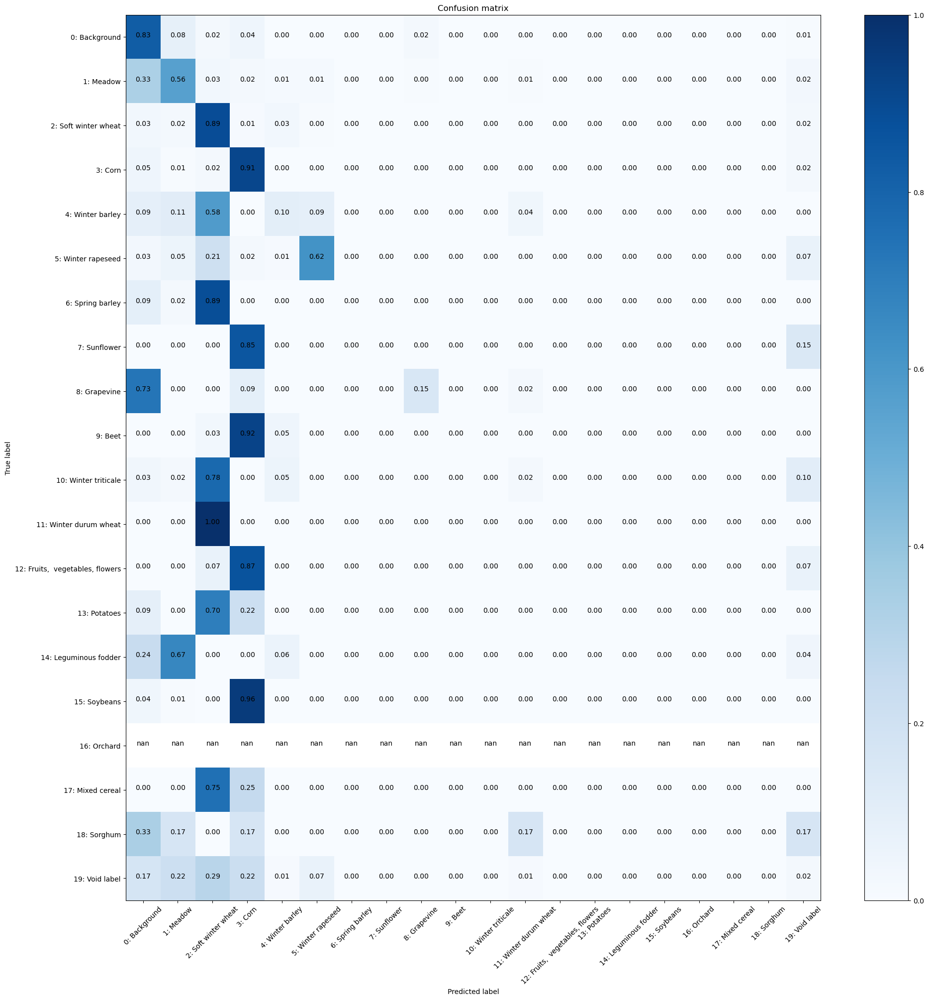


Iteration 100, loss = 1.3232
Checking accuracy on validation/test set
Got 4176 / 6400 correct (65.25)
Loss=1.10
Normalized confusion matrix


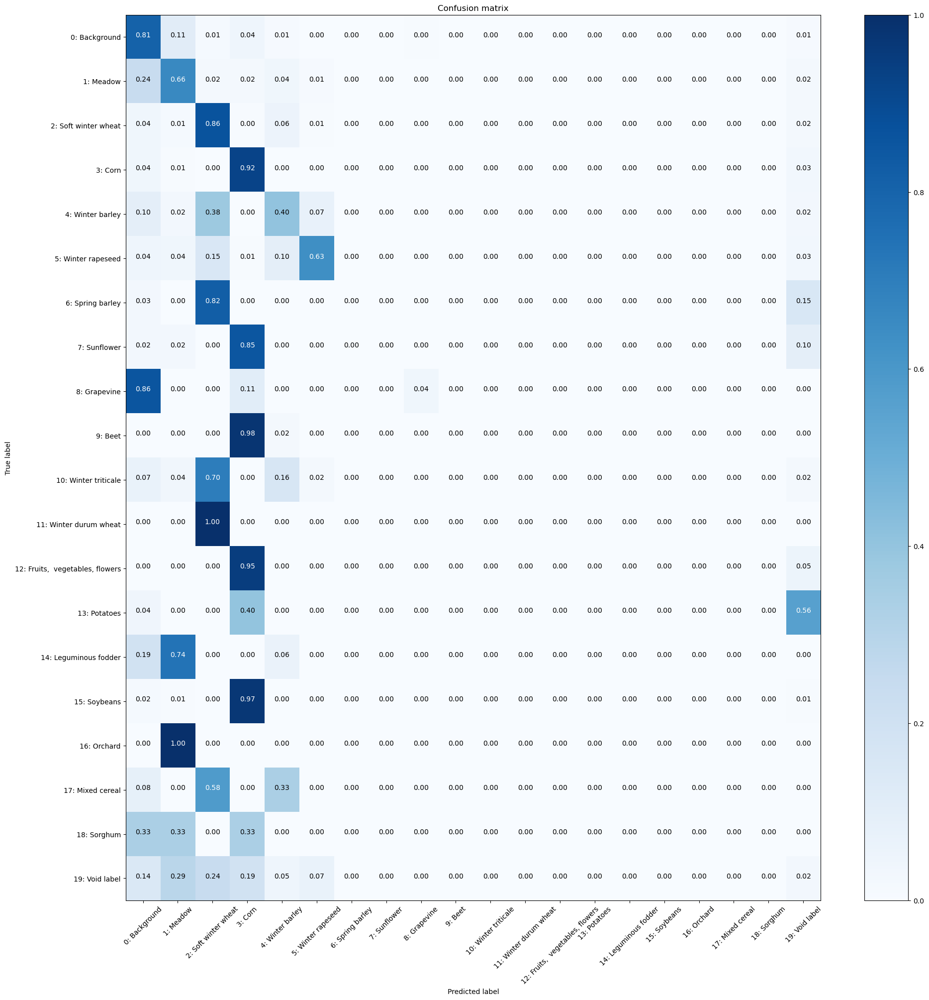

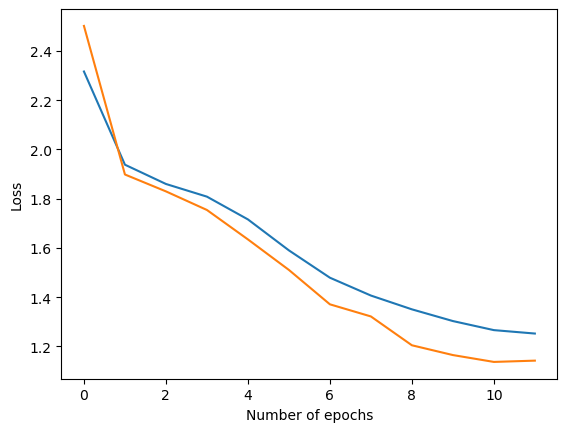

Checking accuracy on validation/test set
Got 4057 / 6400 correct (63.39)
Loss=1.15
Iteration 0, loss = 1.0274
Checking accuracy on validation/test set
Got 4086 / 6400 correct (63.84)
Loss=1.14
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


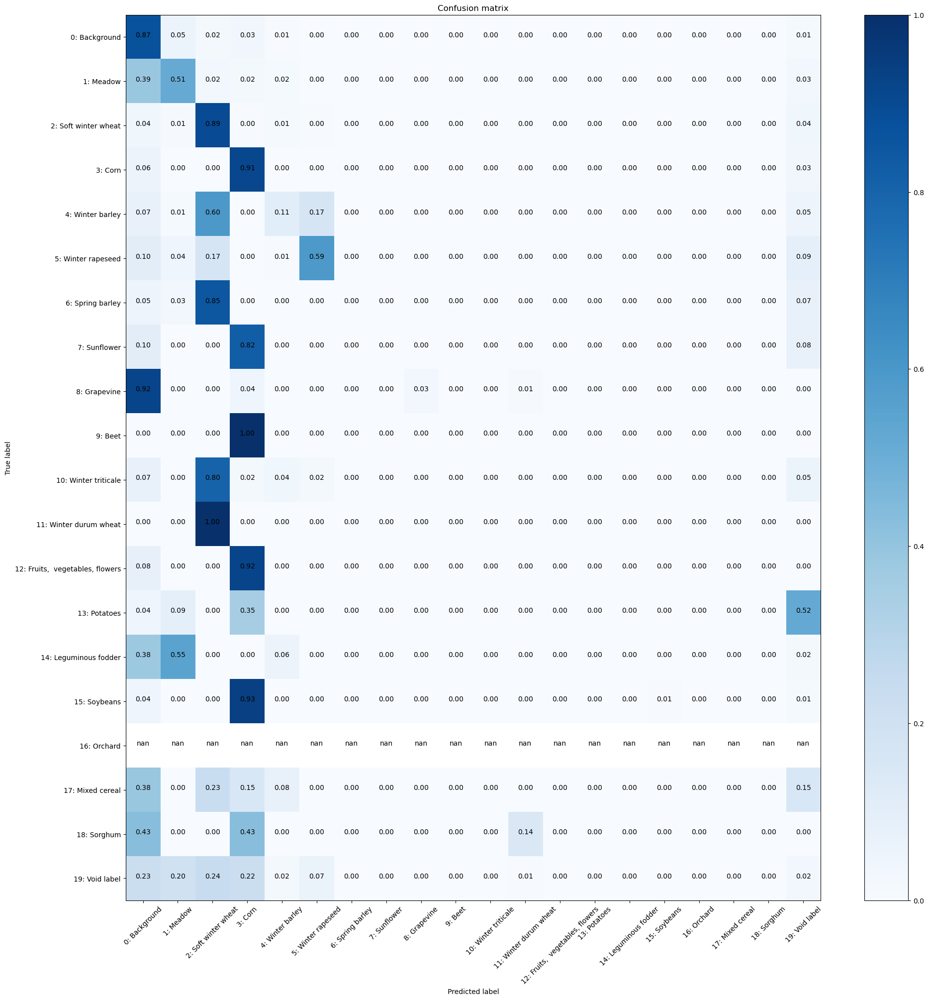


Iteration 100, loss = 1.2635
Checking accuracy on validation/test set
Got 4073 / 6400 correct (63.64)
Loss=1.12
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


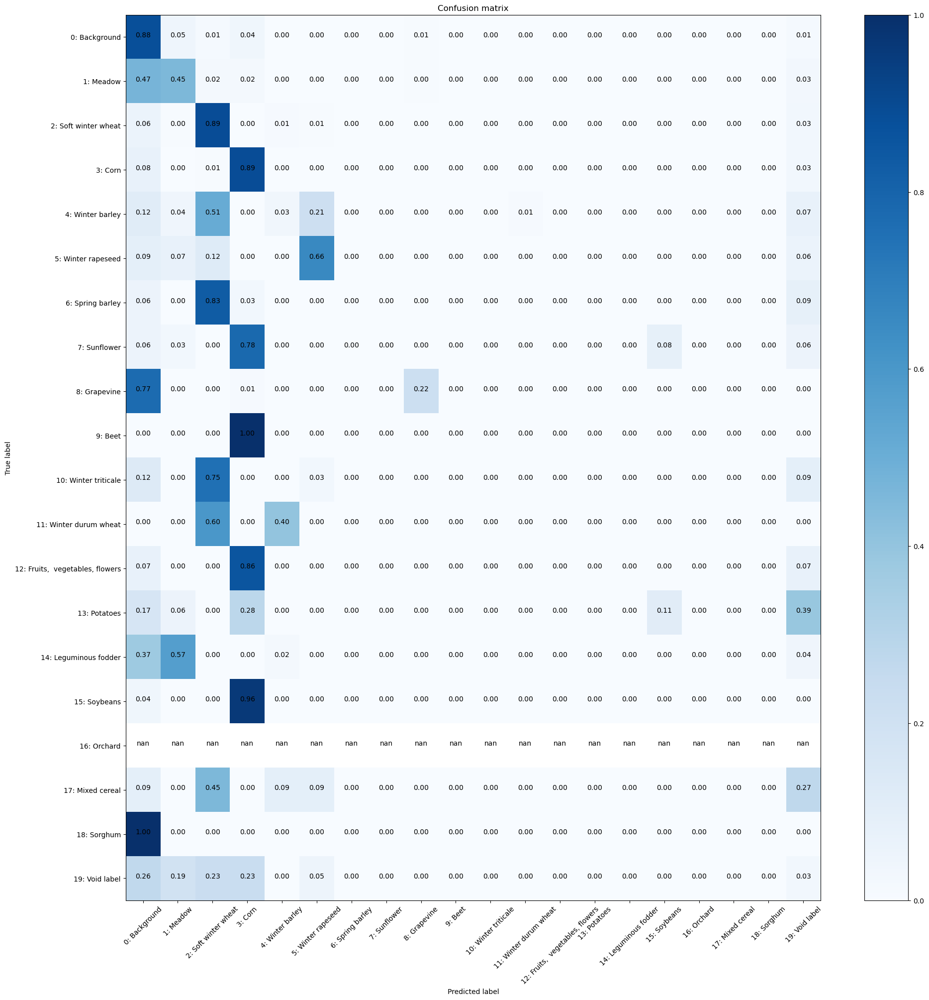

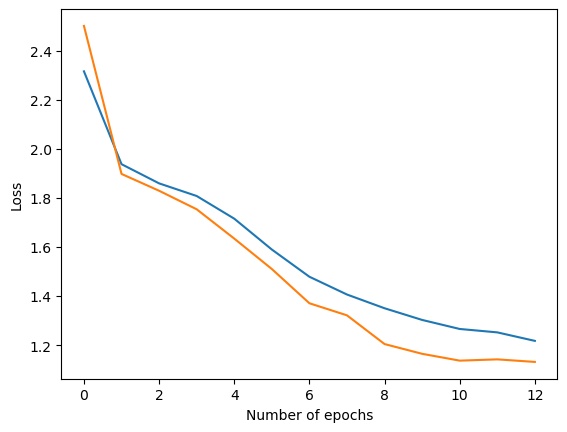

Checking accuracy on validation/test set
Got 4145 / 6400 correct (64.77)
Loss=1.12
Iteration 0, loss = 0.8924
Checking accuracy on validation/test set
Got 4119 / 6400 correct (64.36)
Loss=1.12
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


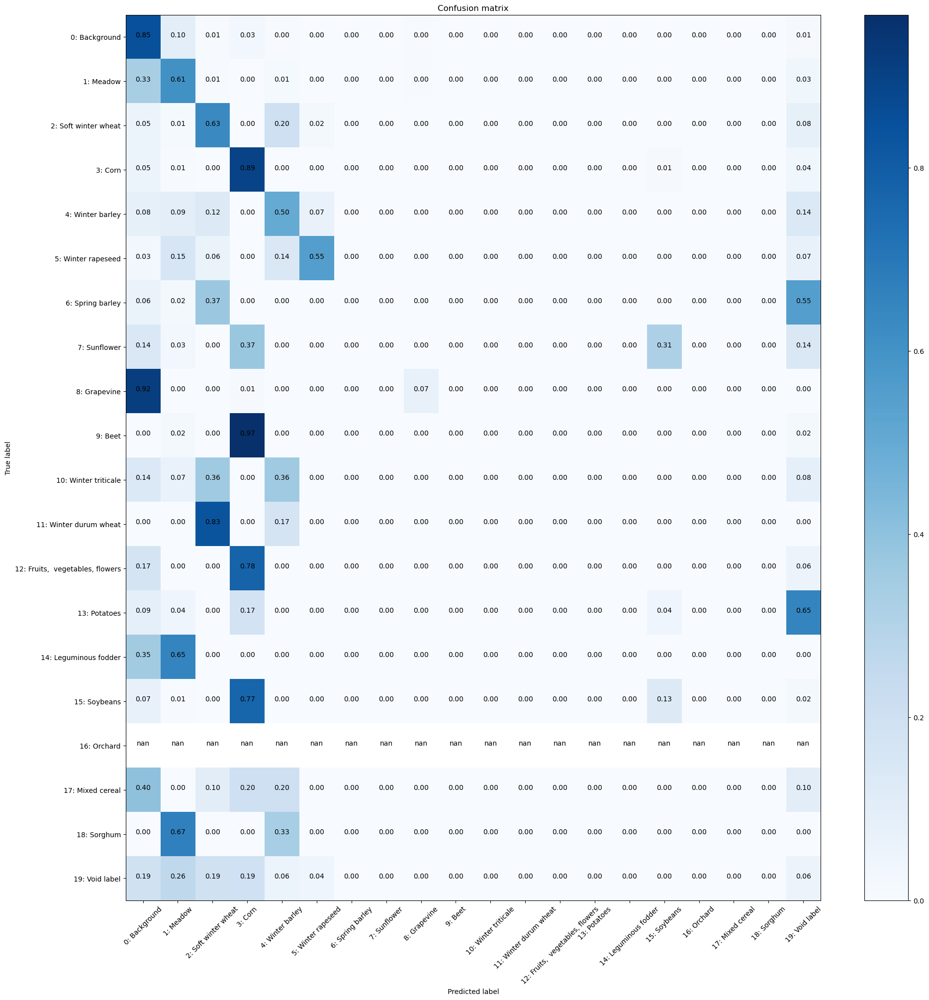


Iteration 100, loss = 1.1604
Checking accuracy on validation/test set
Got 4239 / 6400 correct (66.23)
Loss=1.07
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


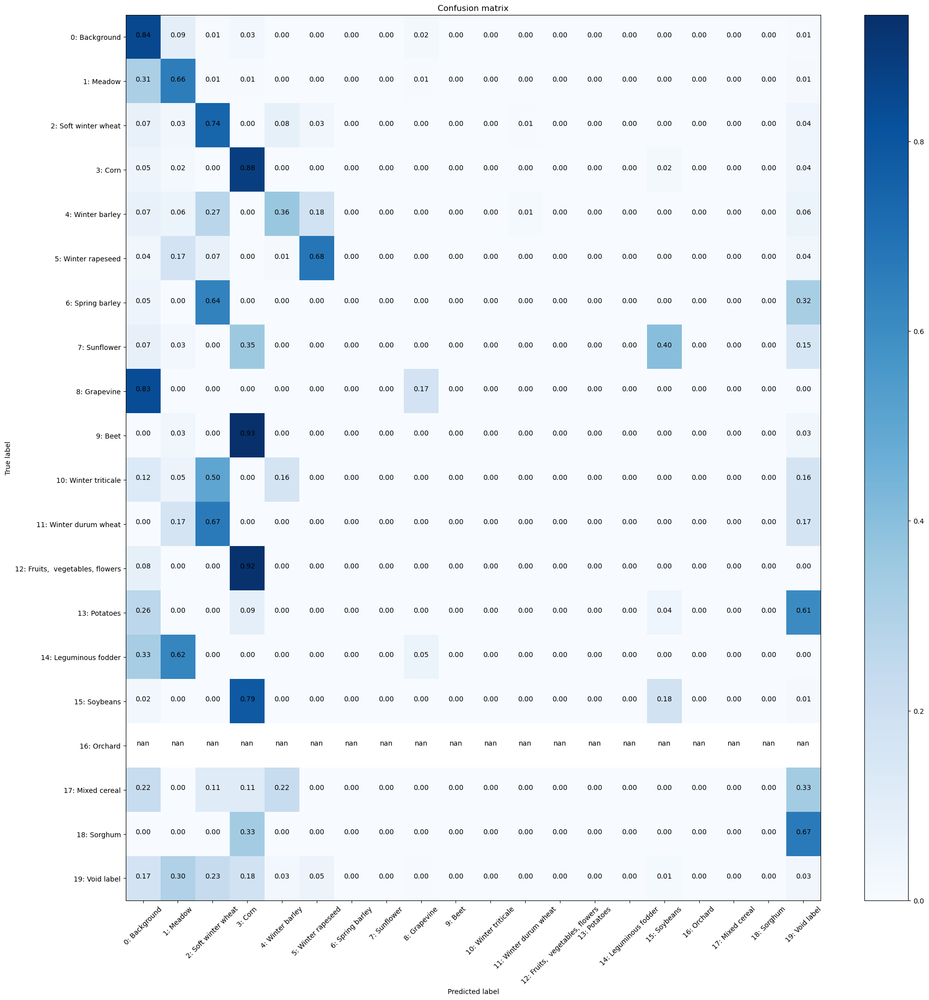

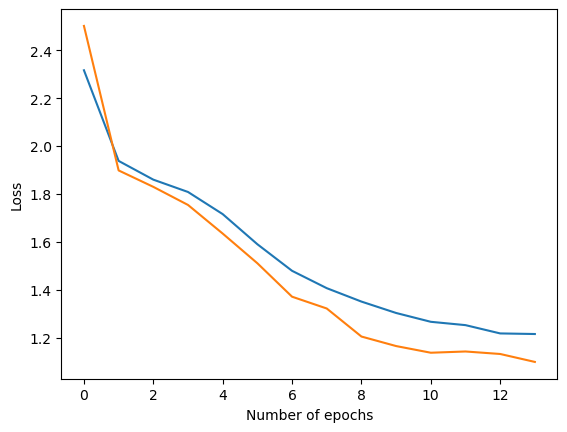

Checking accuracy on validation/test set
Got 4075 / 6400 correct (63.67)
Loss=1.18
Iteration 0, loss = 1.5244
Checking accuracy on validation/test set
Got 4099 / 6400 correct (64.05)
Loss=1.16
Normalized confusion matrix


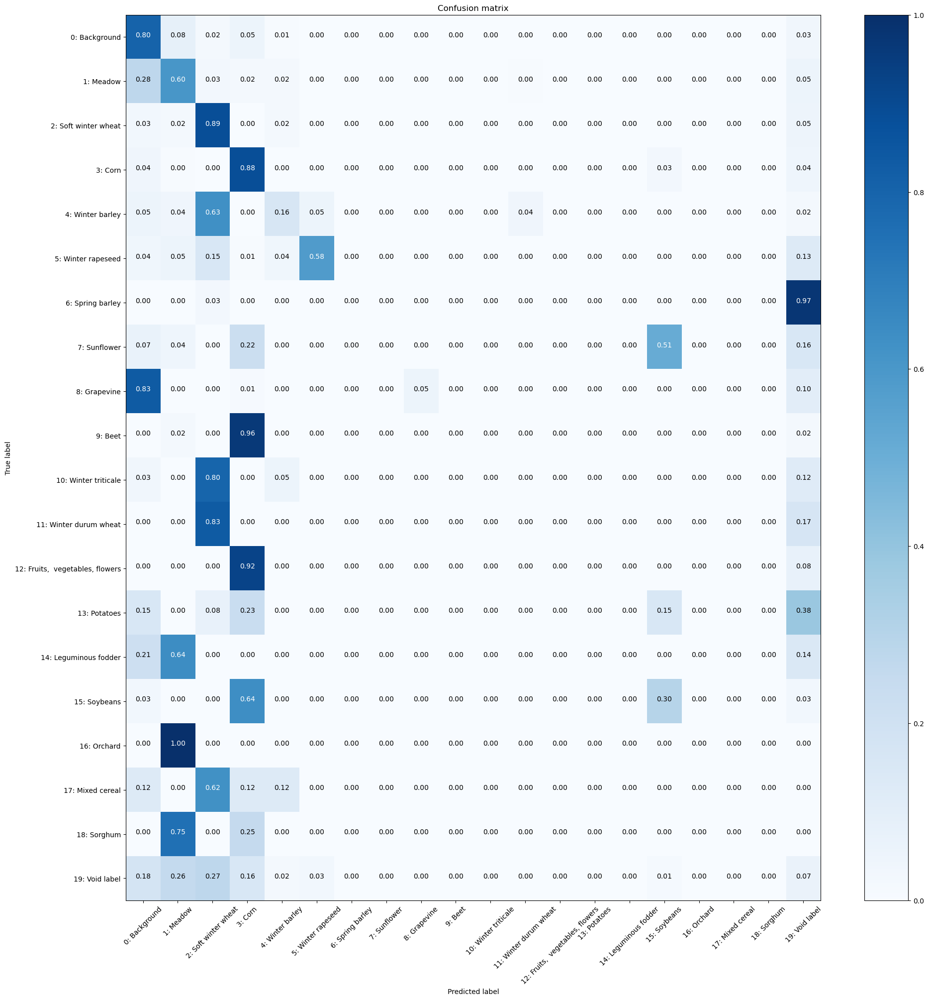


Iteration 100, loss = 1.5150
Checking accuracy on validation/test set
Got 3950 / 6400 correct (61.72)
Loss=1.18
Normalized confusion matrix


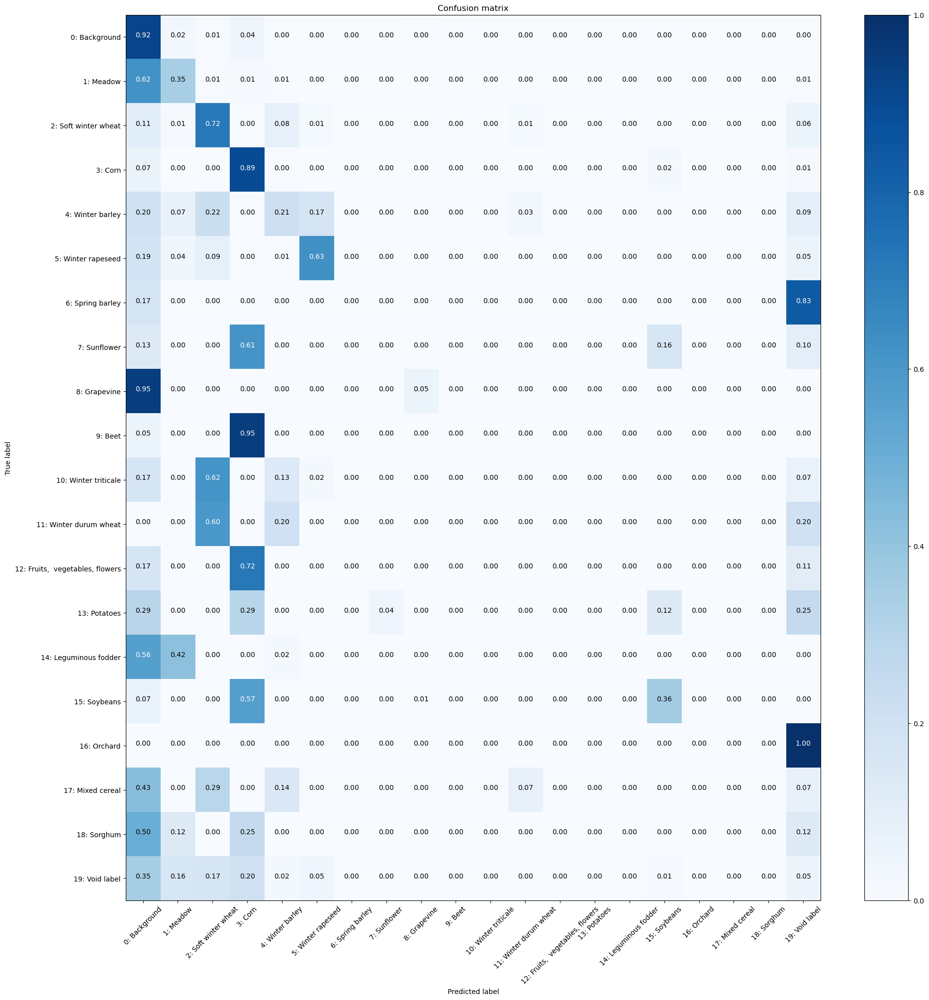

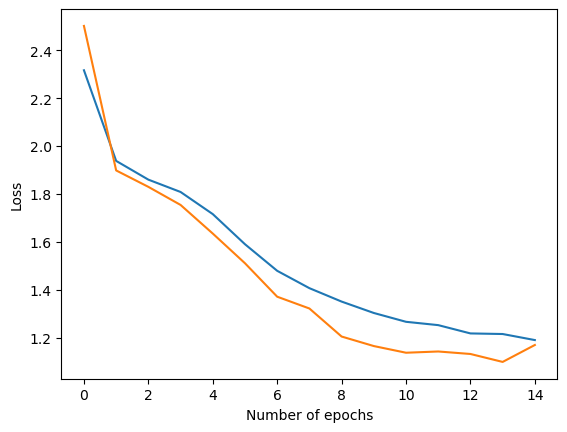

Checking accuracy on validation/test set
Got 4232 / 6400 correct (66.12)
Loss=1.09
Iteration 0, loss = 1.1156
Checking accuracy on validation/test set
Got 4126 / 6400 correct (64.47)
Loss=1.11
Normalized confusion matrix


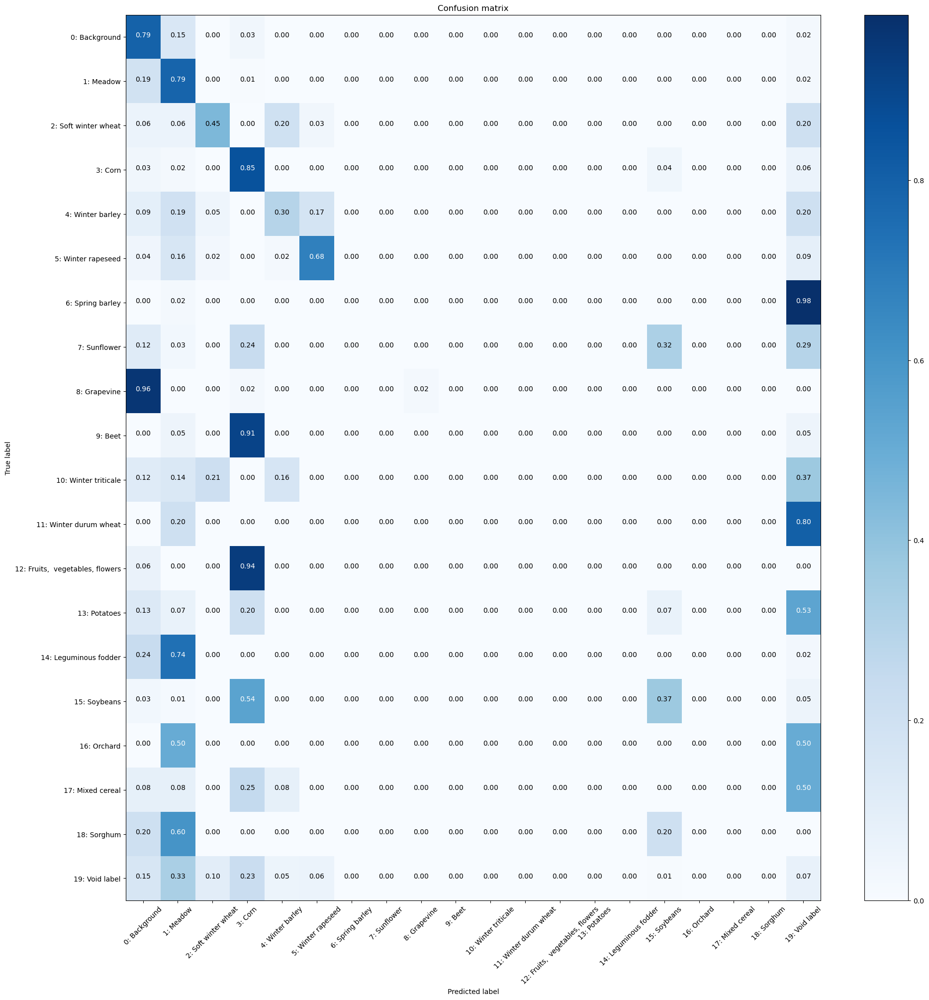


Iteration 100, loss = 1.1125
Checking accuracy on validation/test set
Got 4209 / 6400 correct (65.77)
Loss=1.07
Normalized confusion matrix


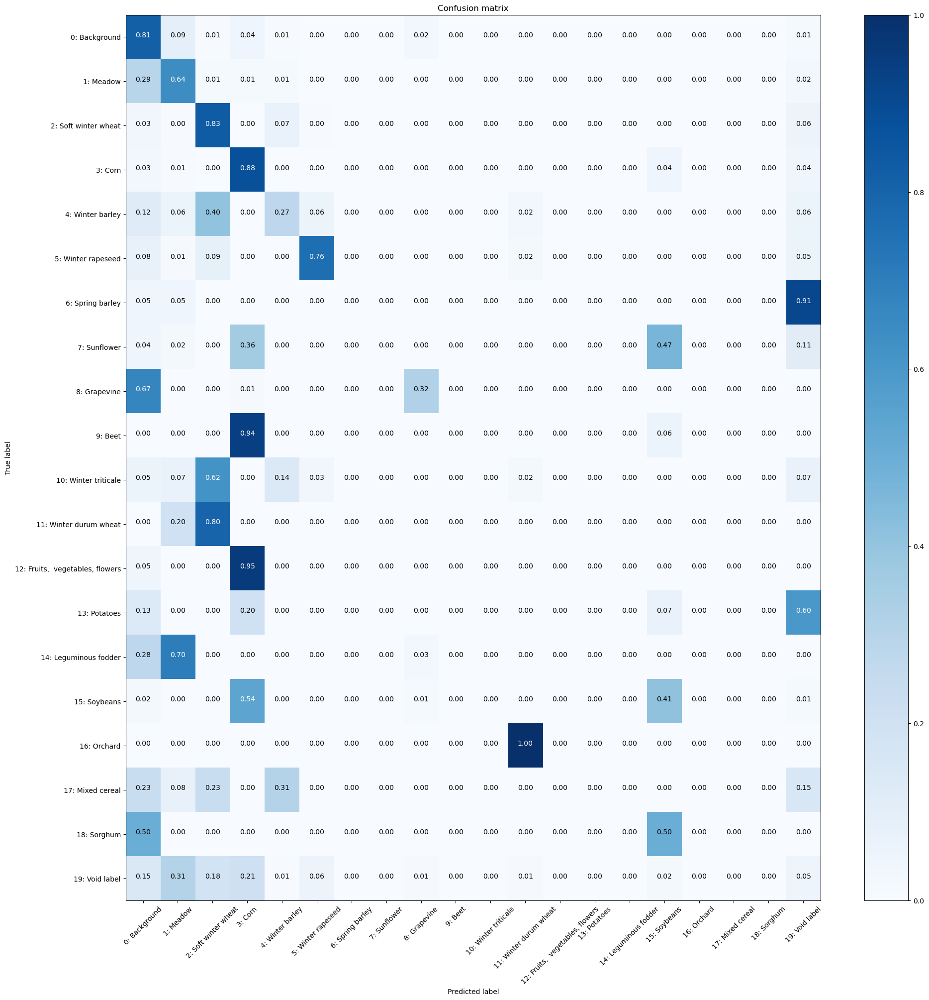

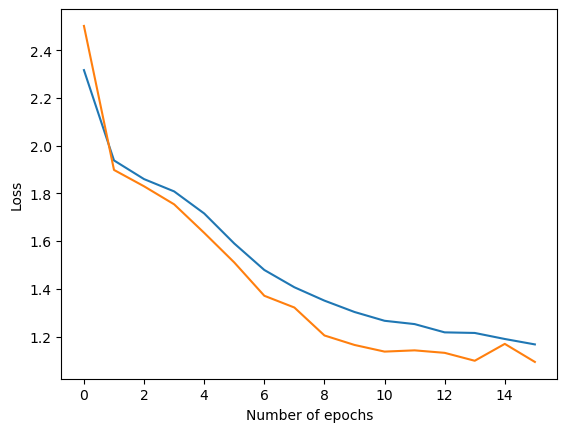

Checking accuracy on validation/test set
Got 4188 / 6400 correct (65.44)
Loss=1.07
Iteration 0, loss = 2.2818
Checking accuracy on validation/test set
Got 4221 / 6400 correct (65.95)
Loss=1.05
Normalized confusion matrix


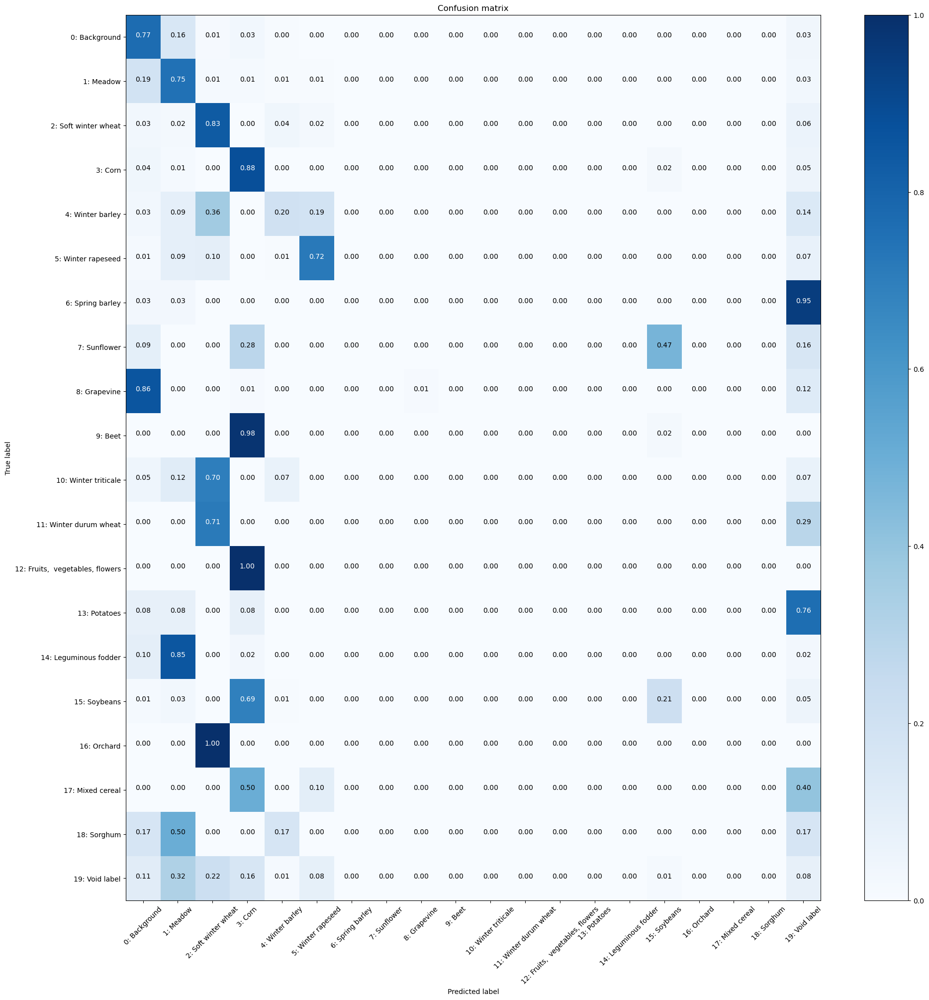


Iteration 100, loss = 1.5924
Checking accuracy on validation/test set
Got 4221 / 6400 correct (65.95)
Loss=1.02
Normalized confusion matrix


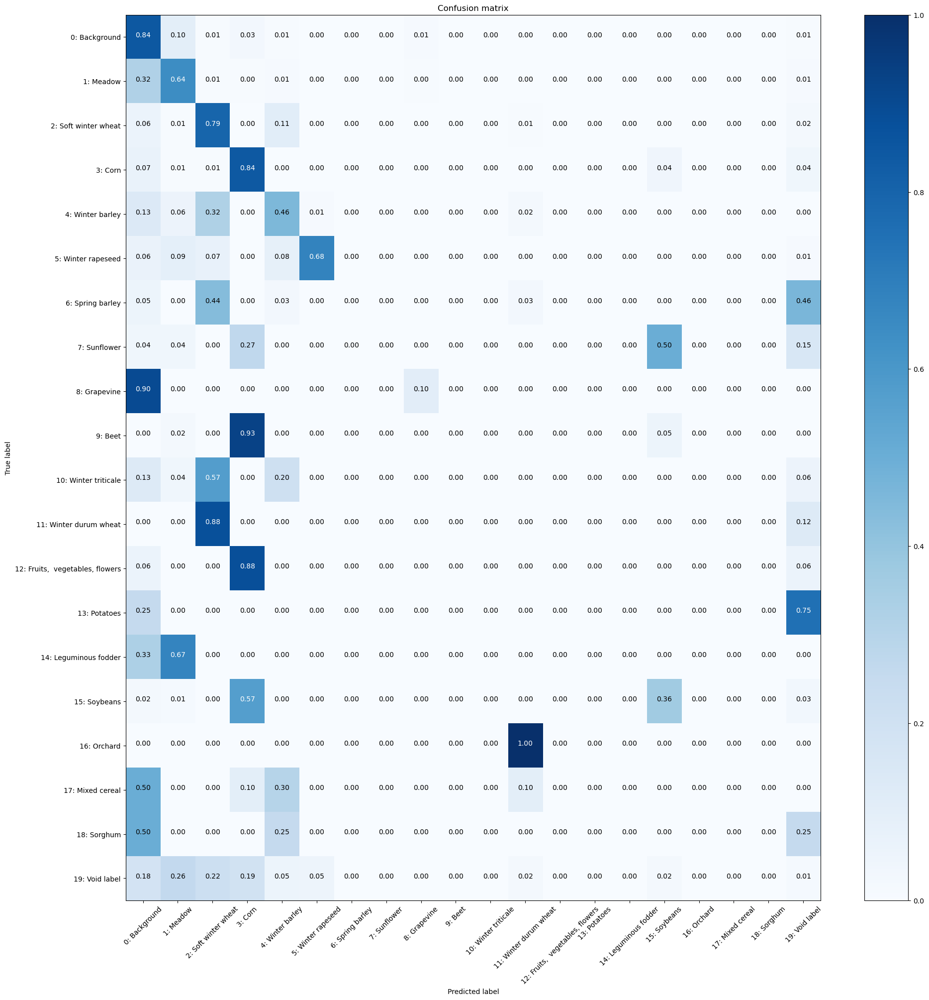

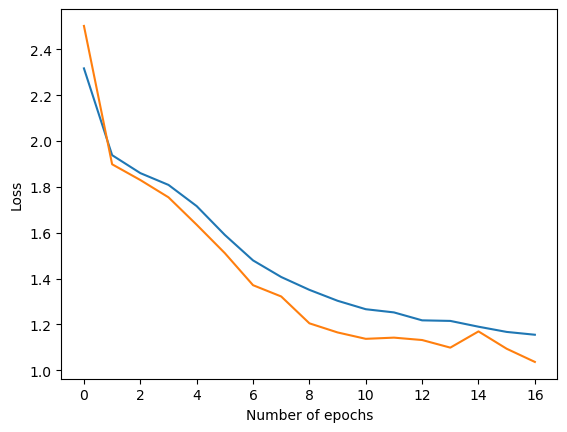

Checking accuracy on validation/test set
Got 4210 / 6400 correct (65.78)
Loss=1.05
Iteration 0, loss = 1.2449
Checking accuracy on validation/test set
Got 4196 / 6400 correct (65.56)
Loss=1.06
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


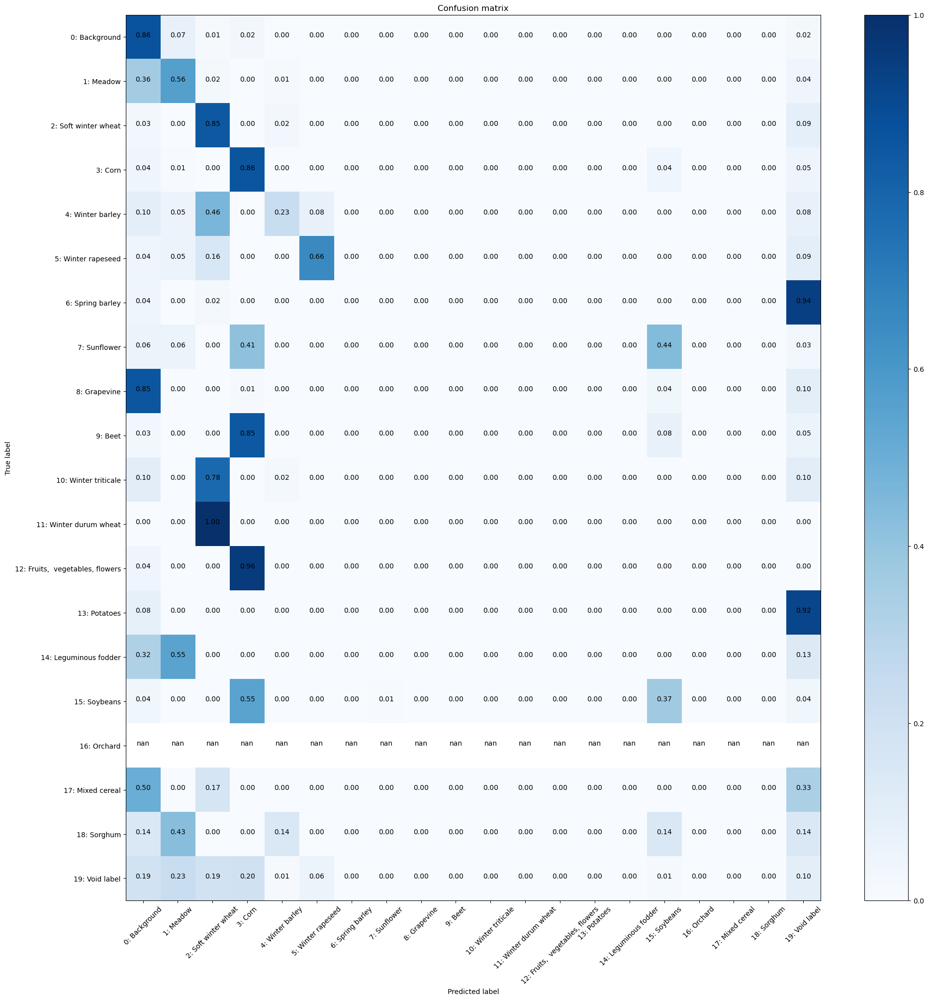


Iteration 100, loss = 1.5049
Checking accuracy on validation/test set
Got 4260 / 6400 correct (66.56)
Loss=1.05
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


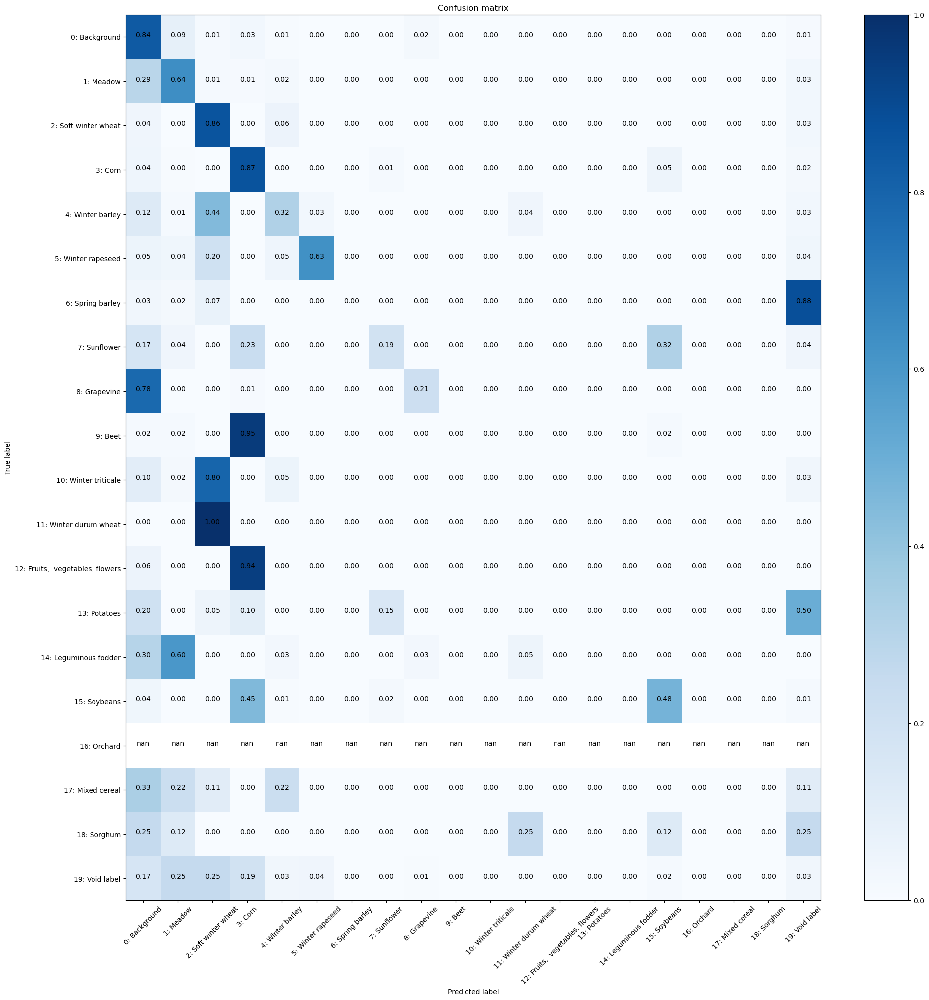

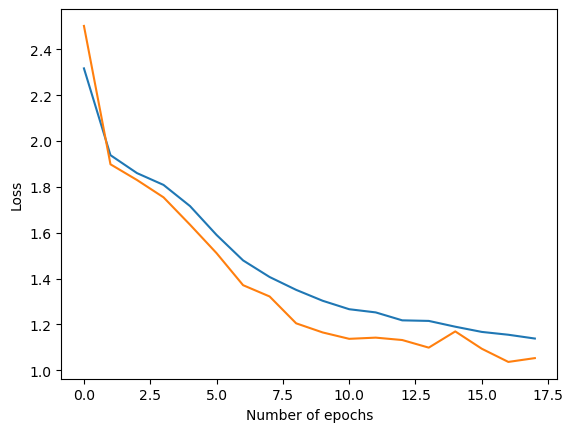

Checking accuracy on validation/test set
Got 4309 / 6400 correct (67.33)
Loss=1.01
Iteration 0, loss = 0.5712
Checking accuracy on validation/test set
Got 4291 / 6400 correct (67.05)
Loss=1.01
Normalized confusion matrix


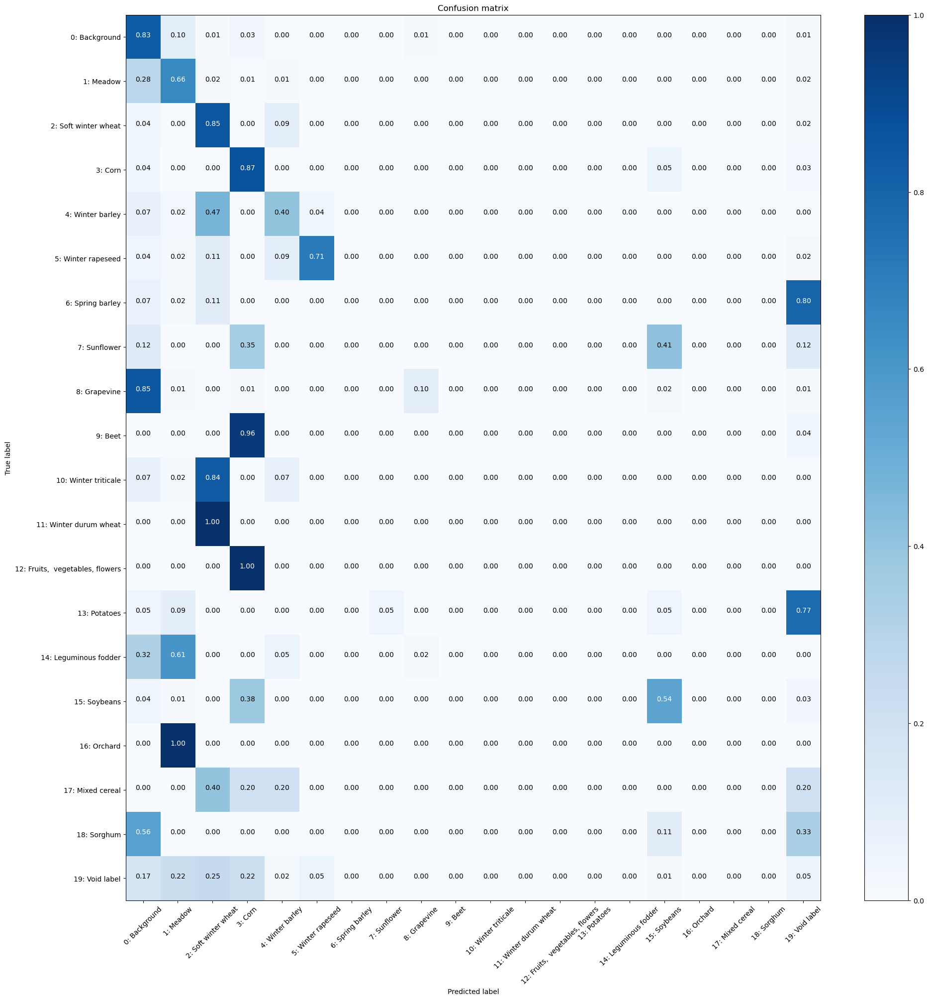


Iteration 100, loss = 1.4429
Checking accuracy on validation/test set
Got 4278 / 6400 correct (66.84)
Loss=1.03
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


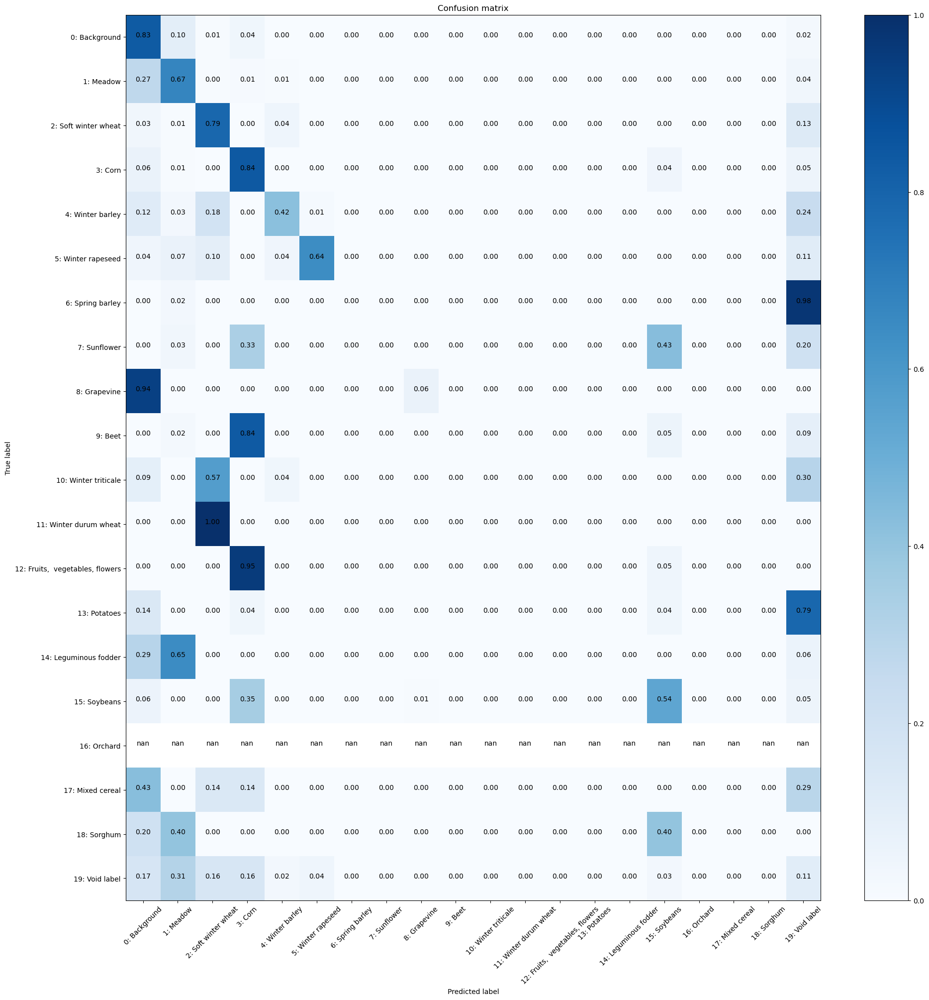

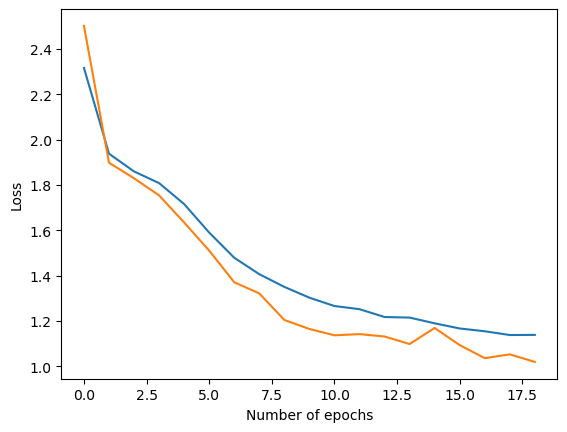

Checking accuracy on validation/test set
Got 4351 / 6400 correct (67.98)
Loss=1.01
Iteration 0, loss = 1.0143
Checking accuracy on validation/test set
Got 4360 / 6400 correct (68.12)
Loss=1.01
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


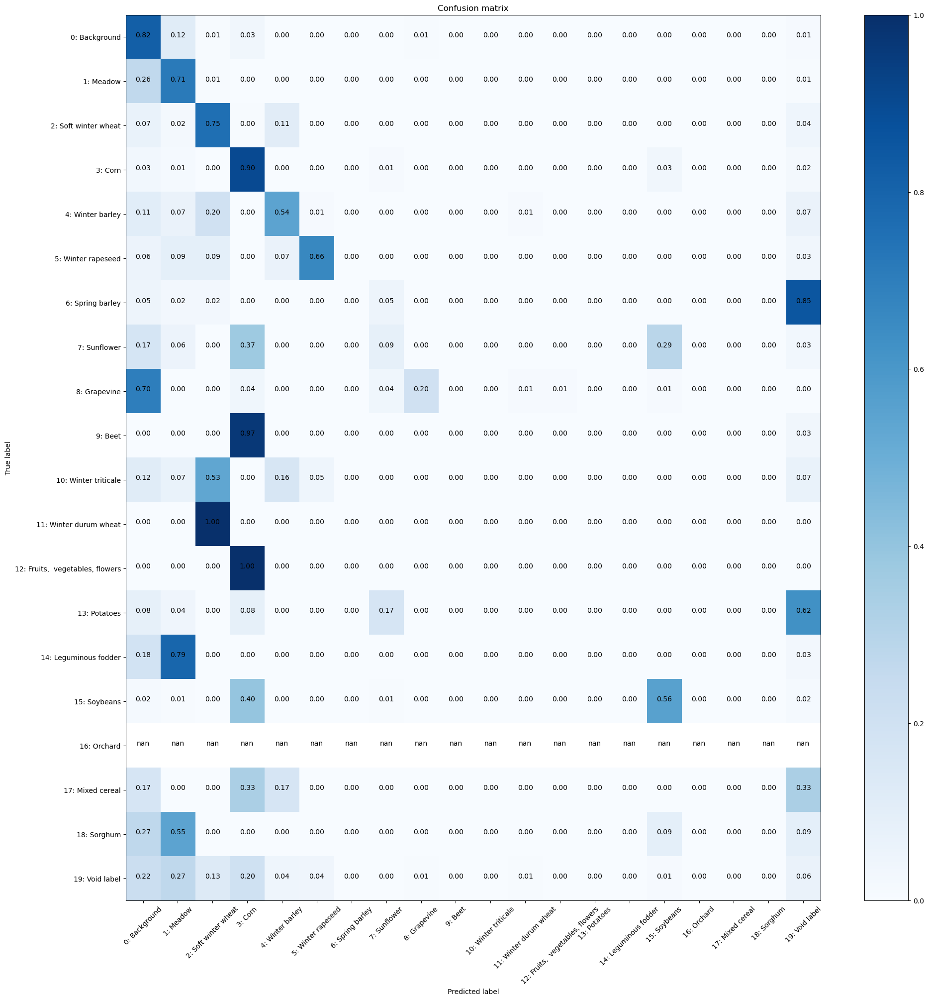


Iteration 100, loss = 1.2796
Checking accuracy on validation/test set
Got 4286 / 6400 correct (66.97)
Loss=1.01
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


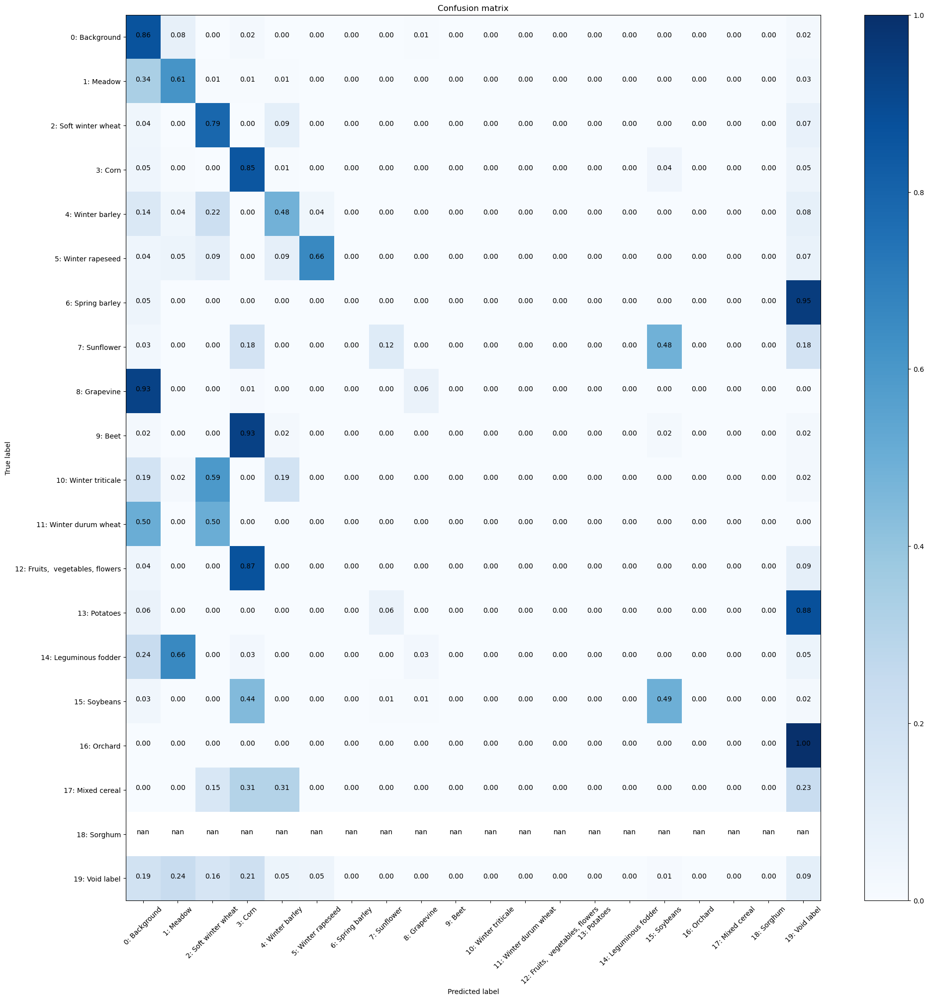

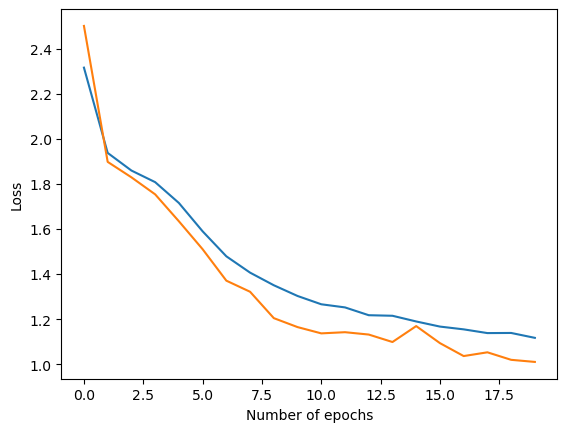

Checking accuracy on validation/test set
Got 4355 / 6400 correct (68.05)
Loss=1.01
Iteration 0, loss = 0.7196
Checking accuracy on validation/test set
Got 4341 / 6400 correct (67.83)
Loss=1.01
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


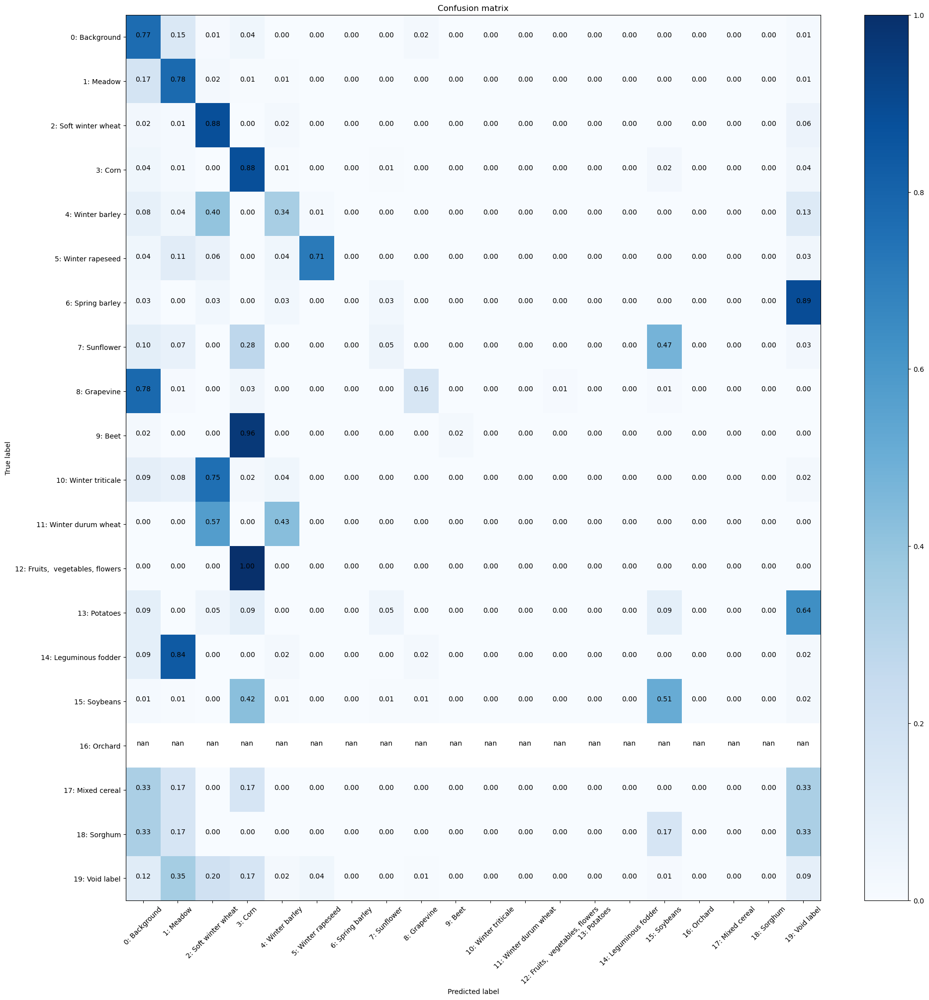


Iteration 100, loss = 0.9766
Checking accuracy on validation/test set
Got 4220 / 6400 correct (65.94)
Loss=1.05
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


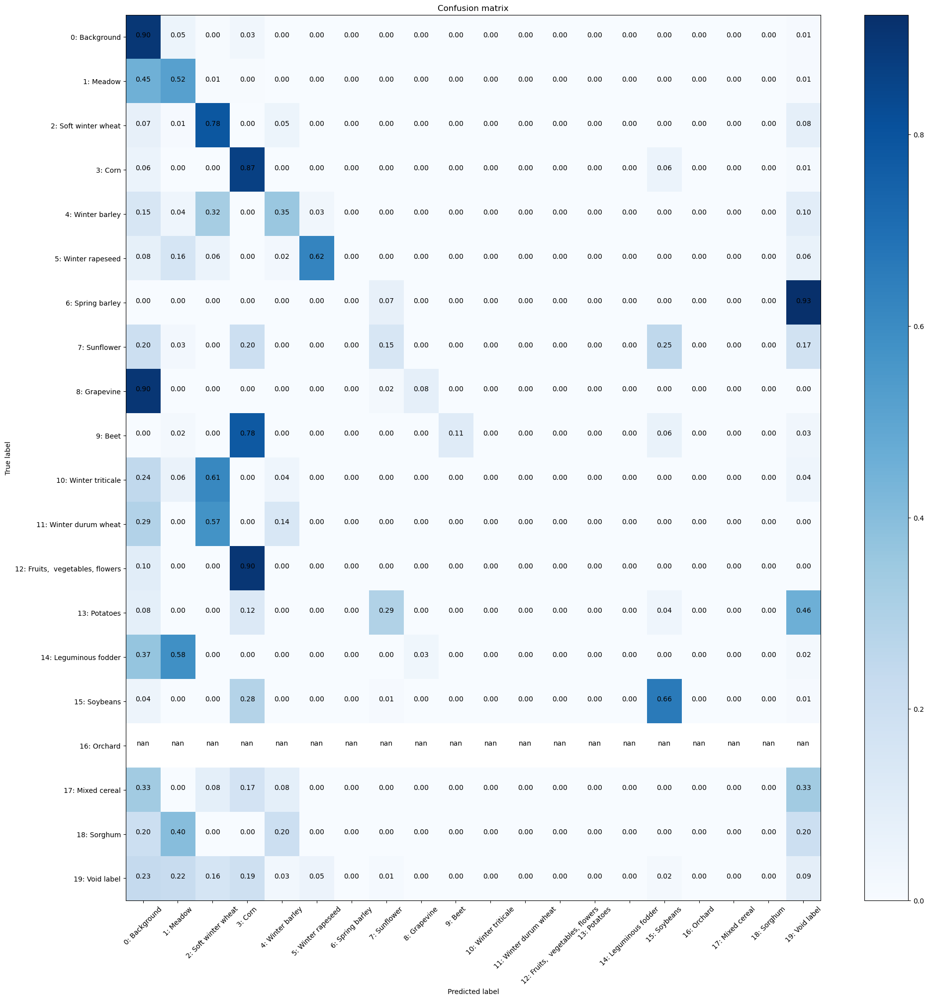

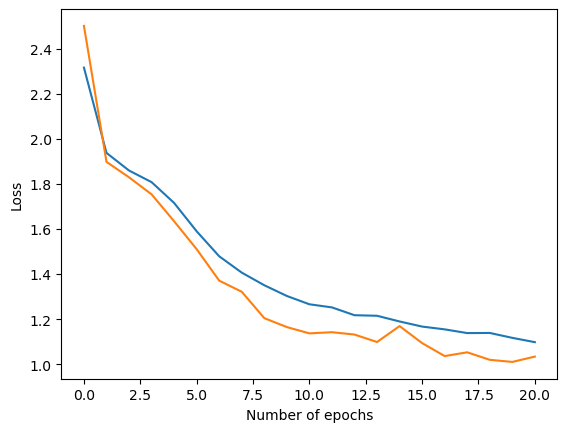

Checking accuracy on validation/test set
Got 4144 / 6400 correct (64.75)
Loss=1.10
Iteration 0, loss = 1.3513
Checking accuracy on validation/test set
Got 4253 / 6400 correct (66.45)
Loss=1.06
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


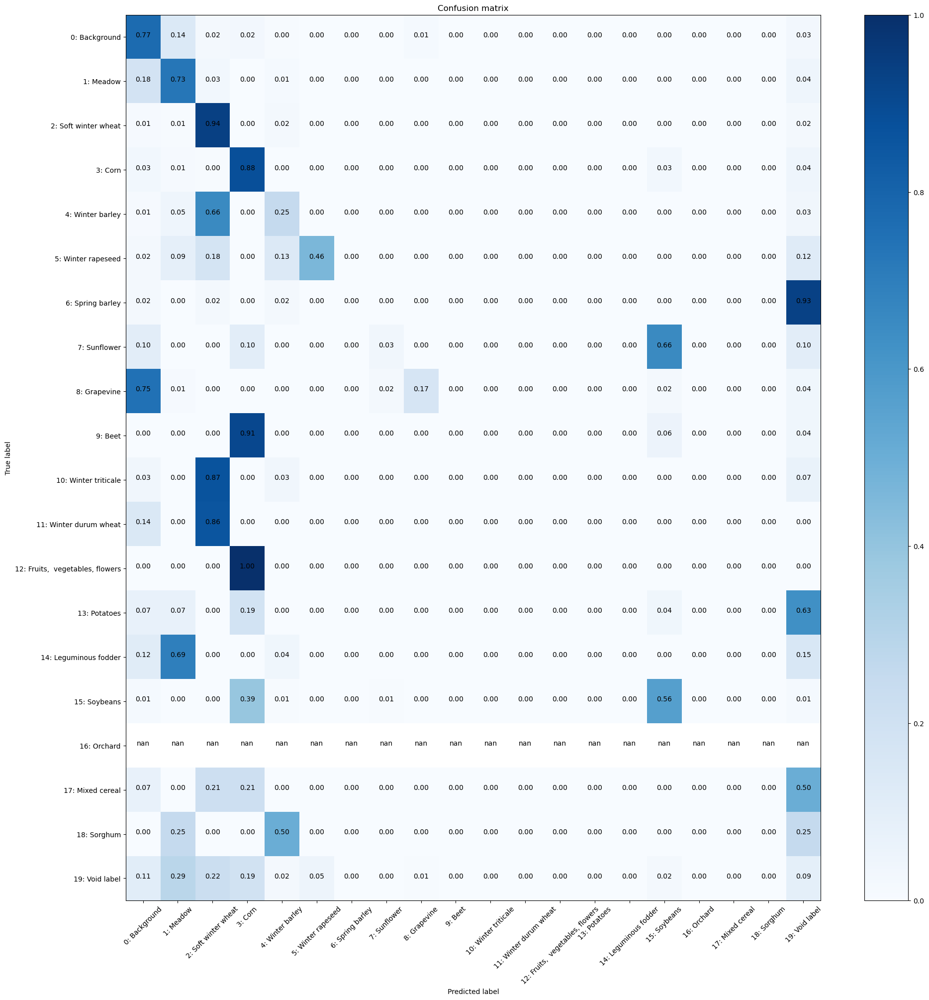


Iteration 100, loss = 0.8463
Checking accuracy on validation/test set
Got 4334 / 6400 correct (67.72)
Loss=1.00
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


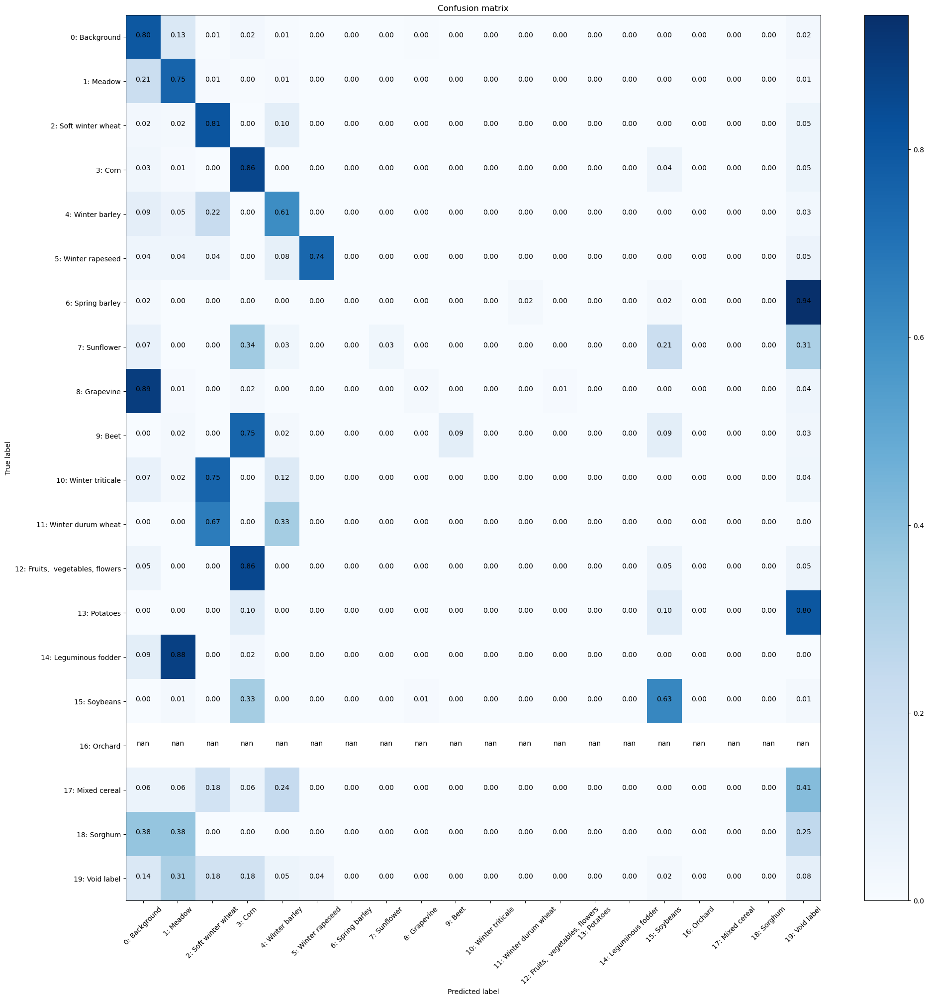

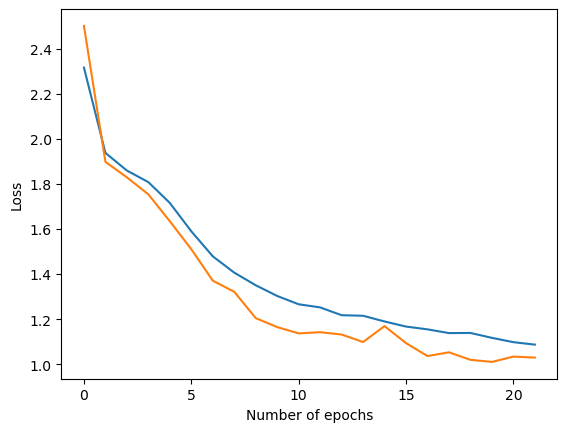

Checking accuracy on validation/test set
Got 4354 / 6400 correct (68.03)
Loss=1.00
Iteration 0, loss = 1.6409
Checking accuracy on validation/test set
Got 4433 / 6400 correct (69.27)
Loss=0.99
Normalized confusion matrix


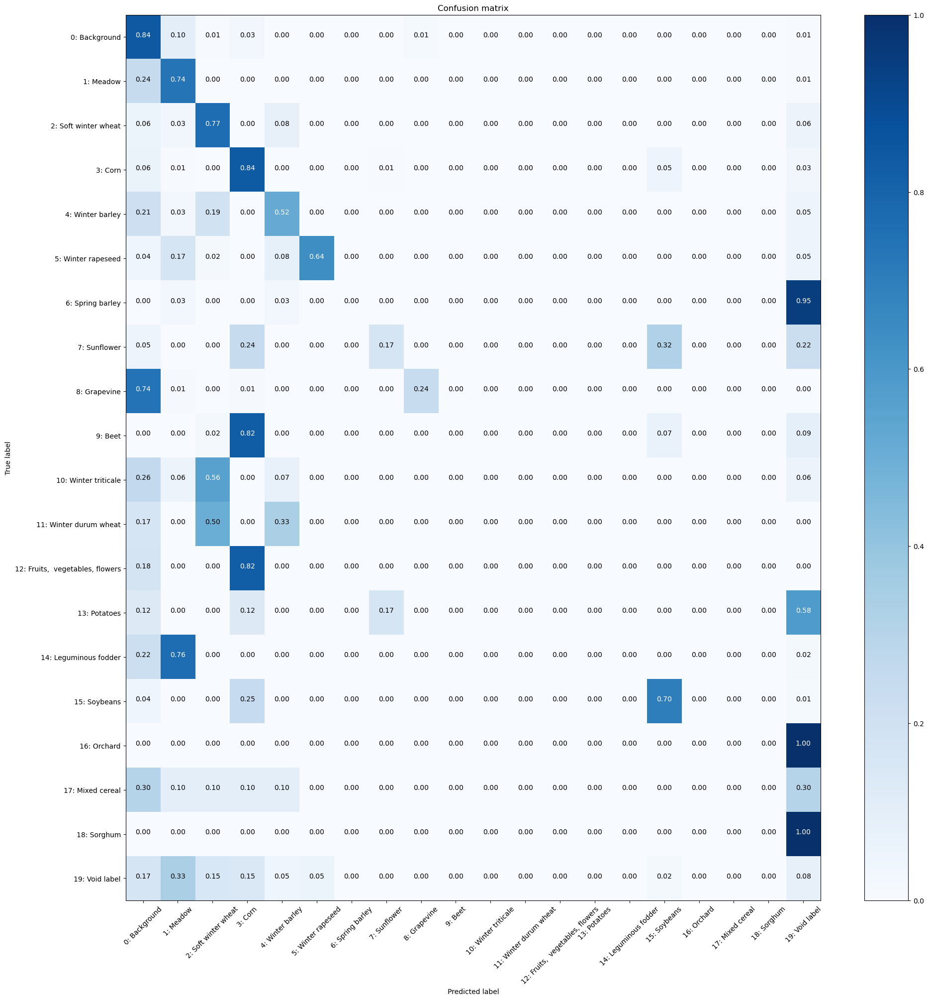


Iteration 100, loss = 0.9563
Checking accuracy on validation/test set
Got 4301 / 6400 correct (67.20)
Loss=1.03
Normalized confusion matrix


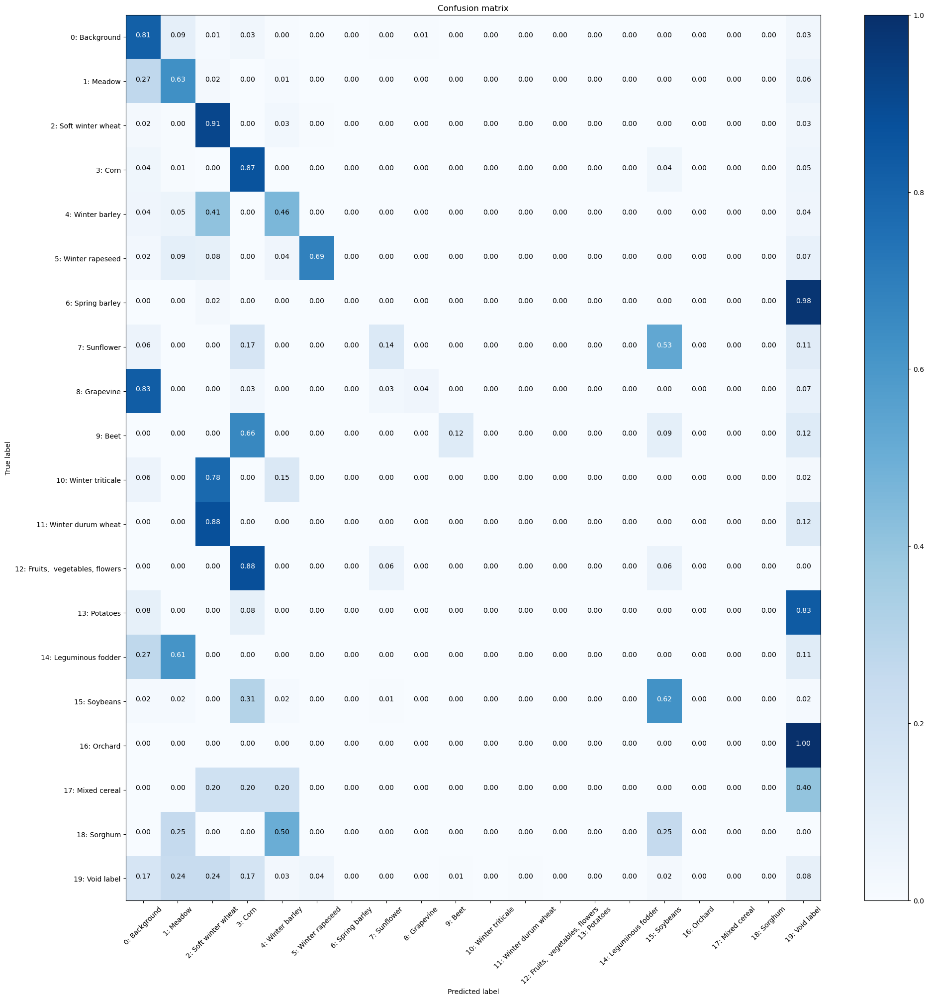

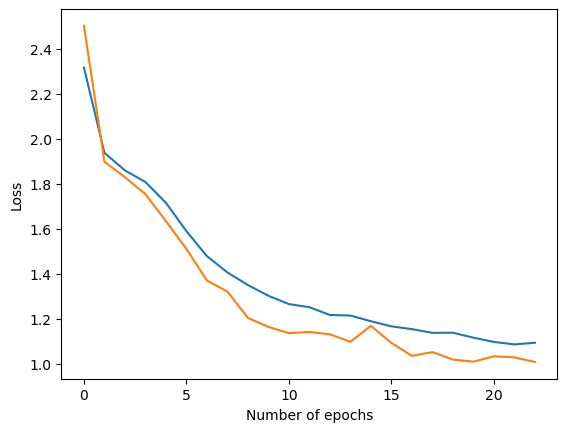

Checking accuracy on validation/test set
Got 4306 / 6400 correct (67.28)
Loss=1.01
Iteration 0, loss = 1.4346
Checking accuracy on validation/test set
Got 4217 / 6400 correct (65.89)
Loss=1.04
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


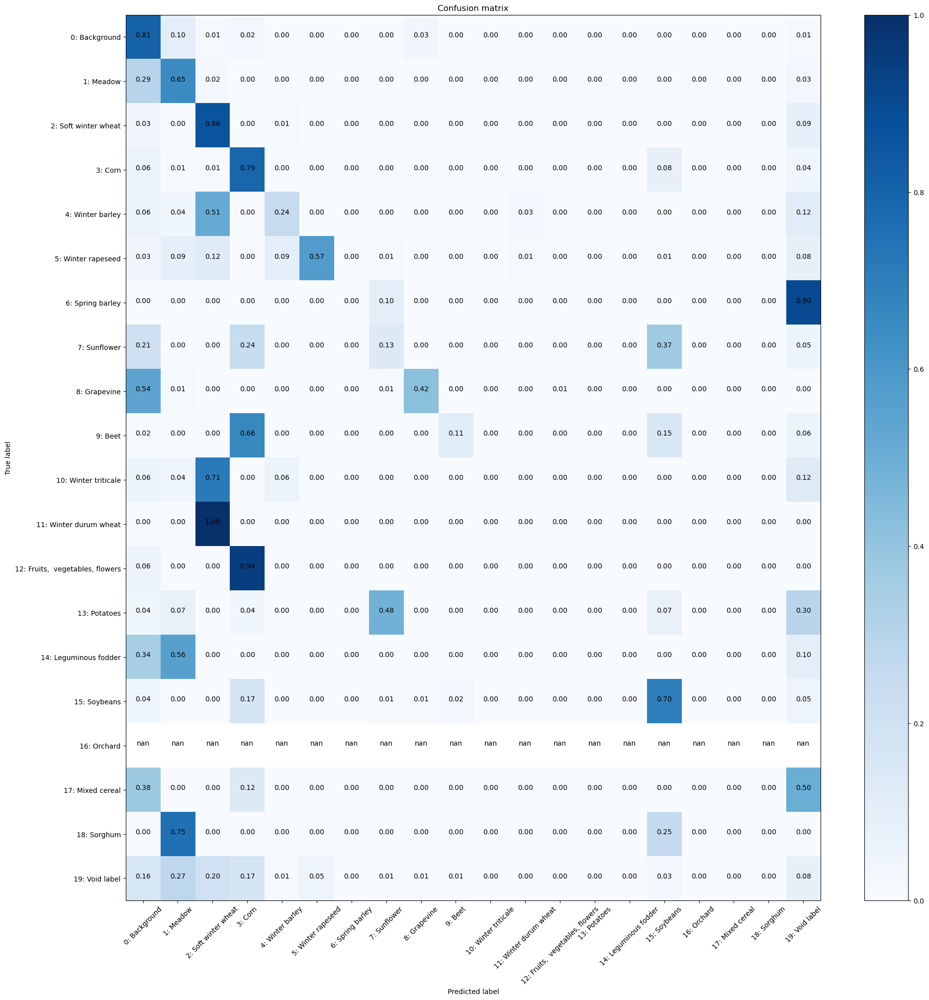


Iteration 100, loss = 1.0144
Checking accuracy on validation/test set
Got 4312 / 6400 correct (67.38)
Loss=0.98
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


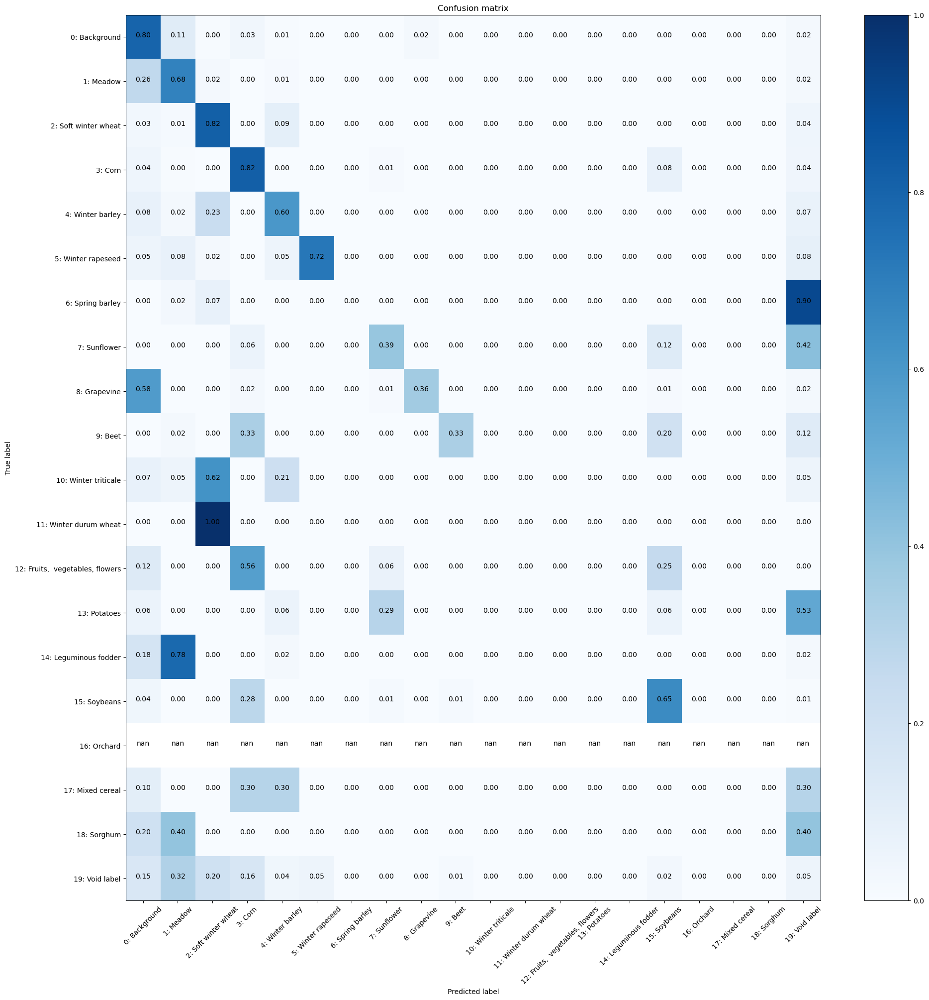

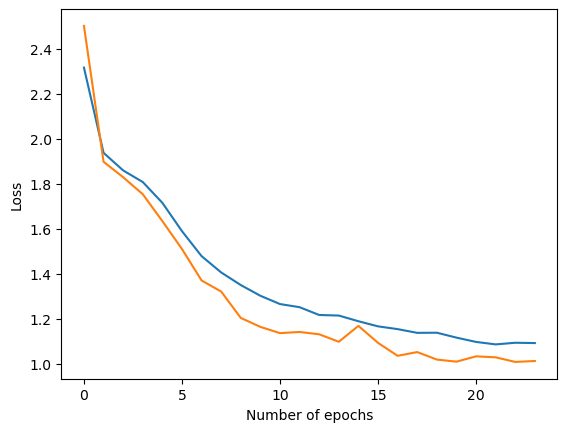

Checking accuracy on validation/test set
Got 4256 / 6400 correct (66.50)
Loss=1.04
Iteration 0, loss = 0.9377
Checking accuracy on validation/test set
Got 4329 / 6400 correct (67.64)
Loss=1.00
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


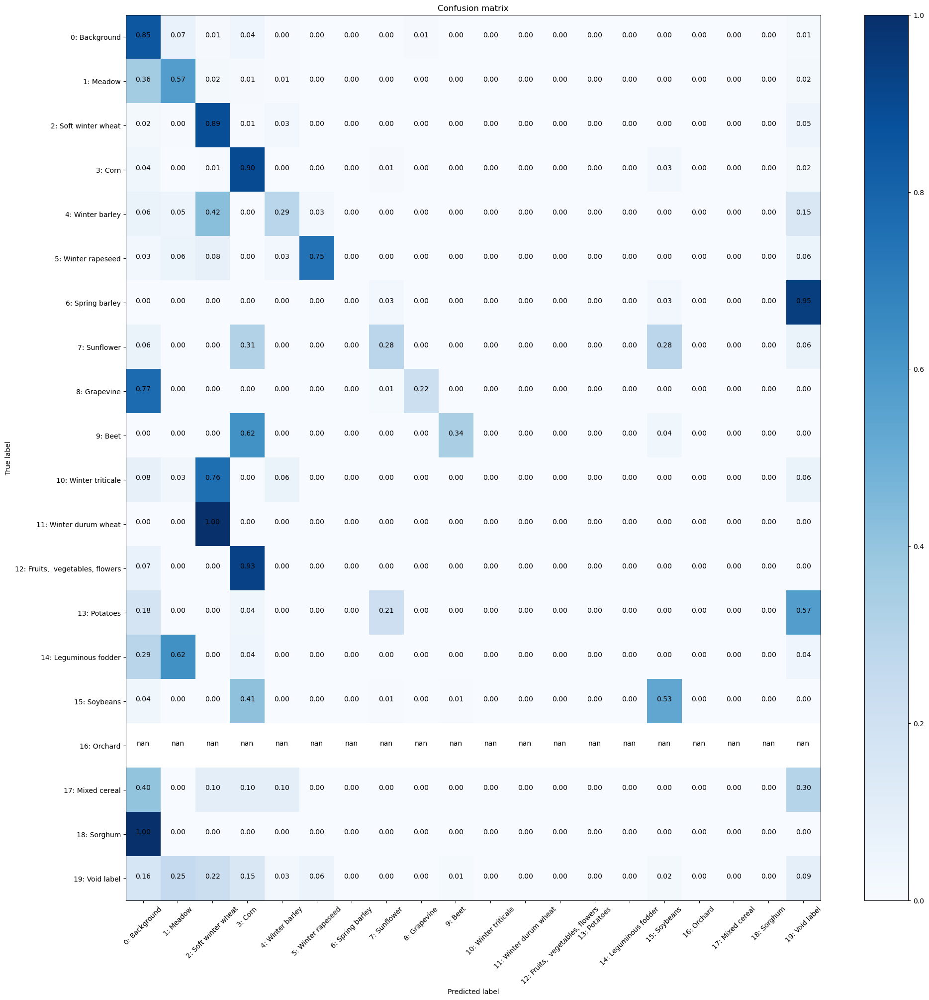


Iteration 100, loss = 1.1382
Checking accuracy on validation/test set
Got 4325 / 6400 correct (67.58)
Loss=1.00
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


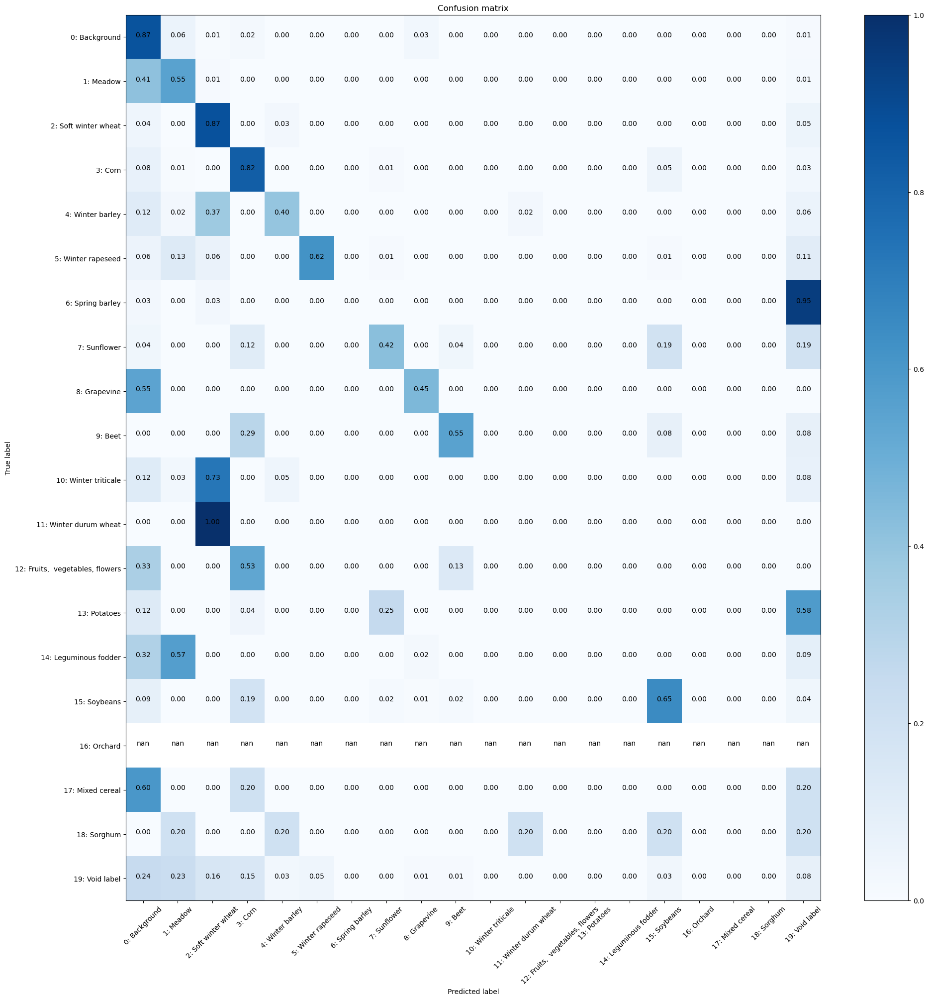

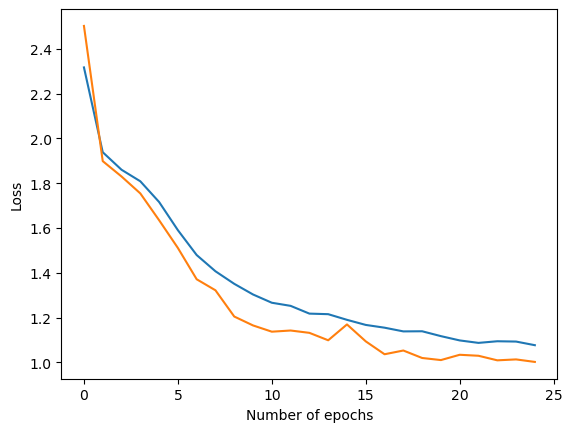

Checking accuracy on validation/test set
Got 4358 / 6400 correct (68.09)
Loss=0.97
Iteration 0, loss = 0.7307
Checking accuracy on validation/test set
Got 4338 / 6400 correct (67.78)
Loss=0.97
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


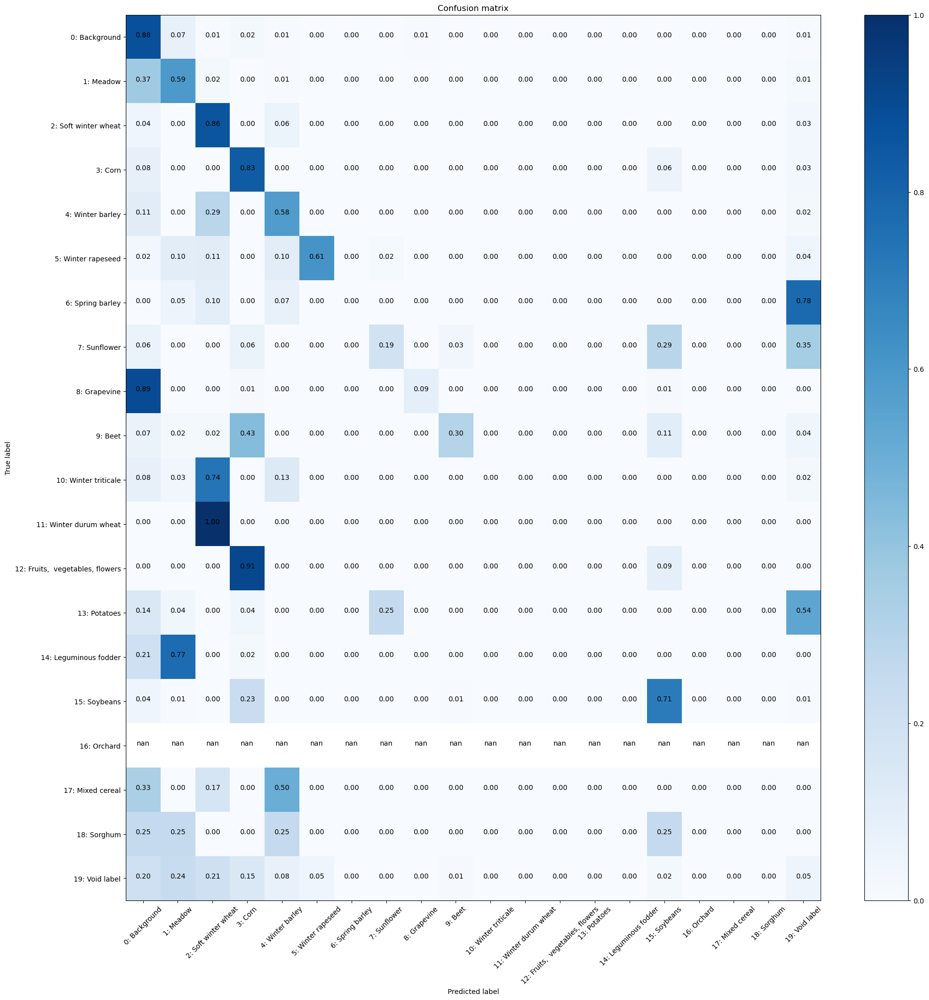


Iteration 100, loss = 1.1000
Checking accuracy on validation/test set
Got 4299 / 6400 correct (67.17)
Loss=1.00
Normalized confusion matrix


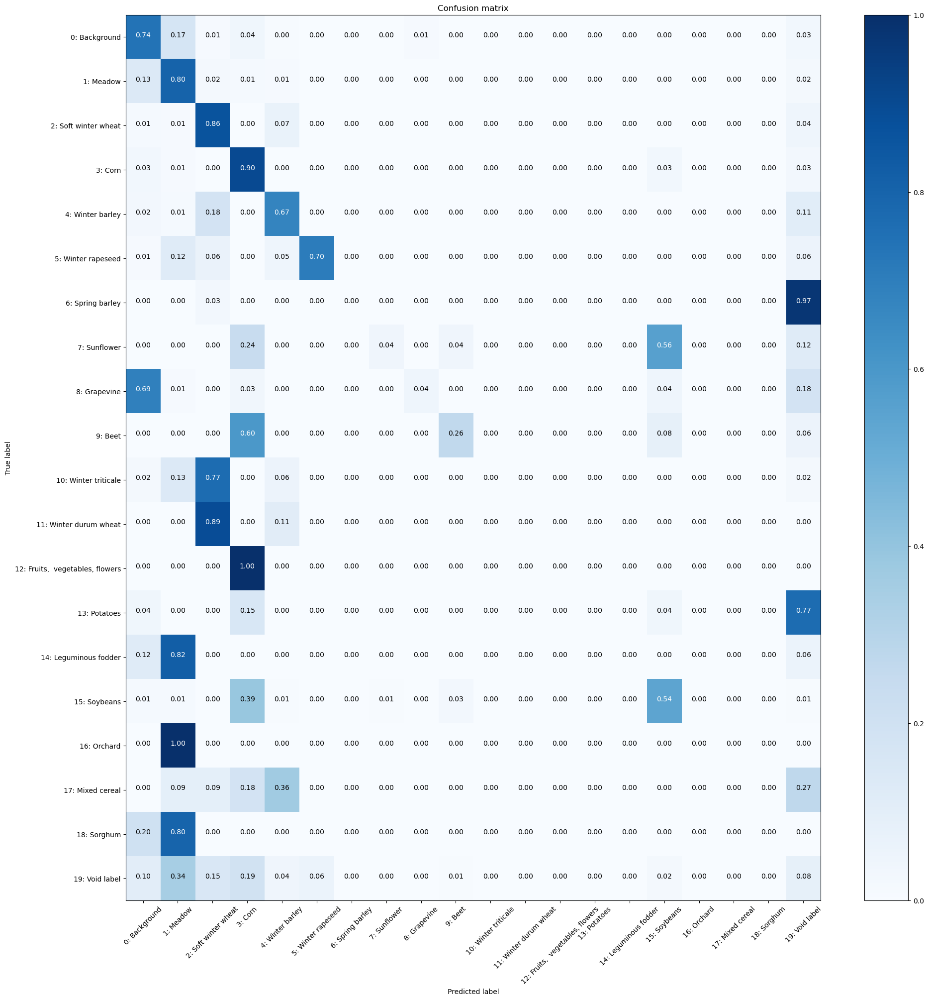

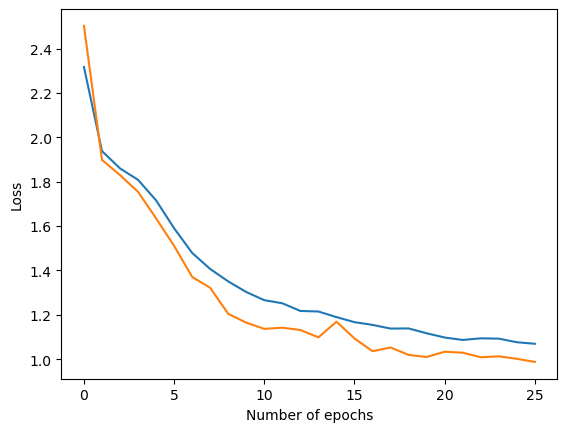

Checking accuracy on validation/test set
Got 4427 / 6400 correct (69.17)
Loss=0.97
Iteration 0, loss = 1.0428
Checking accuracy on validation/test set
Got 4389 / 6400 correct (68.58)
Loss=0.99
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


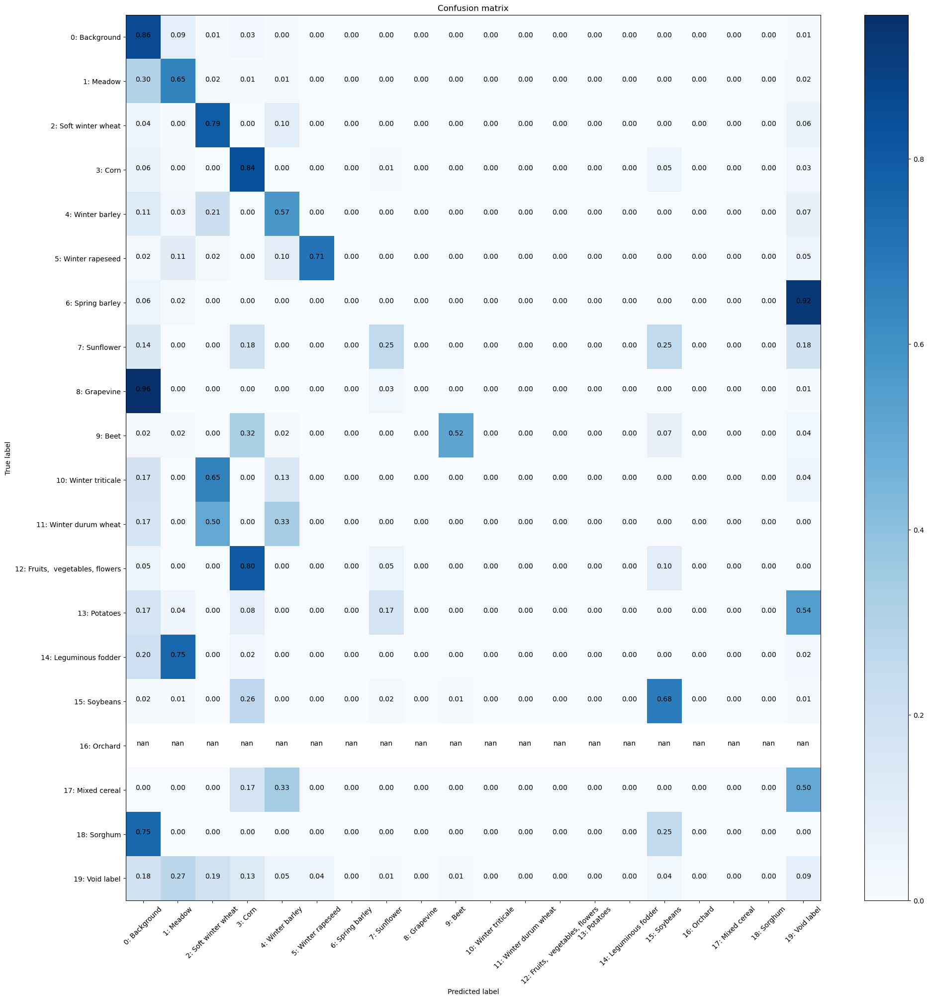


Iteration 100, loss = 1.4477
Checking accuracy on validation/test set
Got 4330 / 6400 correct (67.66)
Loss=0.99
Normalized confusion matrix


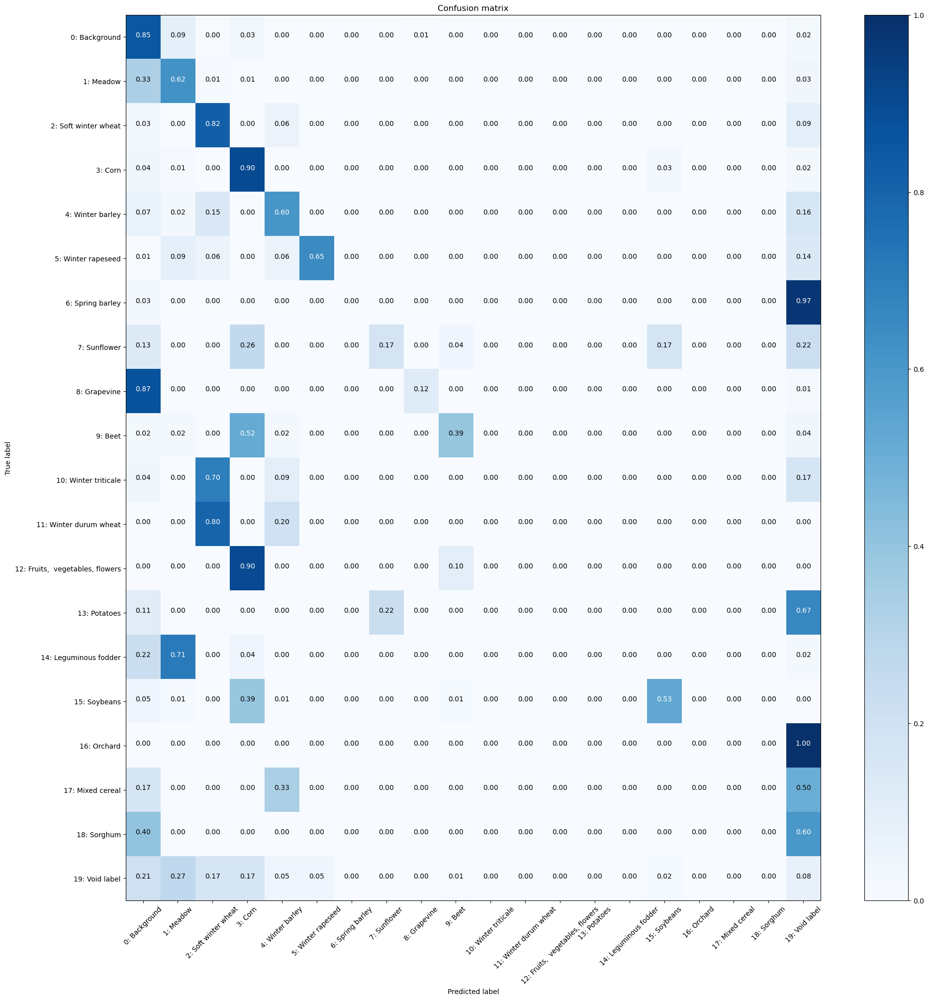

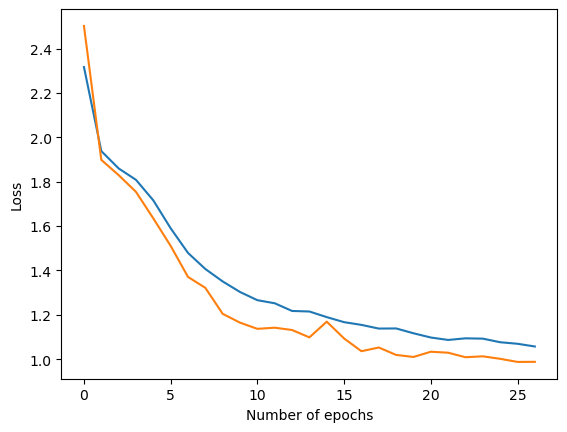

Checking accuracy on validation/test set
Got 4388 / 6400 correct (68.56)
Loss=1.01
Iteration 0, loss = 1.7499
Checking accuracy on validation/test set
Got 4381 / 6400 correct (68.45)
Loss=1.00
Normalized confusion matrix


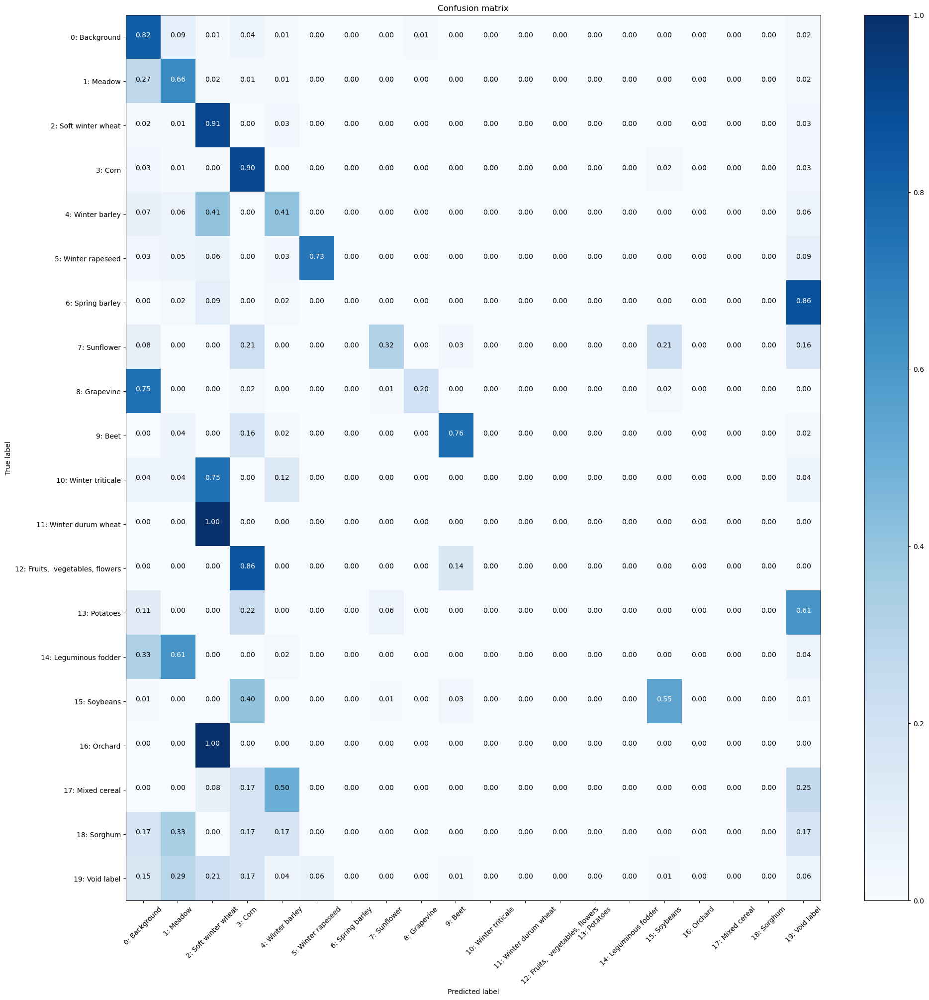


Iteration 100, loss = 0.5970
Checking accuracy on validation/test set
Got 4342 / 6400 correct (67.84)
Loss=1.01
Normalized confusion matrix


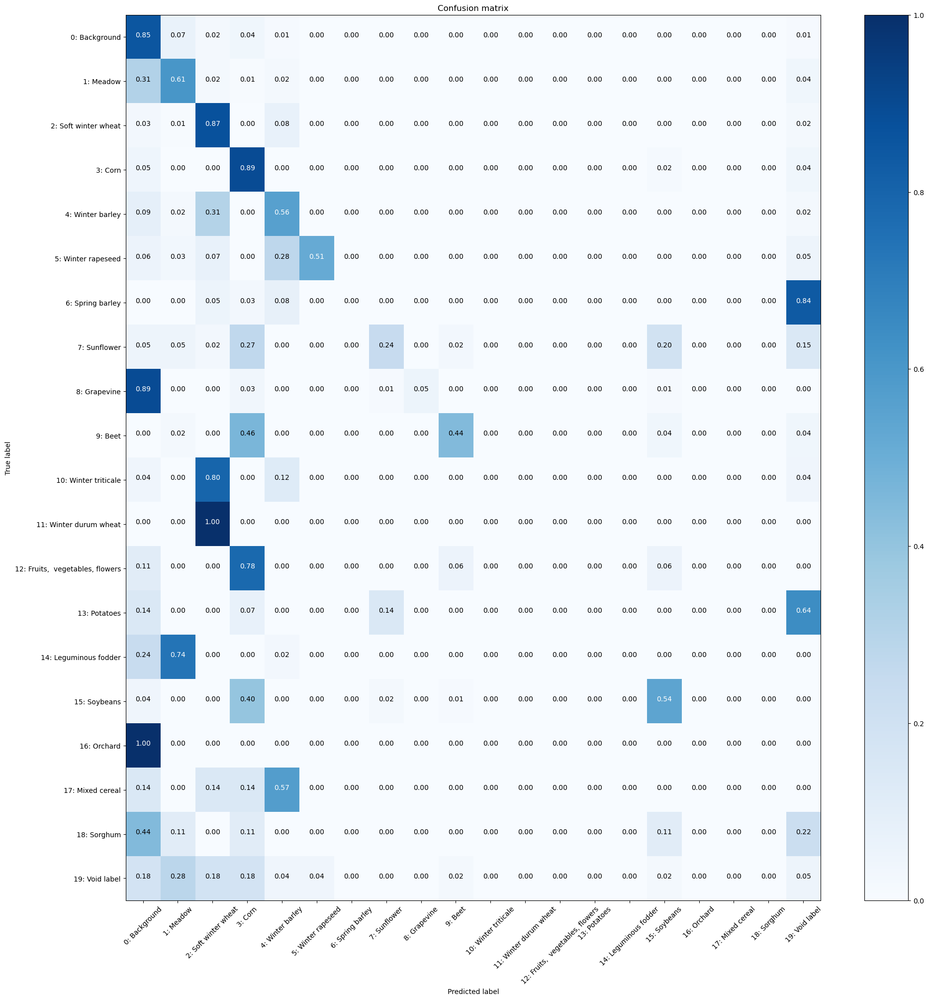

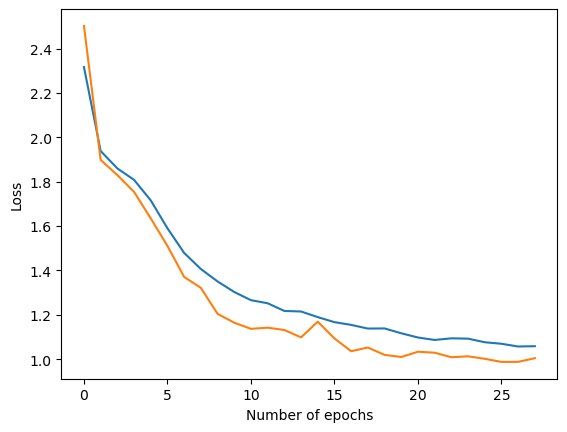

Checking accuracy on validation/test set
Got 4317 / 6400 correct (67.45)
Loss=0.98
Iteration 0, loss = 1.0229
Checking accuracy on validation/test set
Got 4395 / 6400 correct (68.67)
Loss=0.96
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


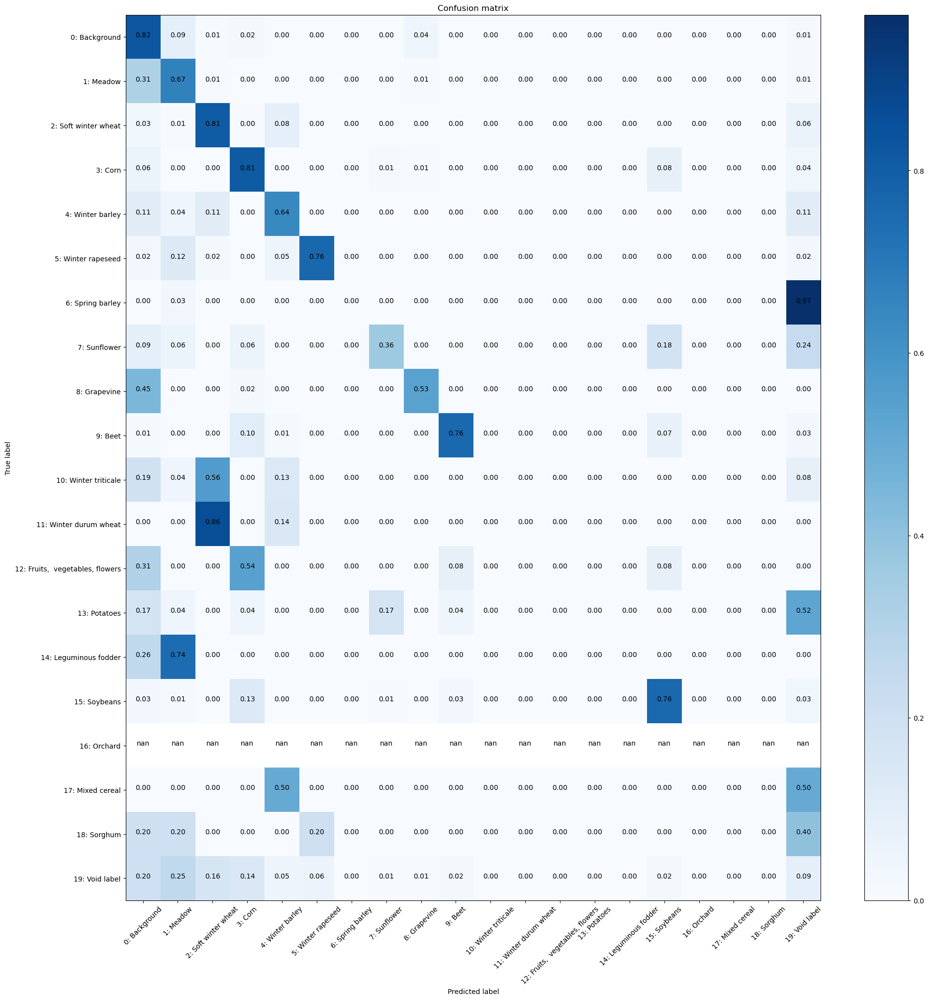


Iteration 100, loss = 1.2743
Checking accuracy on validation/test set
Got 4309 / 6400 correct (67.33)
Loss=1.02
Normalized confusion matrix


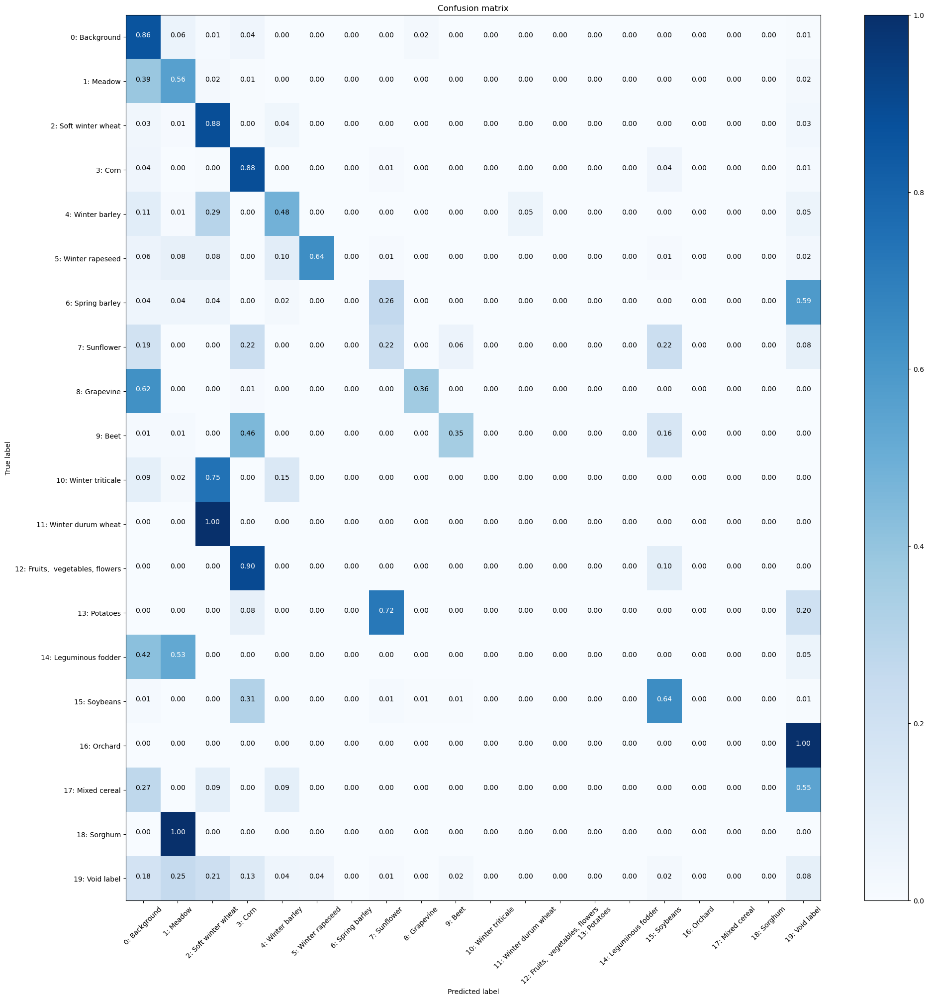

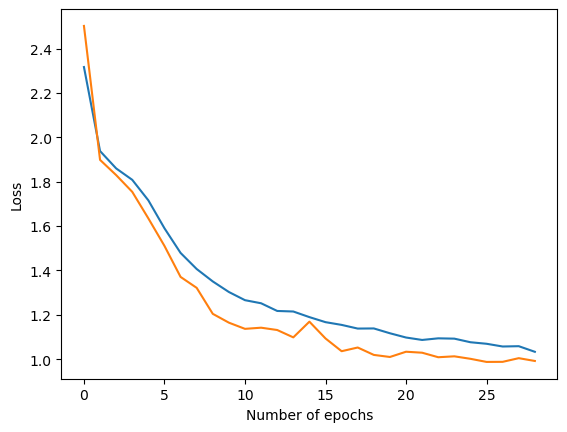

Checking accuracy on validation/test set
Got 4328 / 6400 correct (67.62)
Loss=1.01
Iteration 0, loss = 1.4651
Checking accuracy on validation/test set
Got 4296 / 6400 correct (67.12)
Loss=1.02
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


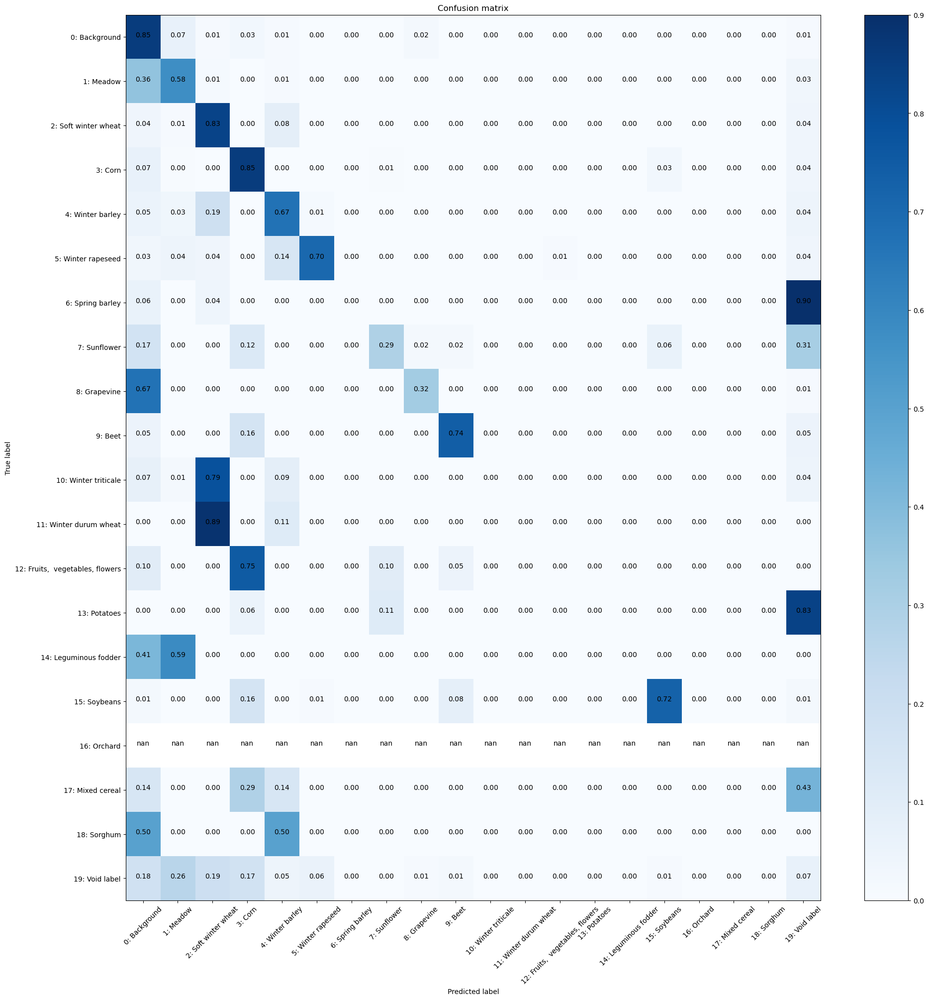


Iteration 100, loss = 1.3541
Checking accuracy on validation/test set
Got 4447 / 6400 correct (69.48)
Loss=0.96
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


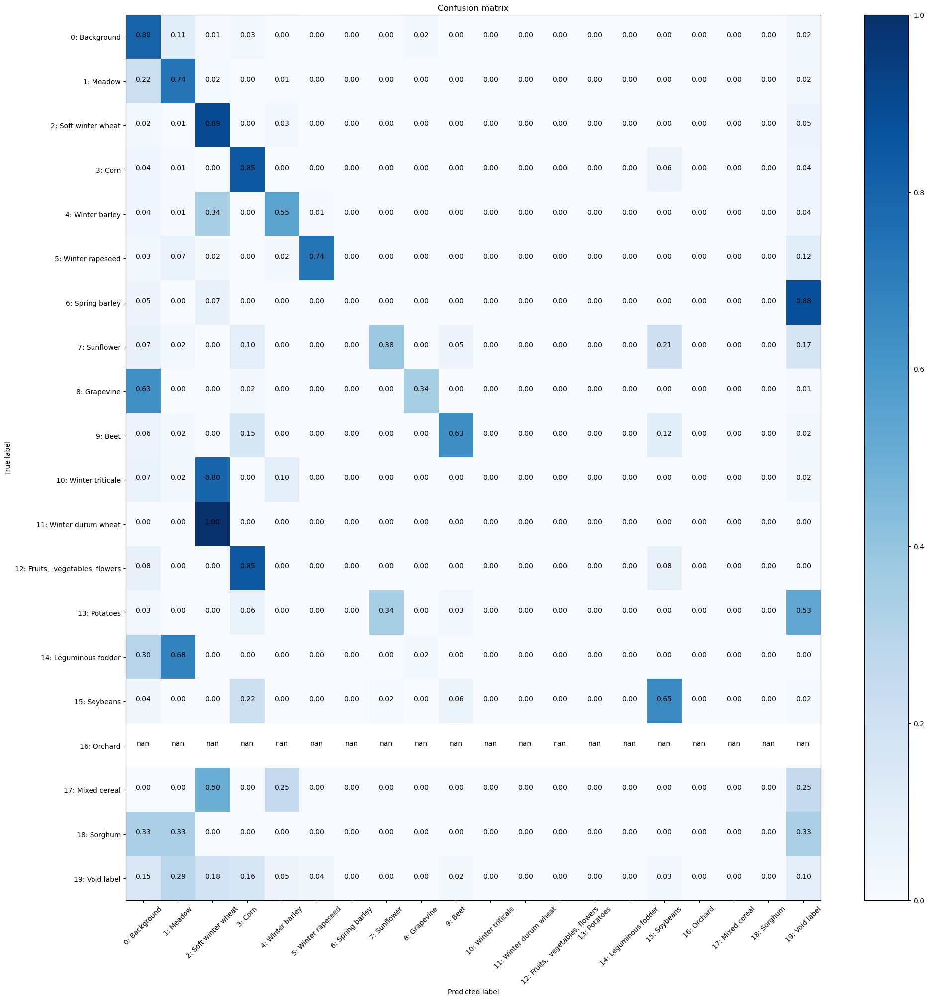

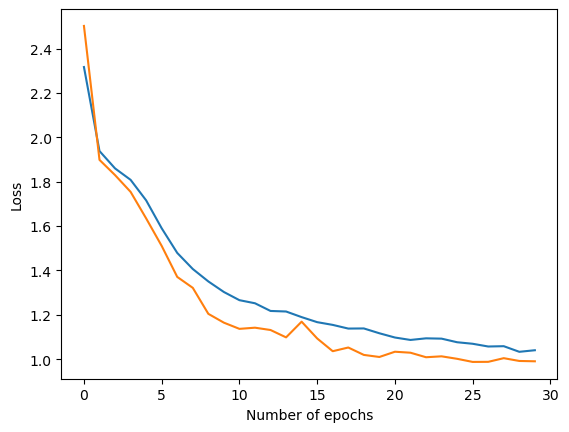

Checking accuracy on validation/test set
Got 4527 / 6400 correct (70.73)
Loss=0.92
Iteration 0, loss = 1.0395
Checking accuracy on validation/test set
Got 4538 / 6400 correct (70.91)
Loss=0.92
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


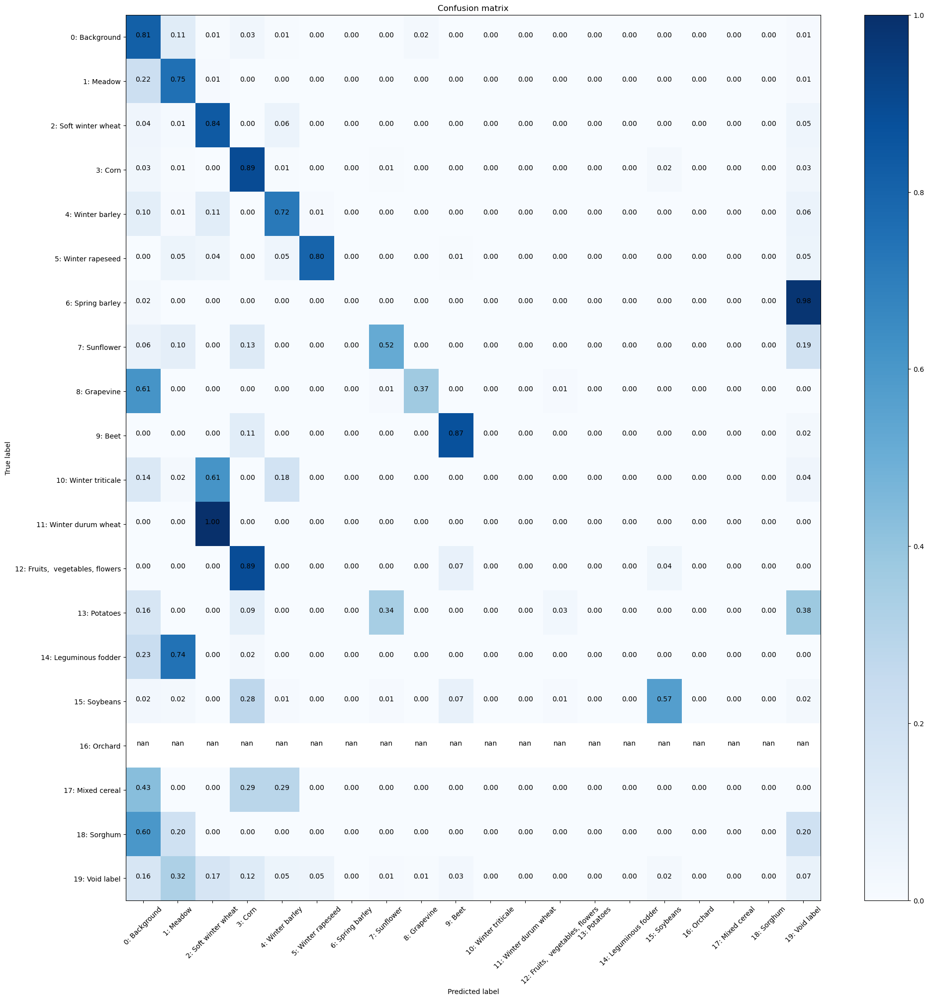


Iteration 100, loss = 1.7360
Checking accuracy on validation/test set
Got 4377 / 6400 correct (68.39)
Loss=0.98
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


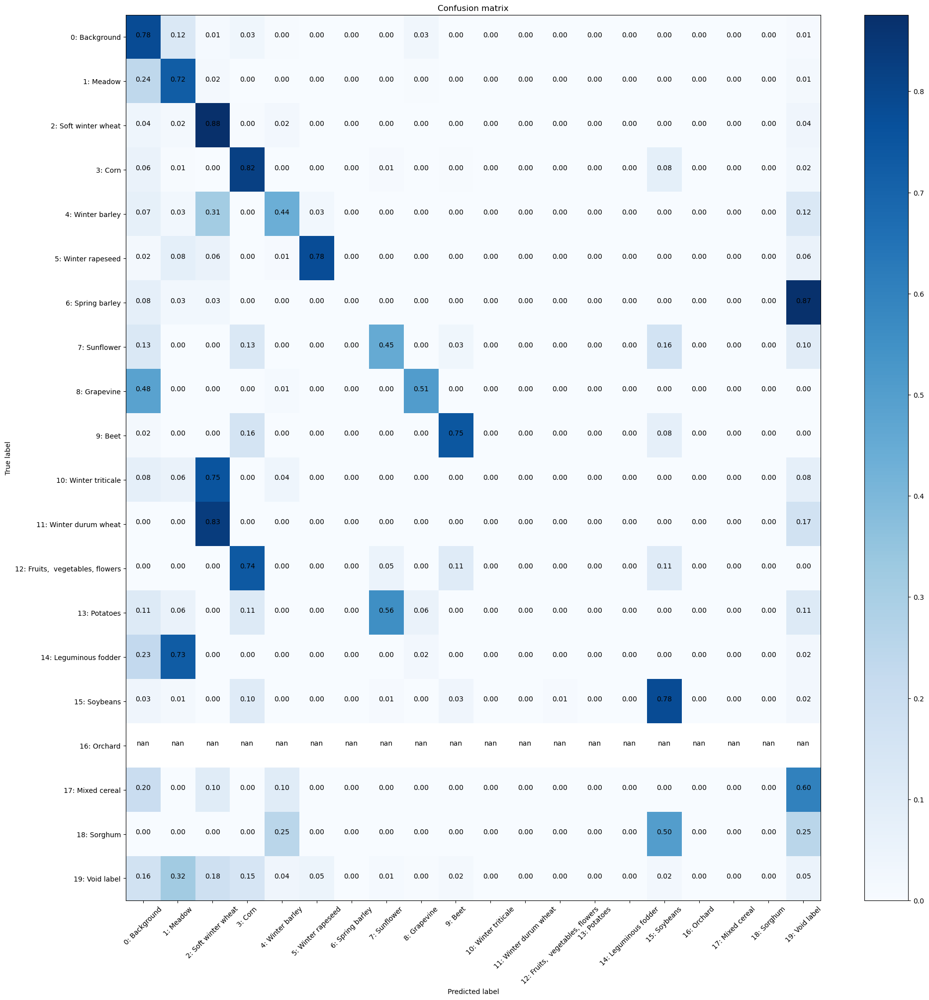

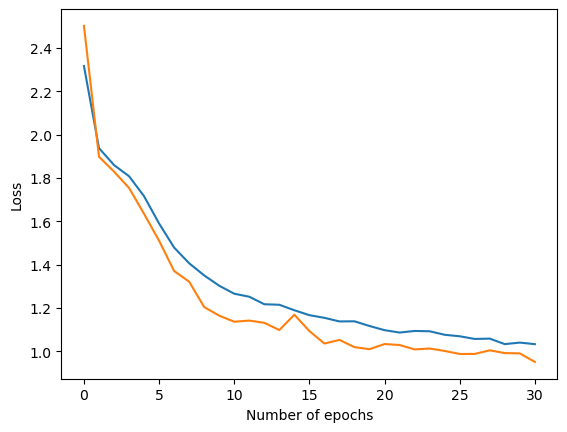

Checking accuracy on validation/test set
Got 4345 / 6400 correct (67.89)
Loss=0.97
Iteration 0, loss = 0.9275
Checking accuracy on validation/test set
Got 4398 / 6400 correct (68.72)
Loss=0.96
Normalized confusion matrix


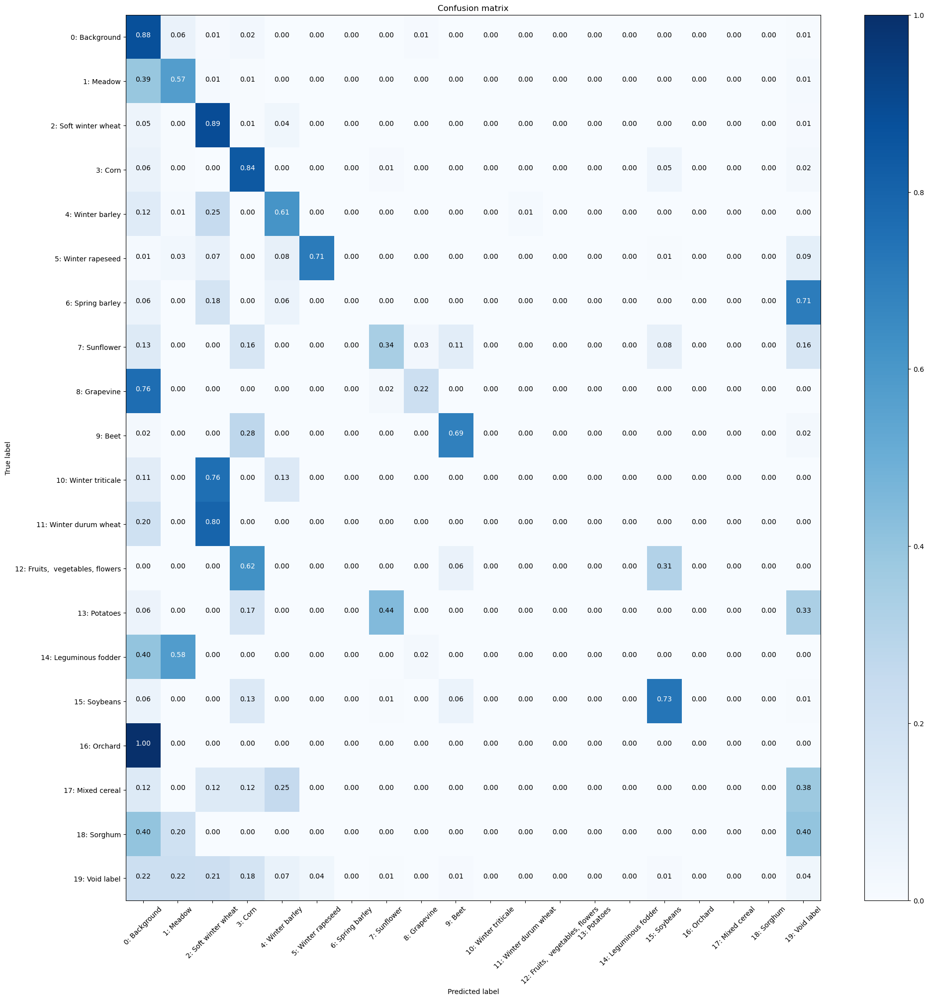


Iteration 100, loss = 1.3653
Checking accuracy on validation/test set
Got 4407 / 6400 correct (68.86)
Loss=0.97
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


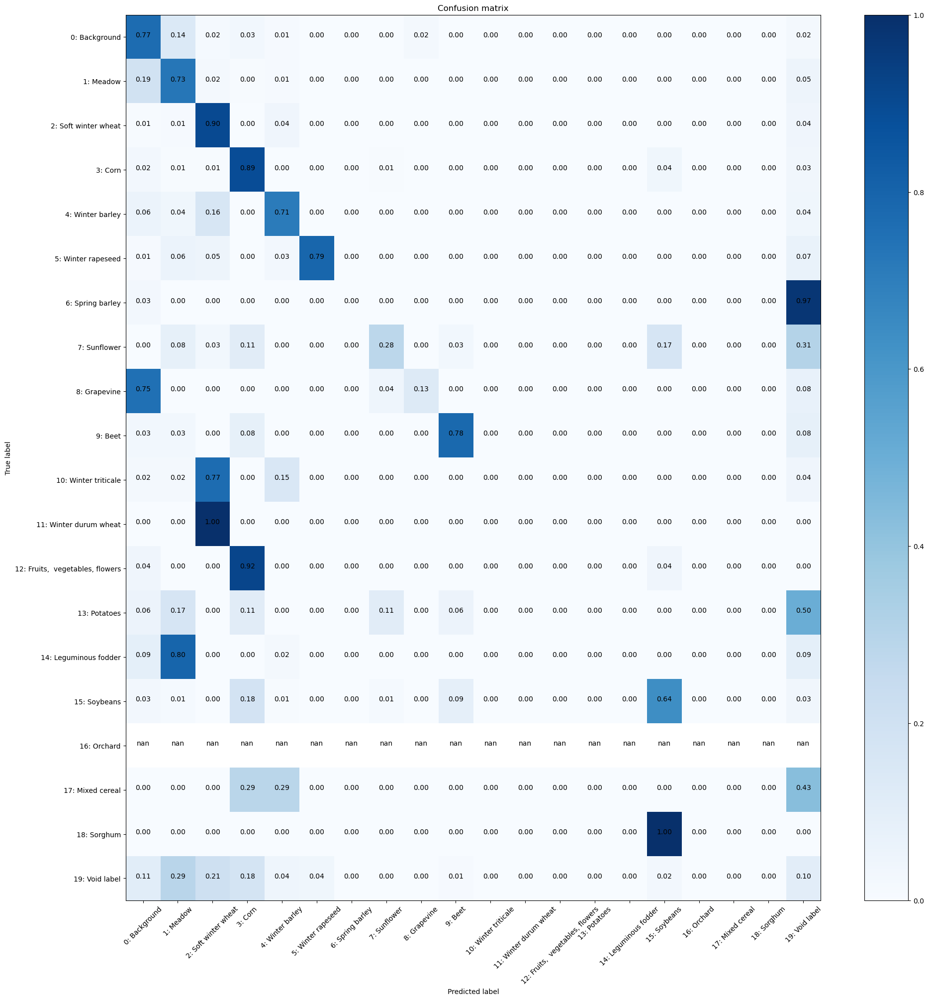

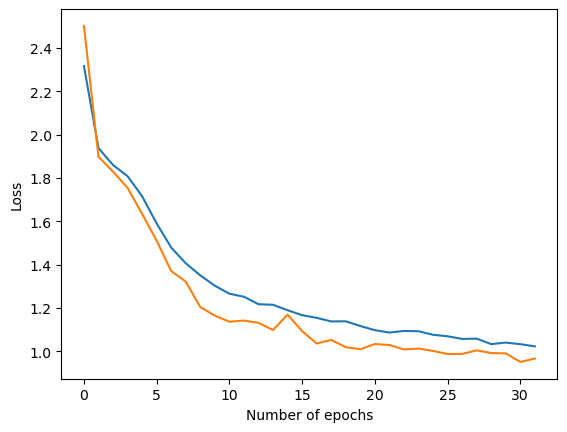

Checking accuracy on validation/test set
Got 4445 / 6400 correct (69.45)
Loss=0.95
Iteration 0, loss = 1.0159
Checking accuracy on validation/test set
Got 4394 / 6400 correct (68.66)
Loss=0.96
Normalized confusion matrix


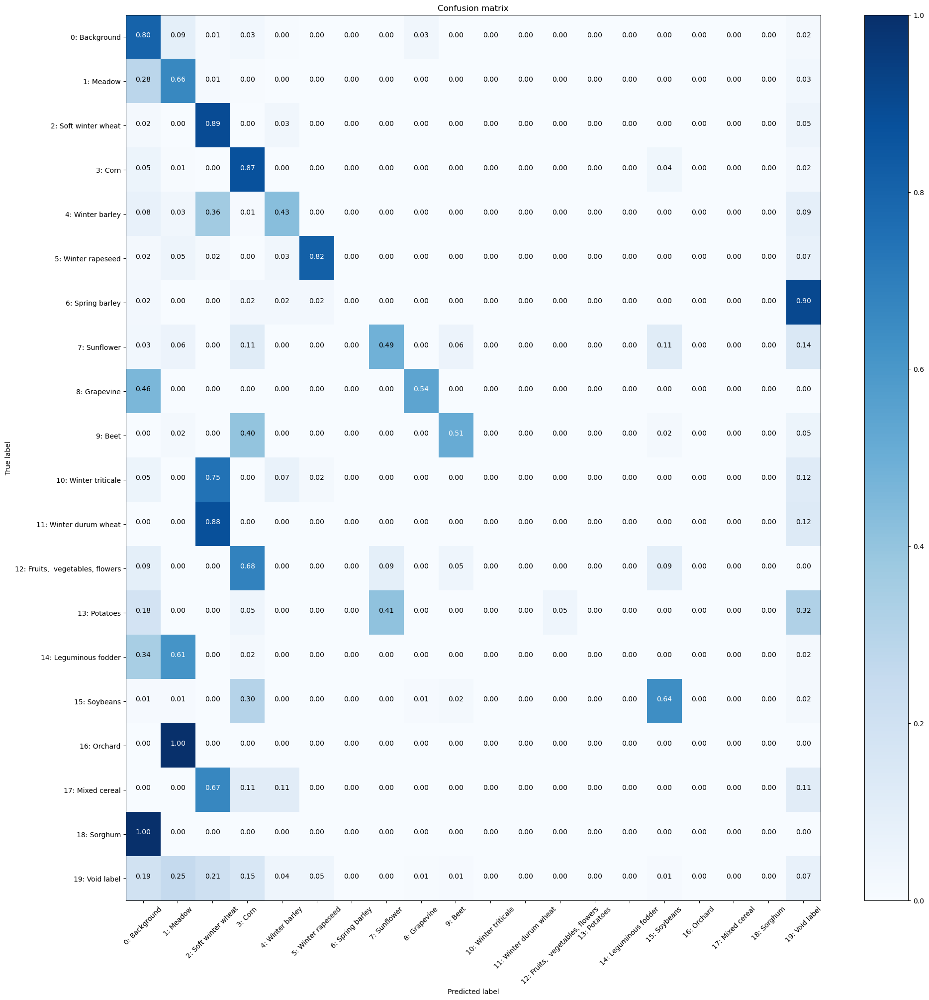


Iteration 100, loss = 0.9424
Checking accuracy on validation/test set
Got 4496 / 6400 correct (70.25)
Loss=0.91
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


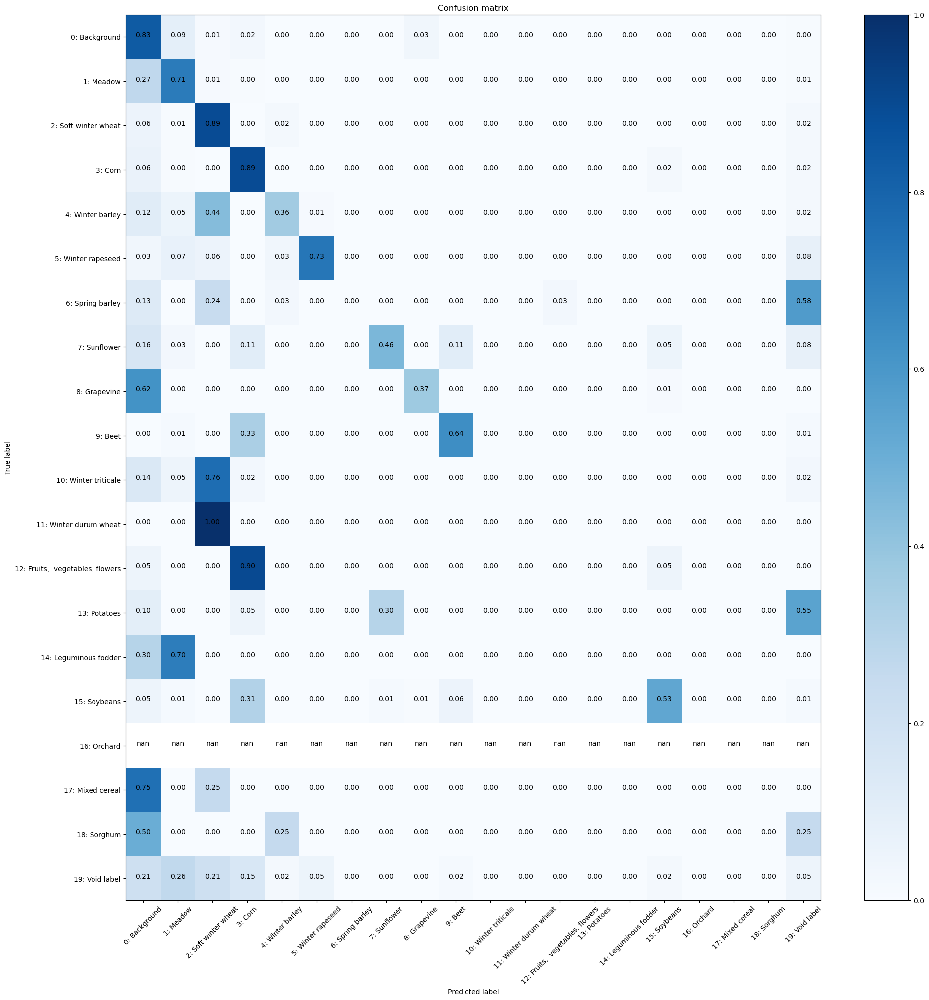

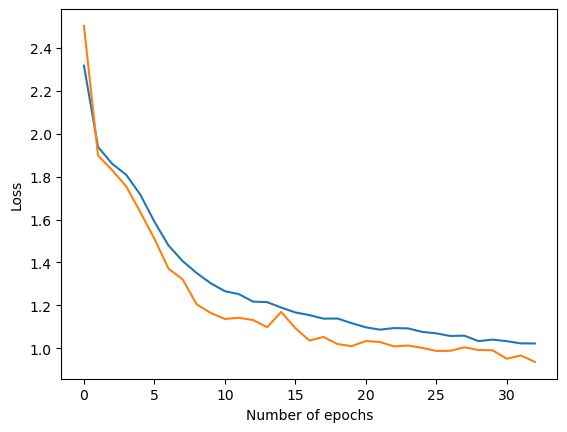

Checking accuracy on validation/test set
Got 4460 / 6400 correct (69.69)
Loss=0.95
Iteration 0, loss = 0.9808
Checking accuracy on validation/test set
Got 4474 / 6400 correct (69.91)
Loss=0.95
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


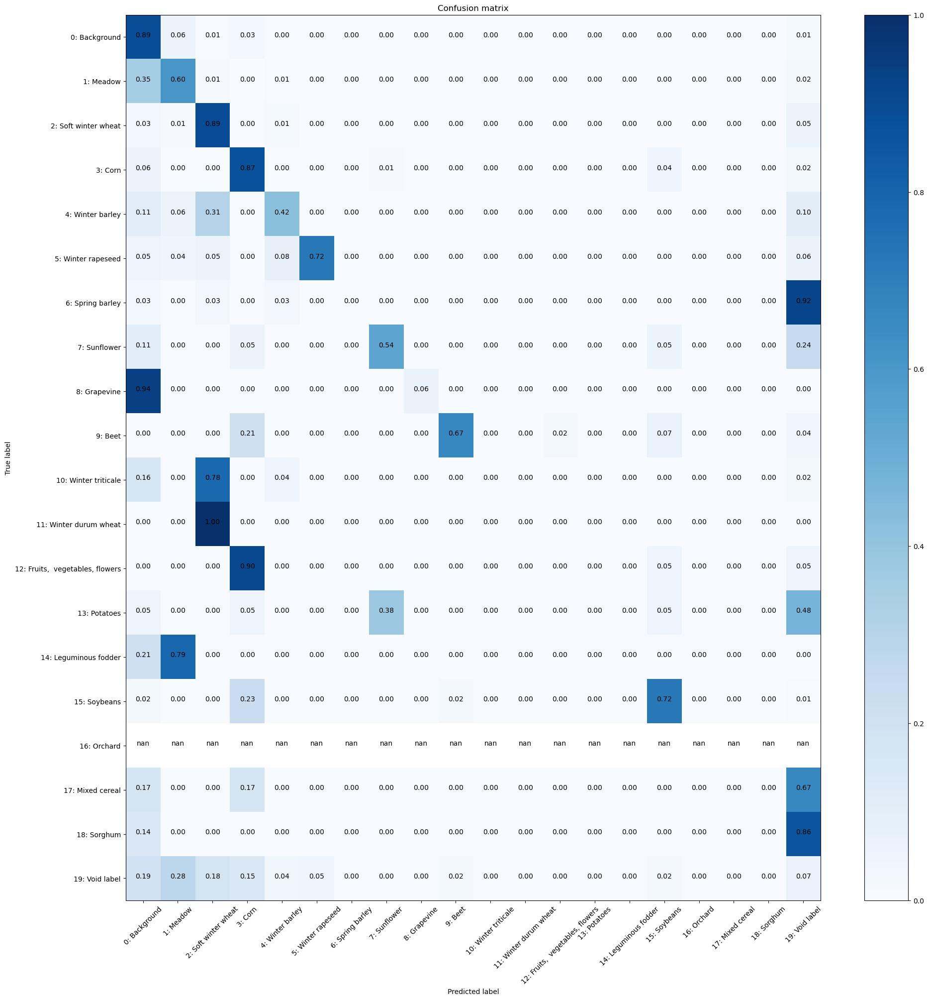


Iteration 100, loss = 0.9700
Checking accuracy on validation/test set
Got 4415 / 6400 correct (68.98)
Loss=0.95
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


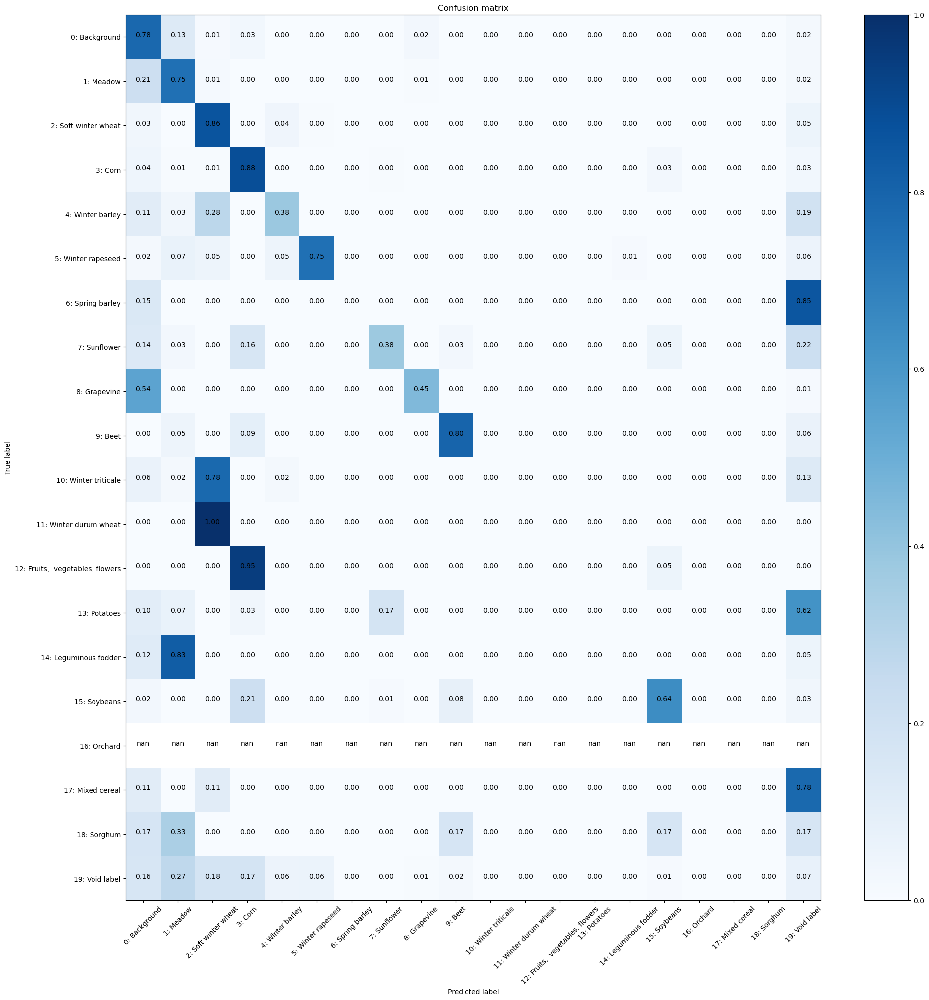

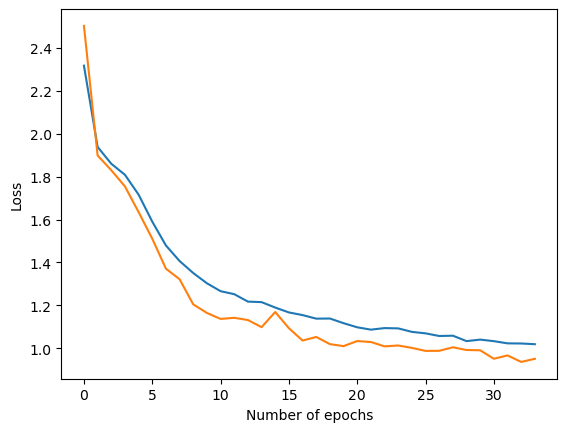

Checking accuracy on validation/test set
Got 4436 / 6400 correct (69.31)
Loss=0.95
Iteration 0, loss = 0.7463
Checking accuracy on validation/test set
Got 4389 / 6400 correct (68.58)
Loss=0.98
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


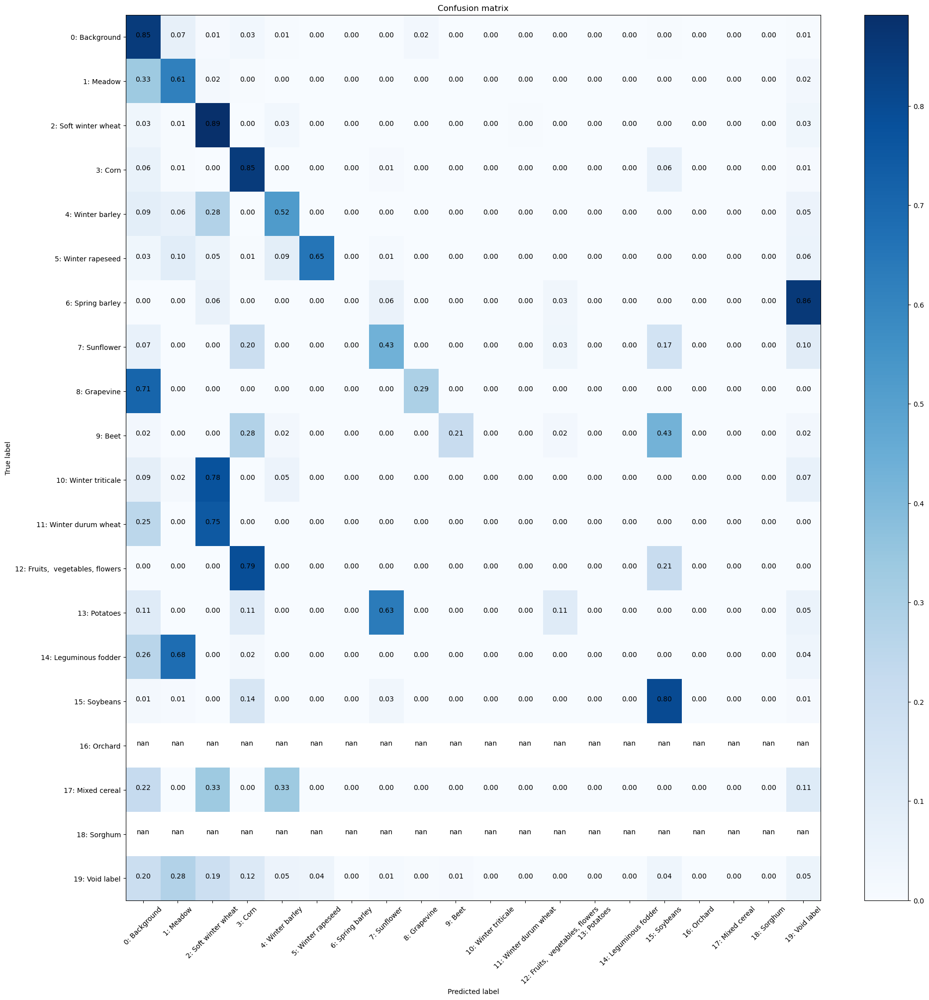


Iteration 100, loss = 0.7934
Checking accuracy on validation/test set
Got 4417 / 6400 correct (69.02)
Loss=0.96
Normalized confusion matrix


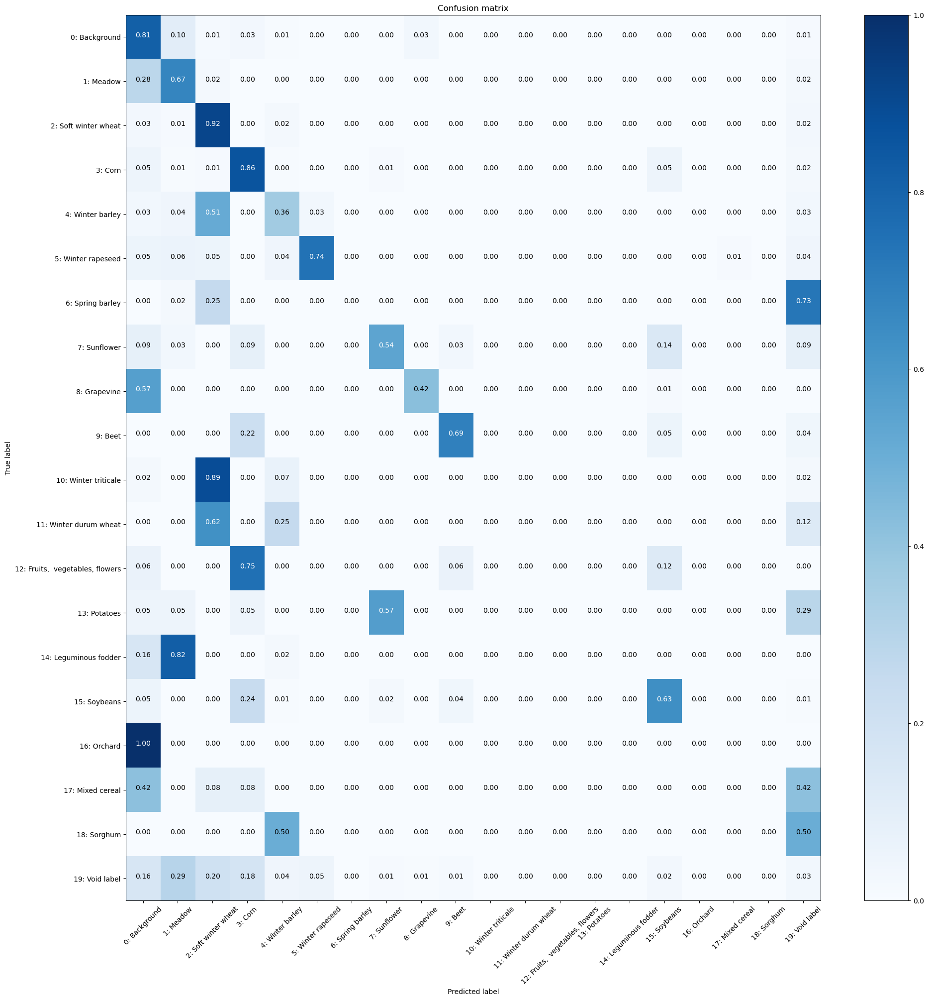

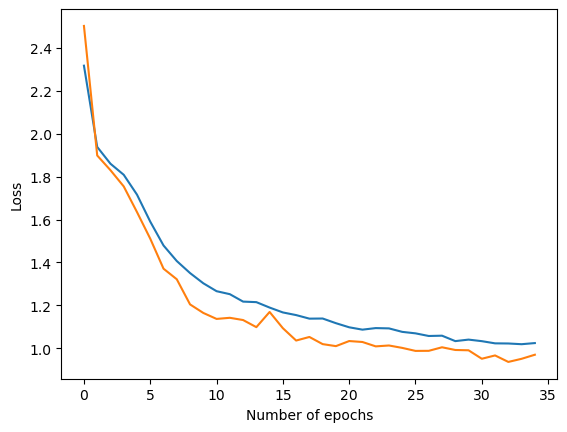

Checking accuracy on validation/test set
Got 4406 / 6400 correct (68.84)
Loss=0.97
Iteration 0, loss = 0.9113
Checking accuracy on validation/test set
Got 4375 / 6400 correct (68.36)
Loss=0.97
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


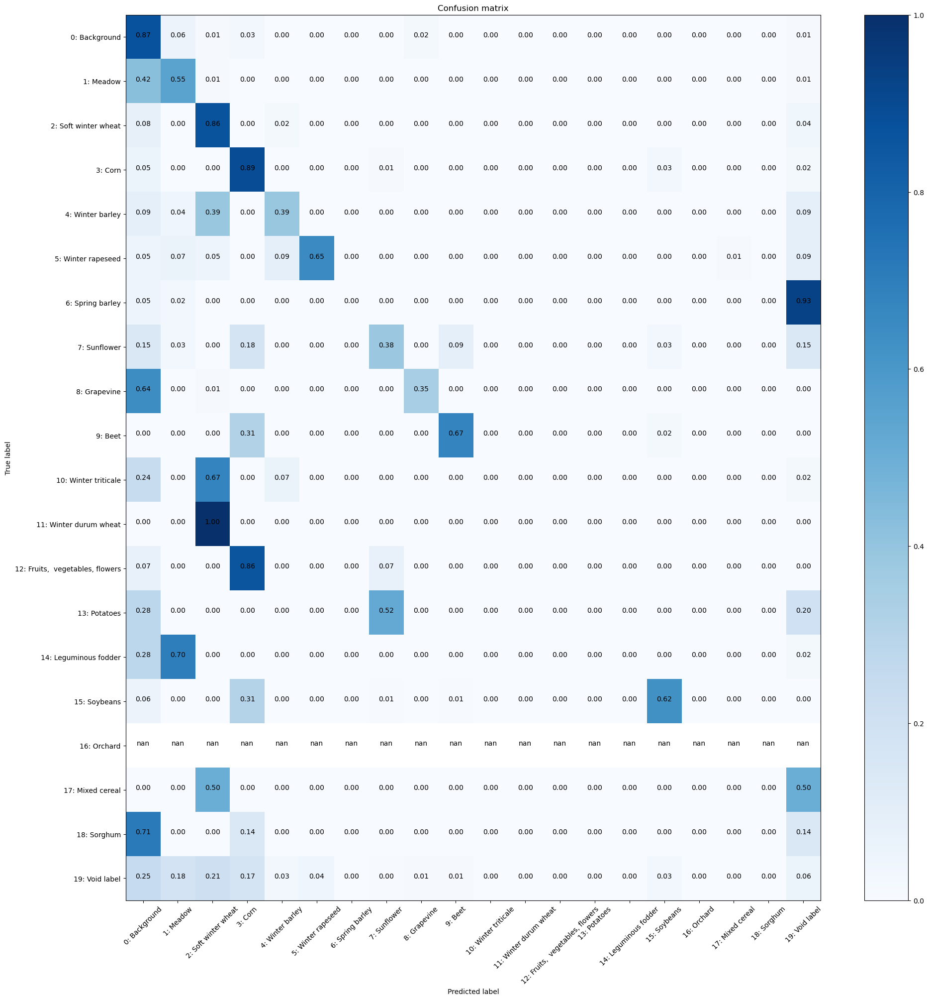


Iteration 100, loss = 0.7970
Checking accuracy on validation/test set
Got 4388 / 6400 correct (68.56)
Loss=0.97
Normalized confusion matrix


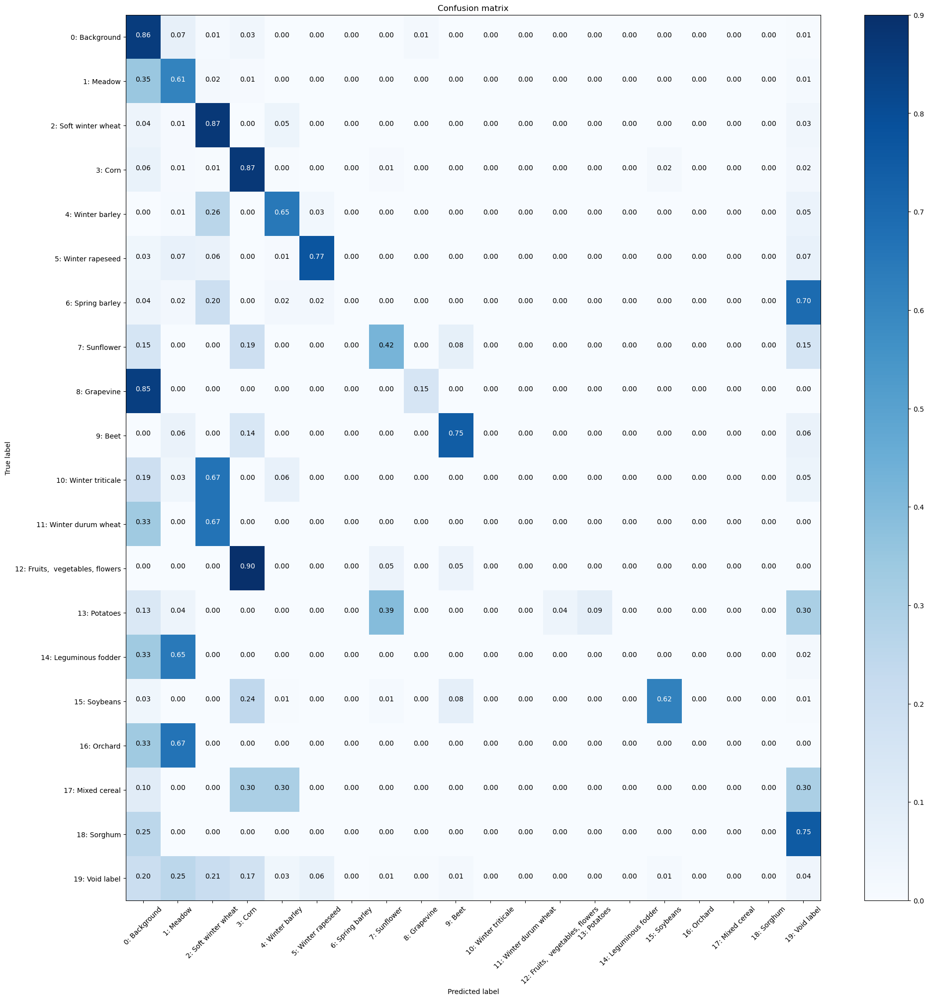

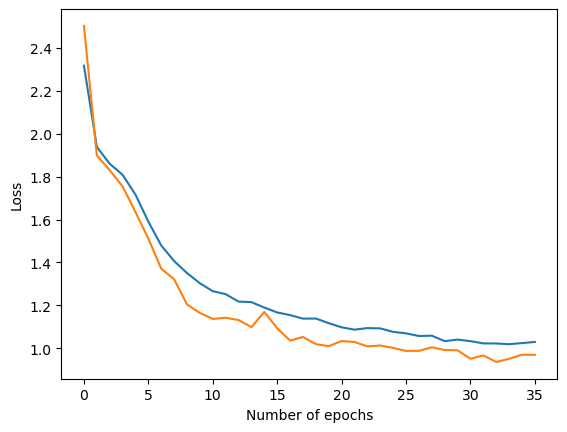

Checking accuracy on validation/test set
Got 4318 / 6400 correct (67.47)
Loss=0.97
Iteration 0, loss = 1.2718
Checking accuracy on validation/test set
Got 4361 / 6400 correct (68.14)
Loss=0.98
Normalized confusion matrix


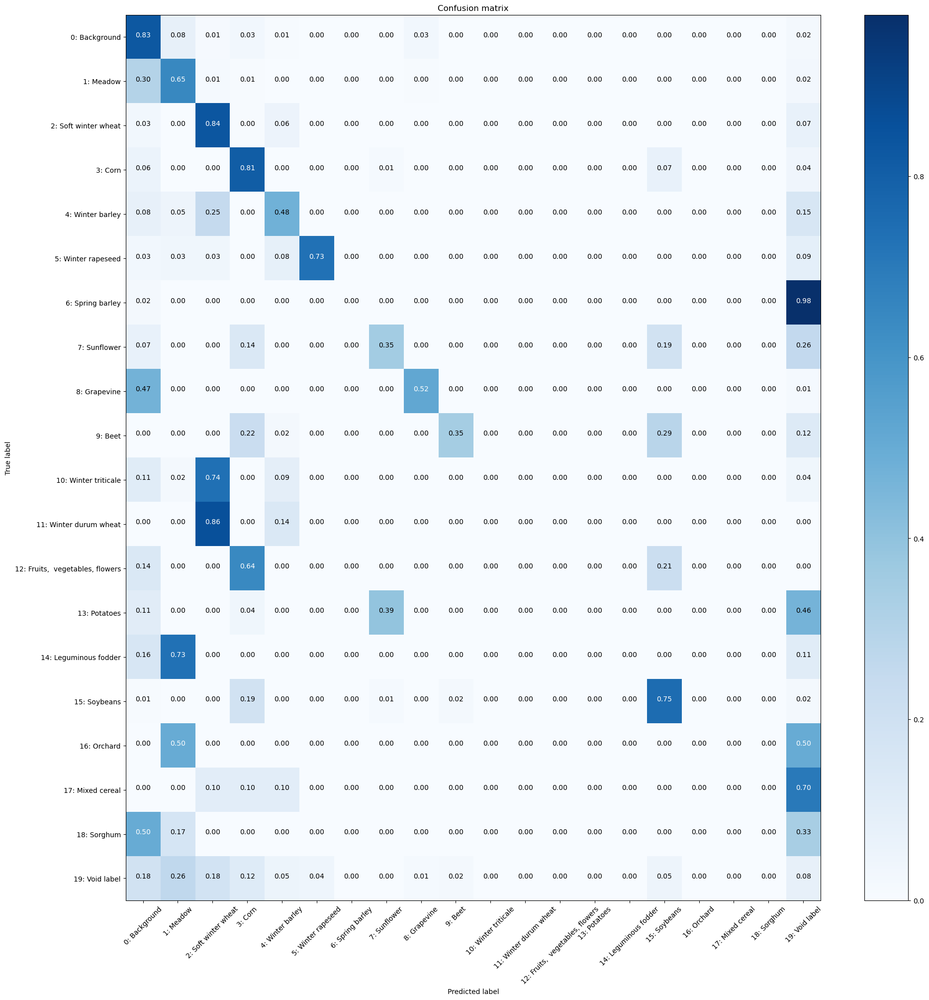


Iteration 100, loss = 0.3966
Checking accuracy on validation/test set
Got 4476 / 6400 correct (69.94)
Loss=0.97
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


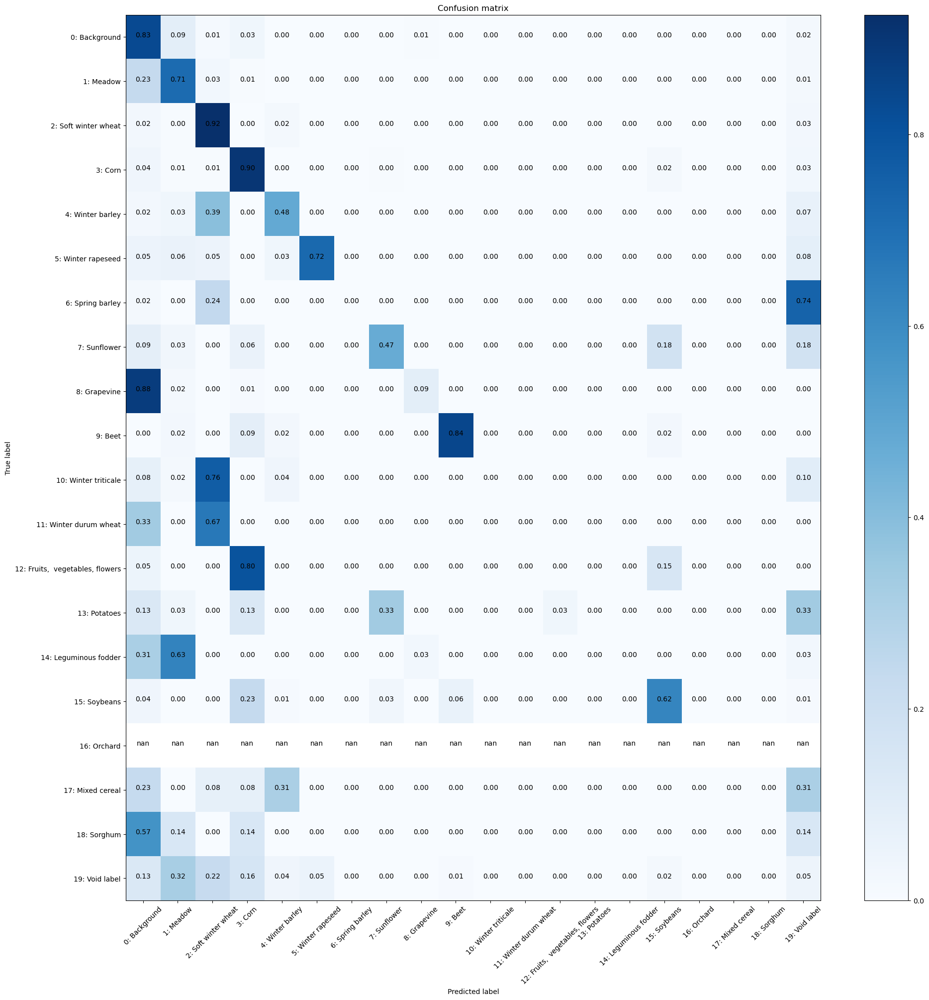

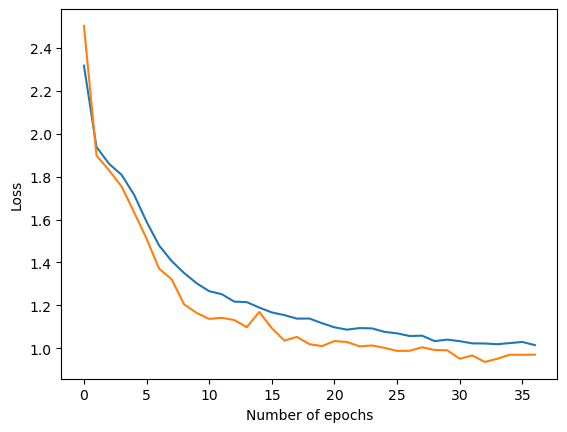

Checking accuracy on validation/test set
Got 4485 / 6400 correct (70.08)
Loss=0.94
Iteration 0, loss = 0.8974
Checking accuracy on validation/test set
Got 4481 / 6400 correct (70.02)
Loss=0.93
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


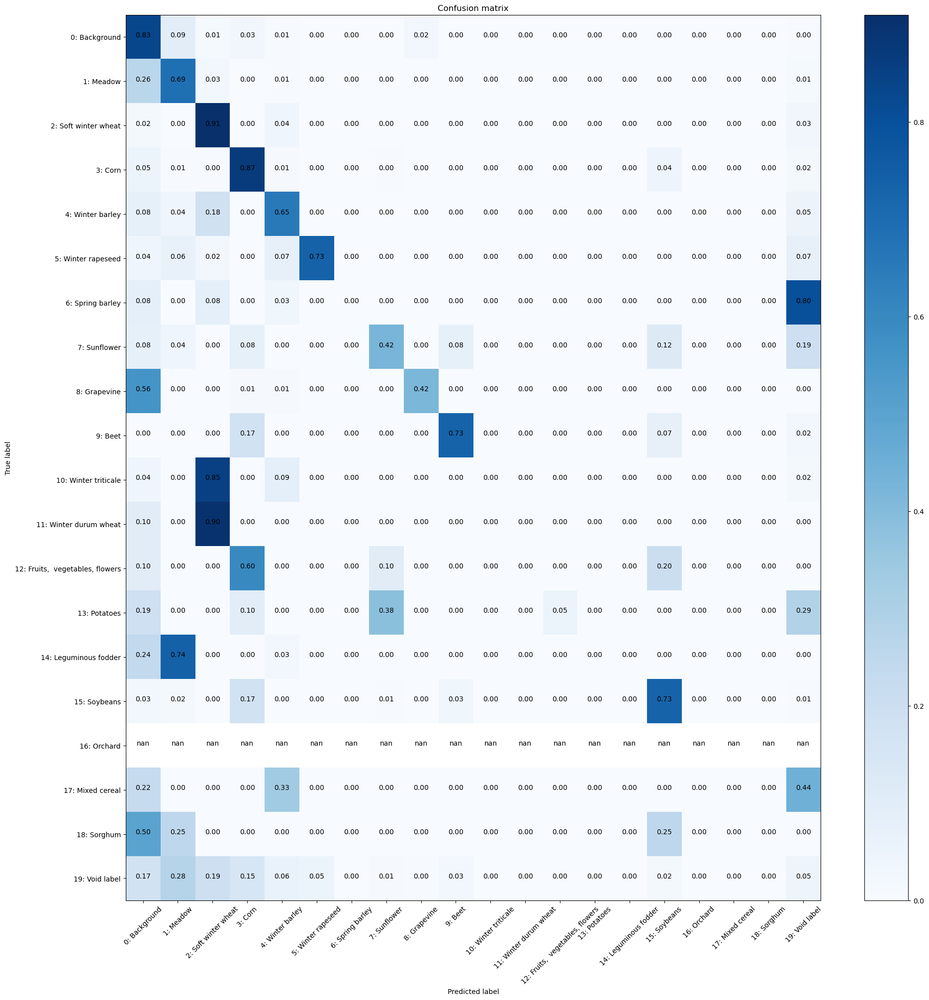


Iteration 100, loss = 1.3455
Checking accuracy on validation/test set
Got 4419 / 6400 correct (69.05)
Loss=0.95
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


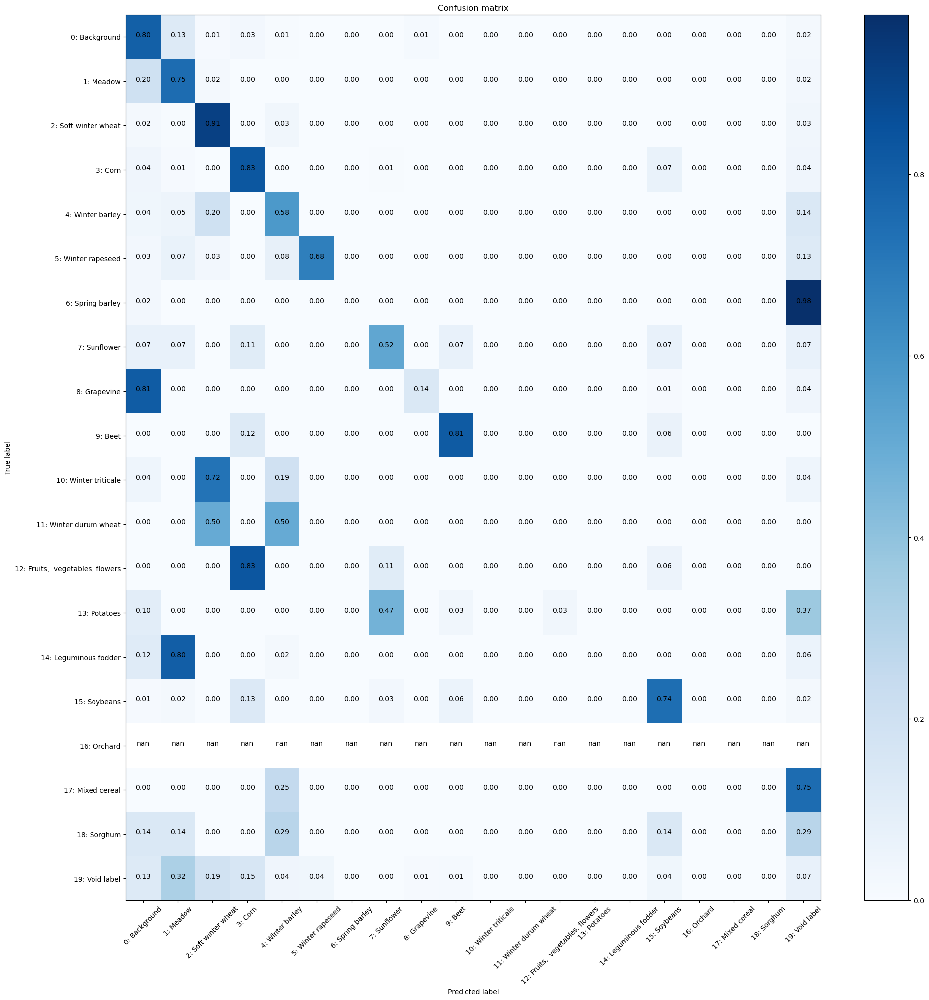

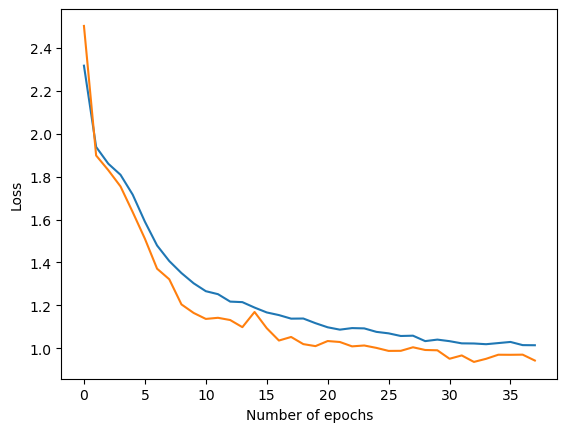

Checking accuracy on validation/test set
Got 4553 / 6400 correct (71.14)
Loss=0.90
Iteration 0, loss = 0.9687
Checking accuracy on validation/test set
Got 4494 / 6400 correct (70.22)
Loss=0.93
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


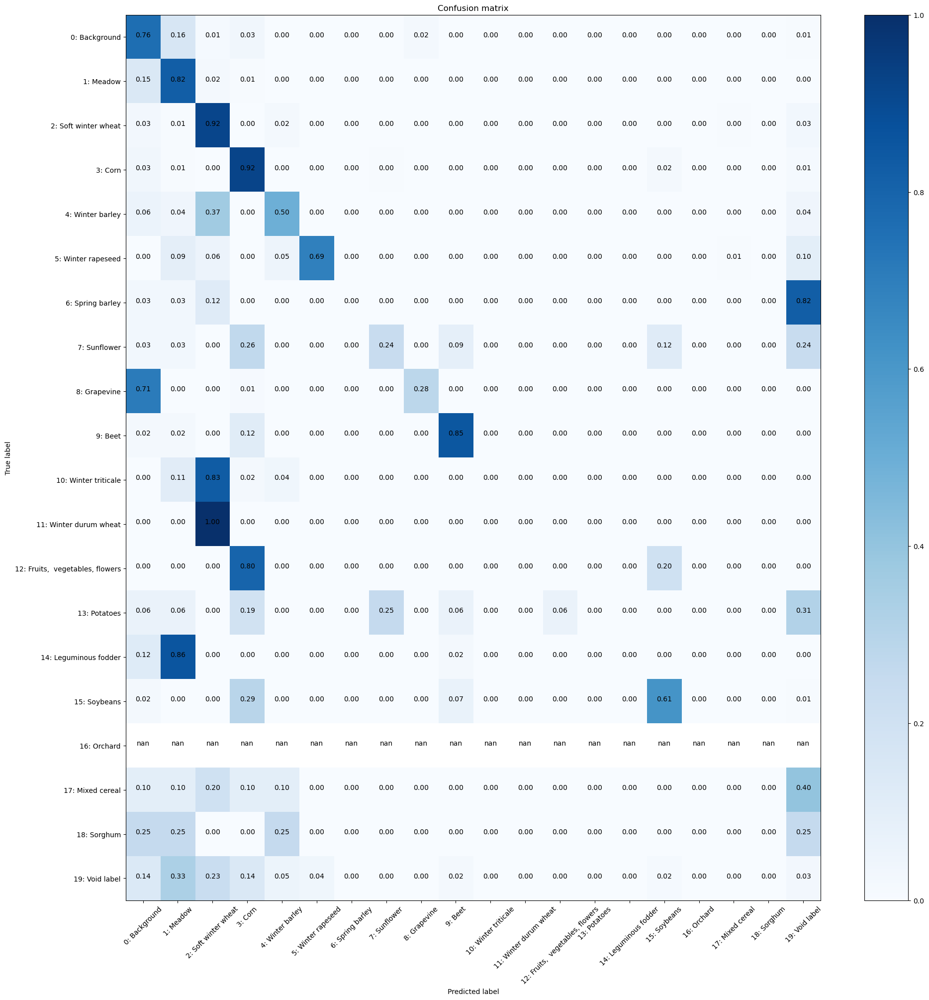


Iteration 100, loss = 0.7159
Checking accuracy on validation/test set
Got 4276 / 6400 correct (66.81)
Loss=0.99
Normalized confusion matrix


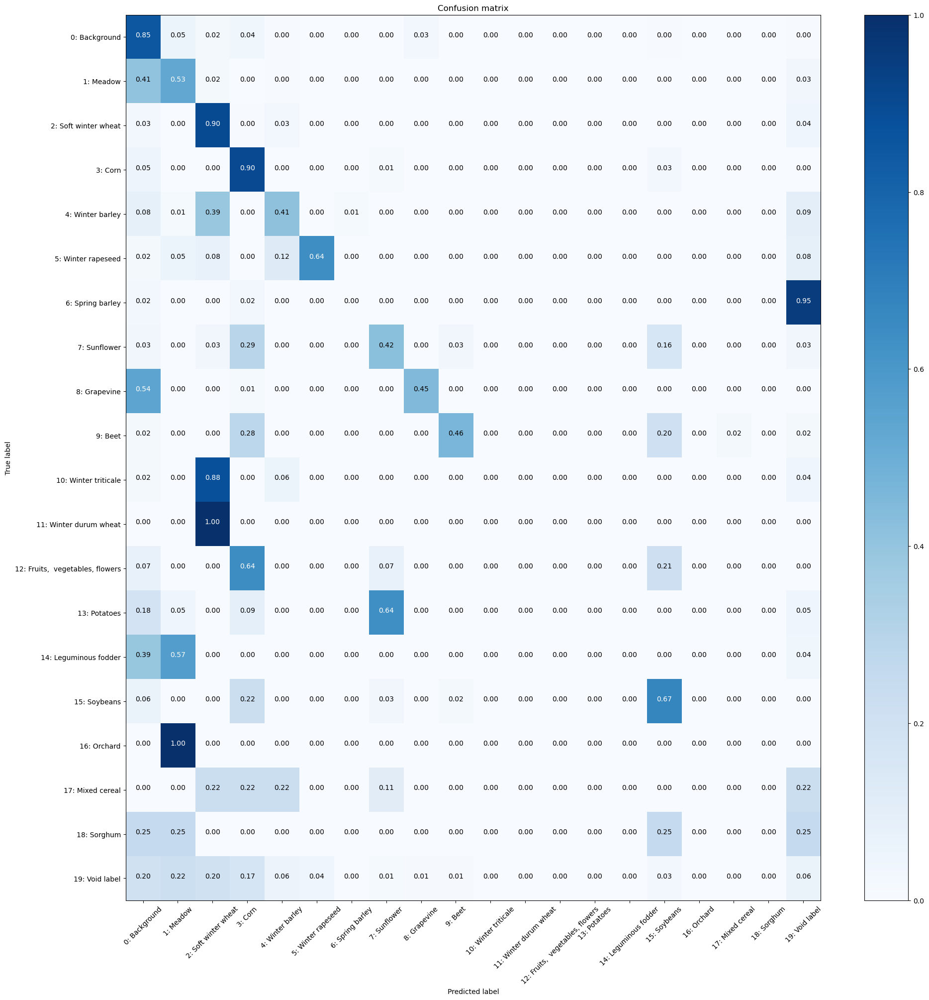

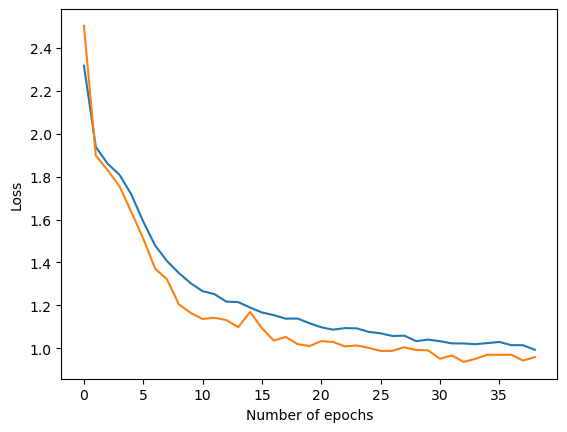

Checking accuracy on validation/test set
Got 4445 / 6400 correct (69.45)
Loss=0.97
Iteration 0, loss = 1.0706
Checking accuracy on validation/test set
Got 4315 / 6400 correct (67.42)
Loss=1.00
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


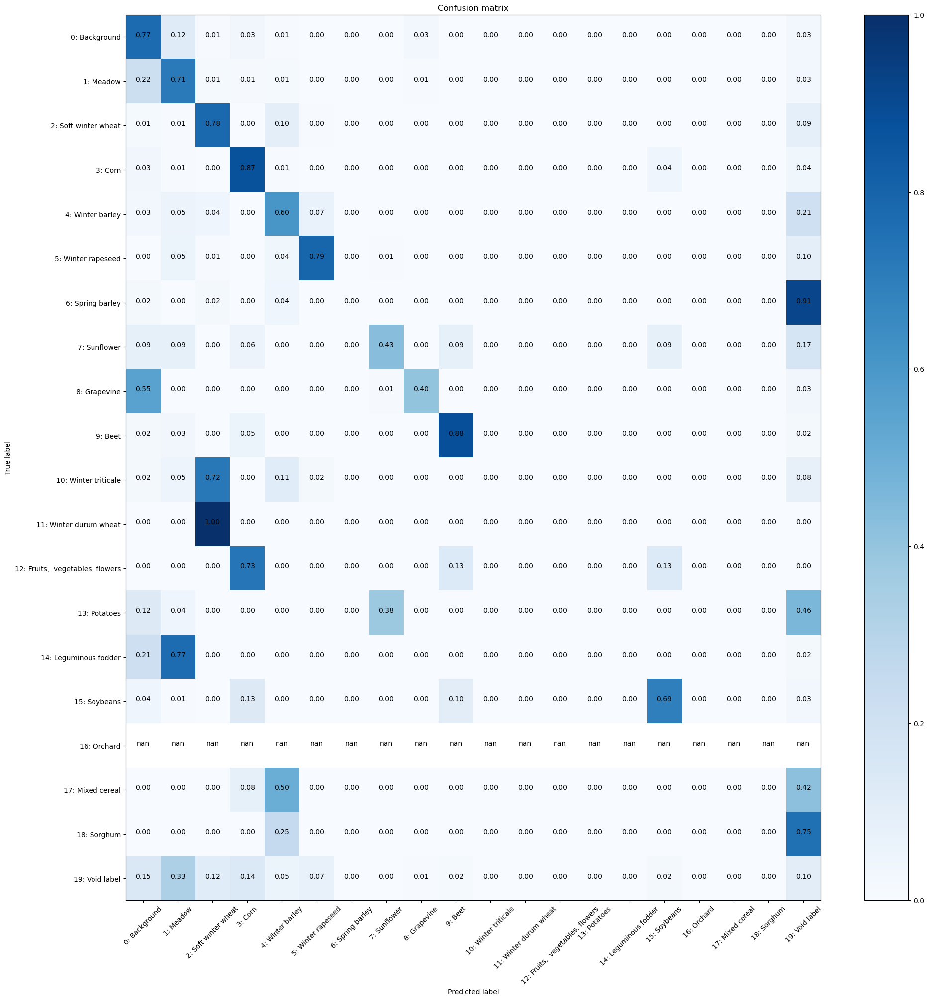


Iteration 100, loss = 1.1080
Checking accuracy on validation/test set
Got 4499 / 6400 correct (70.30)
Loss=0.93
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


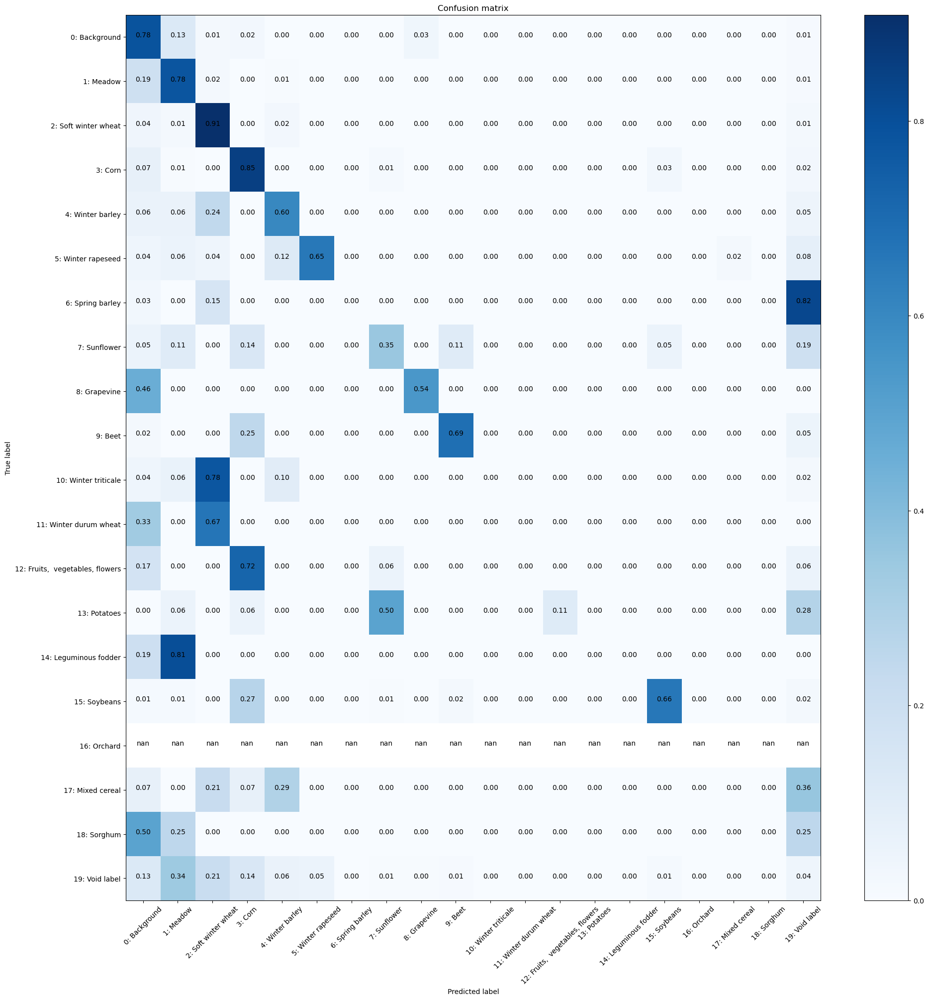

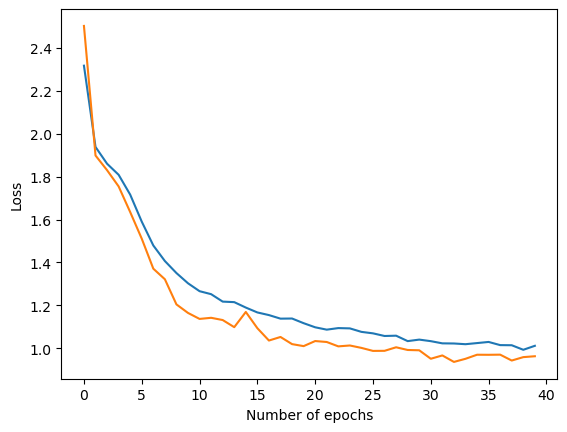

Checking accuracy on validation/test set
Got 4433 / 6400 correct (69.27)
Loss=0.95
Iteration 0, loss = 1.5577
Checking accuracy on validation/test set
Got 4402 / 6400 correct (68.78)
Loss=0.95
Normalized confusion matrix


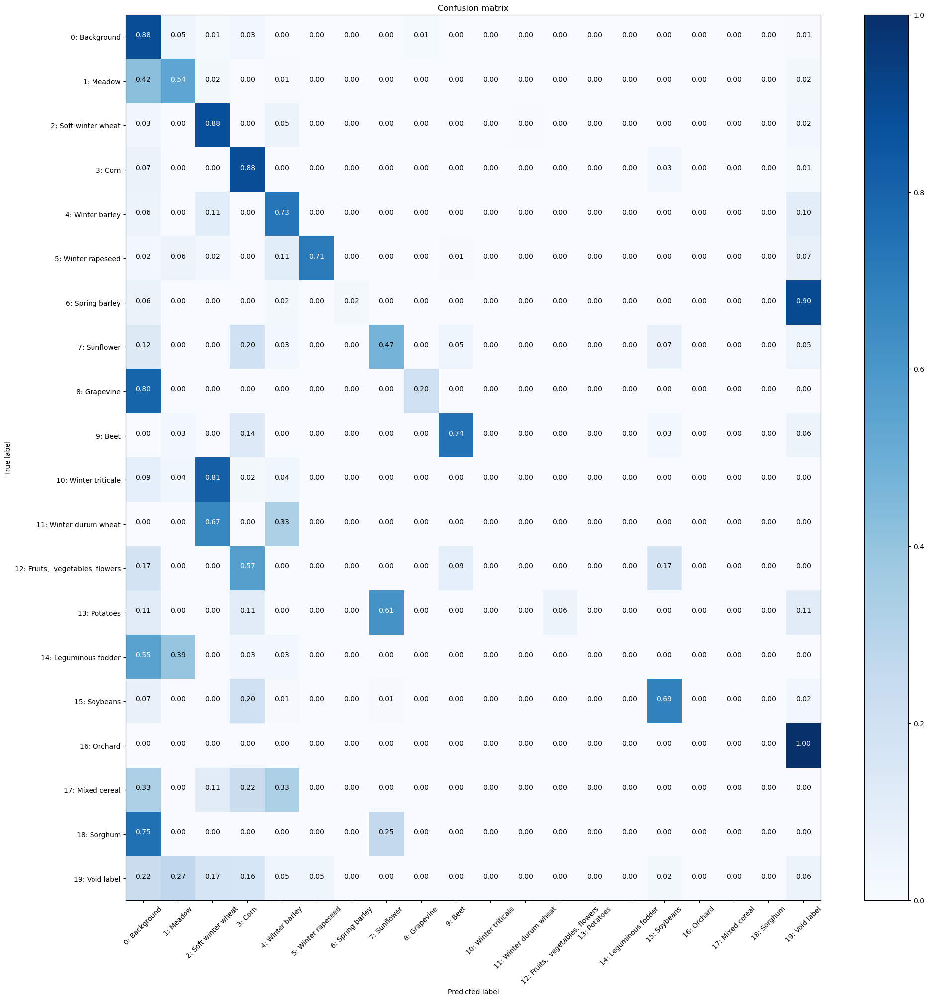


Iteration 100, loss = 0.4728
Checking accuracy on validation/test set
Got 4527 / 6400 correct (70.73)
Loss=0.92
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


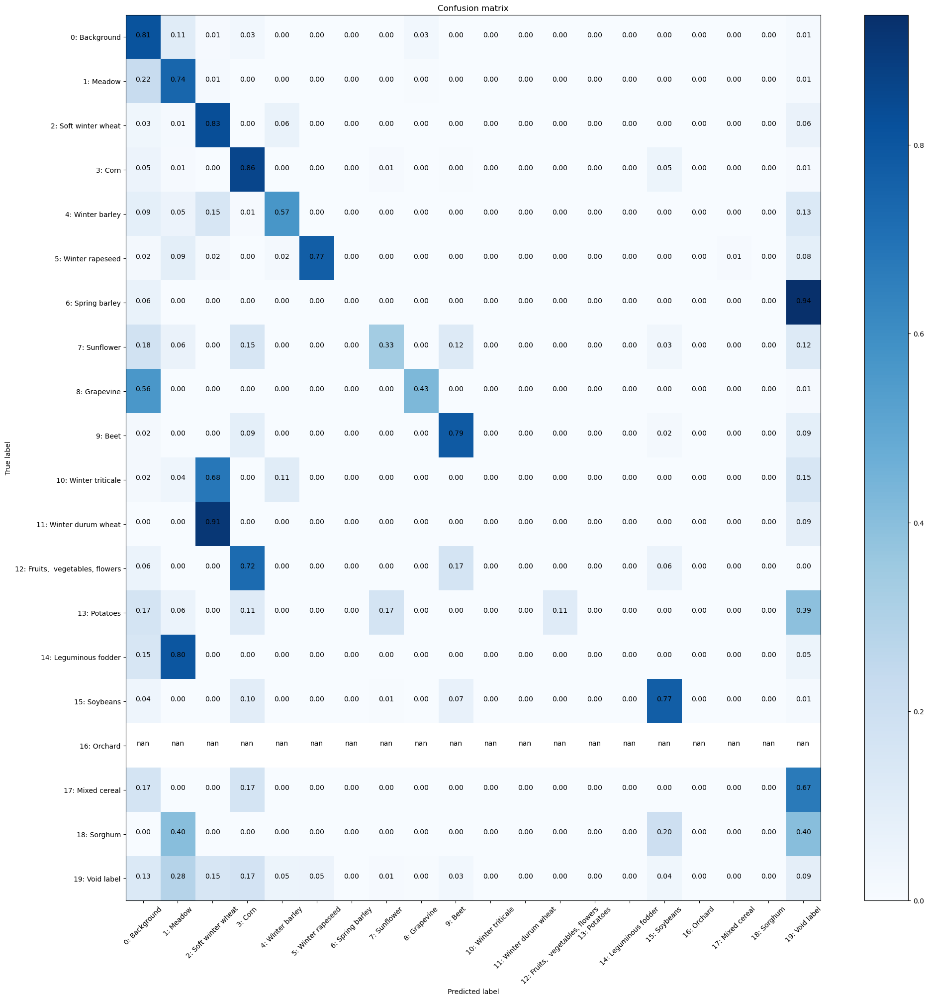

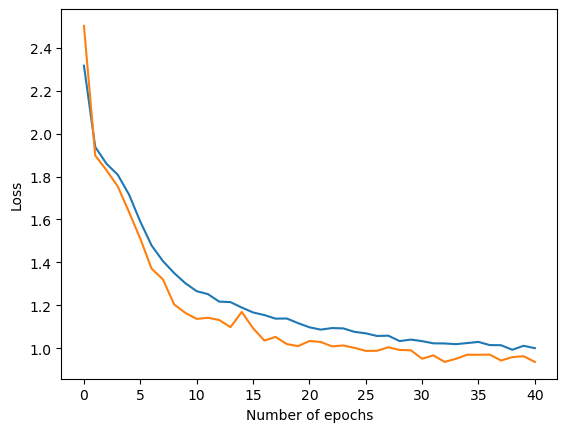

Checking accuracy on validation/test set
Got 4503 / 6400 correct (70.36)
Loss=0.91
Iteration 0, loss = 1.3197
Checking accuracy on validation/test set
Got 4515 / 6400 correct (70.55)
Loss=0.91
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


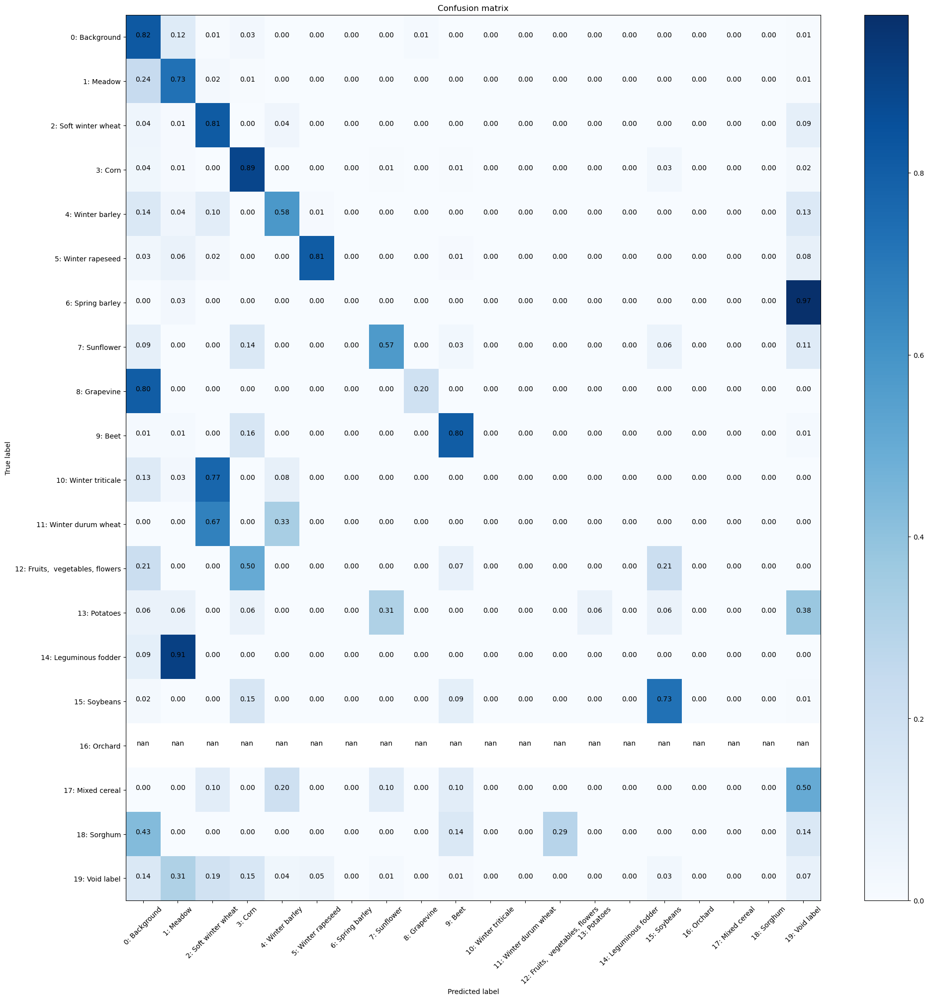


Iteration 100, loss = 0.8702
Checking accuracy on validation/test set
Got 4473 / 6400 correct (69.89)
Loss=0.94
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


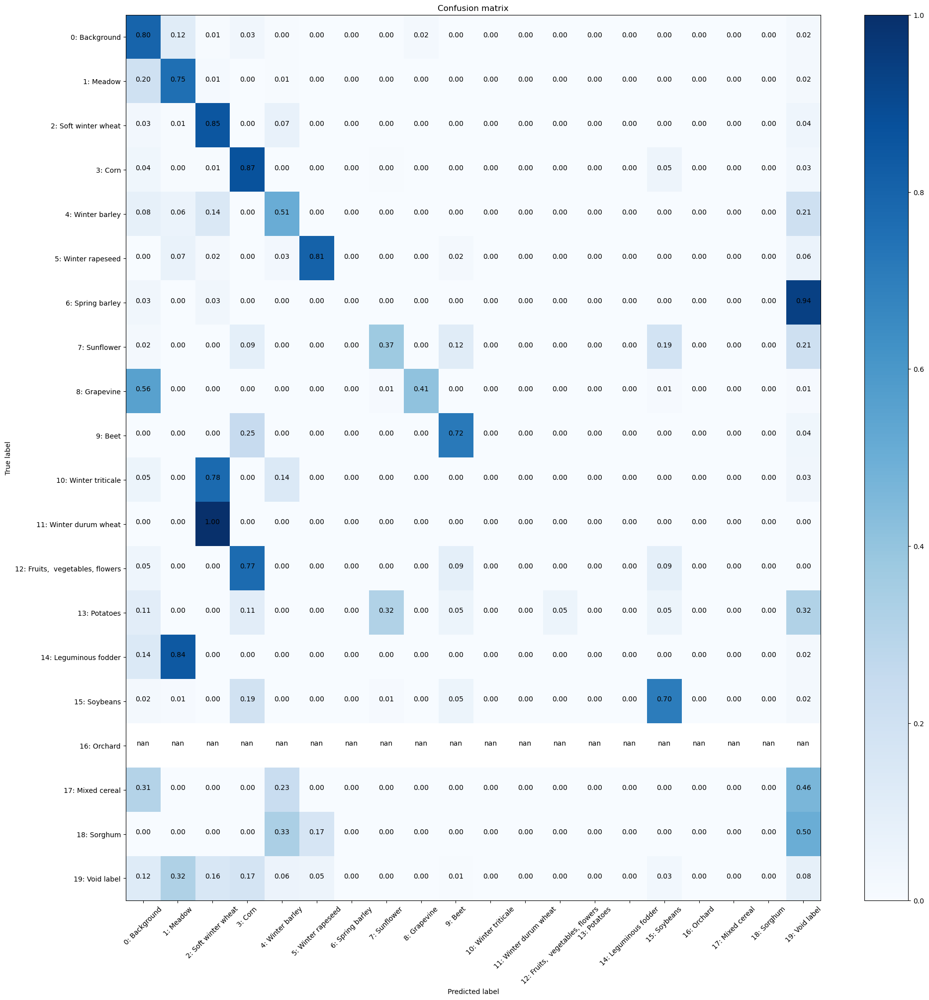

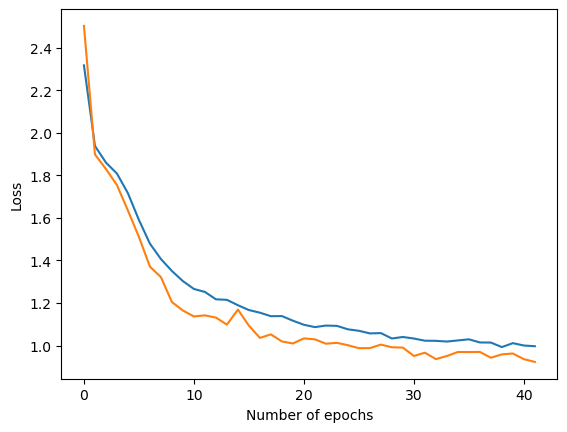

Checking accuracy on validation/test set
Got 4450 / 6400 correct (69.53)
Loss=0.94
Iteration 0, loss = 1.4758
Checking accuracy on validation/test set
Got 4456 / 6400 correct (69.62)
Loss=0.94
Normalized confusion matrix


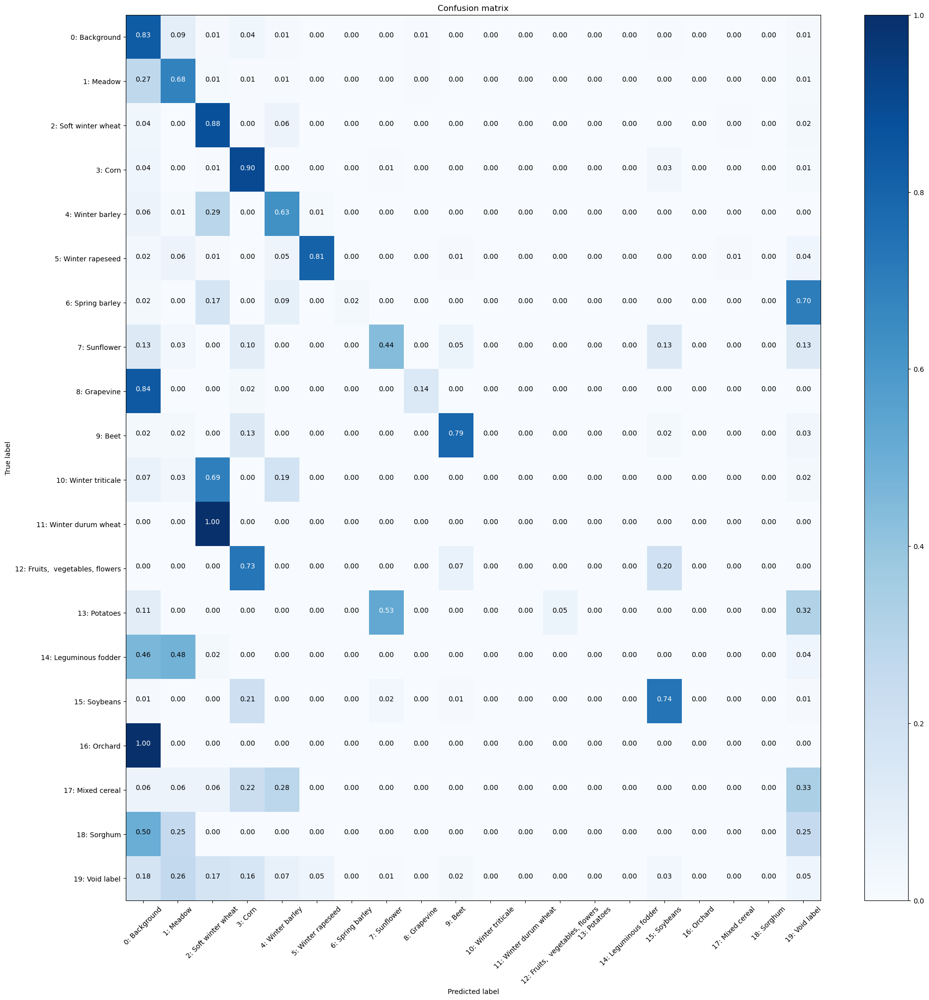


Iteration 100, loss = 1.2143
Checking accuracy on validation/test set
Got 4509 / 6400 correct (70.45)
Loss=0.90
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


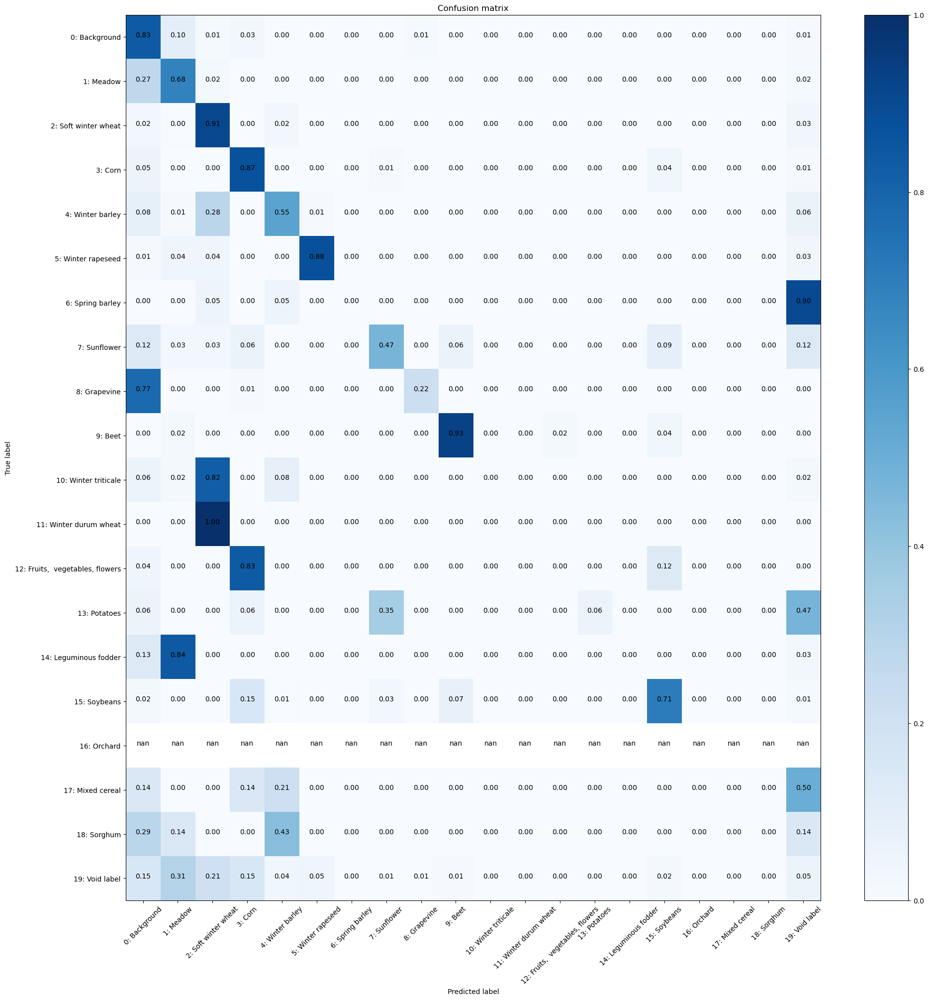

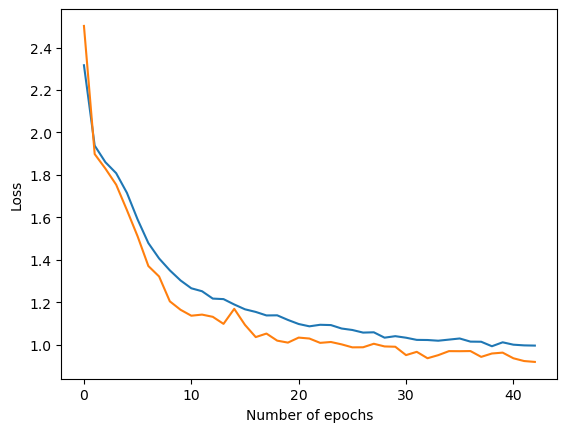

Checking accuracy on validation/test set
Got 4484 / 6400 correct (70.06)
Loss=0.93
Iteration 0, loss = 0.7497
Checking accuracy on validation/test set
Got 4534 / 6400 correct (70.84)
Loss=0.90
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


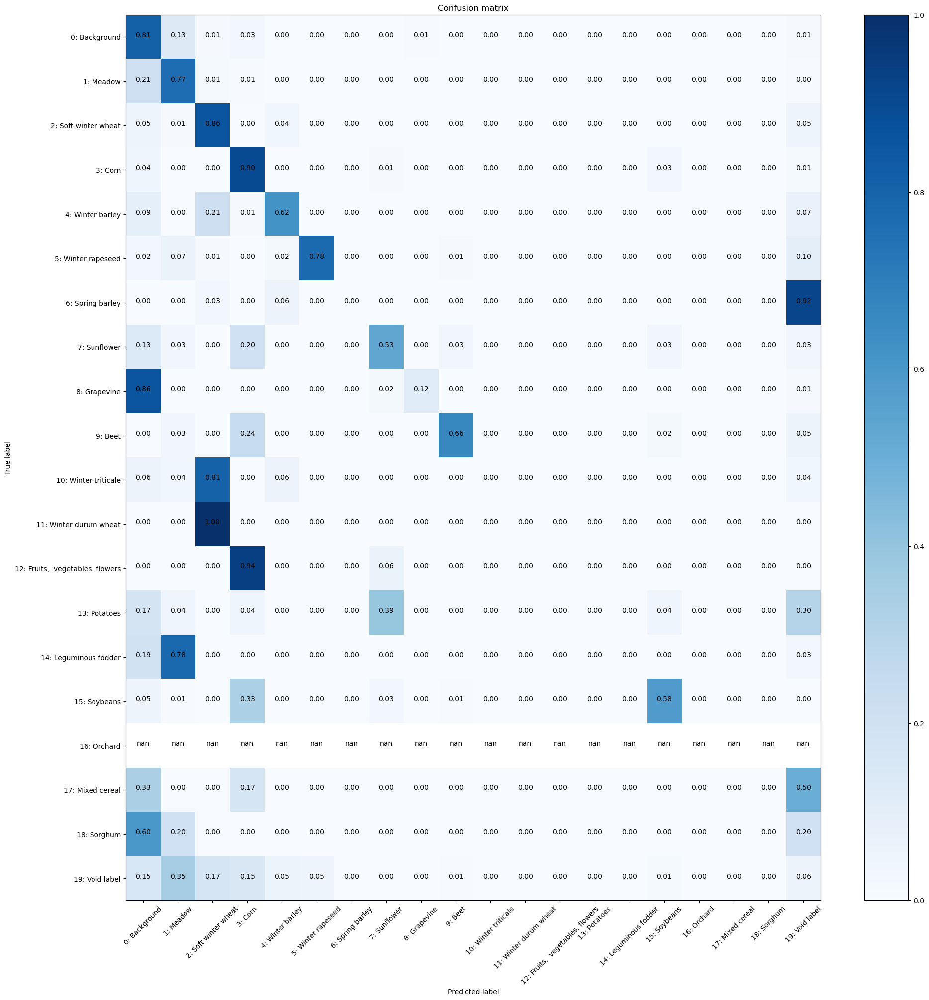


Iteration 100, loss = 1.2962
Checking accuracy on validation/test set
Got 4379 / 6400 correct (68.42)
Loss=0.96
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


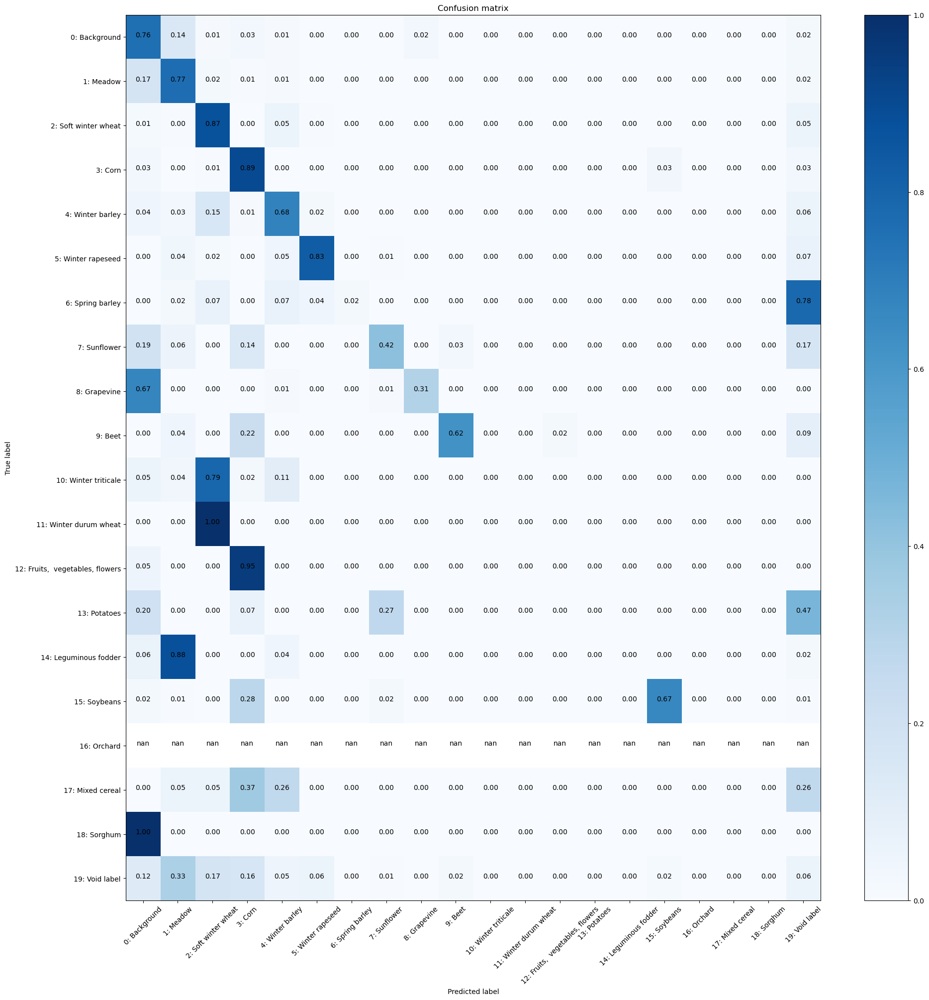

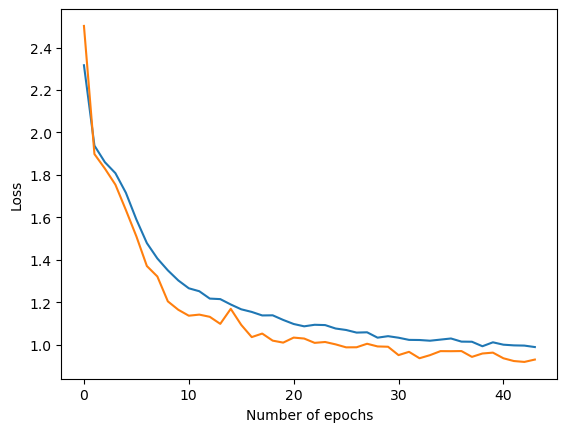

Checking accuracy on validation/test set
Got 4415 / 6400 correct (68.98)
Loss=0.96
Iteration 0, loss = 0.6340
Checking accuracy on validation/test set
Got 4450 / 6400 correct (69.53)
Loss=0.94
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


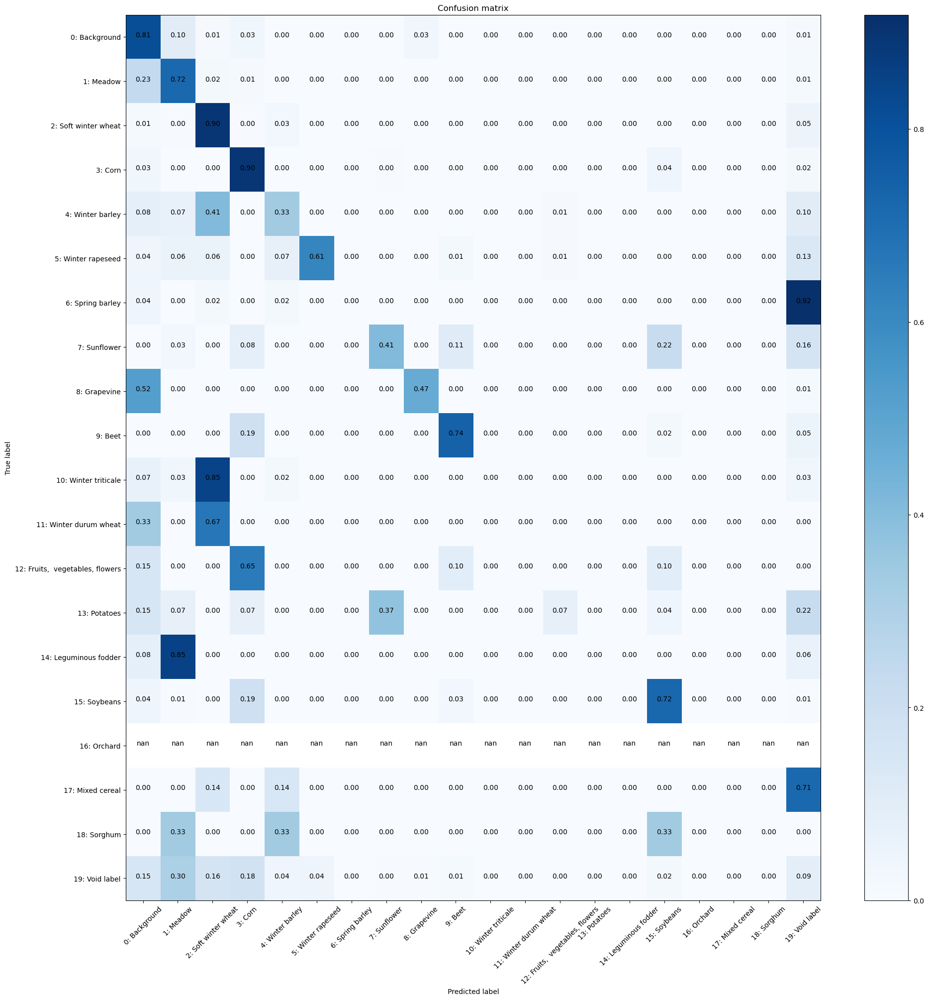


Iteration 100, loss = 0.6247
Checking accuracy on validation/test set
Got 4462 / 6400 correct (69.72)
Loss=0.95
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


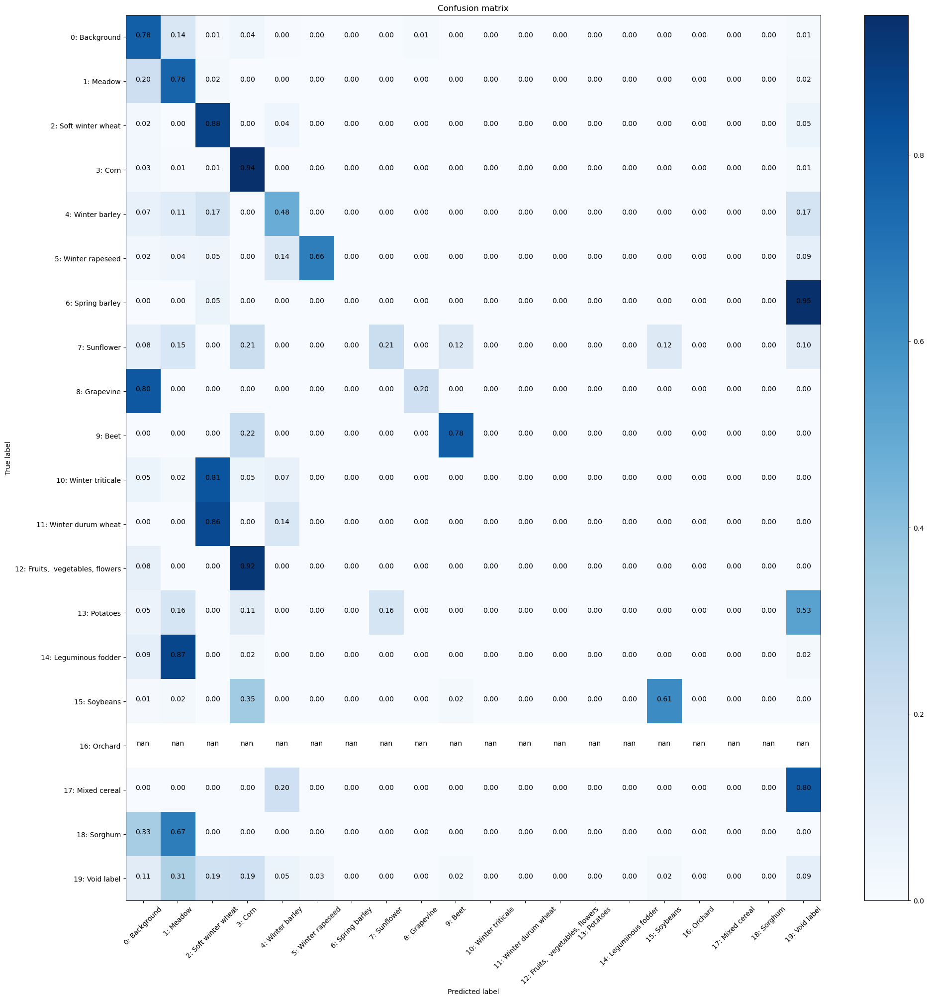

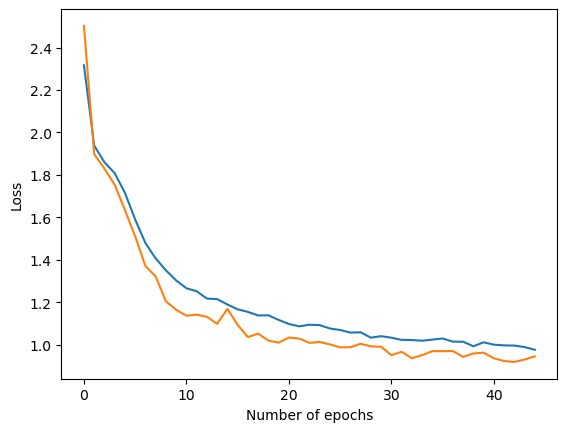

Checking accuracy on validation/test set
Got 4443 / 6400 correct (69.42)
Loss=0.95
Iteration 0, loss = 1.4063
Checking accuracy on validation/test set
Got 4522 / 6400 correct (70.66)
Loss=0.91
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


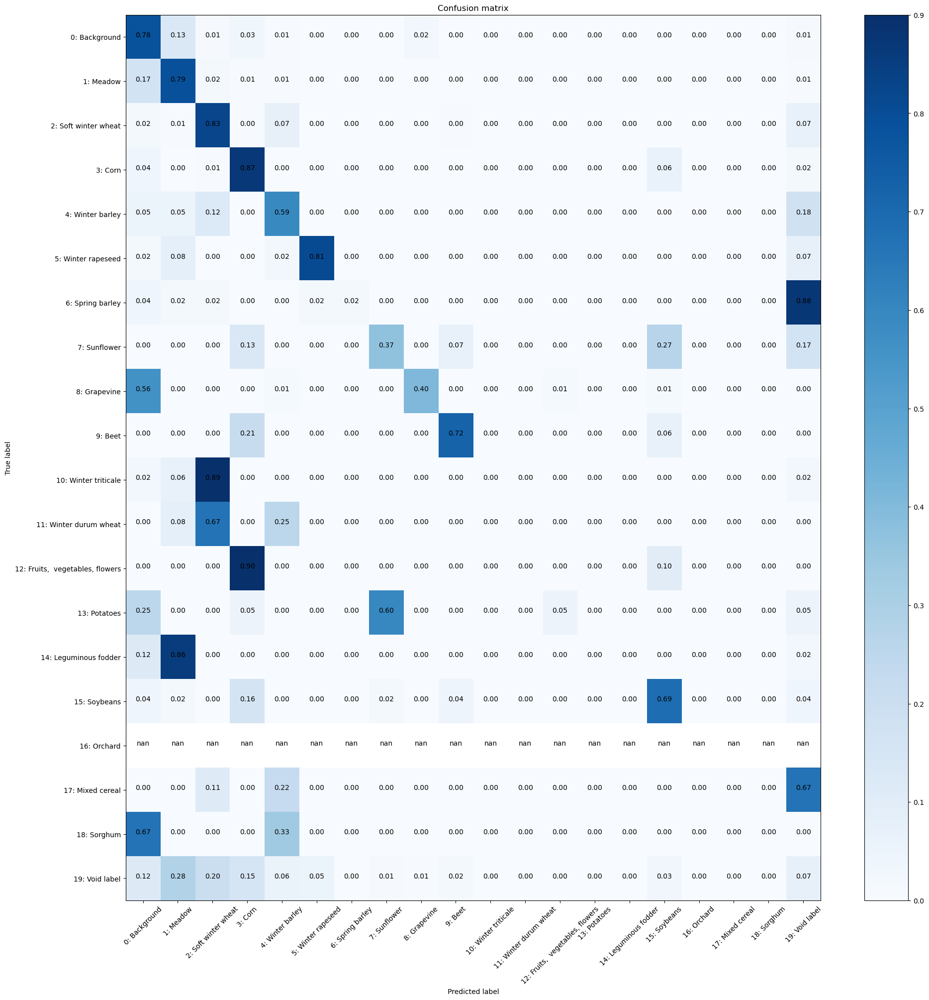


Iteration 100, loss = 1.2269
Checking accuracy on validation/test set
Got 4506 / 6400 correct (70.41)
Loss=0.93
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


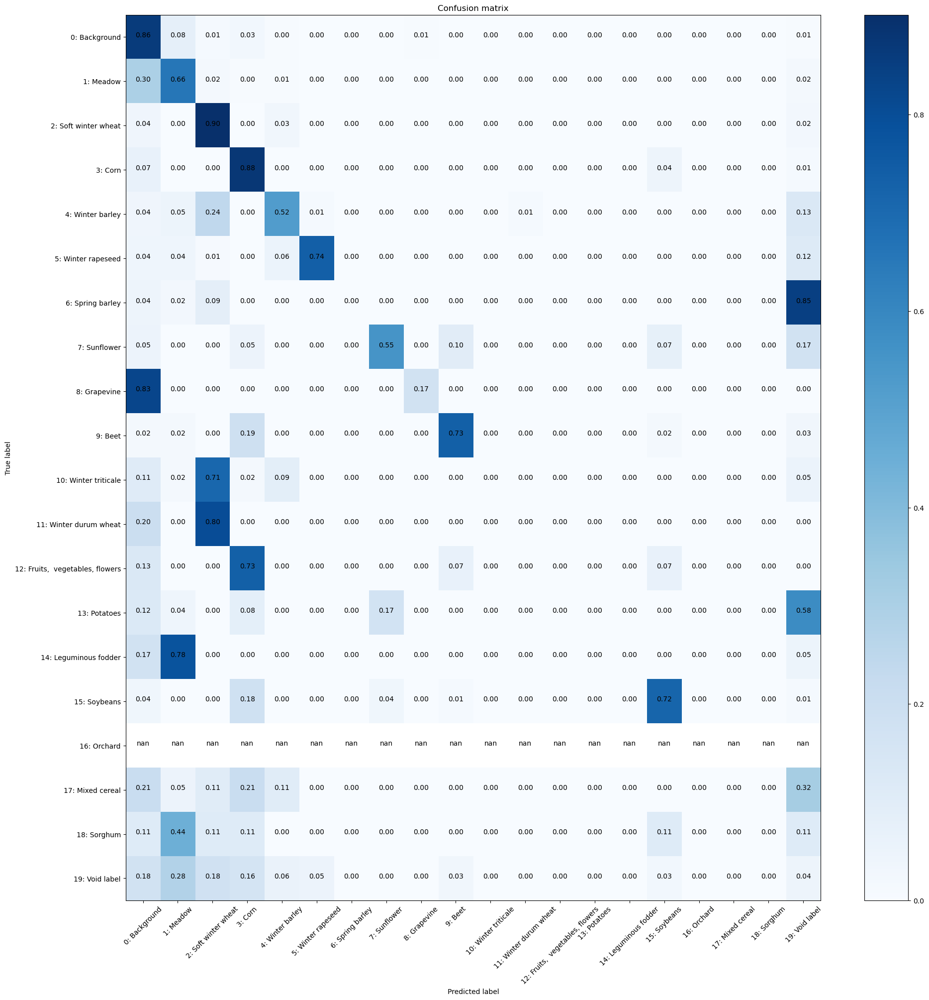

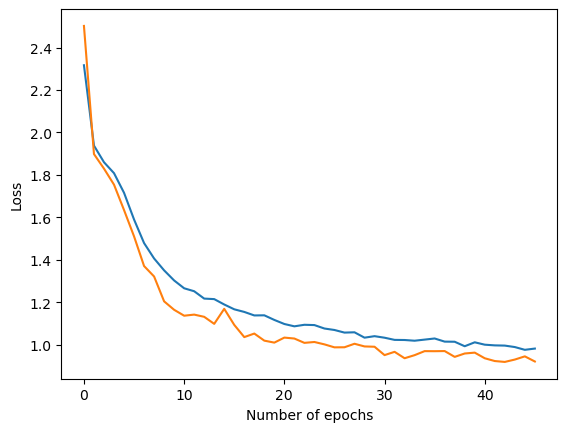

Checking accuracy on validation/test set
Got 4519 / 6400 correct (70.61)
Loss=0.91
Iteration 0, loss = 0.5207
Checking accuracy on validation/test set
Got 4465 / 6400 correct (69.77)
Loss=0.93
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


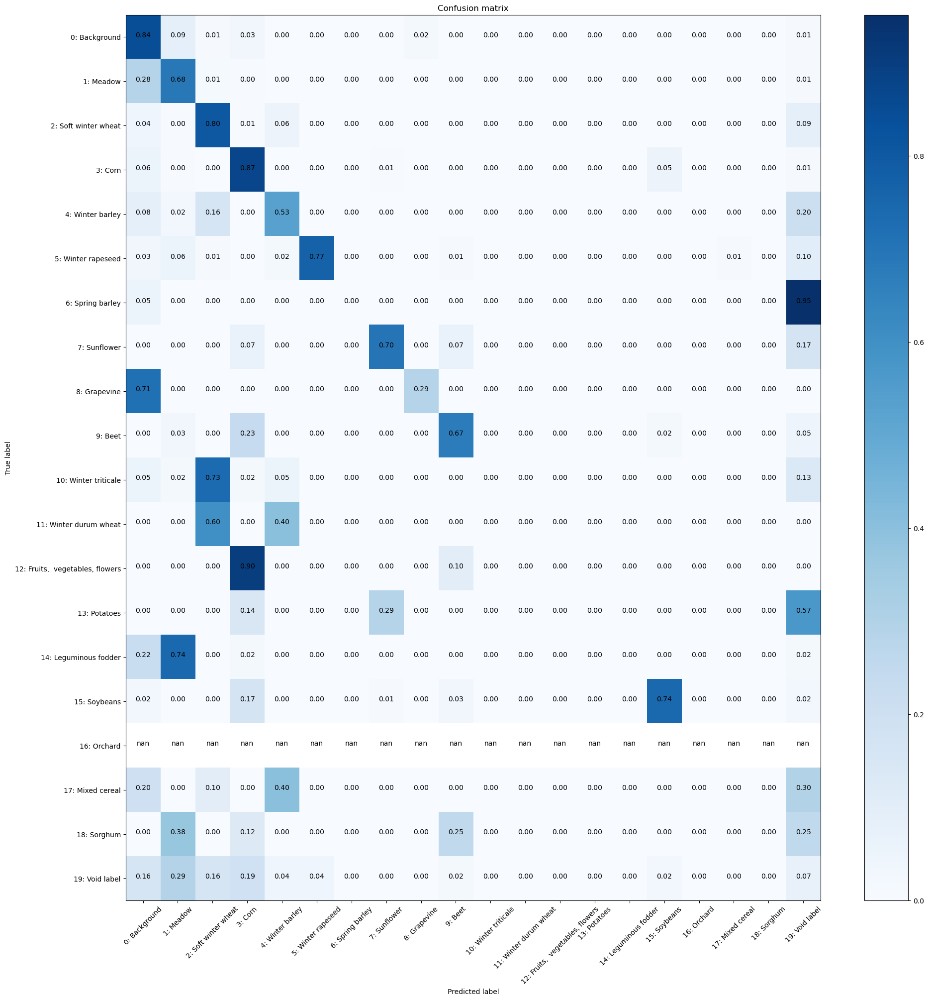


Iteration 100, loss = 0.8215
Checking accuracy on validation/test set
Got 4481 / 6400 correct (70.02)
Loss=0.93
Normalized confusion matrix


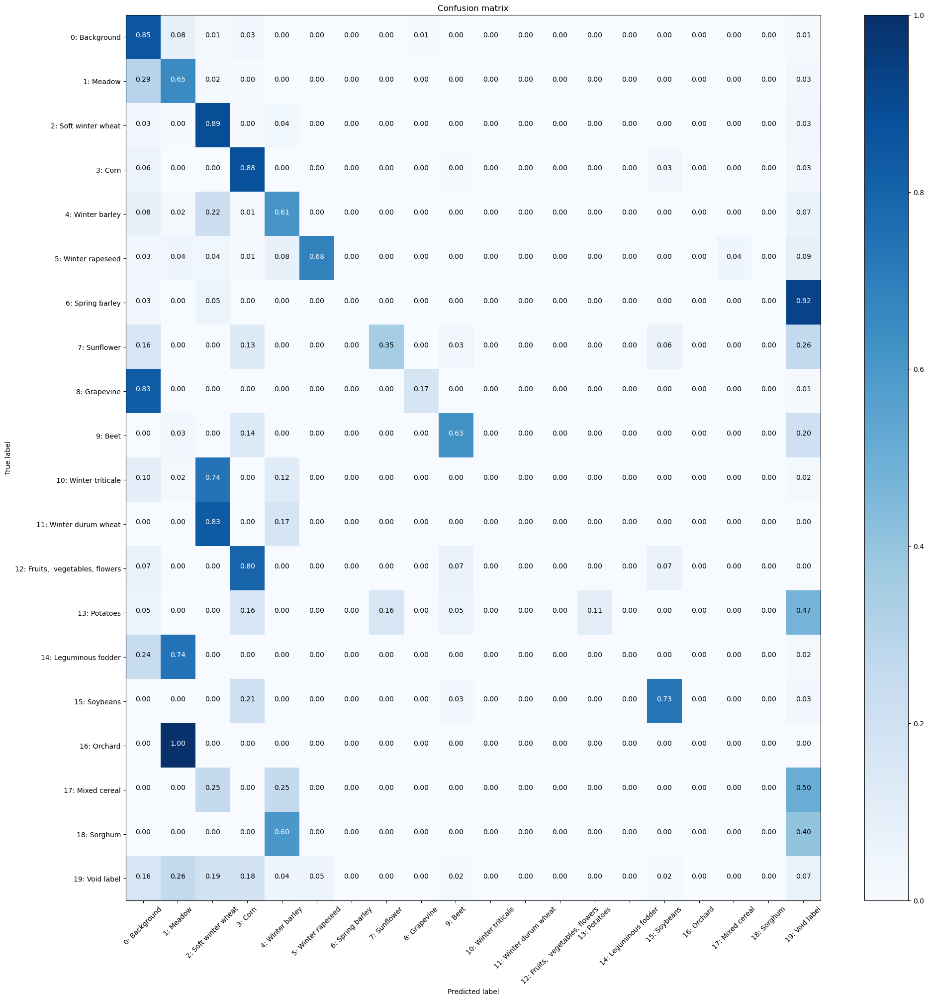

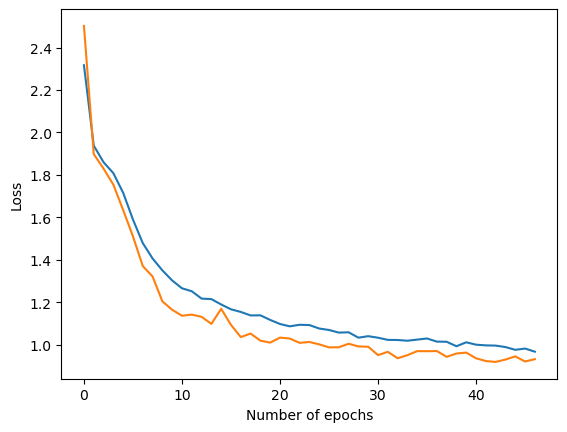

Checking accuracy on validation/test set
Got 4471 / 6400 correct (69.86)
Loss=0.93
Iteration 0, loss = 0.7577
Checking accuracy on validation/test set
Got 4456 / 6400 correct (69.62)
Loss=0.94
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


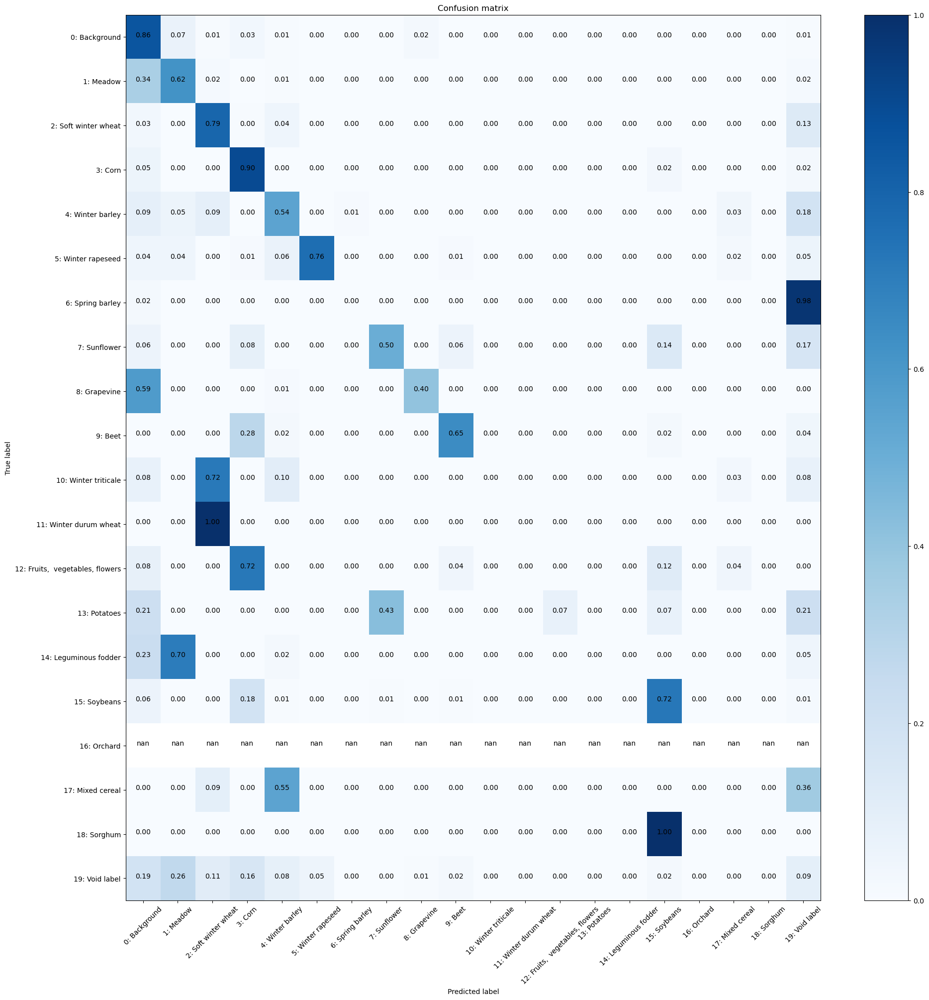


Iteration 100, loss = 0.9011
Checking accuracy on validation/test set
Got 4484 / 6400 correct (70.06)
Loss=0.96
Normalized confusion matrix


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


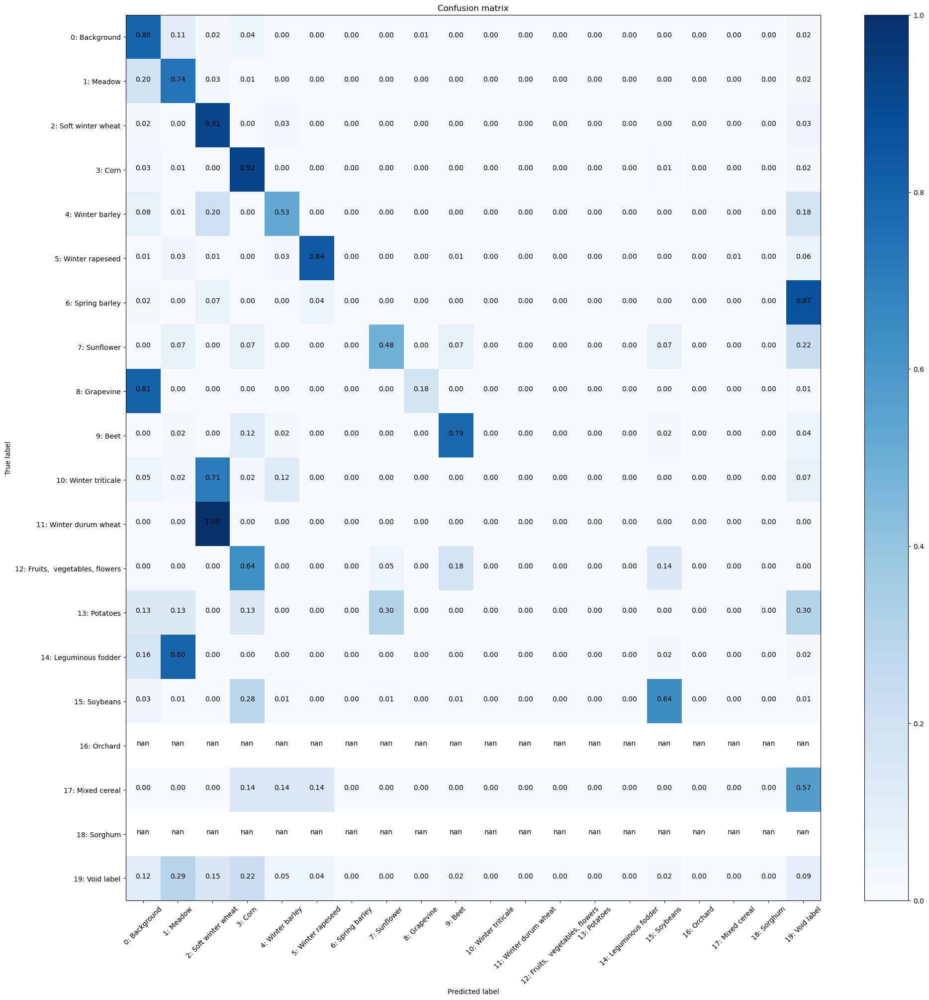

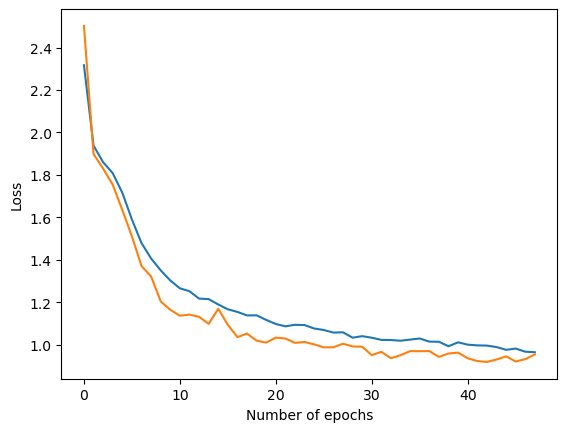

Checking accuracy on validation/test set
Got 4350 / 6400 correct (67.97)
Loss=0.96
Checking accuracy on validation/test set
Got 596321 / 819200 correct (72.79)
Loss=0.92


/tmp/ipykernel_29641/1307573405.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


Normalized confusion matrix


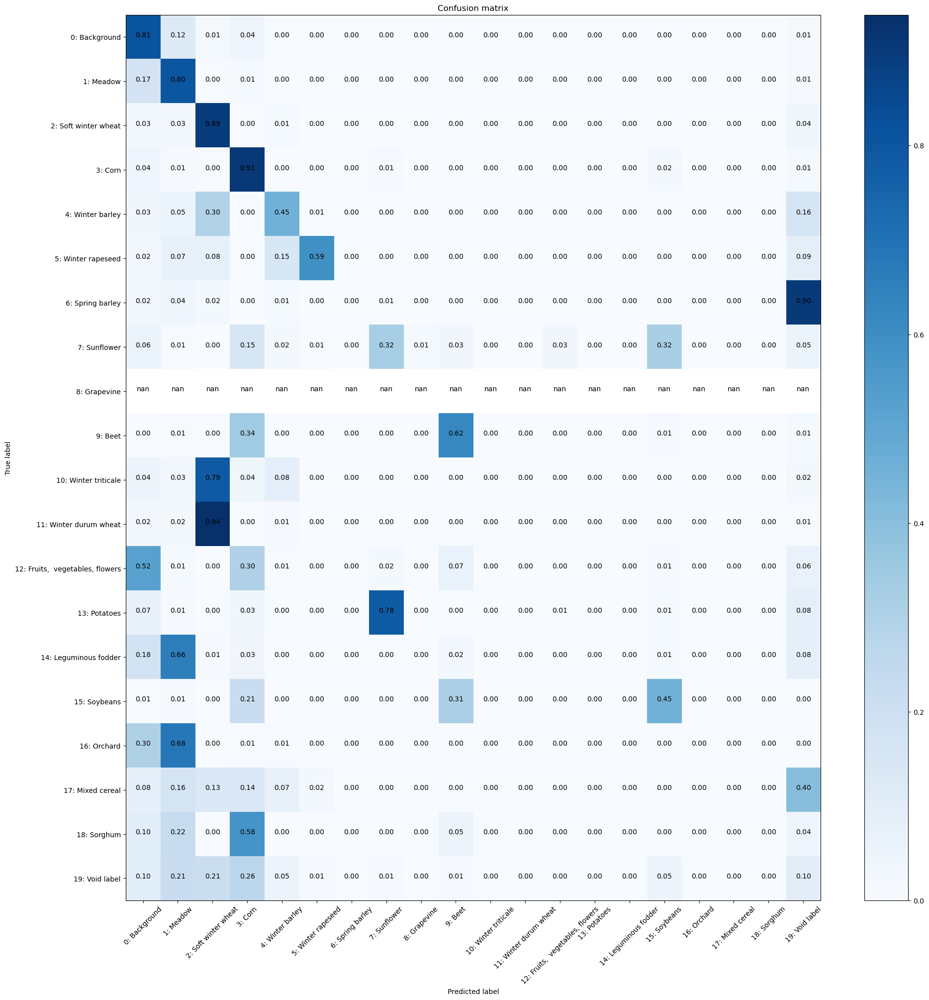

In [17]:
##############################################################
# - - - WRITE YOUR CODE HERE - - -
##############################################################
hidden_layer_size = 40
learning_rate = 1e-3

# Training phase
model = LSTMNet(10, hidden_layer_size, 20)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
training_loop_early_stopping(model, optimizer, epochs=500, stop_epochs=10, device = torch.device('cuda'))

# Test phase
acc, mean_loss, cm = eval_model_cm(PASTIS_test_dataloader, model)

**Visualization of semantic segmentation maps for the test set**


---
### [EXERCISE 9]
---

Make use of the PASTIS test subset data loader and the trained model obtained to visualize some semantic segmentation maps.



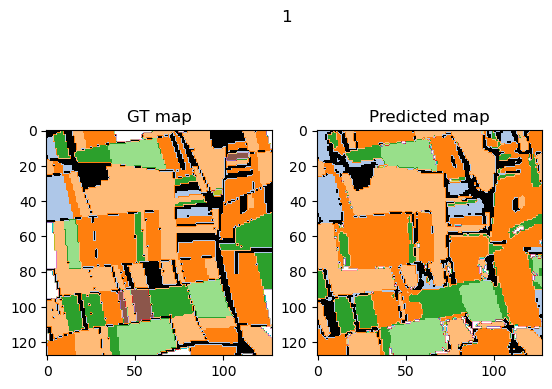

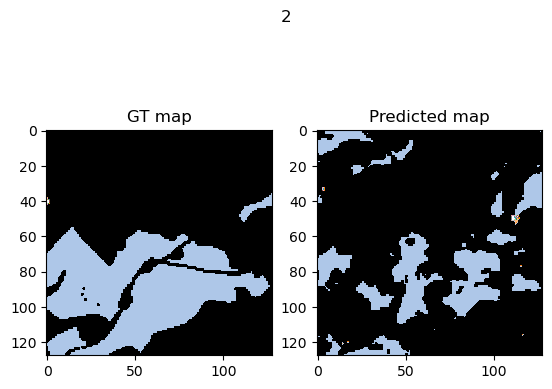

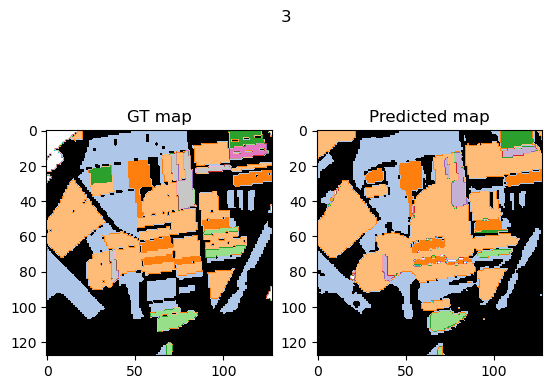

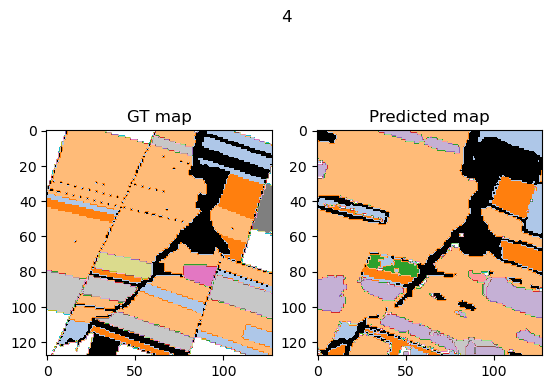

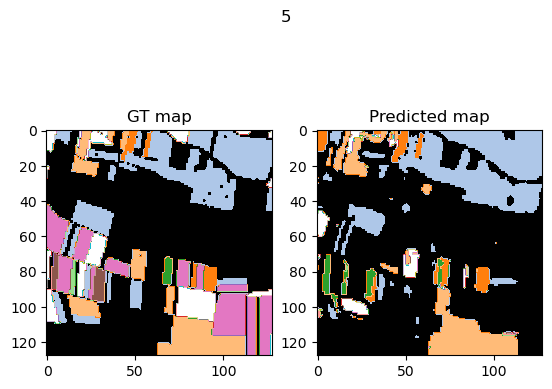

...

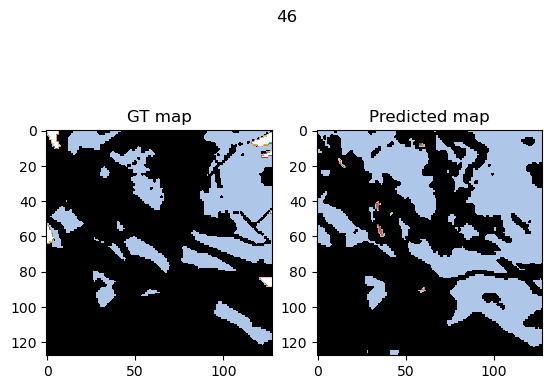

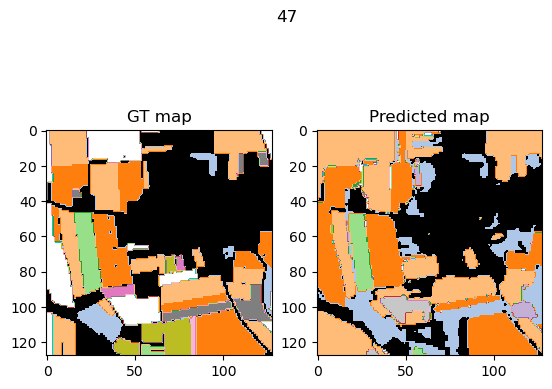

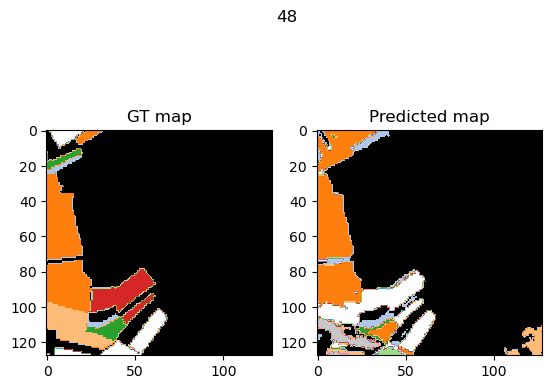

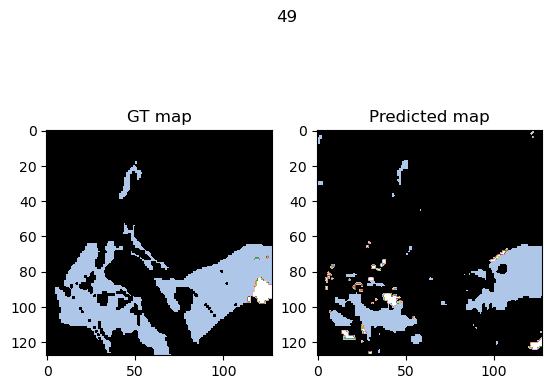

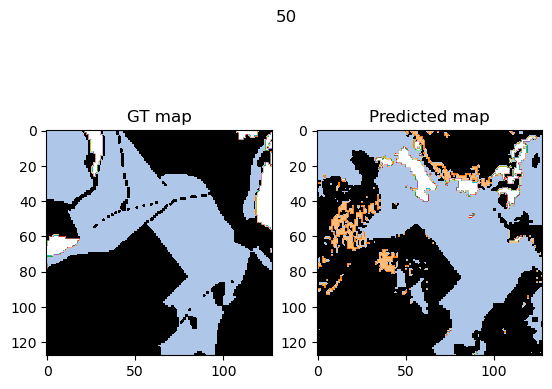

In [18]:
PASTIS_test_dataloader = DataLoader(PASTIS_test, batch_size=1, shuffle=False)

with torch.no_grad():
  for t, (data, dates, target) in enumerate(PASTIS_test_dataloader):
      data = data.to(device=torch.device('cuda'), dtype=torch.float32)  # move to device, e.g. GPU
      target = target.to(device=torch.device('cuda'), dtype=torch.long)
      scores = model(data)
      _, preds = scores.max(1)
      plt.figure()
      plt.subplot(1,2,1)
      plt.imshow(target[0].cpu().numpy(), cmap=PASTIS_colormap)
      plt.title('GT map')
      plt.subplot(1,2,2)
      plt.imshow(np.reshape(preds.cpu().numpy(),np.shape(target)[1:]), cmap=PASTIS_colormap)
      plt.title('Predicted map')
      plt.suptitle(t+1)
      plt.show()


---
## 4. CONVOLUTIONAL NEURAL NETWORK (CNN) + LSTM
---

Now we combine Convolutional Neural Networks (CNNs) with LSTM units at the intermediate layer of the encoder-decoder architecture.


---
### 4.1 DATASET AND DATALOADER: TRAINING, VALIDATION AND TEST SUBSET
---

---
### [EXERCISE 10]
---

Execute the following lines of code in order to define the normalized (norm=True) PASTIS training (folds=[1]), validation (folds=[2]) and test (folds=[3]) subsets and data loaders to perform pixel-level image classification using a spatio-temporal CNN+LSTM model (mode='3d_cnn_lstm').

In [19]:
batch_size = 1

PASTIS_train = PASTIS_DL4ES_Dataset(folder='./PASTIS_DL4ES',
                                    norm=True,
                                    norm_mean=norm_mean,
                                    norm_std=norm_std,
                                    folds=[1],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d_cnn_lstm')

PASTIS_train_dataloader = DataLoader(PASTIS_train, batch_size=batch_size, shuffle=True)

PASTIS_validation = PASTIS_DL4ES_Dataset(folder='./PASTIS_DL4ES',
                                    norm=True,
                                    norm_mean=norm_mean,
                                    norm_std=norm_std,
                                    folds=[2],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d_cnn_lstm')

PASTIS_validation_dataloader = DataLoader(PASTIS_validation, batch_size=batch_size, shuffle=False)

PASTIS_test = PASTIS_DL4ES_Dataset(folder='./PASTIS_DL4ES',
                                    norm=True,
                                    norm_mean=norm_mean,
                                    norm_std=norm_std,
                                    folds=[3],
                                    reference_date="2018-09-01",
                                    class_mapping=None,
                                    nn_type='3d_cnn_lstm')

PASTIS_test_dataloader = DataLoader(PASTIS_test, batch_size=batch_size, shuffle=False)

Reading patch metadata . . .
Done.
Dataset ready.
Reading patch metadata . . .
Done.
Dataset ready.
Reading patch metadata . . .
Done.
Dataset ready.


---
### 4.2 NEURAL NETWORK DEFINITION
---

The following figure shows the [SegNet](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=7803544) semantic segmentation architecture.

![segnet](https://www.researchgate.net/profile/Vijay-Badrinarayanan/publication/283471087/figure/fig1/AS:391733042008065@1470407843299/An-illustration-of-the-SegNet-architecture-There-are-no-fully-connected-layers-and-hence_W640.jpg)

A general [semantic segmentation architecture](https://medium.com/@fezancs/understanding-of-semantic-segmentation-how-segnet-model-work-to-perform-semantic-segmentation-5c426112e499) can be broadly thought of as an encoder network followed by a decoder network:
* The encoder is usually is a pre-trained classification network like VGG/ResNet followed by a decoder network.
* The task of the decoder is to semantically project the discriminative features (lower resolution) learnt by the encoder onto the pixel space (higher resolution) to get a dense classification.

Semantic segmentation not only requires discrimination at pixel level but also a mechanism to project the discriminative features learnt at different stages of the encoder onto the pixel space. Different approaches employ different mechanisms as a part of the decoding mechanism.

SegNet is designed to be an efficient architecture for pixel-wise semantic segmentation. It is primarily motivated by road scene understanding applications which require the ability to model appearance (road, building), shape (cars,pedestrians) and understand the spatial-relationship (context) between different classes such as road and side-walk. In typical road scenes, the majority of the pixels belong to large classes such as road, building and hence the network must produce smooth segmentation.

SegNet has an encoder network and a corresponding decoder network, followed by a final pixelwise classification layer. This architecture is illustrated in above figure. The encoder network consists of 13 convolutional layers which correspond to the first 13 convolutional layers in the VGG16 network designed for object classification. They discard the fully connected layers in favor of retaining higher resolution feature maps at the deepest encoder output. This also reduces the number of parameters in the SegNet encoder network significantly (from 134M to 14.7M) as compared to other recent architectures. Each encoder layer has a corresponding decoder layer and hence the decoder network has 13 layers. The final decoder output is fed to a multi-class soft-max classifier to produce class probabilities for each pixel independently.

Now we will implement a simplified version of SegNet (few convolutional layers, without batch normalization layers or pooling indices stored) to perform the semantic segmentation problem posed by PASTIS database.

The structure of the modified version to be implemented is the following:

* Input are patches of size 128x128x10, as same as in PASTIS database.
* The encoder network is composed of 5 [convolutional](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html) layers (followed by [ReLU](https://pytorch.org/docs/stable/generated/torch.nn.ReLU.html) activation function) with 64, 128, 256, 256 and 256 filters of size 3x3, respectively, whose output results in 64, 128, 256, 256 and 256 activation maps. Each convolutional layer is followed by a [maxpooling](https://pytorch.org/docs/1.9.1/generated/torch.nn.MaxPool2d.html) layer, which subsequently downsamples (size 2x2, stride=2) the 64, 128, 256, 256 and 256 activation maps to 64x64, 32x32, 16x16, 8x8 and 4x4, respectively.
* The decoder network is composed of 5 convolutional layers (followed by ReLU activation function) with 256, 256, 256, 128 and 64 filters of size 3x3, respectively, whose output results in 256, 256, 256, 128 and 64 activation maps. Each convolutional layer is followed by a [bilinear upsampling](https://pytorch.org/docs/stable/generated/torch.nn.Upsample.html) layer, which subsequently upsamples (scale_factor=2) the 256, 256, 256, 128 and 64 activation maps to 8x8, 16x16, 32x32, 64x64 and 128x128, respectively.
* Finally, a convolutional layer (followed by a [Softmax activation](https://pytorch.org/docs/stable/generated/torch.nn.Softmax.html) function) with 20 filters of size 3x3 results in the output semantic segmentation map desired. NOTE: Softmax is not required to be defined if categorical cross-entropy loss is used.
* Padding must be included in each convolutional layer so that the input spatial dimension to each layer is preserved.
* Add residual skip connections (sum) between symmetric layers in the encoder and the decoder, in order to facilitate the generation of the output segmentation map.


In [20]:
class SegNet(nn.Module):
    def __init__(self, in_channel, num_classes):
        super().__init__()
        ########################################################################
        # TODO: Set up the layers you need for an SegNet CNN with the          #
        # architecture defined above.                                          #
        ########################################################################
        # - - - WRITE YOUR CODE HERE - - -

        # ENCODER
        # first conv2d
        self.conv1 = nn.Conv2d(in_channel, 64, (3,3), padding=(1,1))
        # first maxpool2d
        self.pool1 = nn.MaxPool2d(2, stride=2)
        # second conv2d
        self.conv2 = nn.Conv2d(64, 128, (3,3), padding=(1,1))
        # second maxpool2d
        self.pool2 = nn.MaxPool2d(2, stride=2)
        # third conv2d
        self.conv3 = nn.Conv2d(128, 256, (3,3), padding=(1,1))
        # third maxpool2d
        self.pool3 = nn.MaxPool2d(2, stride=2)
        # fourth conv2d
        self.conv4 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # fourth maxpool2d
        self.pool4 = nn.MaxPool2d(2, stride=2)
        # fifth conv2d
        self.conv5 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # fifth maxpool2d
        self.pool5 = nn.MaxPool2d(2, stride=2)

        # DECODER
        # first conv2d
        self.dconv1 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # first upsampling
        self.up1 = nn.Upsample(scale_factor=2, mode='bilinear')
        # second conv2d
        self.dconv2 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # second upsampling
        self.up2 = nn.Upsample(scale_factor=2, mode='bilinear')
        # third conv2d
        self.dconv3 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # third upsampling
        self.up3 = nn.Upsample(scale_factor=2, mode='bilinear')
        # fourth conv2d
        self.dconv4 = nn.Conv2d(256, 128, (3,3), padding=(1,1))
        # fourth upsampling
        self.up4 = nn.Upsample(scale_factor=2, mode='bilinear')
        # fifth conv2d
        self.dconv5 = nn.Conv2d(128, 64, (3,3), padding=(1,1))
        # fifth upsampling
        self.up5 = nn.Upsample(scale_factor=2, mode='bilinear')

        # OUTPUT
        self.out = nn.Conv2d(64, 20, (3,3), padding=(1,1))

        ########################################################################
        #                          END OF YOUR CODE                            #
        ########################################################################

    def forward(self, x):
        scores = None
        ########################################################################
        # TODO: Implement the forward function for an SegNet CNN. You          #
        # should use the layers you defined in __init__ and specify the        #
        # connectivity of those layers in forward()                            #
        ########################################################################
        # - - - WRITE YOUR CODE HERE - - -

        # Encoder
        x1 = F.relu(self.conv1(x))
        x = self.pool1(x1)
        x2 = F.relu(self.conv2(x))
        x = self.pool2(x2)
        x3 = F.relu(self.conv3(x))
        x = self.pool3(x3)
        x4 = F.relu(self.conv4(x))
        x = self.pool4(x4)
        x5 = F.relu(self.conv5(x))
        x = self.pool5(x5)
        # Decoder
        x = F.relu(self.dconv1(x))
        x = self.up1(x)+x5
        x = F.relu(self.dconv2(x))
        x = self.up2(x)+x4
        x = F.relu(self.dconv3(x))
        x = self.up3(x)+x3
        x = F.relu(self.dconv4(x))
        x = self.up4(x)+x2
        x = F.relu(self.dconv5(x))
        x = self.up5(x)+x1
        # Output
        scores = self.out(x)

        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################
        return scores


def test_SegNet():
    x = torch.zeros((16, 10, 128, 128), dtype=torch.float32)  # minibatch size 16, patch size [10, 128, 128]
    model = SegNet(in_channel=10, num_classes=20)
    scores = model(x)
    print(scores.size())  # you should see [20, 128, 128]

test_SegNet()

torch.Size([16, 20, 128, 128])


---
### [EXERCISE 11]
---

1) Let's modify the ```SegNet``` encoder-decoder CNN architecture by replacing its intermediate hidden layers (last layer of the encoder and first layer of the decoder) by a [LSTM](https://pytorch.org/docs/1.9.1/generated/torch.nn.LSTM.html) one! The new version of its class will be named LSTMSegNet.

2) Use the function 'test_LSTMSegNet' to check that the forward pass doesn't crash and produces outputs of the right shape, by running zeros through the network.

In [21]:
class LSTMSegNet(nn.Module):
    ##############################################################
    # - - - WRITE YOUR CODE HERE - - -
    # Modify the class 'SegNet' in order to
    # replace its intermediate hidden layer (last layer of the
    # encoder and first layer of the decoder) by a LSTM one.
    pass
    ##############################################################


def test_LSTMSegNet():
    x = torch.zeros((16, 30, 10, 128, 128), dtype=torch.float32)  # minibatch size 16, number of timesteps 30, patch size [10, 128, 128]
    model = LSTMSegNet(in_channel=10, num_classes=20)
    scores = model(x)
    print(scores.size())  # you should see [16, 20, 128, 128]

test_LSTMSegNet()

TypeError: LSTMSegNet.__init__() got an unexpected keyword argument 'in_channel'

In [22]:
class LSTMSegNet(nn.Module):
    def __init__(self, in_channel, lstm_hidden_units, num_classes):
        super().__init__()
        ########################################################################
        # Modify the class 'SegNet' in Lab Session 2 in order to               #
        # replace its intermediate hidden layer (last layer of the             #
        # encoder) by a LSTM one.                                              #
        ########################################################################
        # - - - WRITE YOUR CODE HERE - - -

        # ENCODER
        # first conv2d
        self.conv1 = nn.Conv2d(in_channel, 64, (3,3), padding=(1,1))
        # first maxpool2d
        self.pool1 = nn.MaxPool2d(2, stride=2)
        # second conv2d
        self.conv2 = nn.Conv2d(64, 128, (3,3), padding=(1,1))
        # second maxpool2d
        self.pool2 = nn.MaxPool2d(2, stride=2)
        # third conv2d
        self.conv3 = nn.Conv2d(128, 256, (3,3), padding=(1,1))
        # third maxpool2d
        self.pool3 = nn.MaxPool2d(2, stride=2)
        # fourth conv2d
        self.conv4 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # fourth maxpool2d
        self.pool4 = nn.MaxPool2d(2, stride=2)

        # LSTM layer
        self.lstm = nn.LSTM(256, lstm_hidden_units, batch_first=True)

        # DECODER
        # first conv2d
        self.dconv1 = nn.Conv2d(lstm_hidden_units, 256, (3,3), padding=(1,1))
        # first upsampling
        self.up1 = nn.Upsample(scale_factor=2, mode='bilinear')
        # second conv2d
        self.dconv2 = nn.Conv2d(256, 256, (3,3), padding=(1,1))
        # second upsampling
        self.up2 = nn.Upsample(scale_factor=2, mode='bilinear')
        # third conv2d
        self.dconv3 = nn.Conv2d(256, 128, (3,3), padding=(1,1))
        # third upsampling
        self.up3 = nn.Upsample(scale_factor=2, mode='bilinear')
        # fourth conv2d
        self.dconv4 = nn.Conv2d(128, 64, (3,3), padding=(1,1))
        # fourth upsampling
        self.up4 = nn.Upsample(scale_factor=2, mode='bilinear')

        # OUTPUT
        self.out = nn.Conv2d(64, 20, (3,3), padding=(1,1))

        ########################################################################
        #                          END OF YOUR CODE                            #
        ########################################################################

    def forward(self, x):
        scores = None
        ########################################################################
        # TODO: Implement the forward function for an SegNet CNN. You          #
        # should use the layers you defined in __init__ and specify the        #
        # connectivity of those layers in forward()                            #
        ########################################################################
        # - - - WRITE YOUR CODE HERE - - -

        batch_size = np.shape(x)[0]
        num_timesteps = np.shape(x)[1]
        num_channels = np.shape(x)[2]

        # Encoder
        x = torch.reshape(x,(-1,)+tuple(np.shape(x)[2:])) # reshape to N*T x C x H x W
        x1 = F.relu(self.conv1(x))
        x = self.pool1(x1)
        x2 = F.relu(self.conv2(x))
        x = self.pool2(x2)
        x3 = F.relu(self.conv3(x))
        x = self.pool3(x3)
        x4 = F.relu(self.conv4(x))
        x = self.pool4(x4)

        # LSTM
        num_channels = np.shape(x)[1]
        height = np.shape(x)[2]
        width = np.shape(x)[3]
        x = torch.permute(x, (2,3,0,1)) # channels last
        x = torch.reshape(x, (-1,num_timesteps,num_channels)) # reshape to H*W x N*T x C
        x, (h_n, c_n) = self.lstm(x)
        x = torch.reshape(x[:,-1,:], (height,width,batch_size,-1)) # reshape to H x W x N x C
        x = torch.permute(x, (2,3,0,1)) # channels first, N x C x H x W

        # Decoder
        x = F.relu(self.dconv1(x))
        x = self.up1(x)+torch.reshape(x4,(batch_size,num_timesteps,)+tuple(np.shape(x4)[1:]))[:,-1,:,:,:]
        x = F.relu(self.dconv2(x))
        x = self.up2(x)+torch.reshape(x3,(batch_size,num_timesteps,)+tuple(np.shape(x3)[1:]))[:,-1,:,:,:]
        x = F.relu(self.dconv3(x))
        x = self.up3(x)+torch.reshape(x2,(batch_size,num_timesteps,)+tuple(np.shape(x2)[1:]))[:,-1,:,:,:]
        x = F.relu(self.dconv4(x))

        x = self.up4(x)+torch.reshape(x1,(batch_size,num_timesteps,)+tuple(np.shape(x1)[1:]))[:,-1,:,:,:]
        # Output
        scores = self.out(x)

        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################
        return scores


def test_LSTMSegNet():
    x = torch.zeros((16, 30, 10, 128, 128), dtype=torch.float32)  # minibatch size 16, number of timesteps 30, patch size [10, 128, 128]
    model = LSTMSegNet(in_channel=10, lstm_hidden_units=40, num_classes=20)
    scores = model(x)
    print(scores.size())  # you should see [16, 20, 128, 128]

test_LSTMSegNet()

torch.Size([16, 20, 128, 128])


---
### 4.3 TRAINING LOOP AND EXECUTION
---

---
### [EXERCISE 12]
---

**Training loop**

You can train the CNN+LSTM using a similar training loop to the final one defined in Exercise 7 (including Early Stopping, together with the evaluation using the confusion matrix). Implement it here below.

In [23]:
# Constant to control how frequently we print train loss
print_every = 500

def confusion_matrix(targets, preds, num_classes=20):
    '''
    The function computes the confusion matrix, given a vector of Ground-Truth (GT)
    labels and its corresponding vector of hard predictions provided by a
    classification model.
    Inputs:
    - targets: Vector of GT labels
    - preds: Vector of hard predictions provided by a classification model.
    - num_classes: Total number of classes considered by the classifier. The default
      value is equal to 20, which is the number of classes considered in
      PASTIS database.
    Output:
    - cm: Confusion matrix computed.
    '''
    cm = np.zeros((num_classes,num_classes)).astype('int')
    stacked = np.stack((targets, preds),axis=1)
    for p in stacked:
      tl, pl = p.tolist()
      cm[tl, pl] = cm[tl, pl] + 1
    return cm

def plot_confusion_matrix(cm, classes=PASTIS_classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    '''
    This function serves to plot the confusion matrix 'cm'.
    - cm: Confusion matrix to be plotted.
    - classes: Name of the classes considered by the classifier.
      We make use of the names for the classes in PASTIS database by default.
    - normalize: Whether to normalize the confusion matrix or not.
    - title: Title to be shown at the top of the plot.
    - cmap: Colormap to plot the confusion matrix.
    '''
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    #print(cm)
    plt.figure(figsize = (20,20))
    plt.imshow(cm, interpolation='nearest', cmap=cmap, aspect='auto')
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

def eval_model(loader, model, device = torch.device('cuda')):
    print('Checking accuracy on validation/test set')
    loss = []
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for data, dates, target in loader:
            data = data.to(device=device, dtype=torch.float32)  # move to device, e.g. GPU
            target = target.to(device=device, dtype=torch.long)
            scores = model(data)
            loss.append(F.cross_entropy(torch.flatten(scores.permute(0,2,3,1), start_dim=0, end_dim=2), torch.flatten(target)).data.cpu().numpy())
            _, preds = torch.flatten(scores.permute(0,2,3,1), start_dim=0, end_dim=2).max(1)
            num_correct += (preds == torch.flatten(target)).sum()
            num_samples += preds.size(0)
        acc = float(num_correct) / num_samples
        mean_loss = np.mean(loss)
        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        print('Loss=%.2f' % mean_loss)
    return acc, mean_loss

def eval_model_cm(loader, model, device = torch.device('cuda')):
    print('Checking accuracy on validation/test set')
    loss = []
    num_correct = 0
    num_samples = 0
    y_all = []
    preds_all = []
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for data, dates, target in loader:
            data = data.to(device=device, dtype=torch.float32)  # move to device, e.g. GPU
            target = target.to(device=device, dtype=torch.long)
            scores = model(data)
            loss.append(F.cross_entropy(torch.flatten(scores.permute(0,2,3,1), start_dim=0, end_dim=2), torch.flatten(target)).data.cpu().numpy())
            _, preds = torch.flatten(scores.permute(0,2,3,1), start_dim=0, end_dim=2).max(1)
            num_correct += (preds == torch.flatten(target)).sum()
            num_samples += preds.size(0)
            y_all.append(torch.flatten(target).cpu().numpy())
            preds_all.append(preds.data.cpu().numpy())
        acc = float(num_correct) / num_samples
        mean_loss = np.mean(loss)
        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        print('Loss=%.2f' % mean_loss)
        # compute and plot confusion matrix
        y_all = np.concatenate(y_all)
        preds_all = np.concatenate(preds_all)
        cm = confusion_matrix(y_all, preds_all, num_classes=20)
        plot_confusion_matrix(cm, classes=PASTIS_classes, normalize=True, title='Confusion matrix', cmap=plt.cm.Blues)
        #
    return acc, mean_loss, cm

def training_loop_early_stopping(model, optimizer, epochs=1, stop_epochs=5, category_weights=None, device = torch.device('cuda')):
    """
    Train a model on PASTIS database using the PyTorch Module API.

    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for

    Returns: Nothing, but prints model accuracies during training.
    """
    iter_loss_aux = []
    iter_loss_aux_val = []
    epoch_loss = []
    epoch_loss_val = []
    best_val_loss = np.inf
    stop_count = 0
    plt.figure(1)
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in range(epochs):
        for t, (data, dates, target) in enumerate(PASTIS_train_dataloader):
            model.train()  # put model to training mode
            data = data.to(device=device, dtype=torch.float32)  # move to device, e.g. GPU
            target = target.to(device=device, dtype=torch.long)

            scores = model(data)
            #loss = ### TO COMPLETE
            if not isinstance(category_weights, np.ndarray):
              loss = F.cross_entropy(torch.flatten(scores.permute(0,2,3,1), start_dim=0, end_dim=2), torch.flatten(target))
            else:
              loss = F.cross_entropy(torch.flatten(scores.permute(0,2,3,1), start_dim=0, end_dim=2), torch.flatten(target),
                                     weight=torch.Tensor(category_weights).to(device))
            iter_loss_aux.append(loss.data.cpu().numpy())

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()

            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                acc, loss, cm = eval_model_cm(PASTIS_validation_dataloader, model)
                iter_loss_aux_val.append(loss)
                print()

        epoch_loss.append(np.mean(iter_loss_aux))
        epoch_loss_val.append(np.mean(iter_loss_aux_val))
        iter_loss_aux = []
        iter_loss_aux_val = []
        # plot loss
        plt.clf()
        plt.plot(np.arange(np.size(epoch_loss)),epoch_loss)
        plt.plot(np.arange(np.size(epoch_loss_val)),epoch_loss_val)
        plt.xlabel('Number of epochs')
        plt.ylabel('Loss')
        plt.show()
        # Early stopping
        acc, loss = eval_model(PASTIS_validation_dataloader, model)
        if loss <= best_val_loss:
          stop_count = 0
          best_val_loss = loss
          torch.save(model.state_dict(), 'best_model_weights_CNN_LSTM.pt')
        else:
          stop_count+=1
          if stop_count == stop_epochs:
            model.load_state_dict(torch.load('best_model_weights_CNN_LSTM.pt'))
            break

**Execution**

You should now use the Module API to train LSTMSegNet on PASTIS.

---
### [EXERCISE 13]
---

a) Use the constructor of `LSTMSegNet` to define the model. Indicate the input size, the number of units for the LSTM hidden layer and number of classes (i.e. output size).

b) We will train the model using the Adam optimizer. Define the optimizer which tracks all the learnable parameters inside `LSTMSegNet`.

c) Peform the training stage during 50 epochs, using an appropriate learning rate and Early Stopping.

d) Classify the test set using the best model obtained. Determine the loss and the accuracy obtained over it, and represent the confusion matrix.

e) Analyze the results obtained. According to the confusion matrix, what are the most confused classes? Do the results make sense?

Iteration 0, loss = 3.2035
Checking accuracy on validation/test set
Got 8061 / 819200 correct (0.98)
Loss=3.07
Normalized confusion matrix


<Figure size 640x480 with 0 Axes>

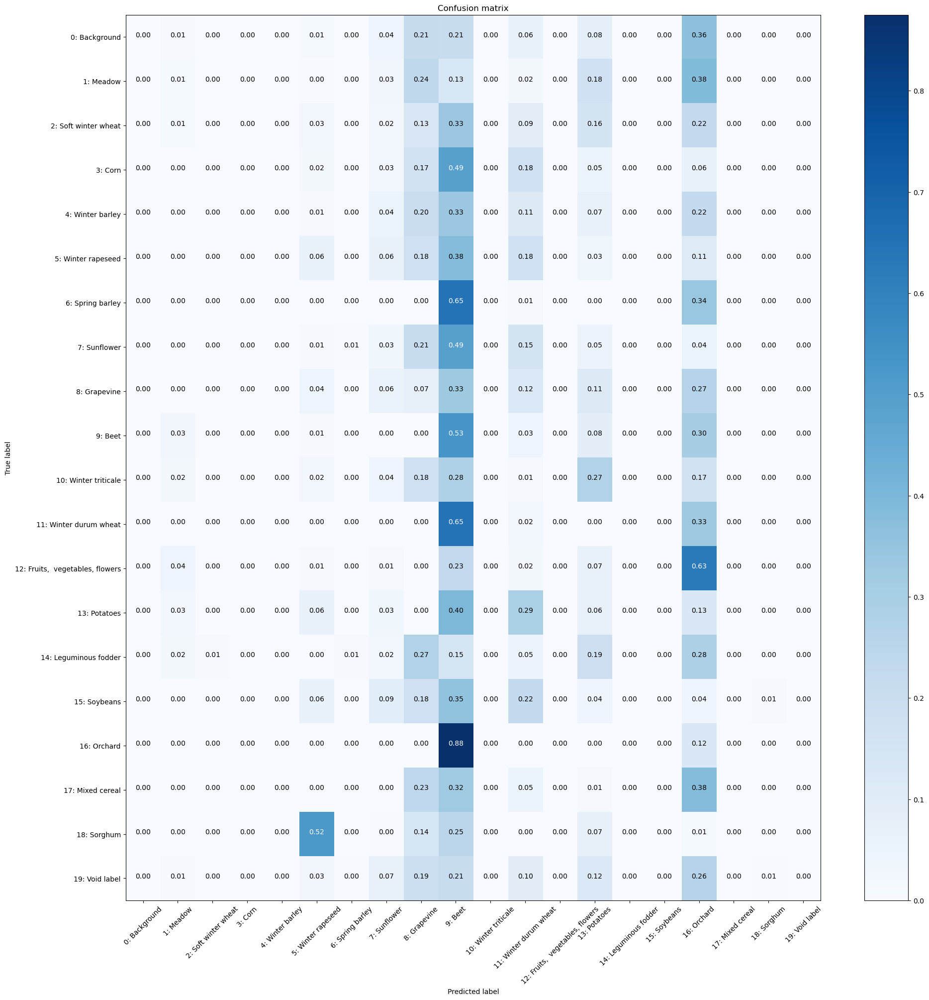

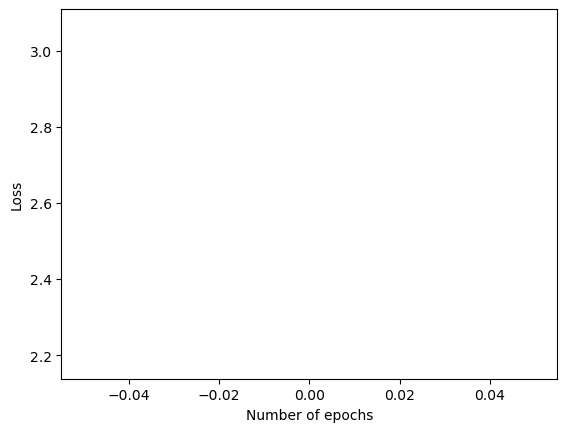

Checking accuracy on validation/test set
Got 329943 / 819200 correct (40.28)
Loss=1.99
Iteration 0, loss = 2.0468
Checking accuracy on validation/test set
Got 328498 / 819200 correct (40.10)
Loss=1.99
Normalized confusion matrix


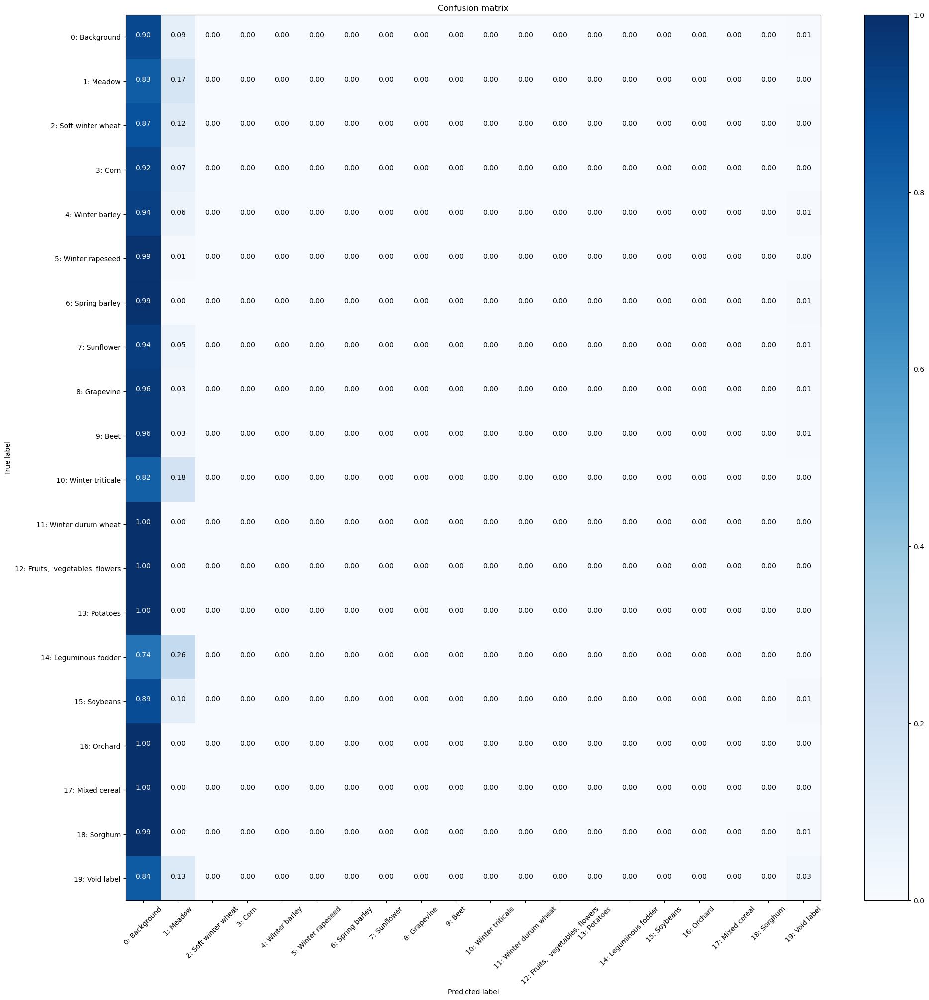

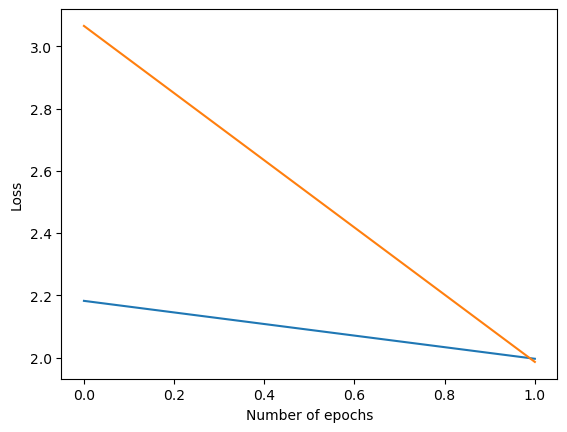

Checking accuracy on validation/test set
Got 333487 / 819200 correct (40.71)
Loss=1.87
Iteration 0, loss = 1.9307
Checking accuracy on validation/test set
Got 334289 / 819200 correct (40.81)
Loss=1.87
Normalized confusion matrix


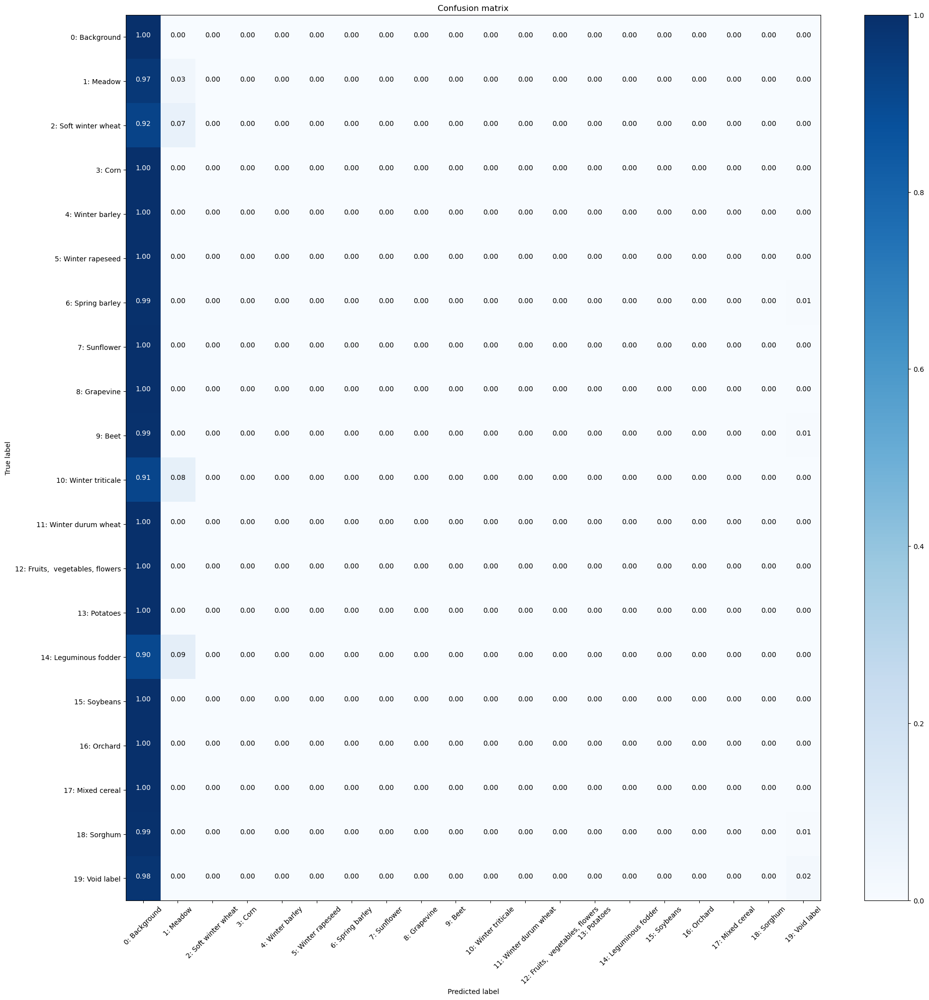

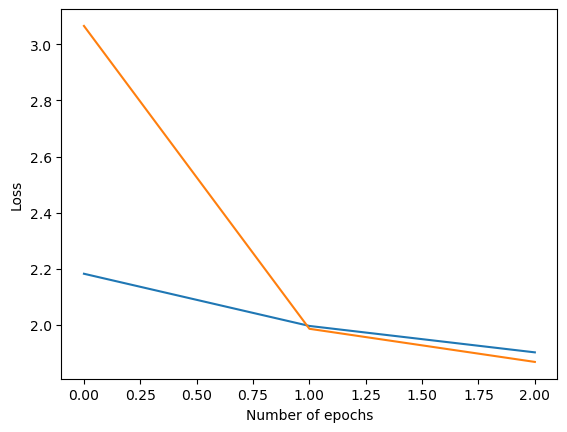

Checking accuracy on validation/test set
Got 345976 / 819200 correct (42.23)
Loss=1.83
Iteration 0, loss = 2.1283
Checking accuracy on validation/test set
Got 346320 / 819200 correct (42.28)
Loss=1.84
Normalized confusion matrix


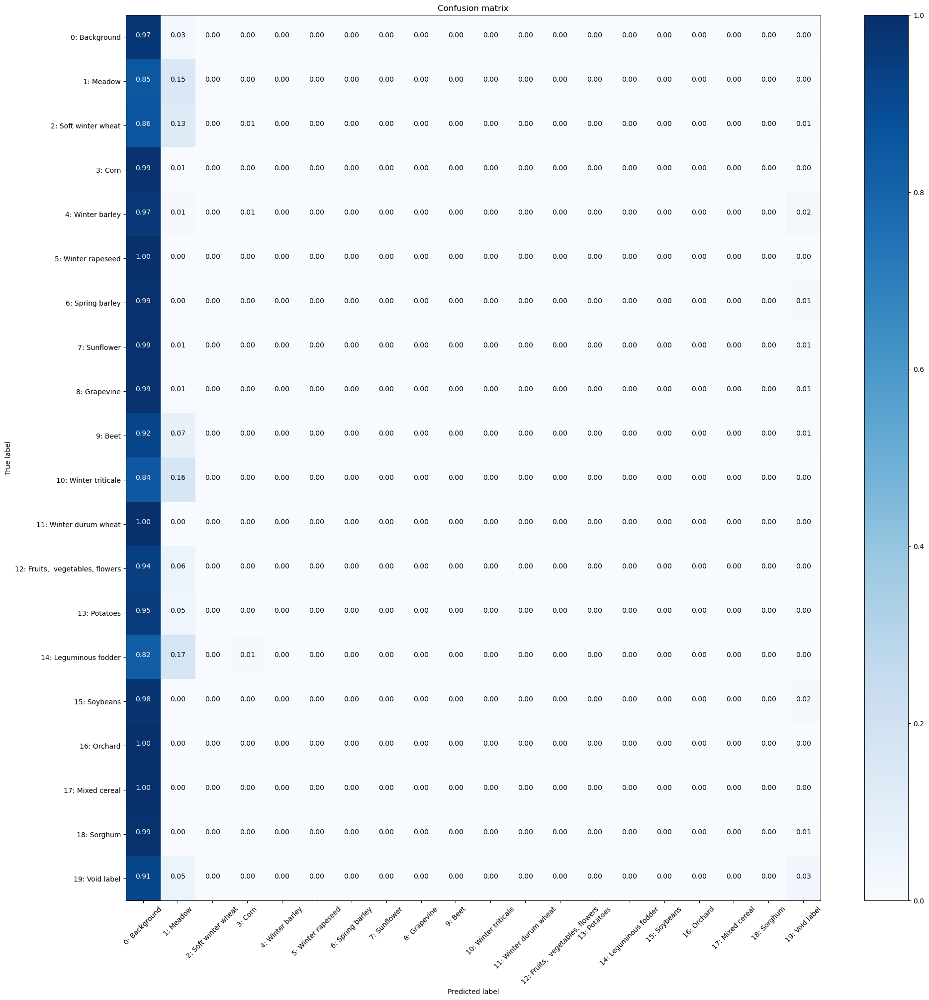

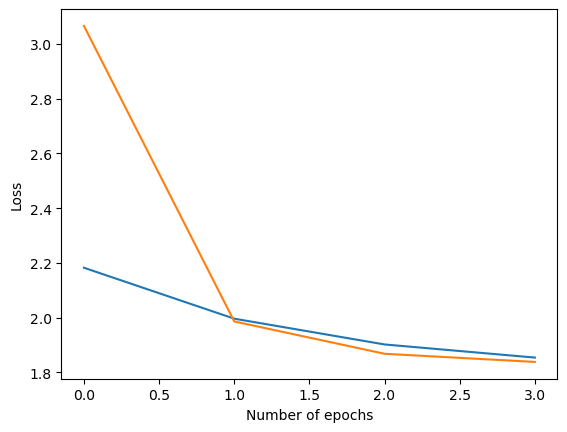

Checking accuracy on validation/test set
Got 343543 / 819200 correct (41.94)
Loss=1.83
Iteration 0, loss = 1.4002
Checking accuracy on validation/test set
Got 342540 / 819200 correct (41.81)
Loss=1.84
Normalized confusion matrix


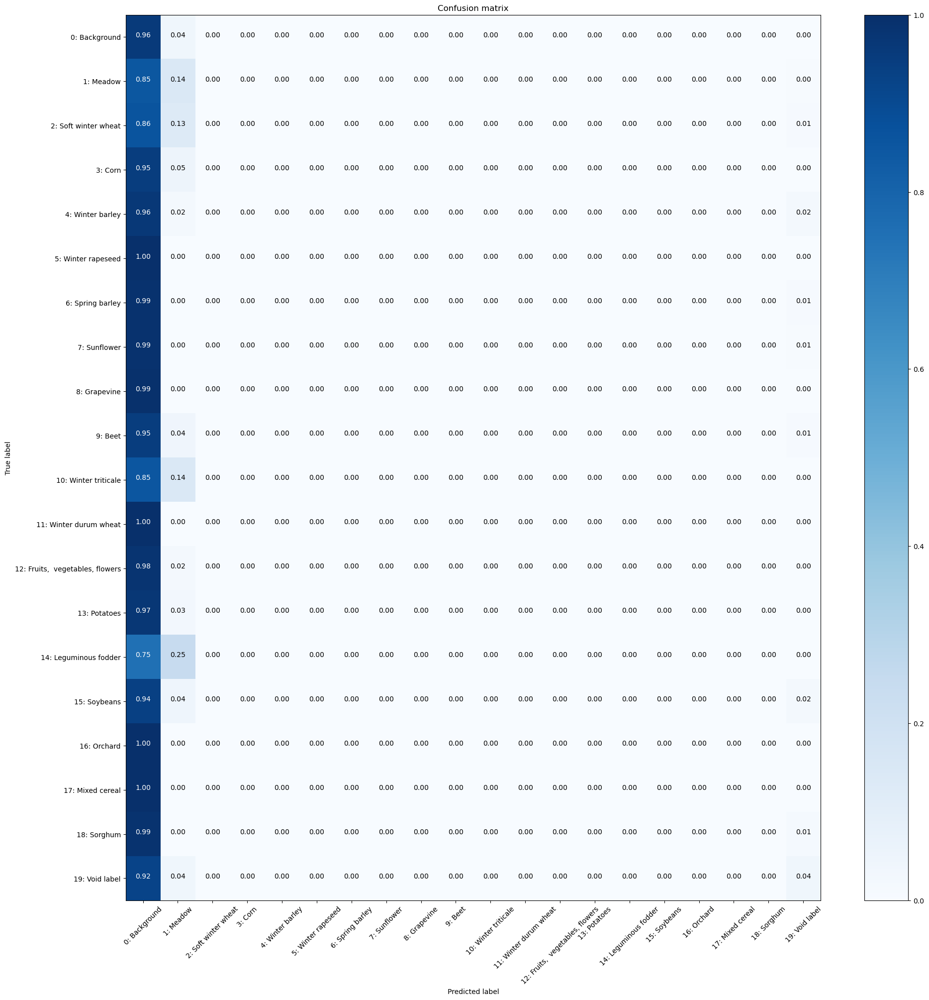

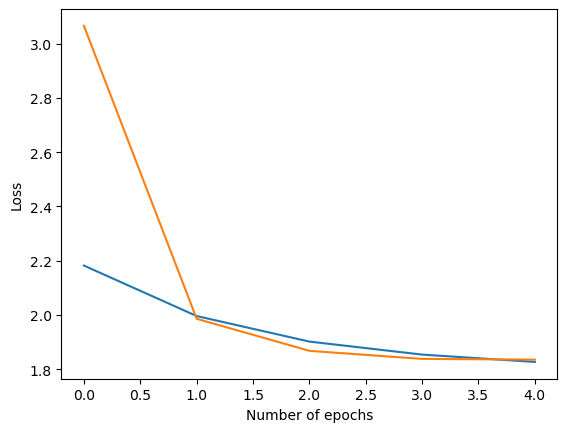

Checking accuracy on validation/test set
Got 352681 / 819200 correct (43.05)
Loss=1.75
Iteration 0, loss = 1.4723
Checking accuracy on validation/test set
Got 354222 / 819200 correct (43.24)
Loss=1.74
Normalized confusion matrix


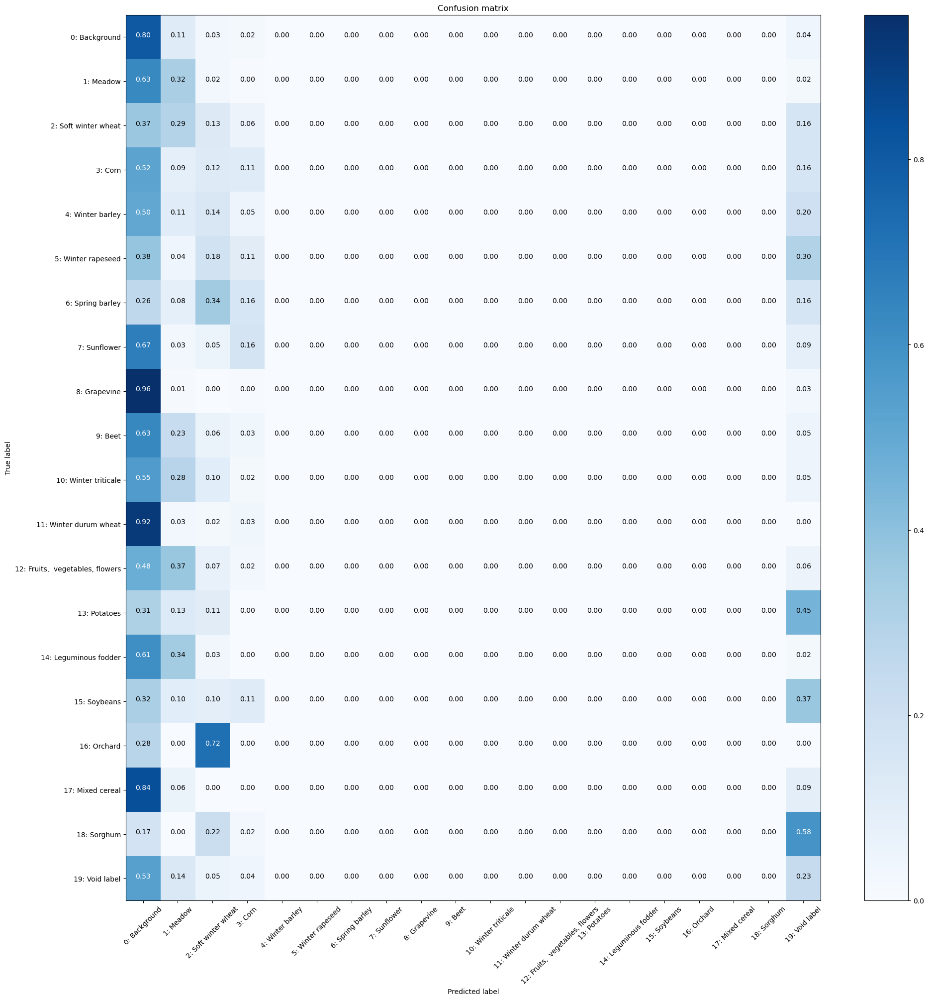

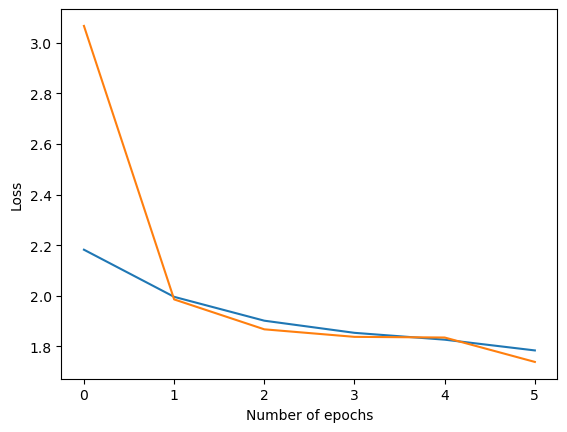

Checking accuracy on validation/test set
Got 347228 / 819200 correct (42.39)
Loss=1.80
Iteration 0, loss = 2.4248
Checking accuracy on validation/test set
Got 346145 / 819200 correct (42.25)
Loss=1.80
Normalized confusion matrix


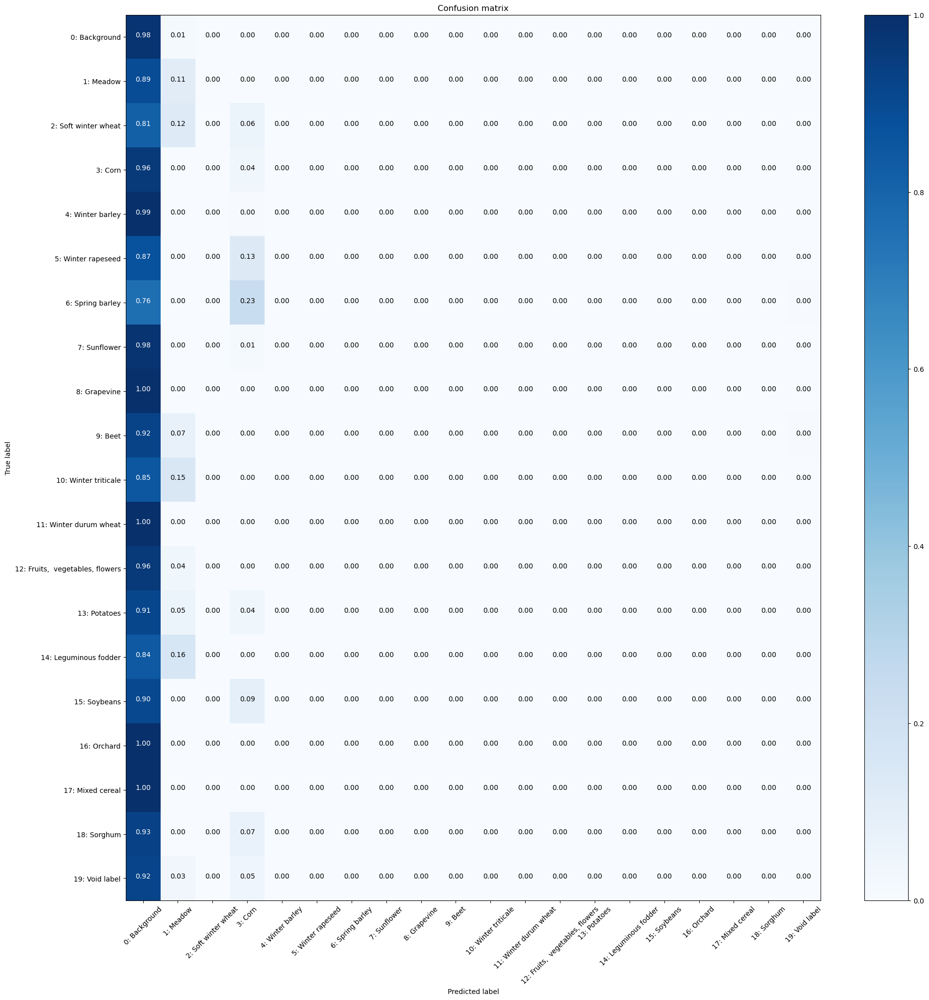

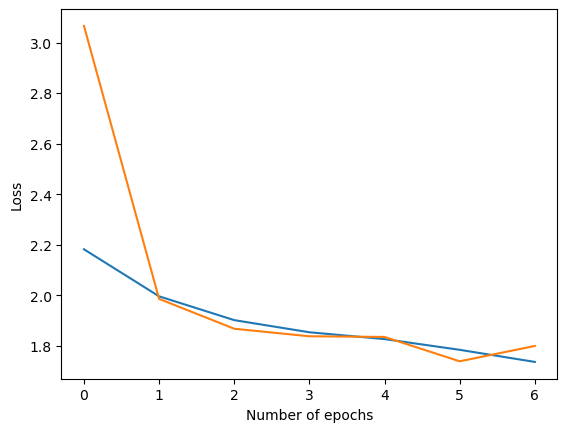

Checking accuracy on validation/test set
Got 363091 / 819200 correct (44.32)
Loss=1.70
Iteration 0, loss = 2.1498
Checking accuracy on validation/test set
Got 366295 / 819200 correct (44.71)
Loss=1.69
Normalized confusion matrix


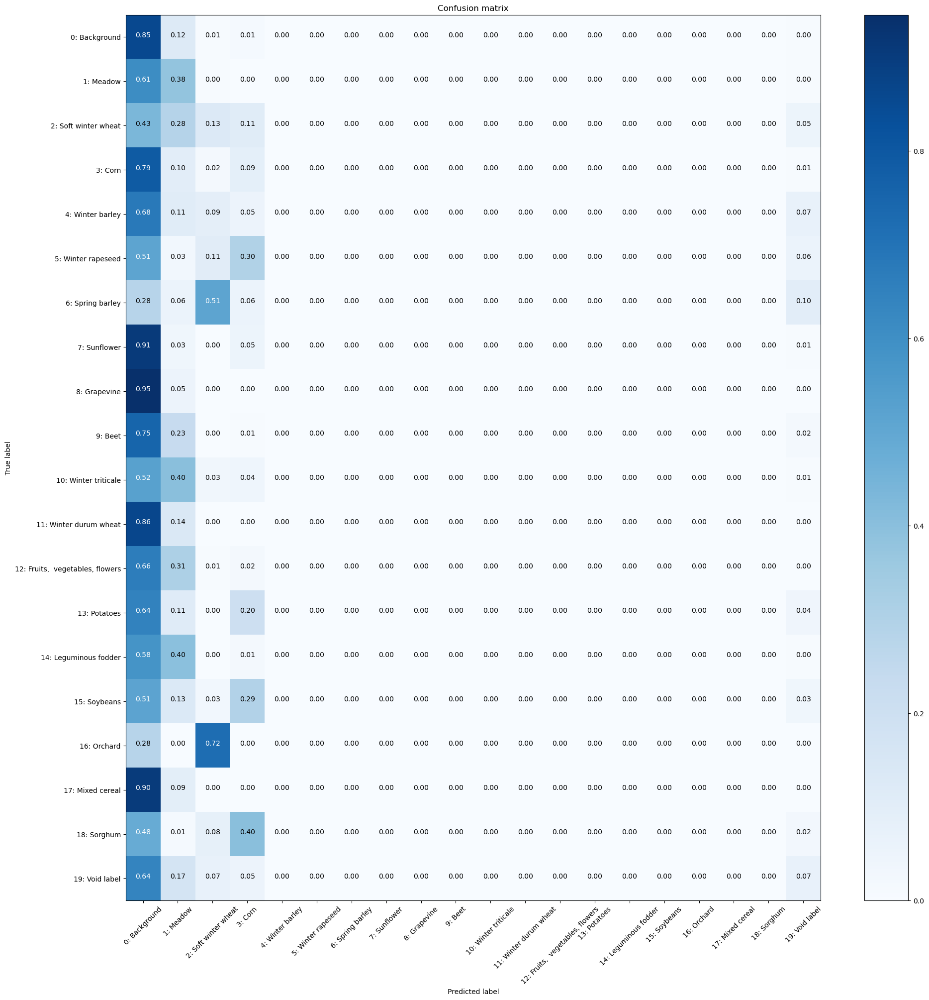

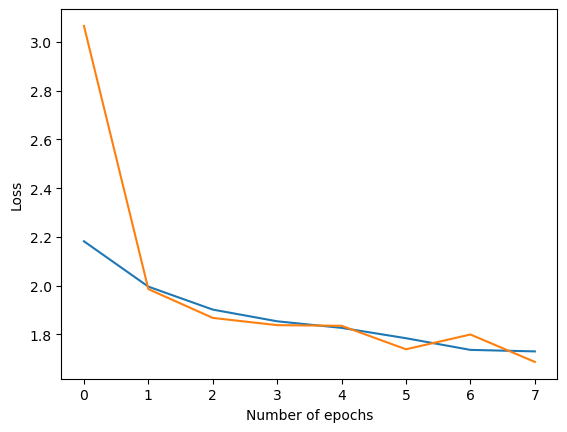

Checking accuracy on validation/test set
Got 375373 / 819200 correct (45.82)
Loss=1.69
Iteration 0, loss = 1.7576
Checking accuracy on validation/test set
Got 374848 / 819200 correct (45.76)
Loss=1.69
Normalized confusion matrix


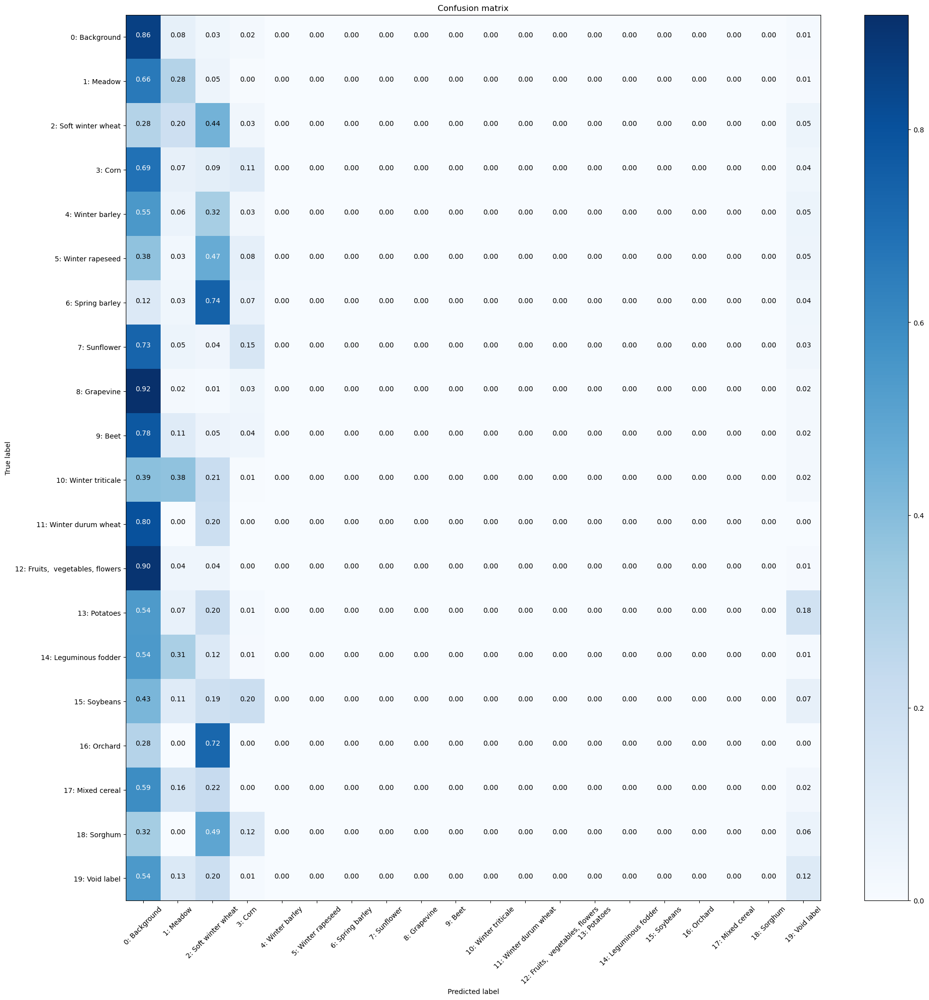

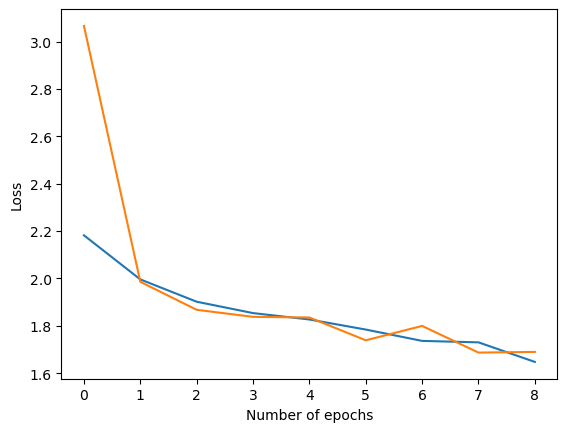

Checking accuracy on validation/test set
Got 369977 / 819200 correct (45.16)
Loss=1.66
Iteration 0, loss = 1.6537
Checking accuracy on validation/test set
Got 370362 / 819200 correct (45.21)
Loss=1.66
Normalized confusion matrix


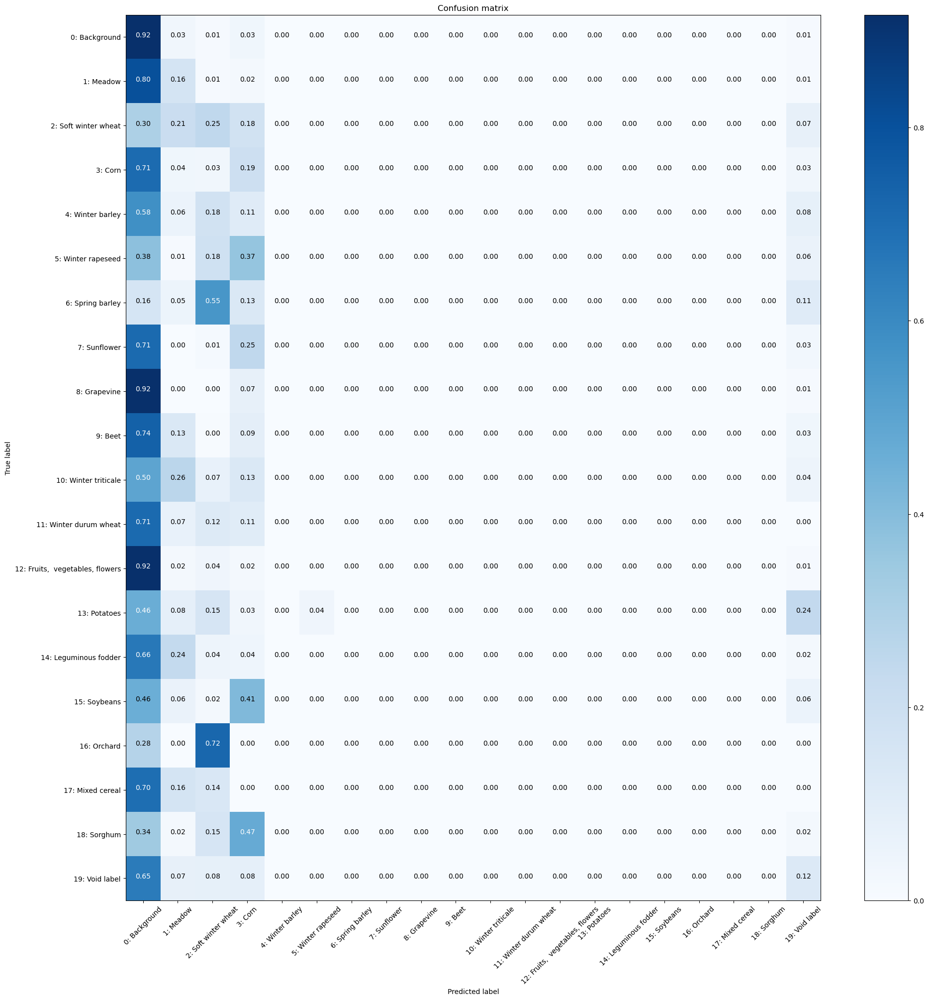

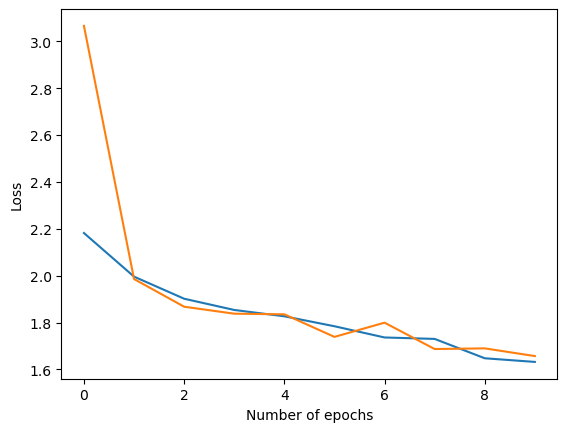

Checking accuracy on validation/test set
Got 375536 / 819200 correct (45.84)
Loss=1.78
Iteration 0, loss = 0.4306
Checking accuracy on validation/test set
Got 375061 / 819200 correct (45.78)
Loss=1.78
Normalized confusion matrix


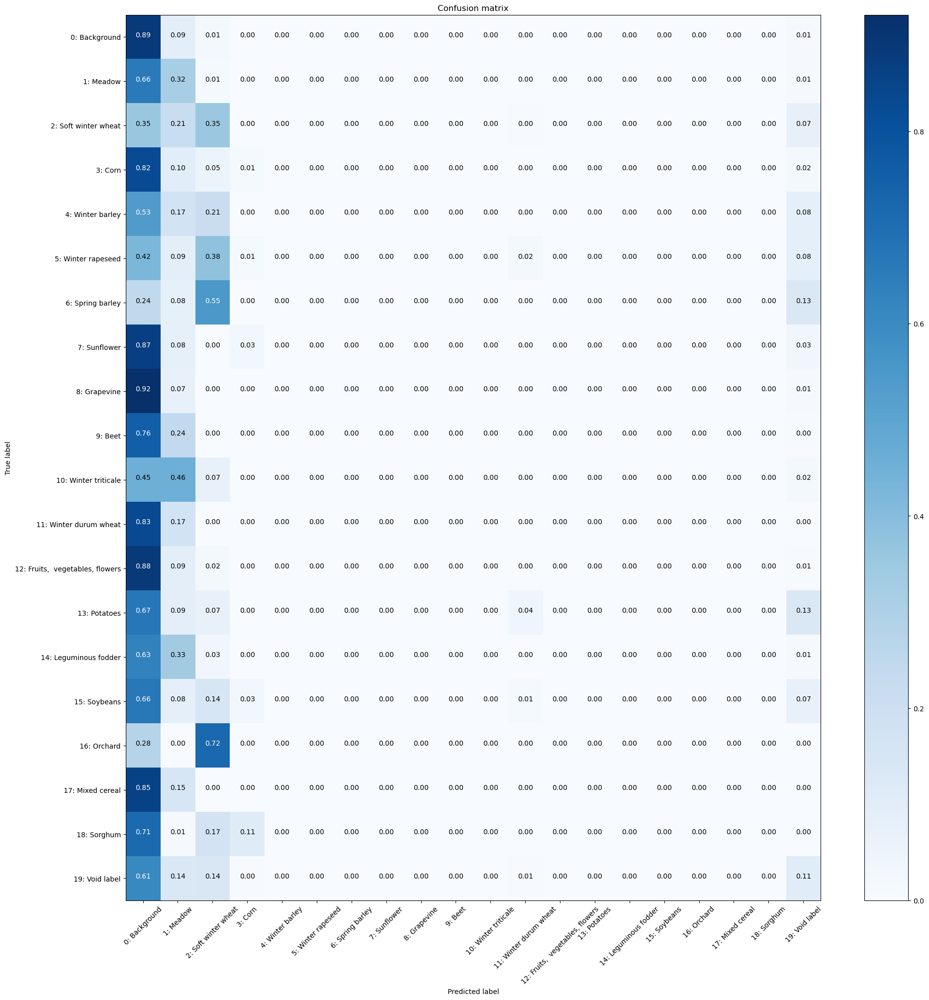

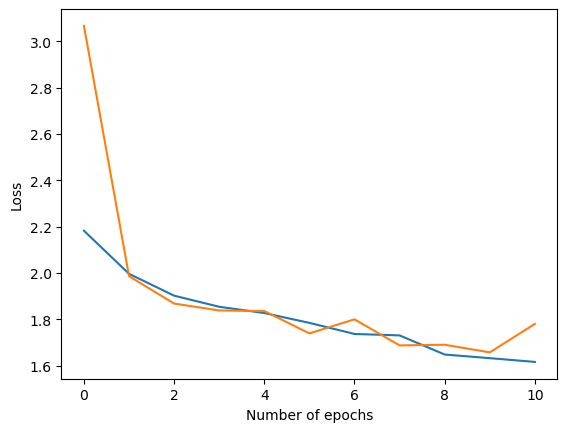

Checking accuracy on validation/test set
Got 384347 / 819200 correct (46.92)
Loss=1.72
Iteration 0, loss = 2.1070
Checking accuracy on validation/test set
Got 385197 / 819200 correct (47.02)
Loss=1.72
Normalized confusion matrix


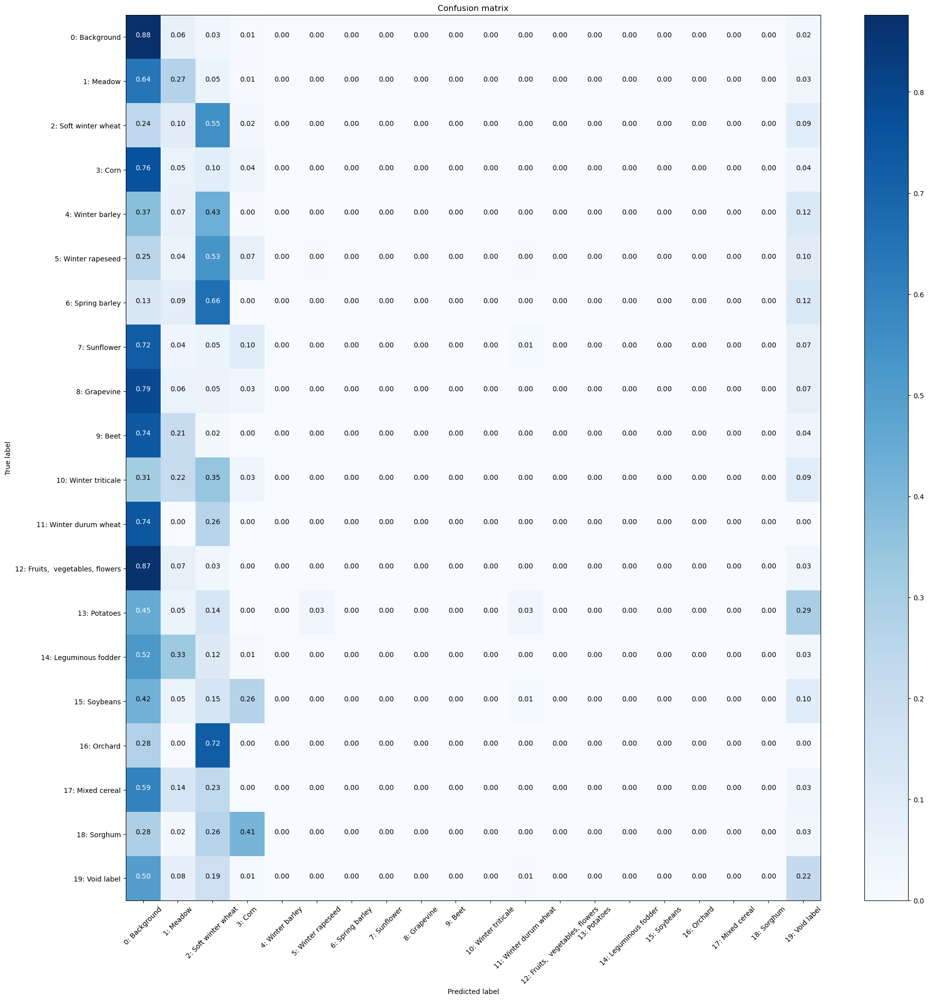

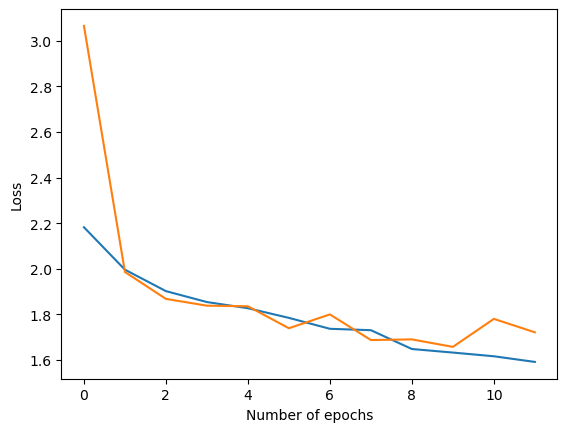

Checking accuracy on validation/test set
Got 386899 / 819200 correct (47.23)
Loss=1.61
Iteration 0, loss = 1.5663
Checking accuracy on validation/test set
Got 388354 / 819200 correct (47.41)
Loss=1.60
Normalized confusion matrix


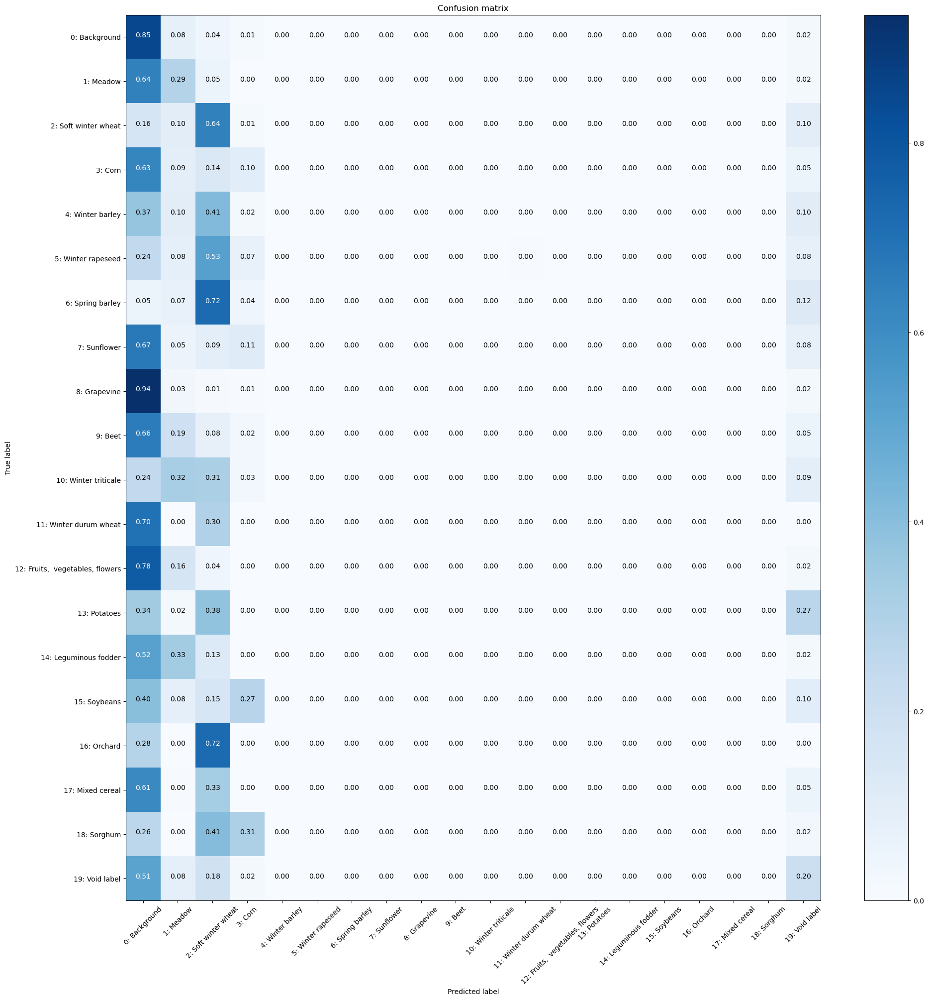

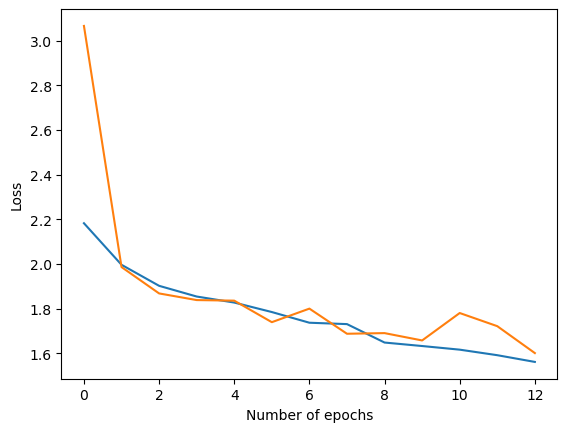

Checking accuracy on validation/test set
Got 386873 / 819200 correct (47.23)
Loss=1.61
Iteration 0, loss = 1.0484
Checking accuracy on validation/test set
Got 385613 / 819200 correct (47.07)
Loss=1.62
Normalized confusion matrix


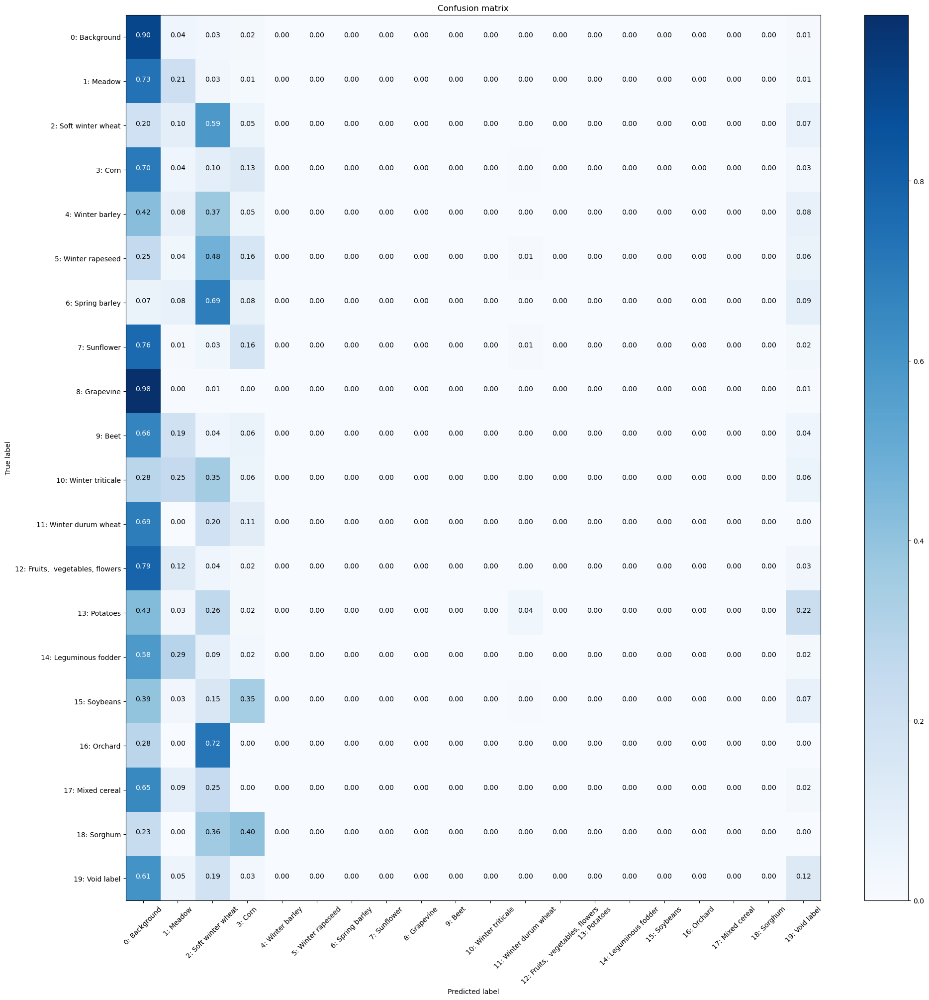

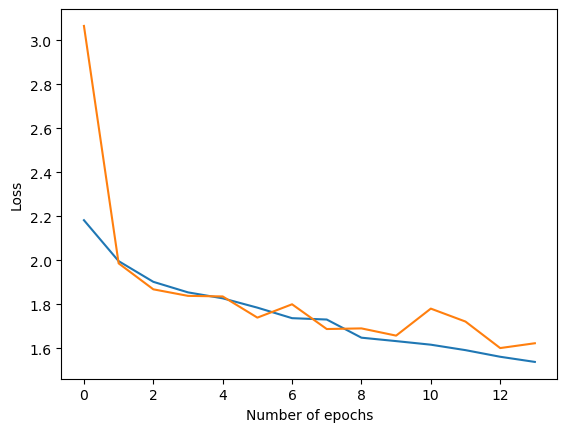

Checking accuracy on validation/test set
Got 388696 / 819200 correct (47.45)
Loss=1.60
Iteration 0, loss = 1.5398
Checking accuracy on validation/test set
Got 389369 / 819200 correct (47.53)
Loss=1.59
Normalized confusion matrix


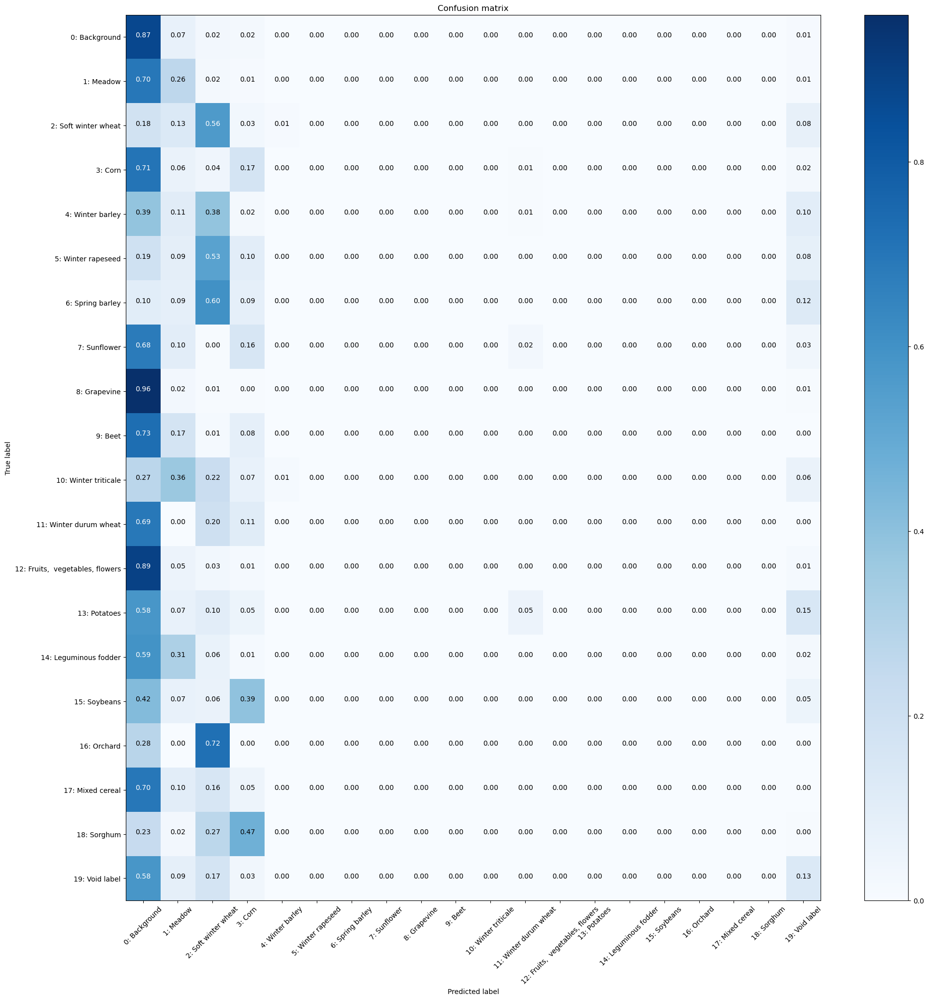

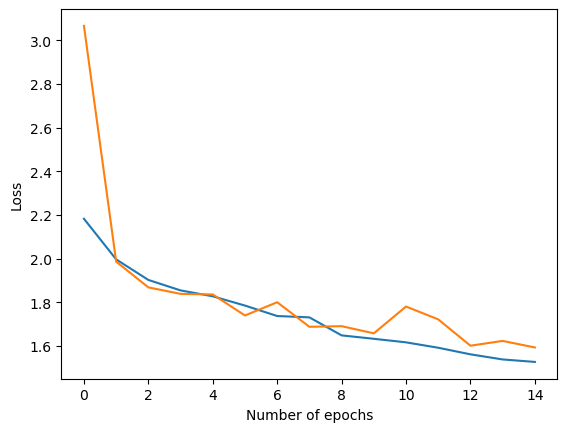

Checking accuracy on validation/test set
Got 394806 / 819200 correct (48.19)
Loss=1.56
Iteration 0, loss = 1.6148
Checking accuracy on validation/test set
Got 395074 / 819200 correct (48.23)
Loss=1.56
Normalized confusion matrix


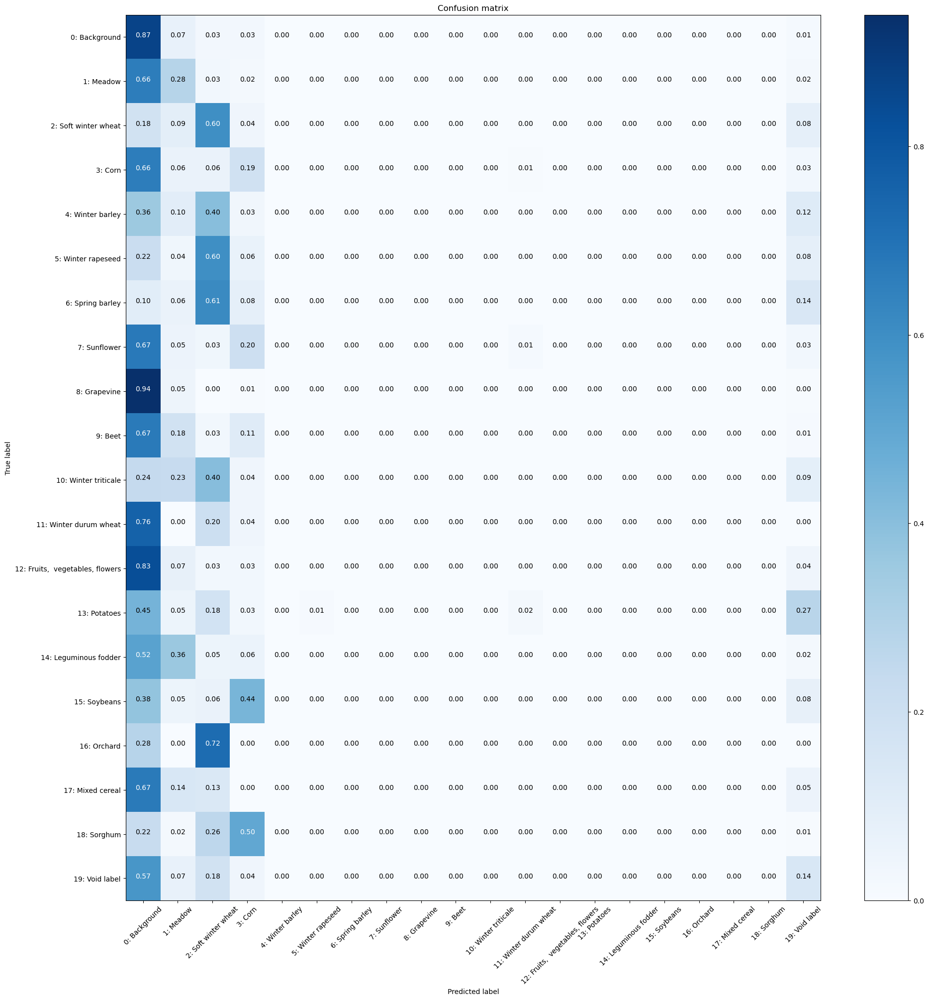

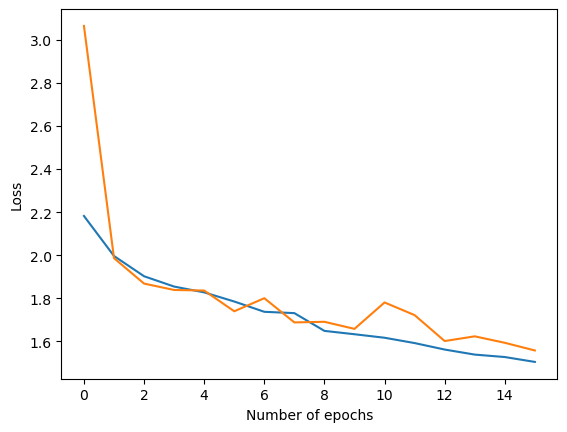

Checking accuracy on validation/test set
Got 369696 / 819200 correct (45.13)
Loss=1.64
Iteration 0, loss = 1.1775
Checking accuracy on validation/test set
Got 368189 / 819200 correct (44.94)
Loss=1.65
Normalized confusion matrix


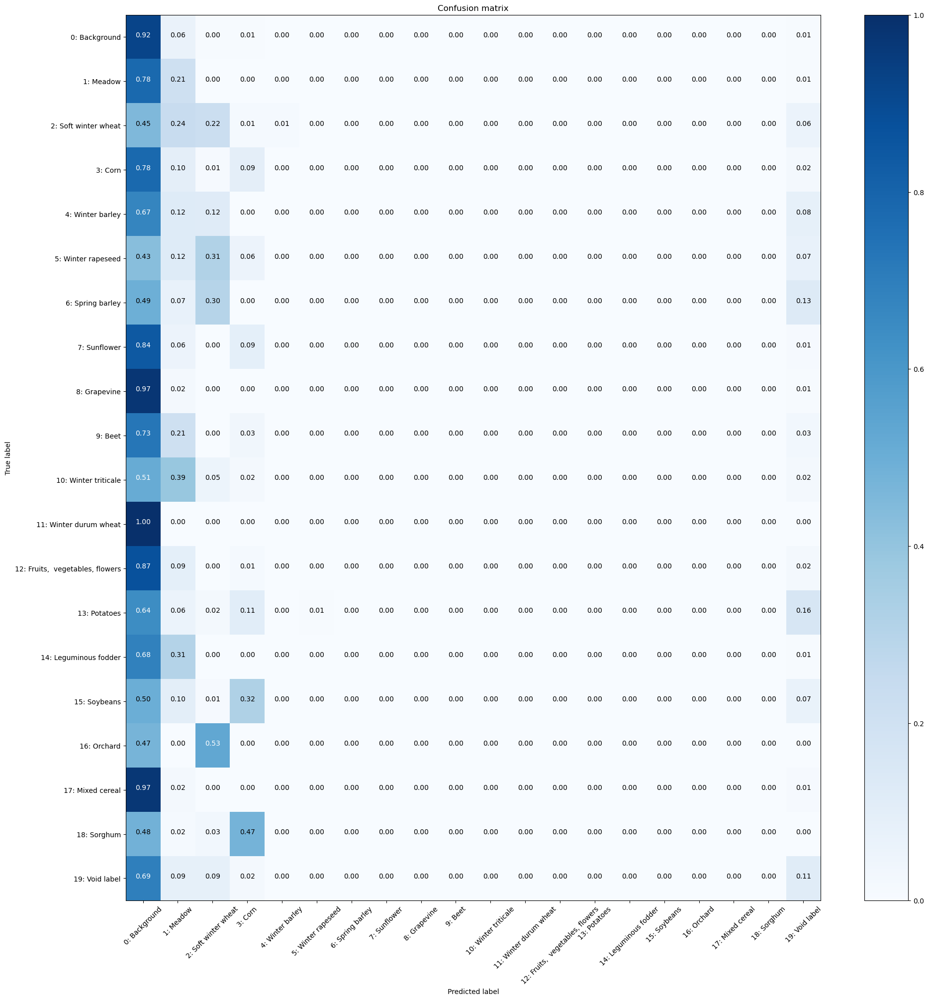

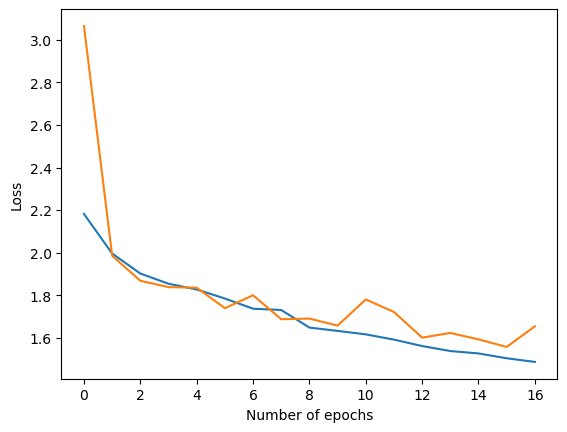

Checking accuracy on validation/test set
Got 428324 / 819200 correct (52.29)
Loss=1.46
Iteration 0, loss = 2.0445
Checking accuracy on validation/test set
Got 425987 / 819200 correct (52.00)
Loss=1.47
Normalized confusion matrix


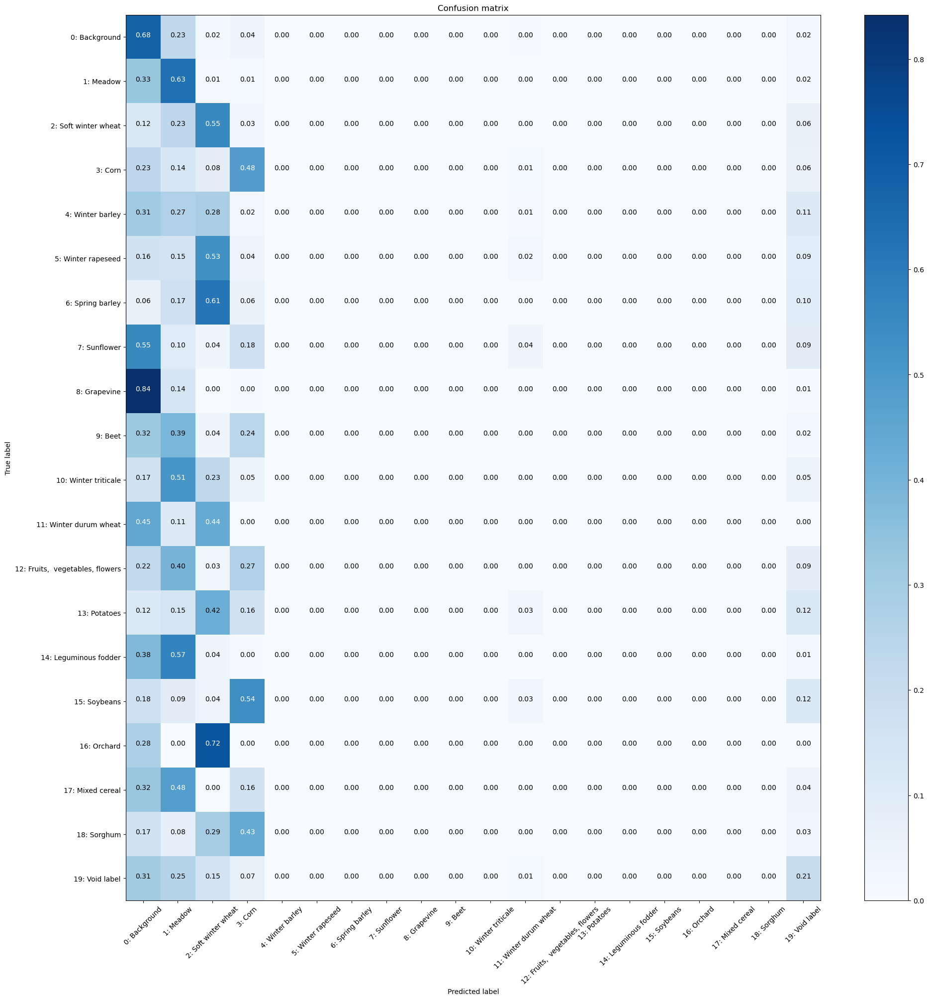

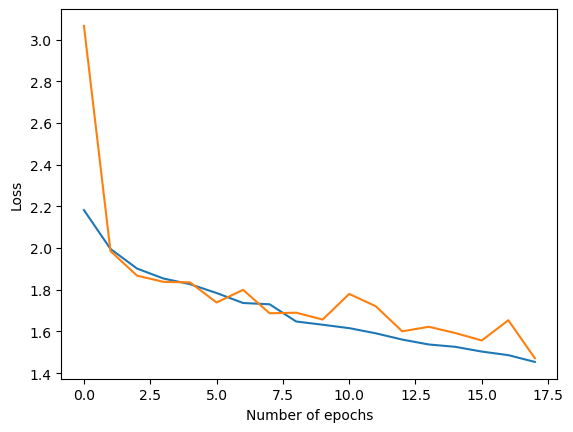

Checking accuracy on validation/test set
Got 396558 / 819200 correct (48.41)
Loss=1.56
Iteration 0, loss = 1.3056
Checking accuracy on validation/test set
Got 394345 / 819200 correct (48.14)
Loss=1.57
Normalized confusion matrix


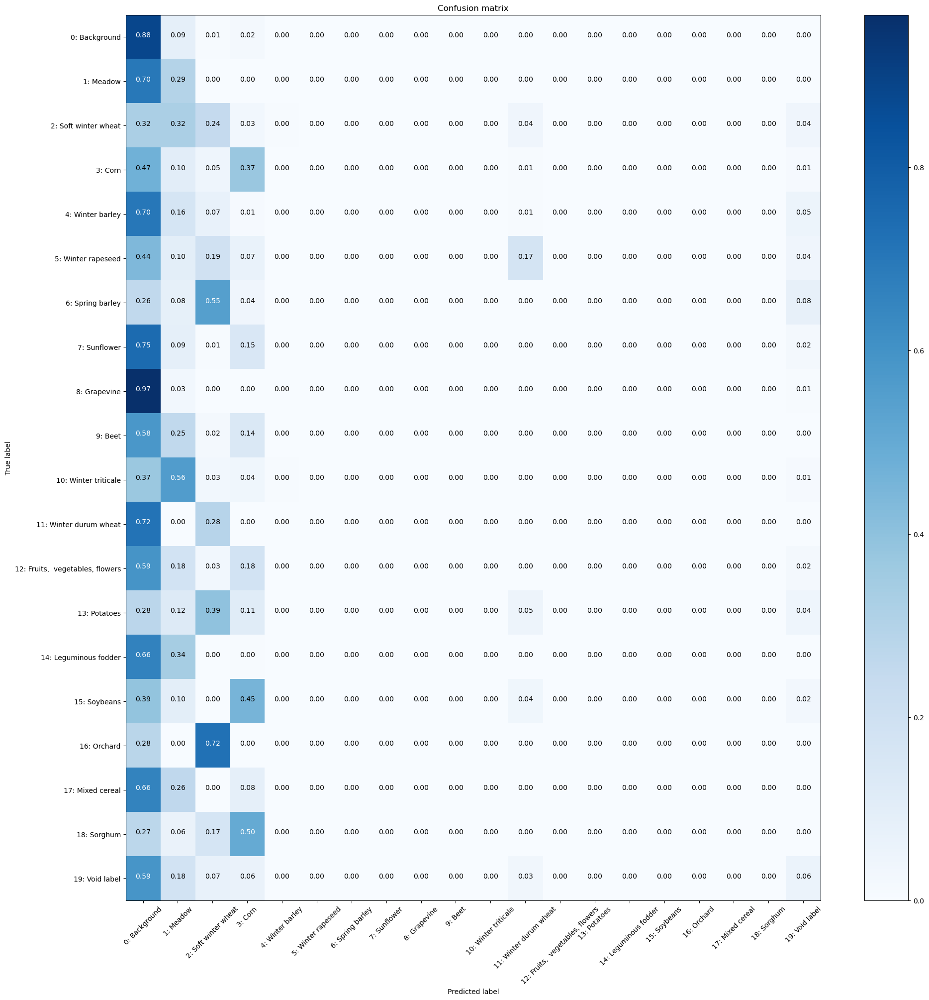

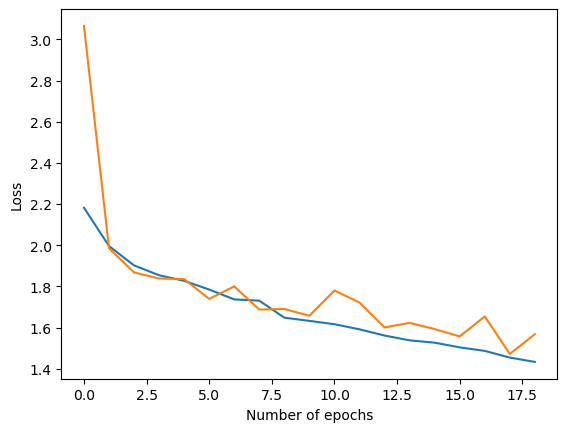

Checking accuracy on validation/test set
Got 407399 / 819200 correct (49.73)
Loss=1.52
Iteration 0, loss = 0.8366
Checking accuracy on validation/test set
Got 406363 / 819200 correct (49.60)
Loss=1.52
Normalized confusion matrix


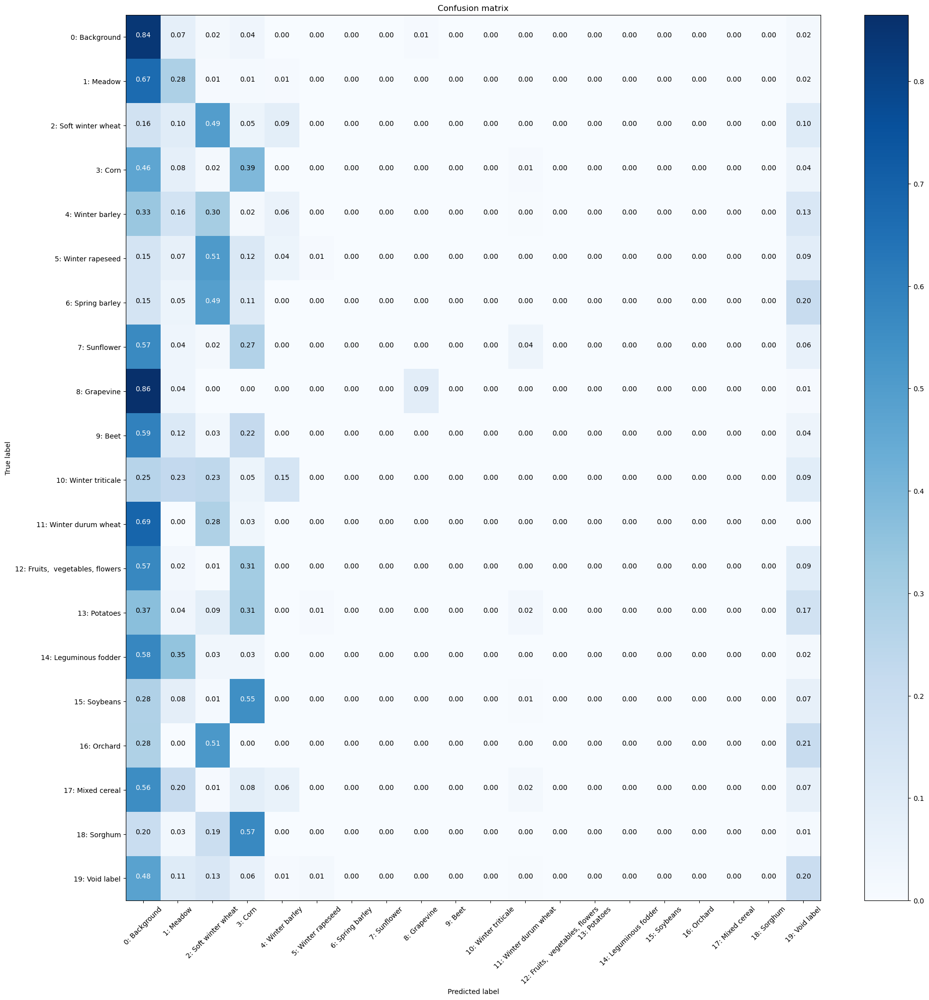

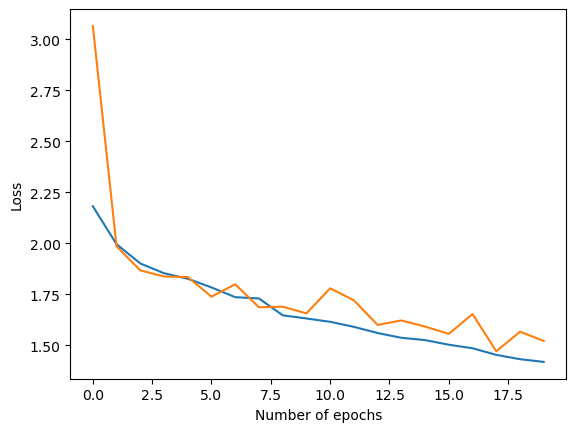

Checking accuracy on validation/test set
Got 435871 / 819200 correct (53.21)
Loss=1.40
Iteration 0, loss = 1.2996
Checking accuracy on validation/test set
Got 434955 / 819200 correct (53.10)
Loss=1.40
Normalized confusion matrix


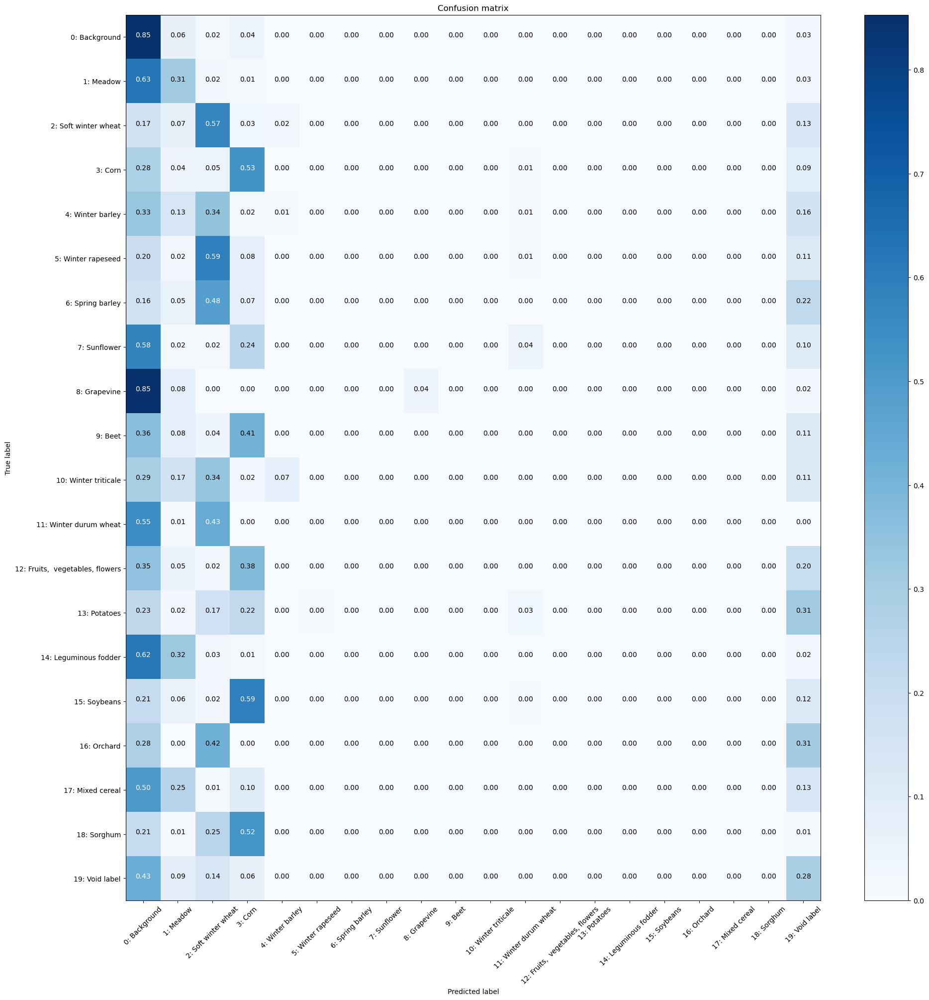

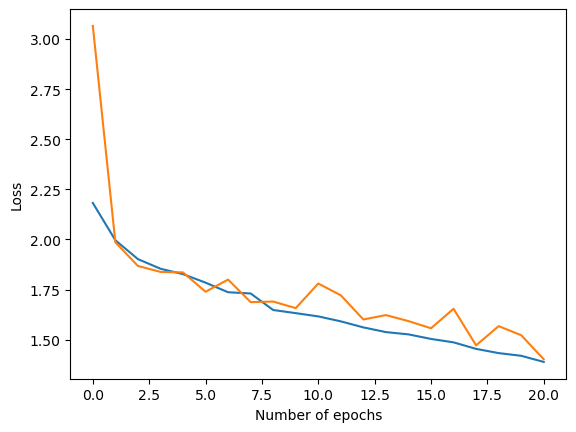

Checking accuracy on validation/test set
Got 448190 / 819200 correct (54.71)
Loss=1.36
Iteration 0, loss = 1.5591
Checking accuracy on validation/test set
Got 447668 / 819200 correct (54.65)
Loss=1.36
Normalized confusion matrix


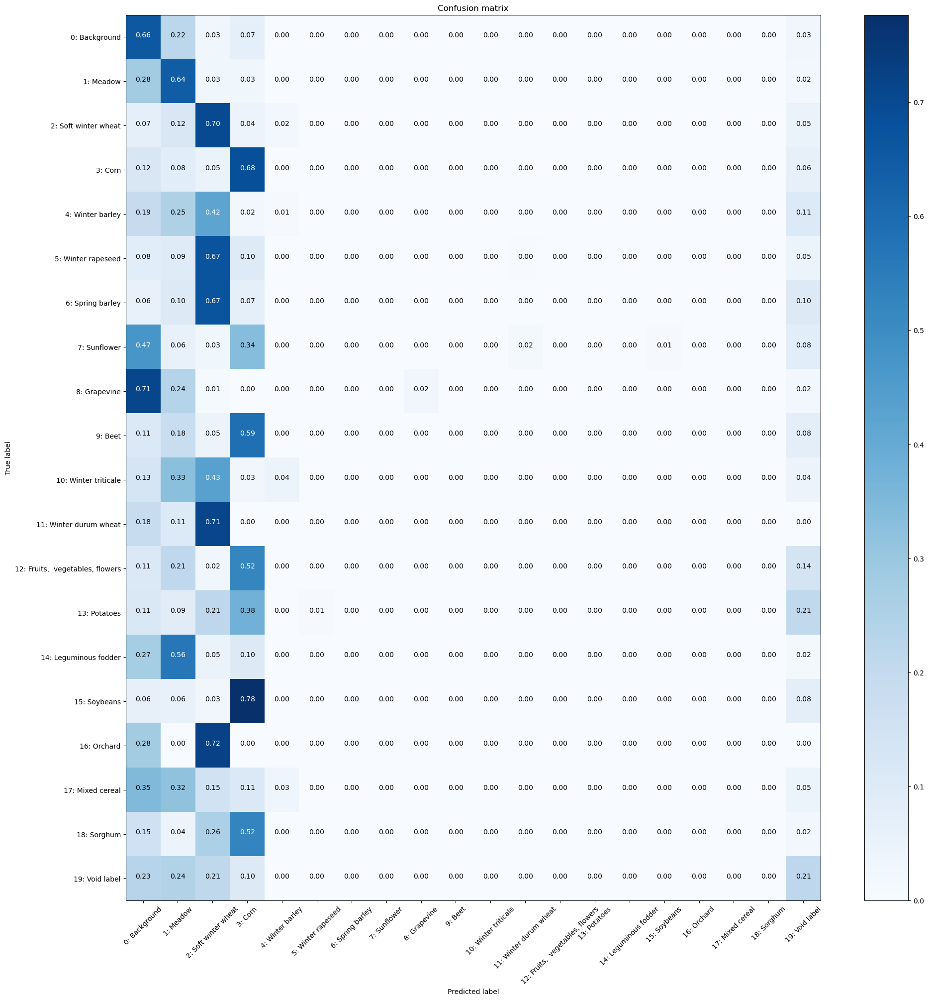

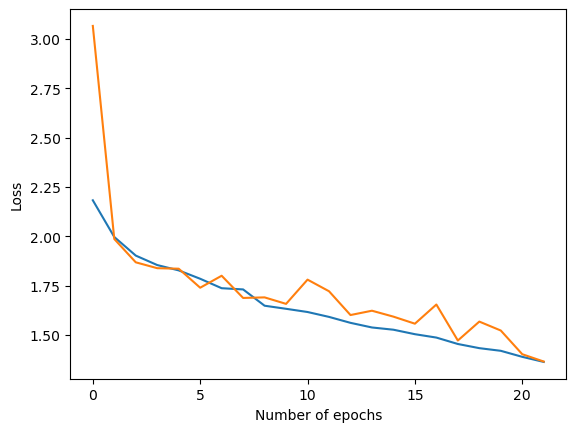

Checking accuracy on validation/test set
Got 458960 / 819200 correct (56.03)
Loss=1.36
Iteration 0, loss = 0.9290
Checking accuracy on validation/test set
Got 459259 / 819200 correct (56.06)
Loss=1.38
Normalized confusion matrix


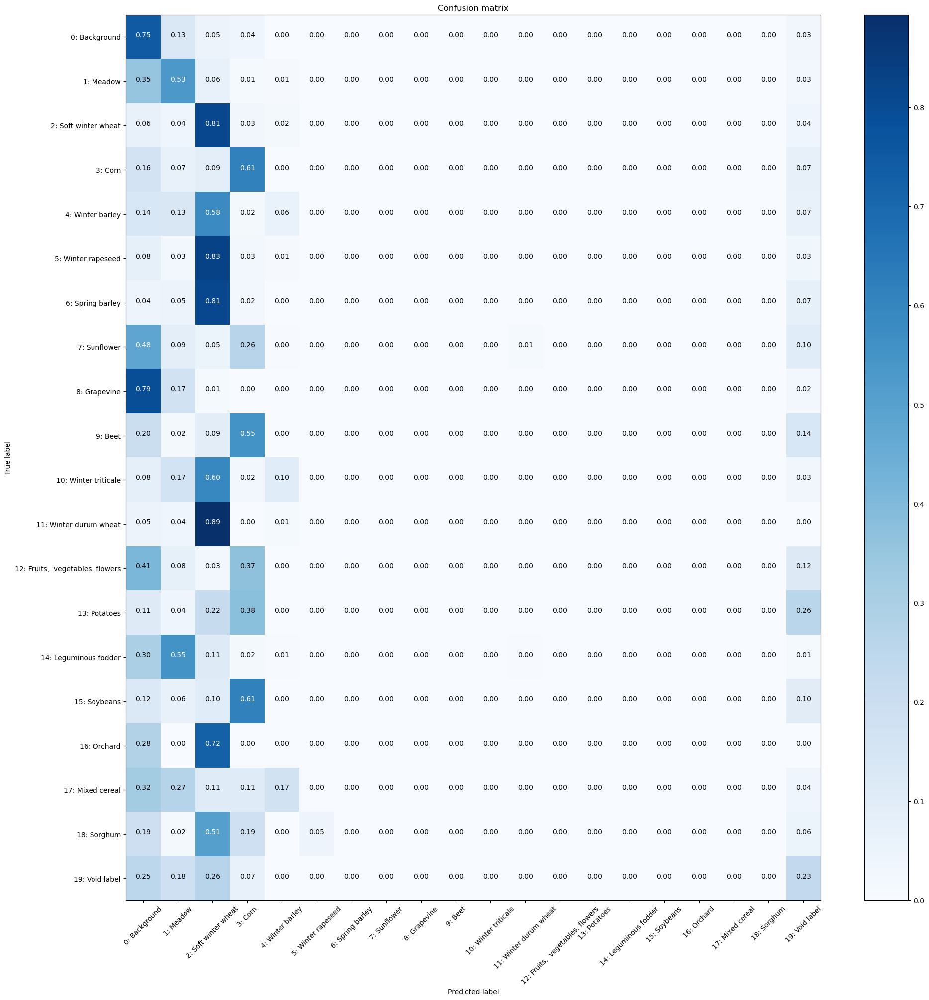

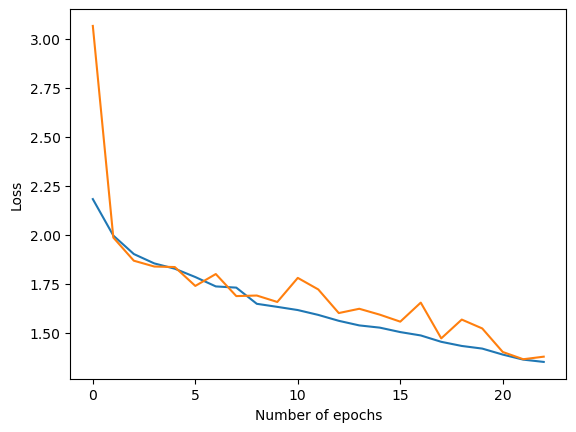

Checking accuracy on validation/test set
Got 458001 / 819200 correct (55.91)
Loss=1.35
Iteration 0, loss = 1.2637
Checking accuracy on validation/test set
Got 458655 / 819200 correct (55.99)
Loss=1.35
Normalized confusion matrix


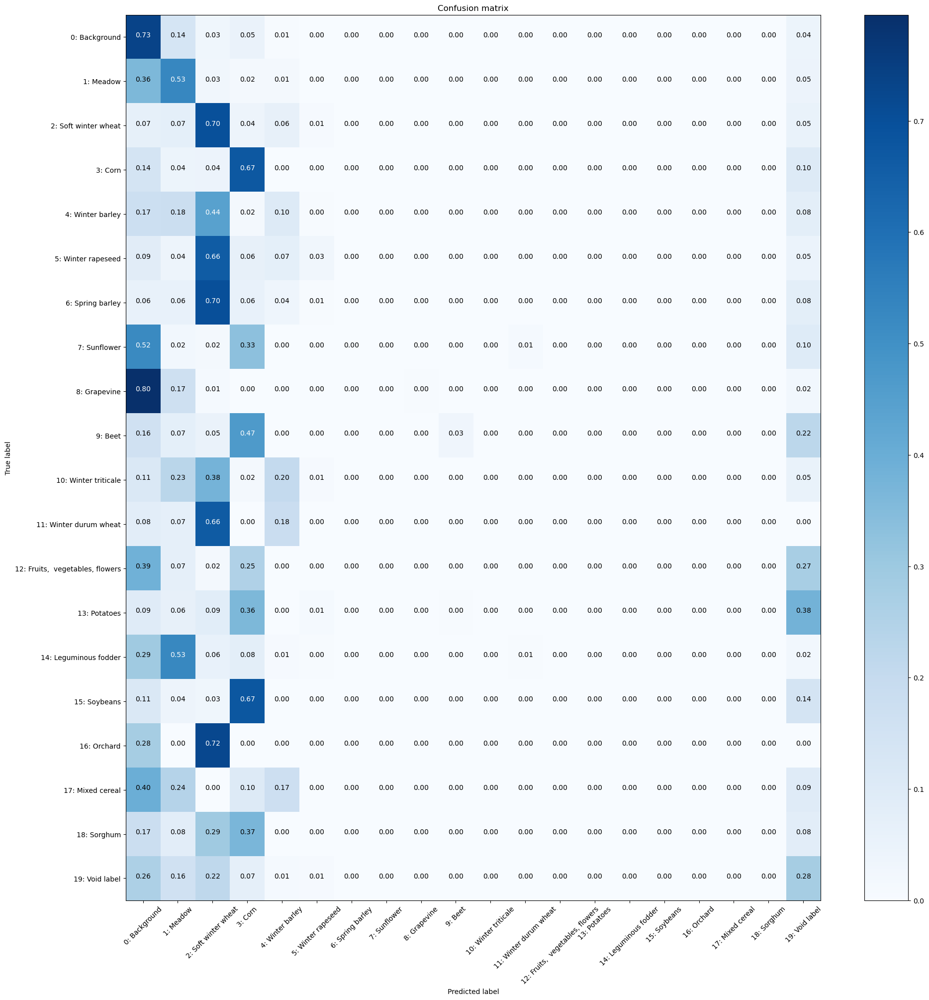

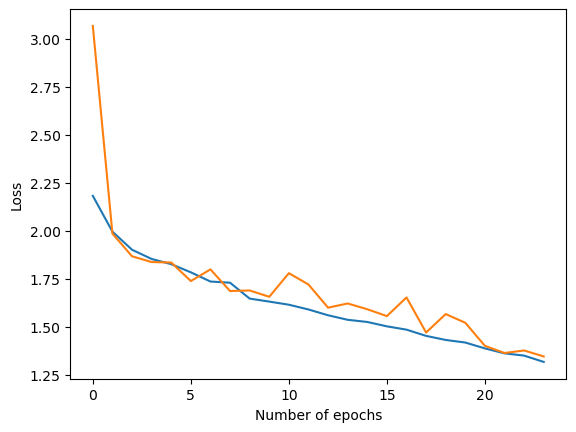

Checking accuracy on validation/test set
Got 447544 / 819200 correct (54.63)
Loss=1.39
Iteration 0, loss = 1.4498
Checking accuracy on validation/test set
Got 443179 / 819200 correct (54.10)
Loss=1.41
Normalized confusion matrix


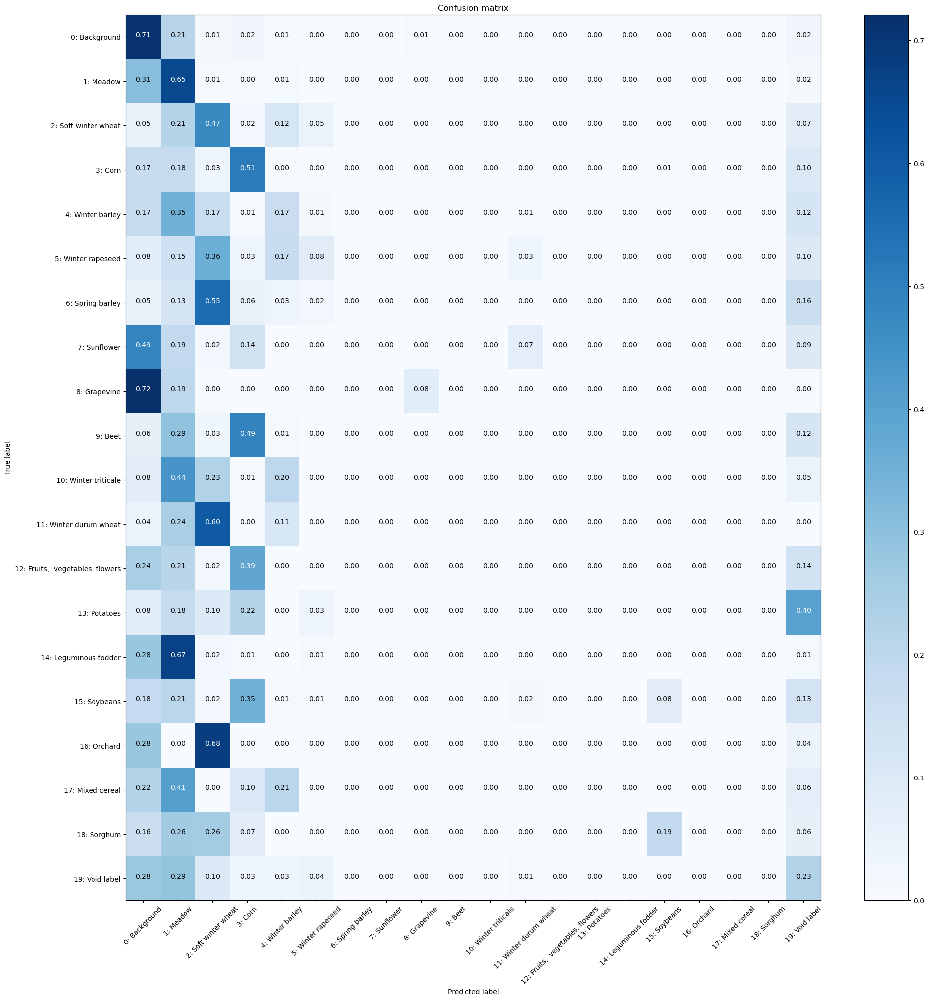

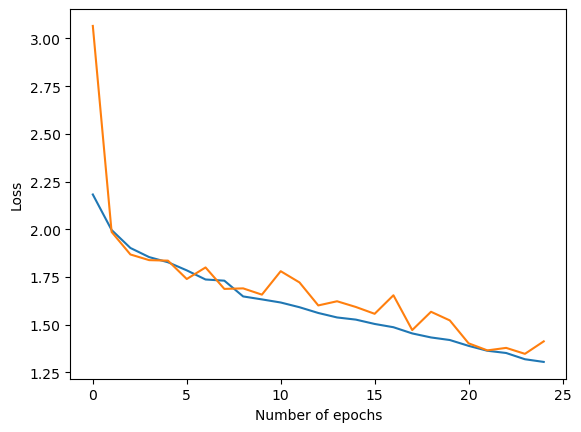

Checking accuracy on validation/test set
Got 448036 / 819200 correct (54.69)
Loss=1.34
Iteration 0, loss = 1.2797
Checking accuracy on validation/test set
Got 452123 / 819200 correct (55.19)
Loss=1.32
Normalized confusion matrix


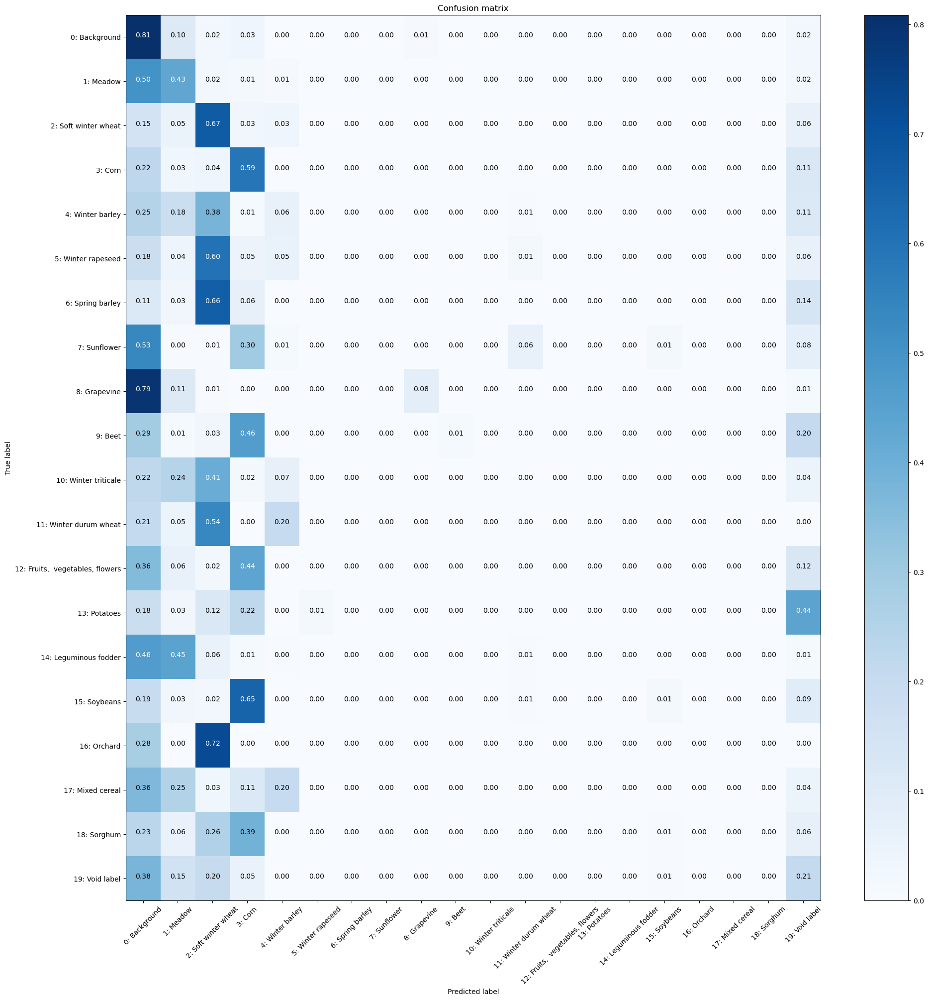

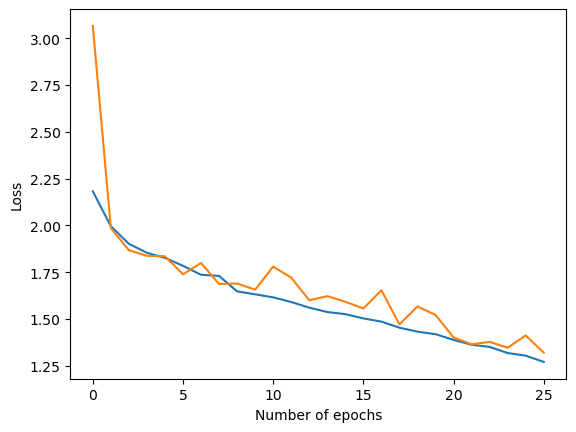

Checking accuracy on validation/test set
Got 448123 / 819200 correct (54.70)
Loss=1.34
Iteration 0, loss = 2.4846
Checking accuracy on validation/test set
Got 448200 / 819200 correct (54.71)
Loss=1.35
Normalized confusion matrix


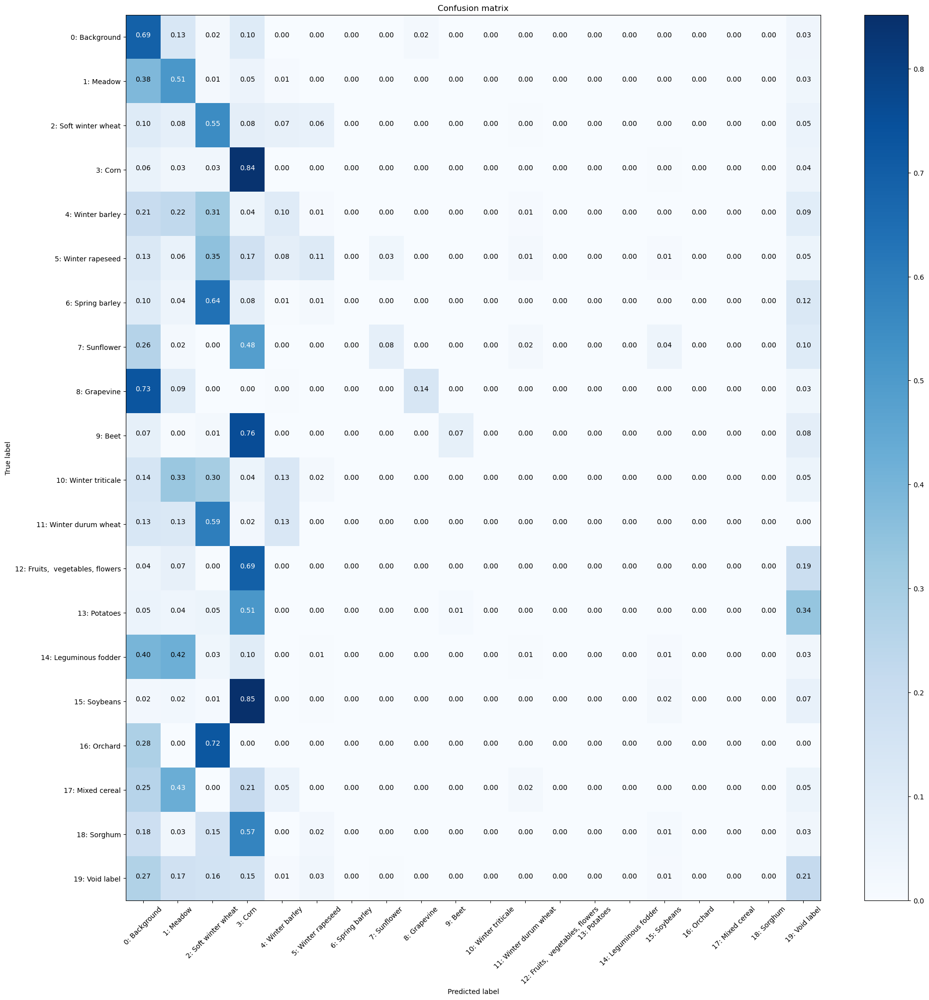

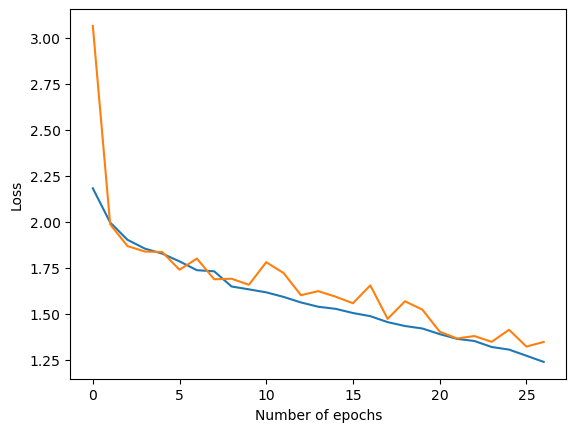

Checking accuracy on validation/test set
Got 459117 / 819200 correct (56.04)
Loss=1.33
Iteration 0, loss = 1.5638
Checking accuracy on validation/test set
Got 460193 / 819200 correct (56.18)
Loss=1.33
Normalized confusion matrix


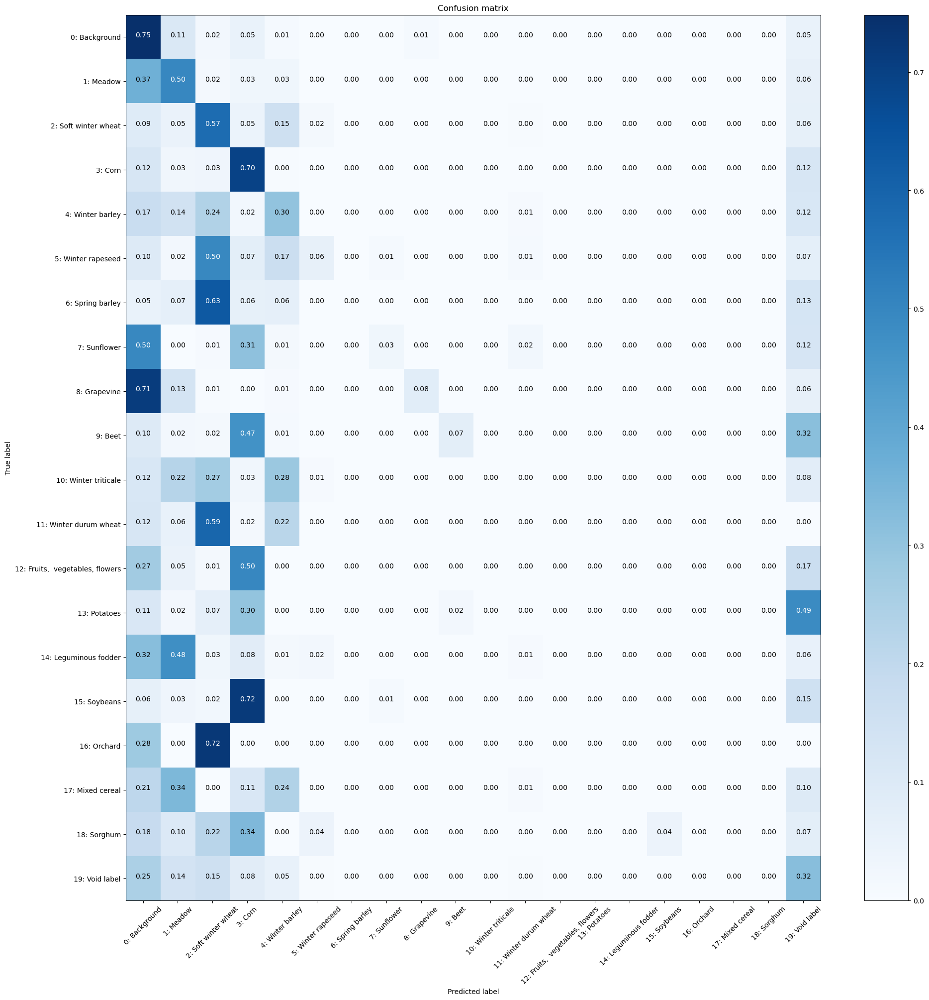

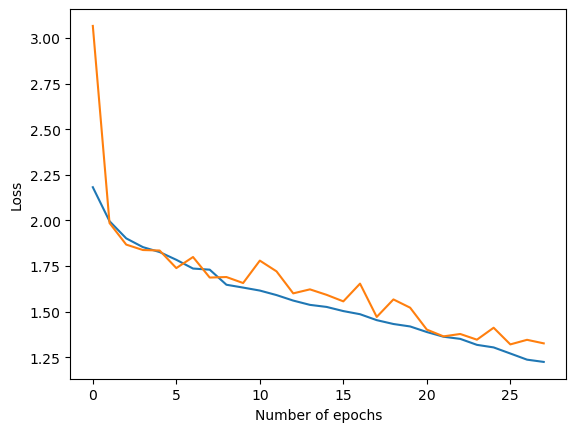

Checking accuracy on validation/test set
Got 464870 / 819200 correct (56.75)
Loss=1.37
Iteration 0, loss = 1.3297
Checking accuracy on validation/test set
Got 465819 / 819200 correct (56.86)
Loss=1.37
Normalized confusion matrix


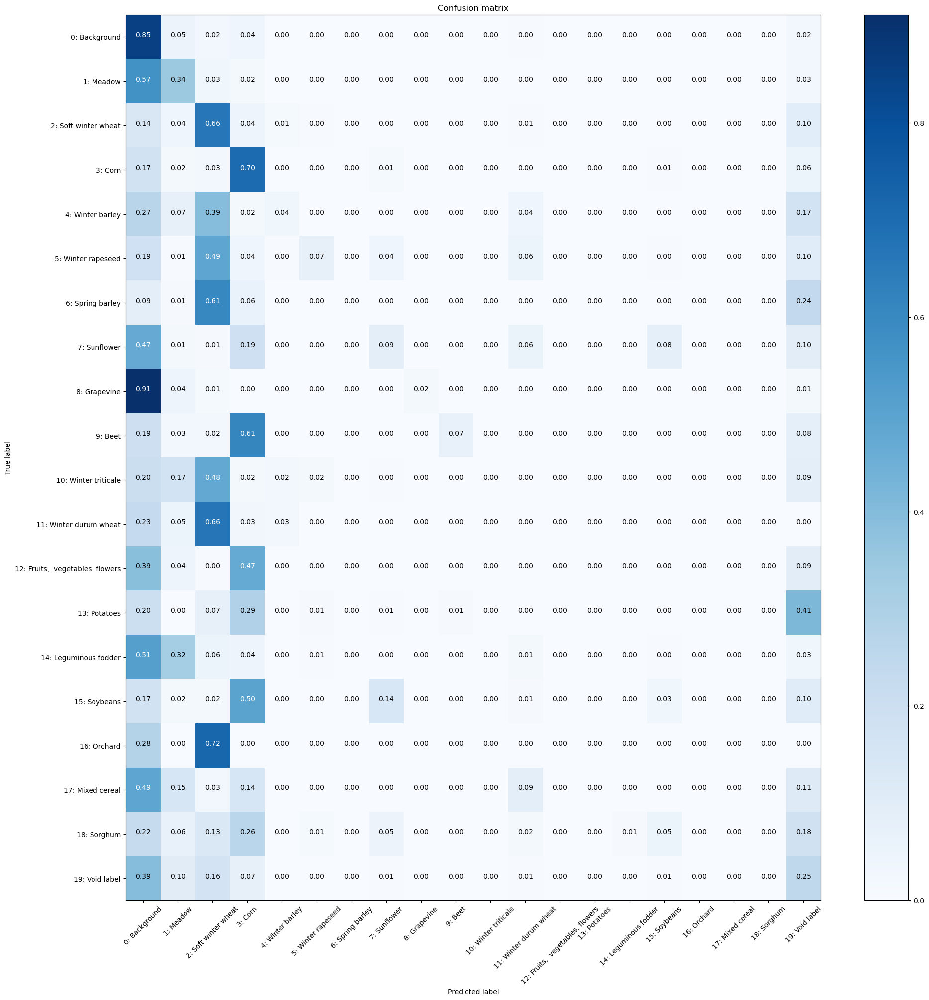

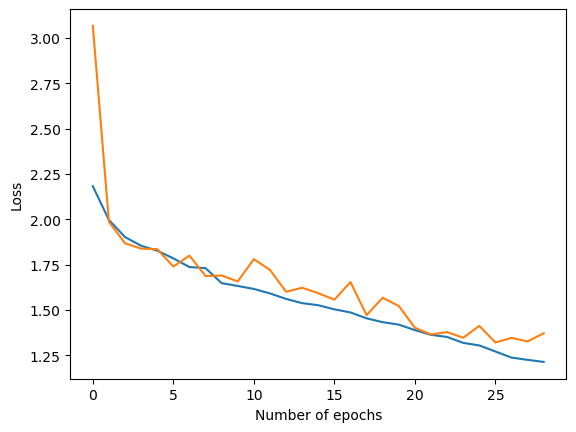

Checking accuracy on validation/test set
Got 466961 / 819200 correct (57.00)
Loss=1.28
Iteration 0, loss = 0.7416
Checking accuracy on validation/test set
Got 466520 / 819200 correct (56.95)
Loss=1.29
Normalized confusion matrix


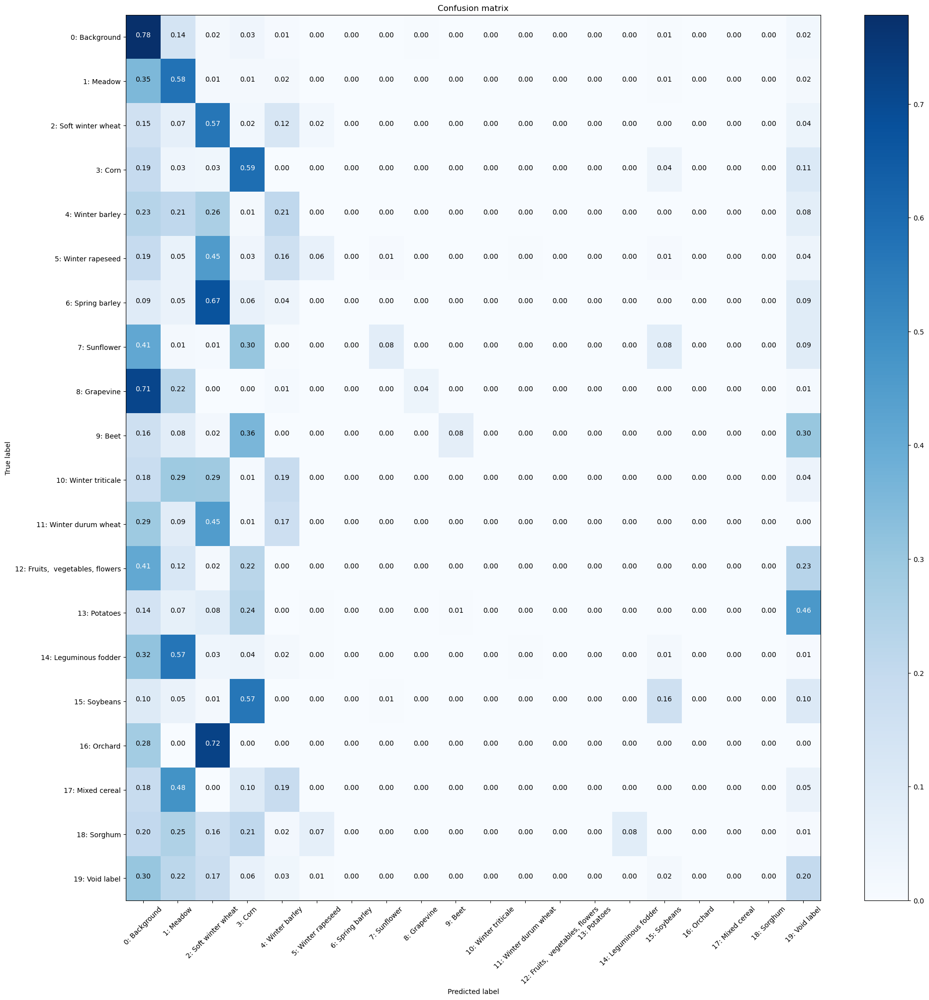

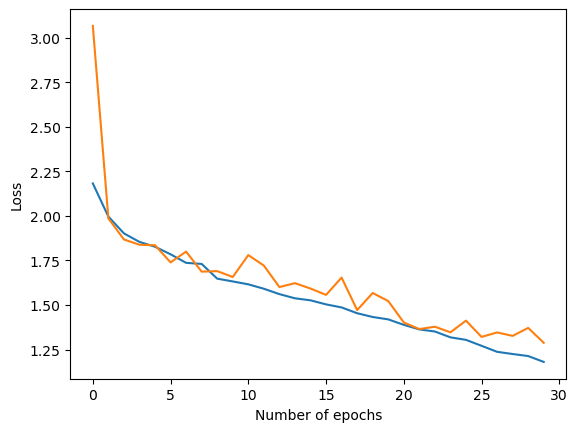

Checking accuracy on validation/test set
Got 463847 / 819200 correct (56.62)
Loss=1.33
Iteration 0, loss = 0.9345
Checking accuracy on validation/test set
Got 461775 / 819200 correct (56.37)
Loss=1.34
Normalized confusion matrix


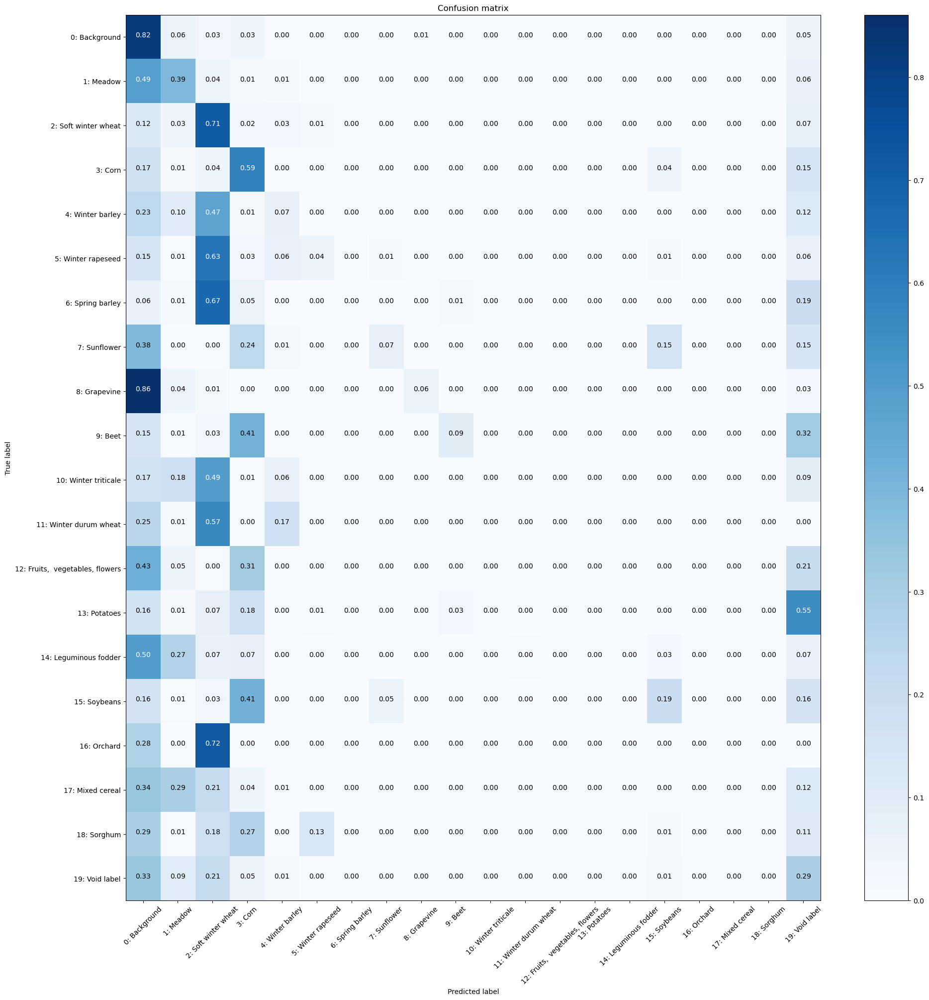

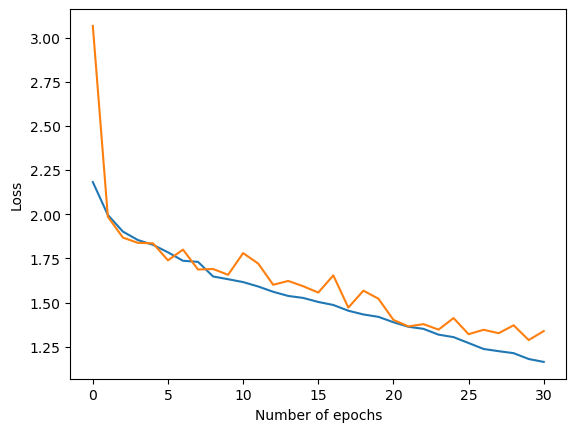

Checking accuracy on validation/test set
Got 461391 / 819200 correct (56.32)
Loss=1.33
Iteration 0, loss = 1.2983
Checking accuracy on validation/test set
Got 459892 / 819200 correct (56.14)
Loss=1.33
Normalized confusion matrix


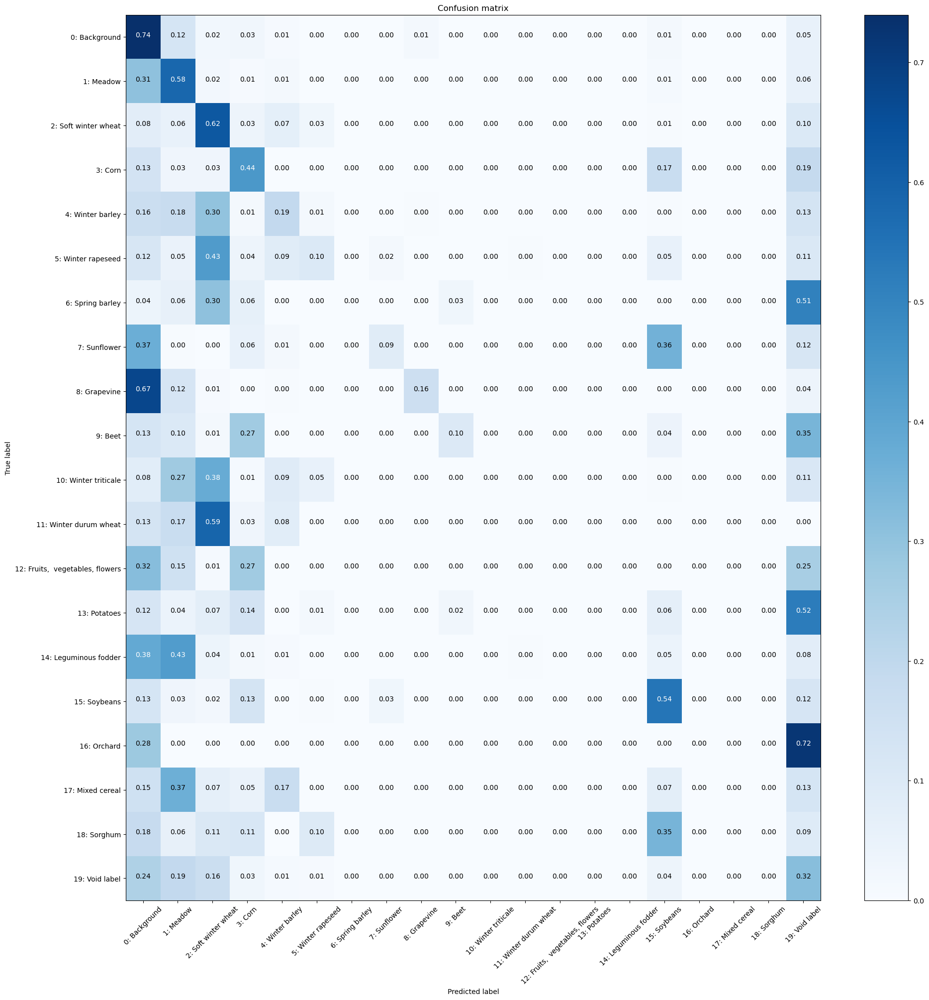

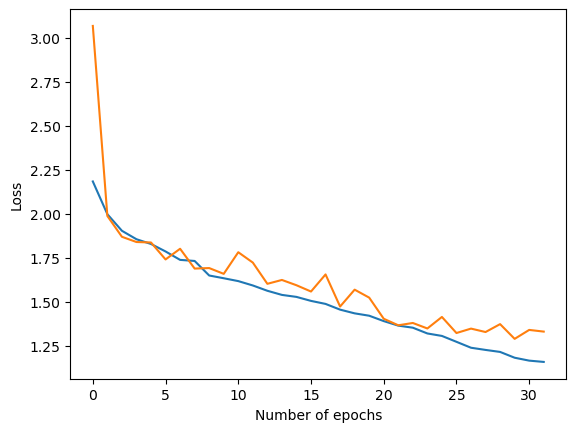

Checking accuracy on validation/test set
Got 478232 / 819200 correct (58.38)
Loss=1.27
Iteration 0, loss = 1.0375
Checking accuracy on validation/test set
Got 477158 / 819200 correct (58.25)
Loss=1.28
Normalized confusion matrix


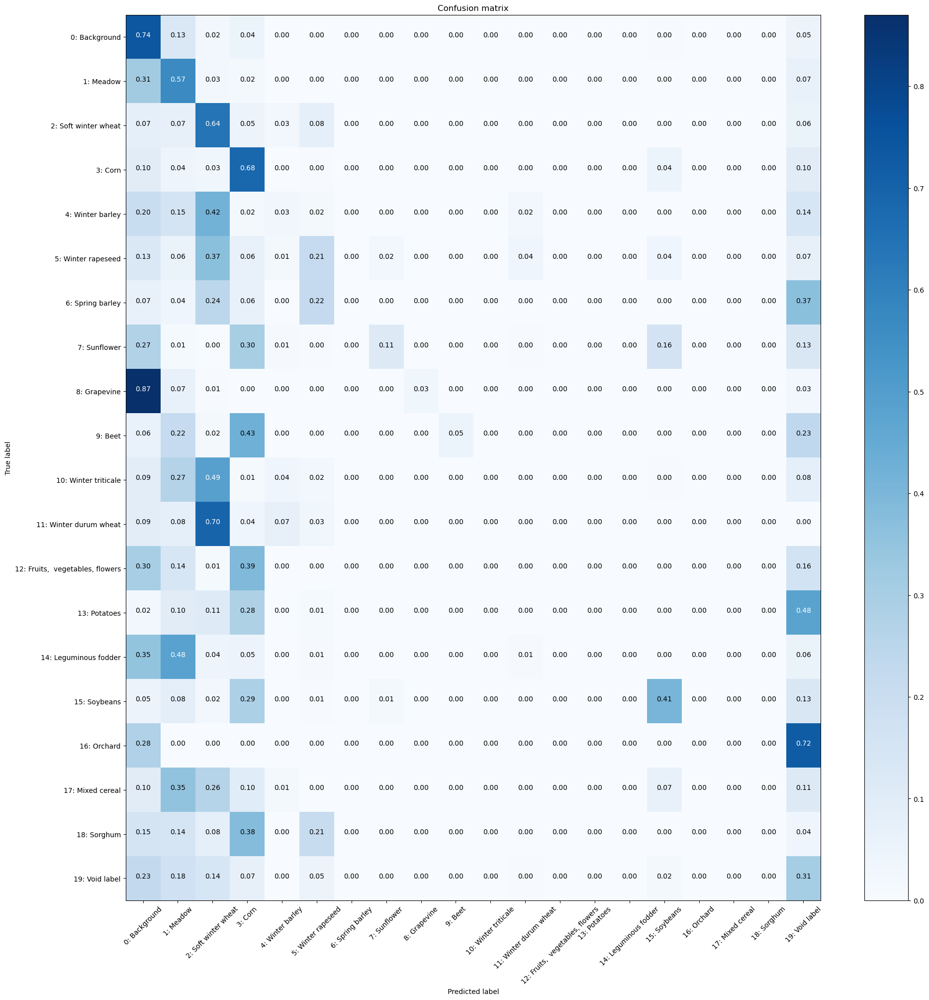

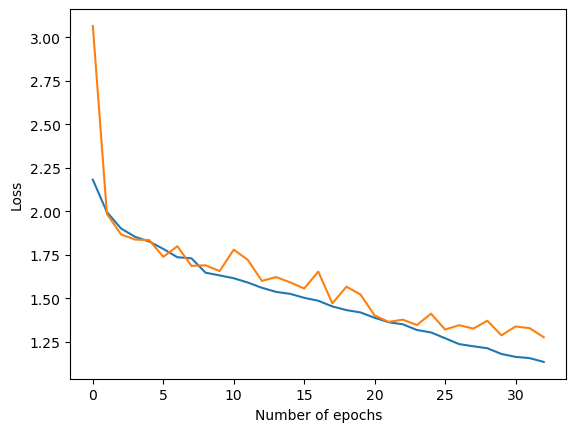

Checking accuracy on validation/test set
Got 481231 / 819200 correct (58.74)
Loss=1.30
Iteration 0, loss = 1.0689
Checking accuracy on validation/test set
Got 483641 / 819200 correct (59.04)
Loss=1.29
Normalized confusion matrix


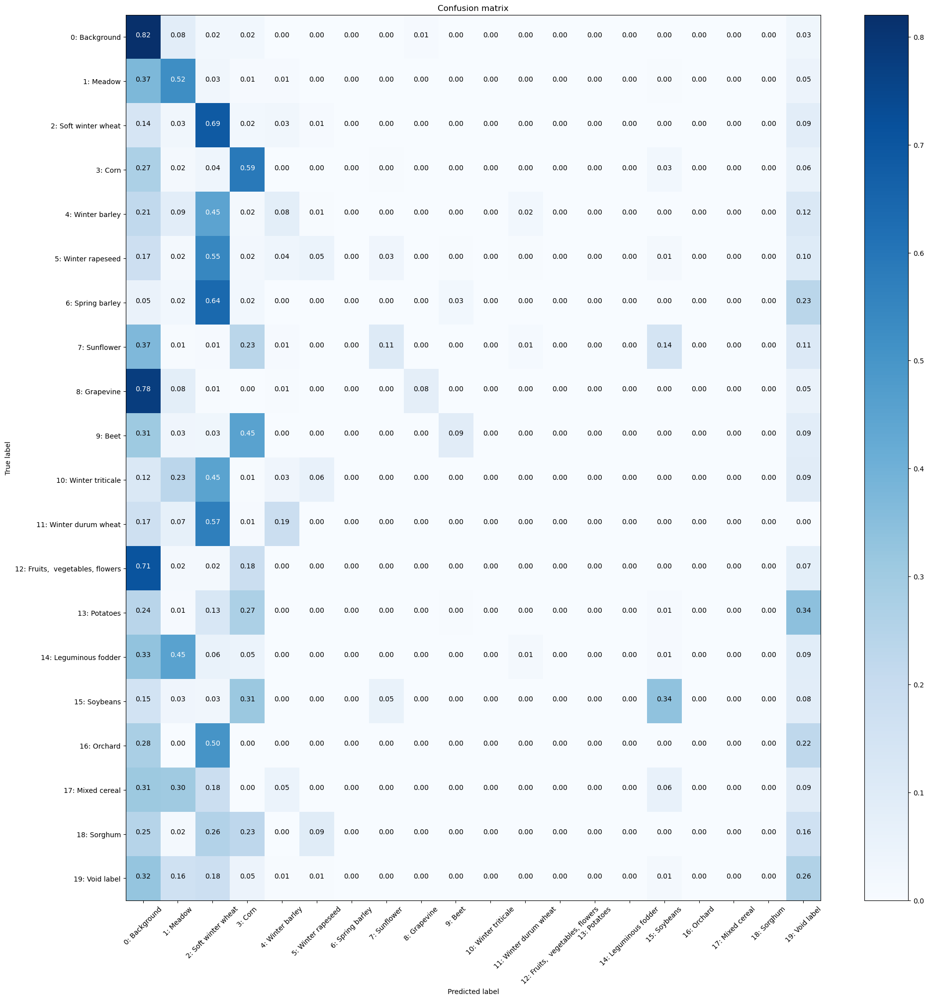

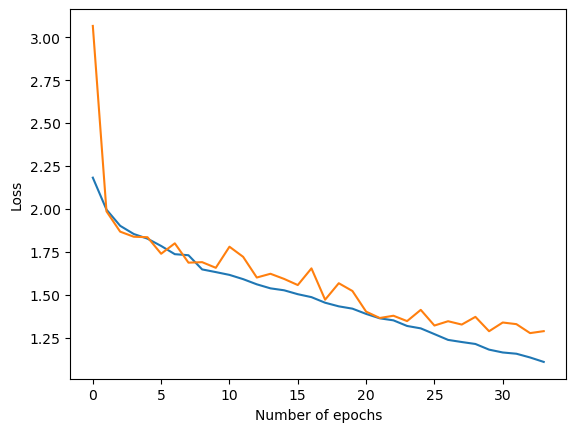

Checking accuracy on validation/test set
Got 455608 / 819200 correct (55.62)
Loss=1.41
Iteration 0, loss = 0.8053
Checking accuracy on validation/test set
Got 461994 / 819200 correct (56.40)
Loss=1.40
Normalized confusion matrix


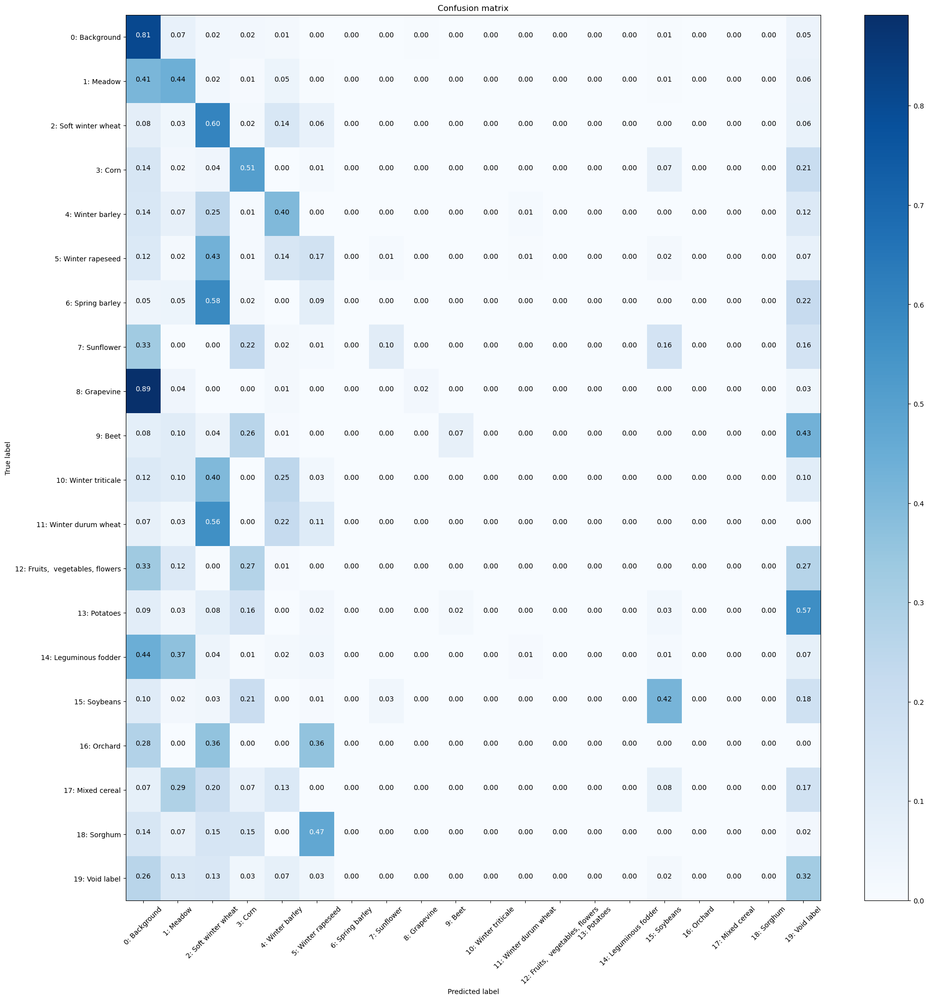

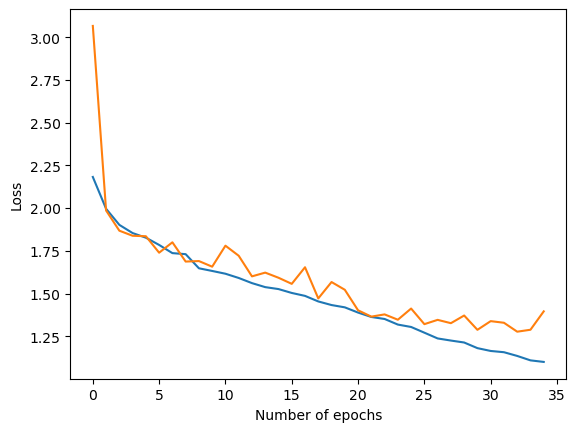

Checking accuracy on validation/test set
Got 475775 / 819200 correct (58.08)
Loss=1.27
Iteration 0, loss = 0.5149
Checking accuracy on validation/test set
Got 475643 / 819200 correct (58.06)
Loss=1.27
Normalized confusion matrix


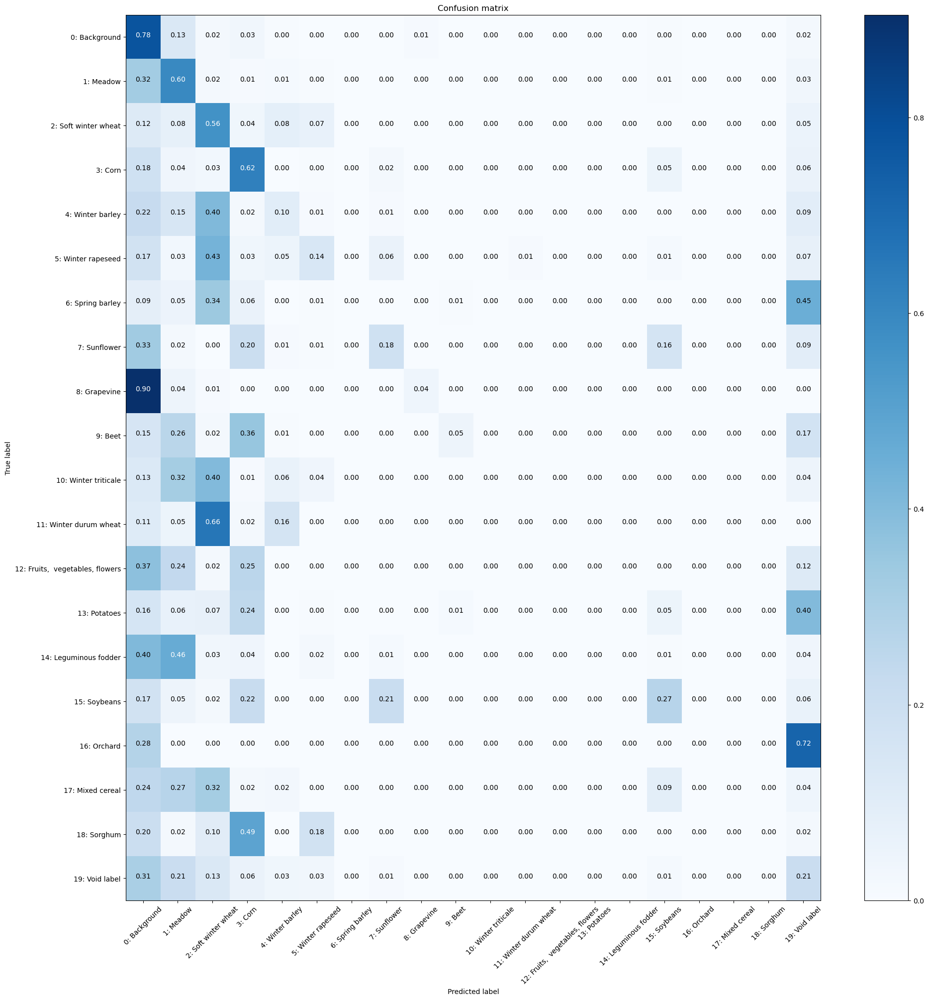

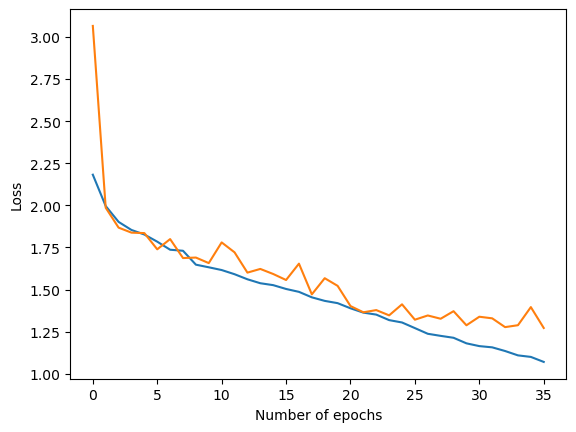

Checking accuracy on validation/test set
Got 481122 / 819200 correct (58.73)
Loss=1.27
Iteration 0, loss = 0.8149
Checking accuracy on validation/test set
Got 482355 / 819200 correct (58.88)
Loss=1.28
Normalized confusion matrix


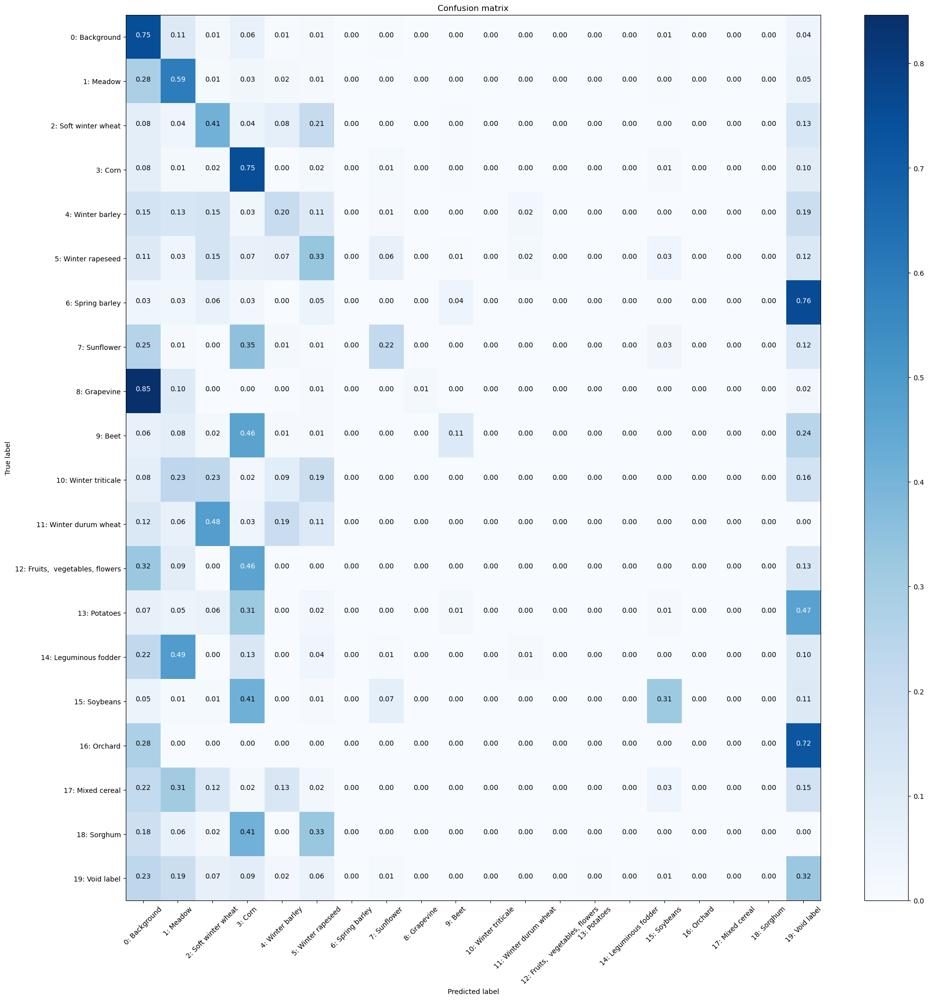

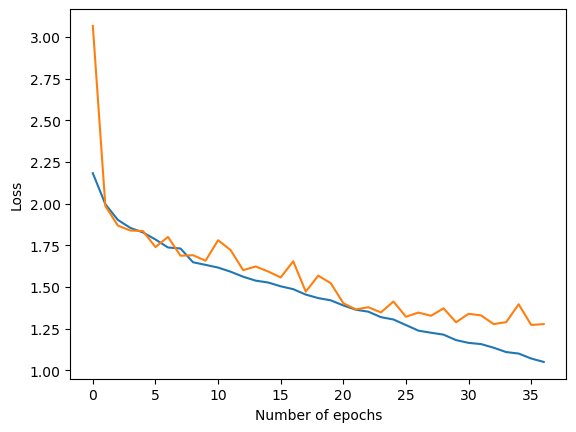

Checking accuracy on validation/test set
Got 470886 / 819200 correct (57.48)
Loss=1.32
Iteration 0, loss = 0.9798
Checking accuracy on validation/test set
Got 473543 / 819200 correct (57.81)
Loss=1.31
Normalized confusion matrix


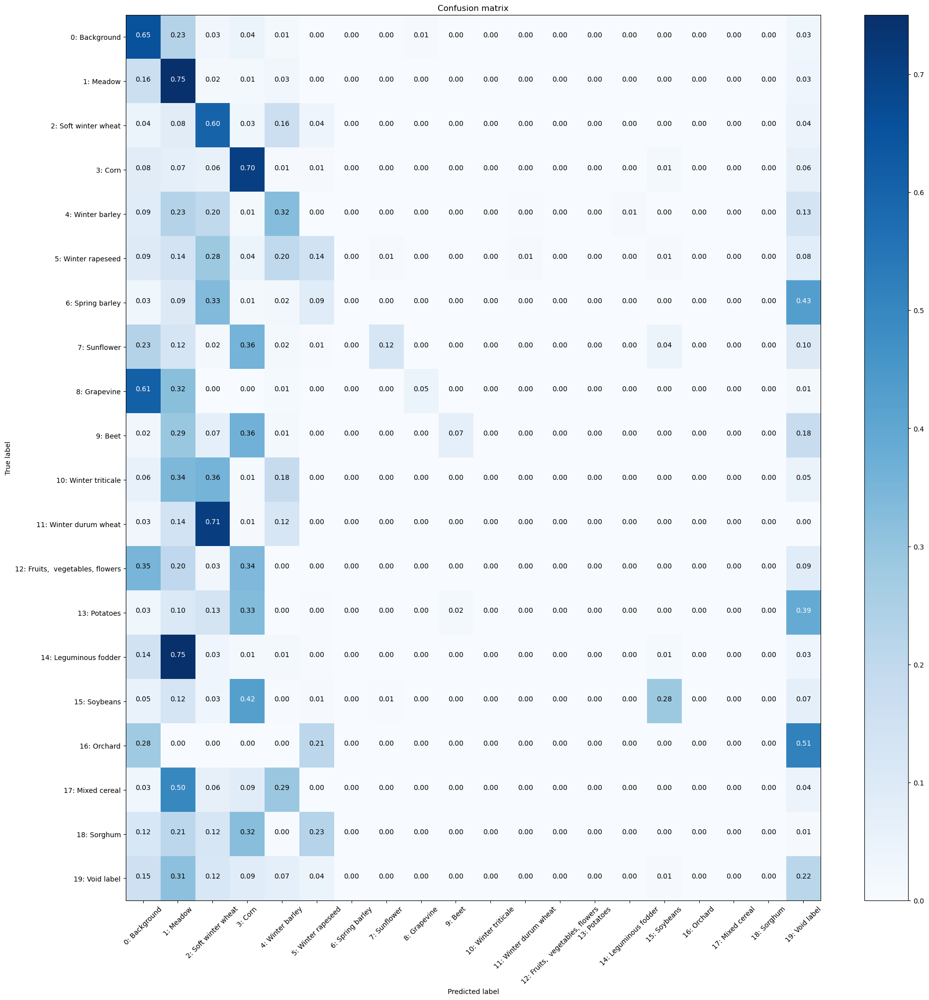

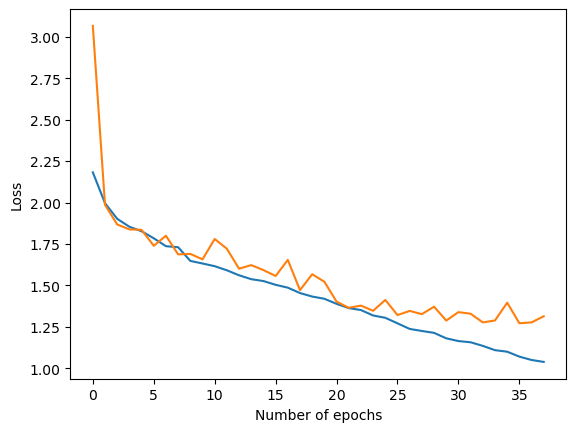

Checking accuracy on validation/test set
Got 480695 / 819200 correct (58.68)
Loss=1.30
Iteration 0, loss = 1.4691
Checking accuracy on validation/test set
Got 482475 / 819200 correct (58.90)
Loss=1.29
Normalized confusion matrix


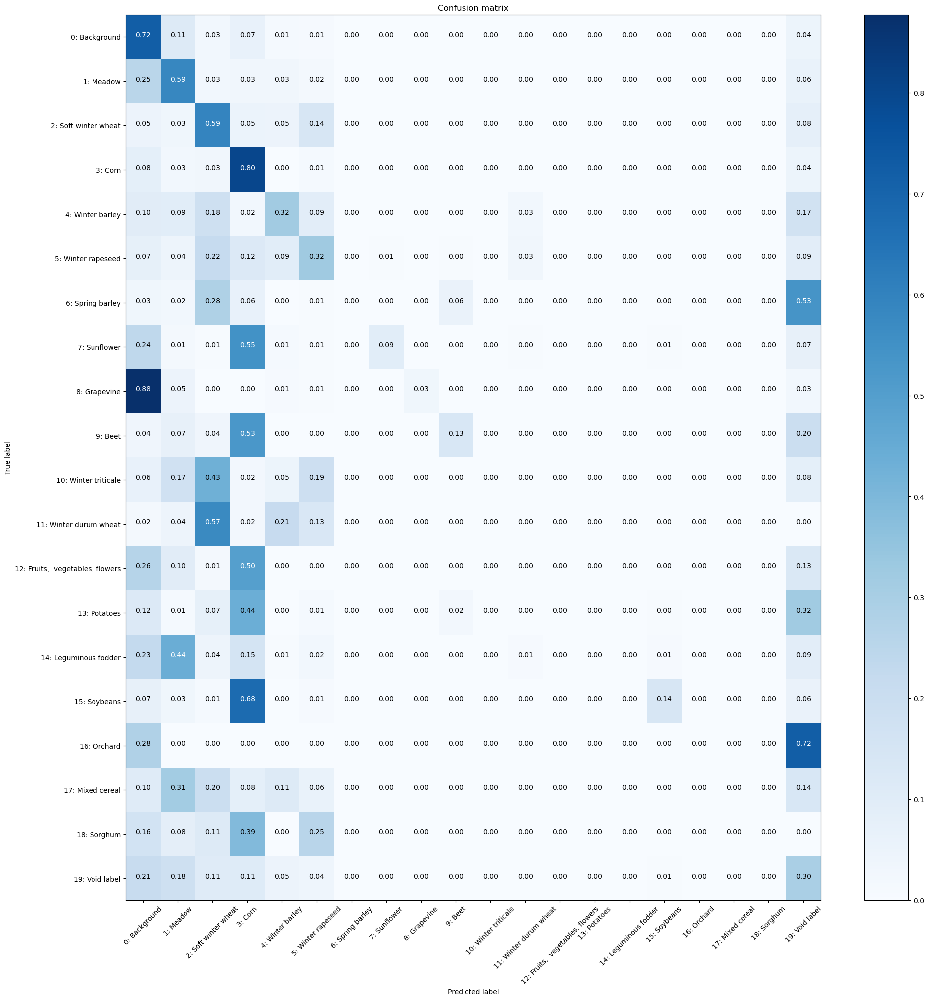

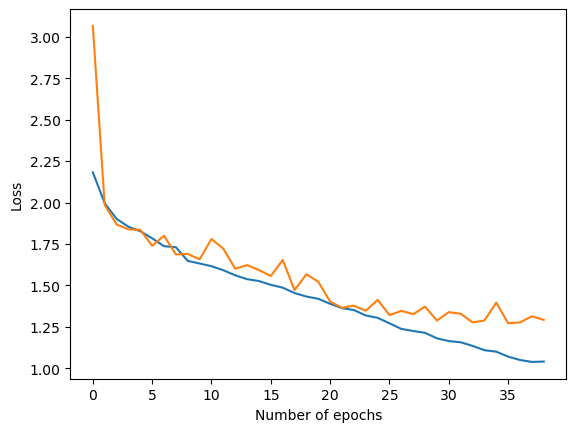

Checking accuracy on validation/test set
Got 477357 / 819200 correct (58.27)
Loss=1.31
Iteration 0, loss = 1.1266
Checking accuracy on validation/test set
Got 475829 / 819200 correct (58.08)
Loss=1.32
Normalized confusion matrix


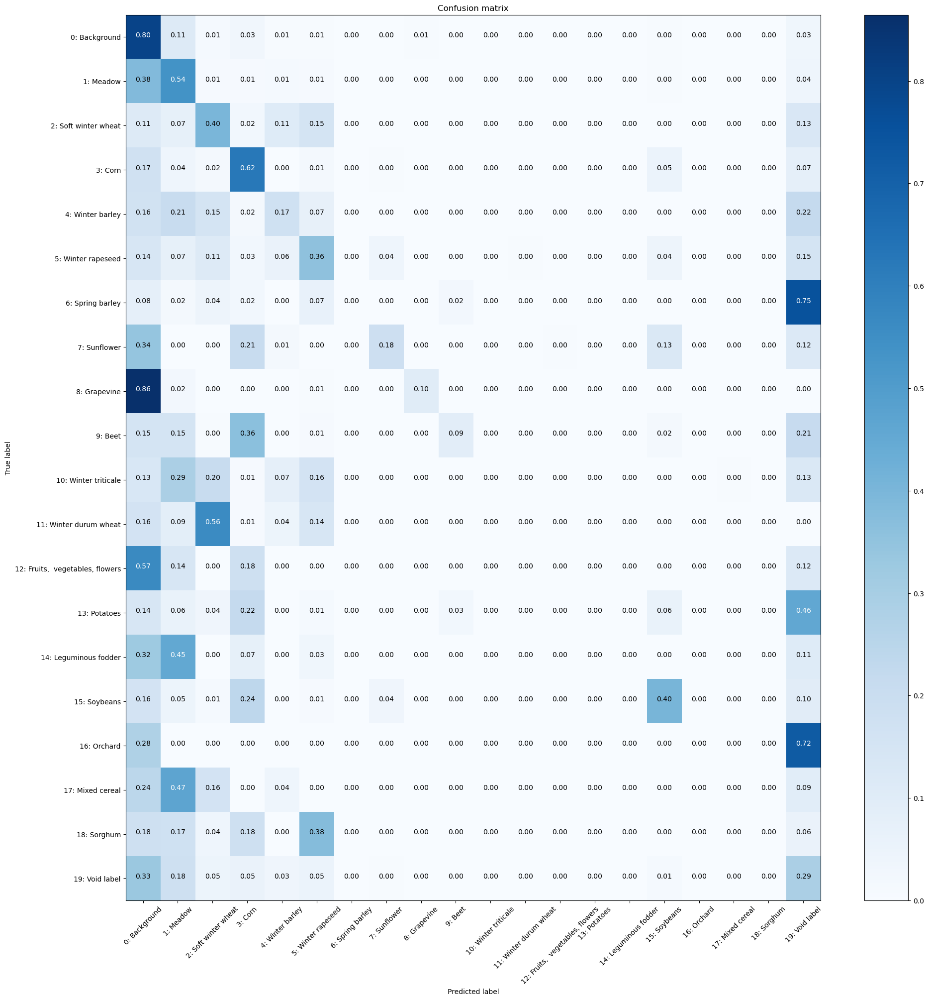

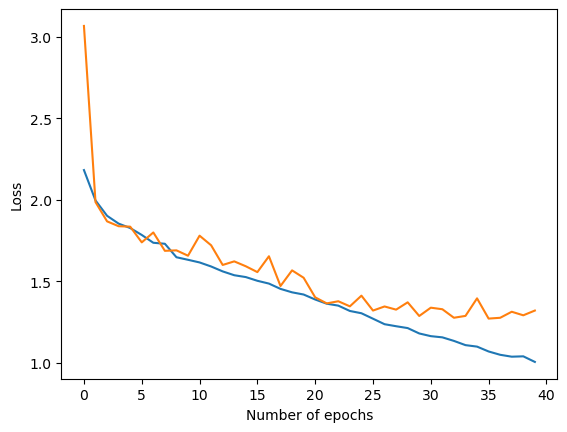

Checking accuracy on validation/test set
Got 491127 / 819200 correct (59.95)
Loss=1.28
Iteration 0, loss = 1.3477
Checking accuracy on validation/test set
Got 490340 / 819200 correct (59.86)
Loss=1.29
Normalized confusion matrix


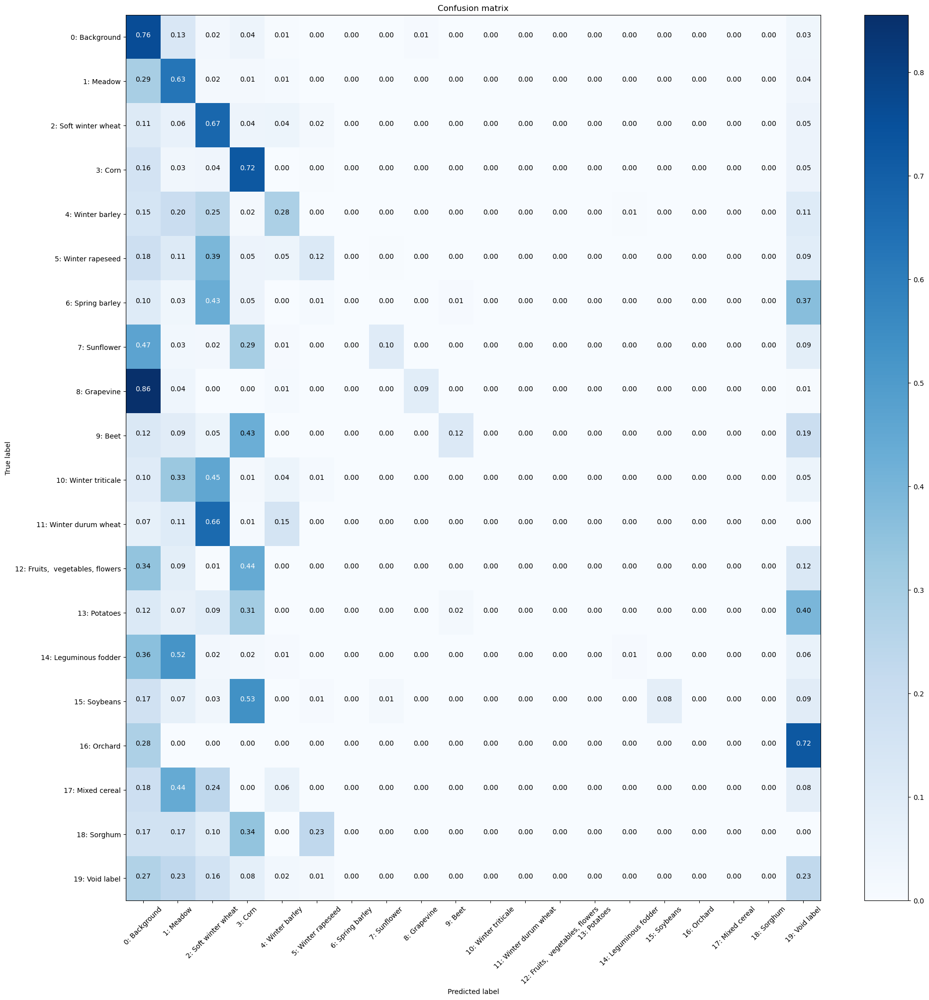

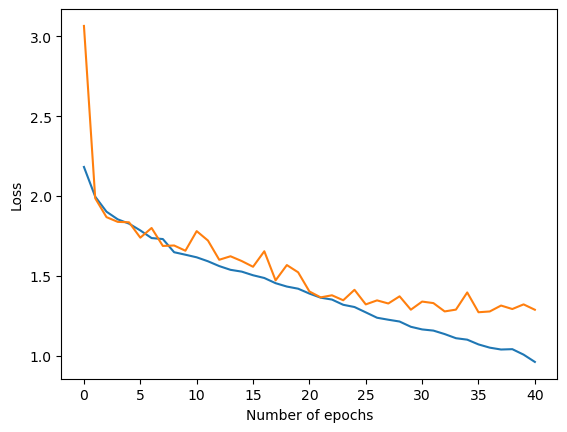

Checking accuracy on validation/test set
Got 484592 / 819200 correct (59.15)
Loss=1.29
Iteration 0, loss = 0.6641
Checking accuracy on validation/test set
Got 482753 / 819200 correct (58.93)
Loss=1.29
Normalized confusion matrix


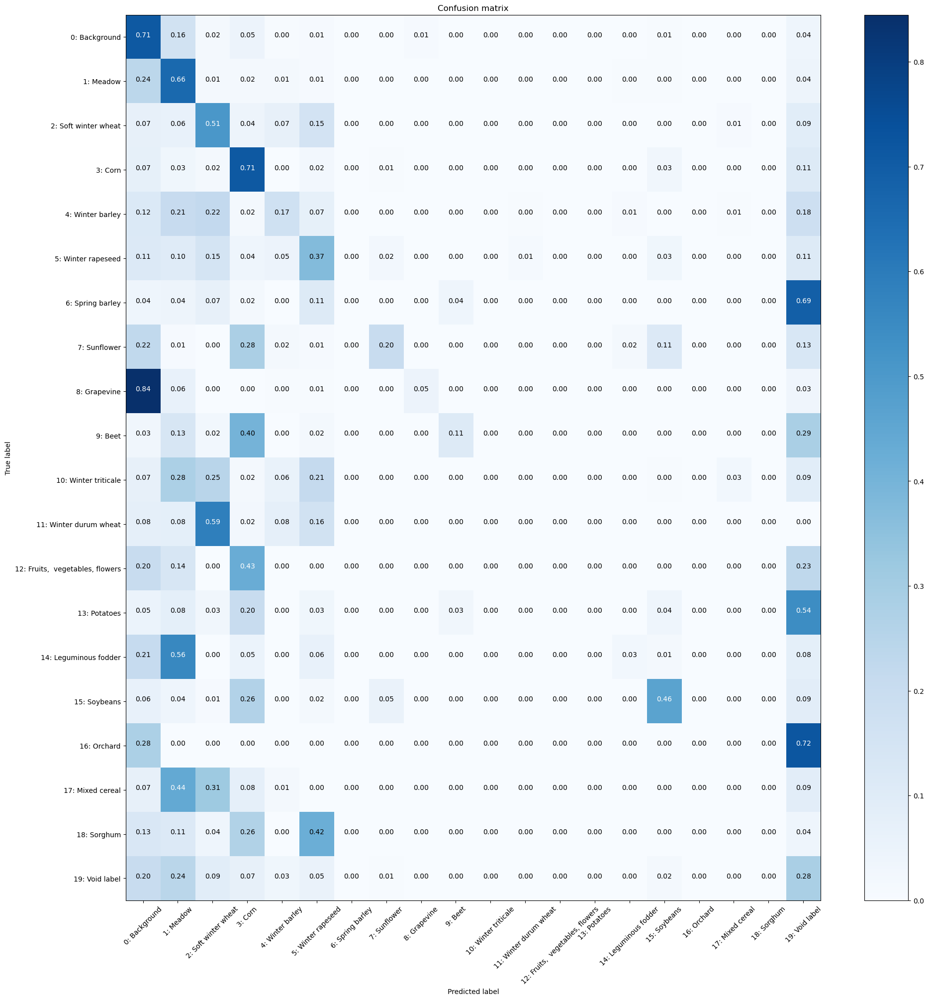

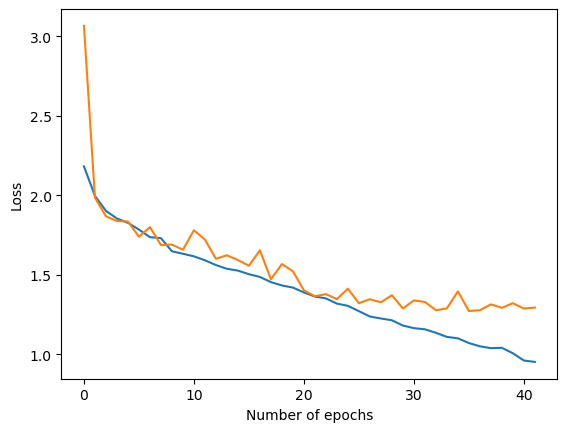

Checking accuracy on validation/test set
Got 487650 / 819200 correct (59.53)
Loss=1.37
Iteration 0, loss = 1.0131
Checking accuracy on validation/test set
Got 487913 / 819200 correct (59.56)
Loss=1.36
Normalized confusion matrix


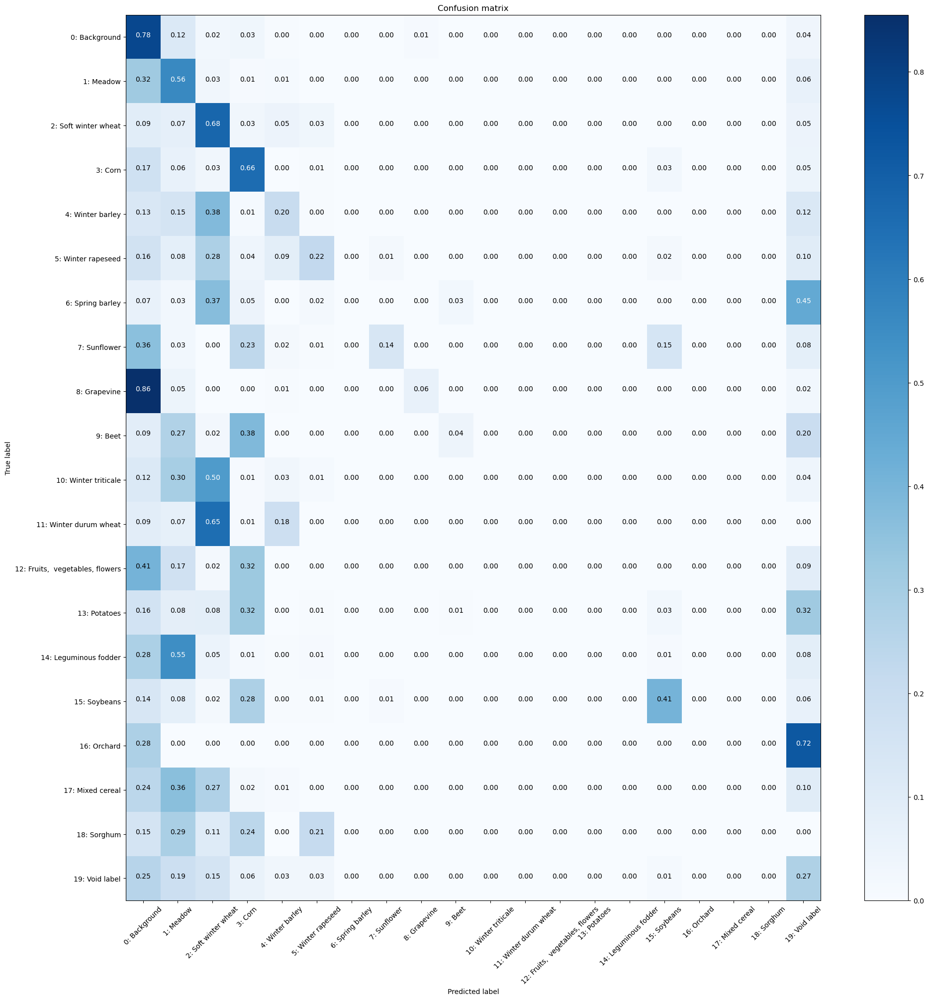

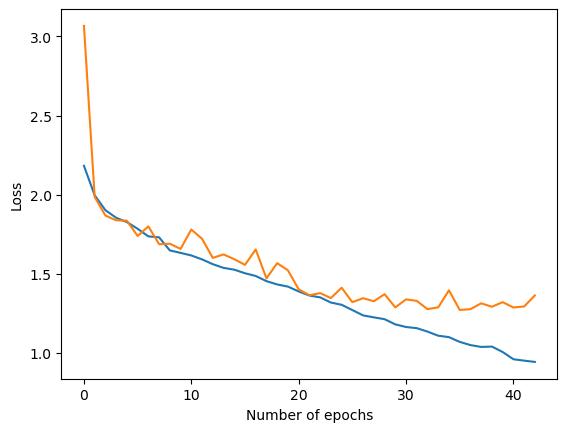

Checking accuracy on validation/test set
Got 496124 / 819200 correct (60.56)
Loss=1.27
Iteration 0, loss = 0.9600
Checking accuracy on validation/test set
Got 494763 / 819200 correct (60.40)
Loss=1.28
Normalized confusion matrix


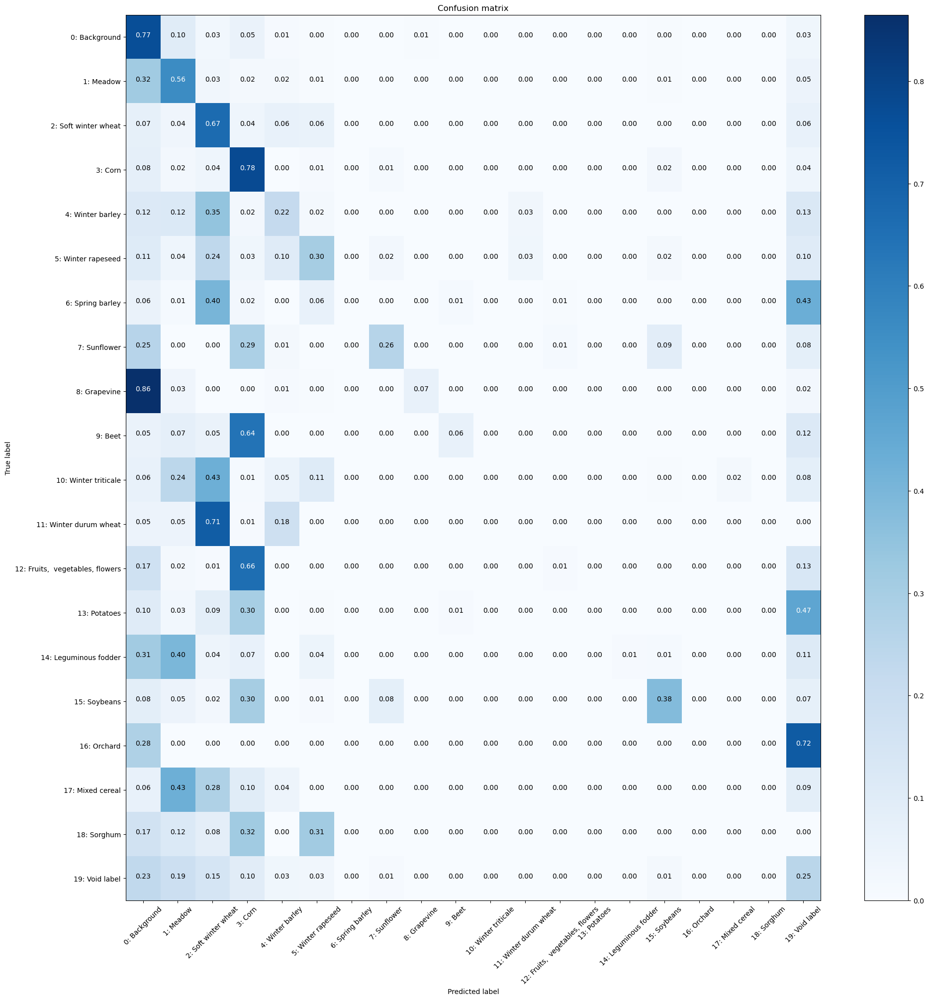

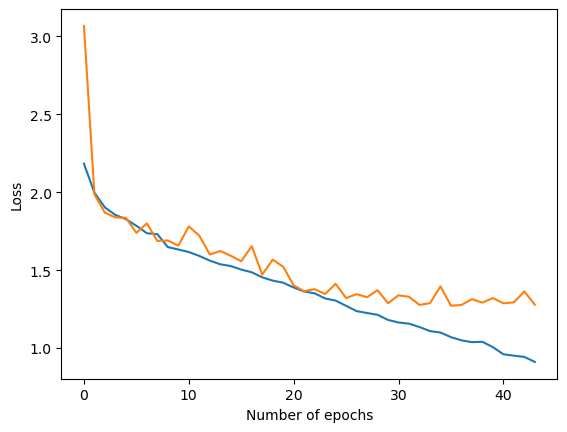

Checking accuracy on validation/test set
Got 489053 / 819200 correct (59.70)
Loss=1.33
Iteration 0, loss = 1.2490
Checking accuracy on validation/test set
Got 490668 / 819200 correct (59.90)
Loss=1.32
Normalized confusion matrix


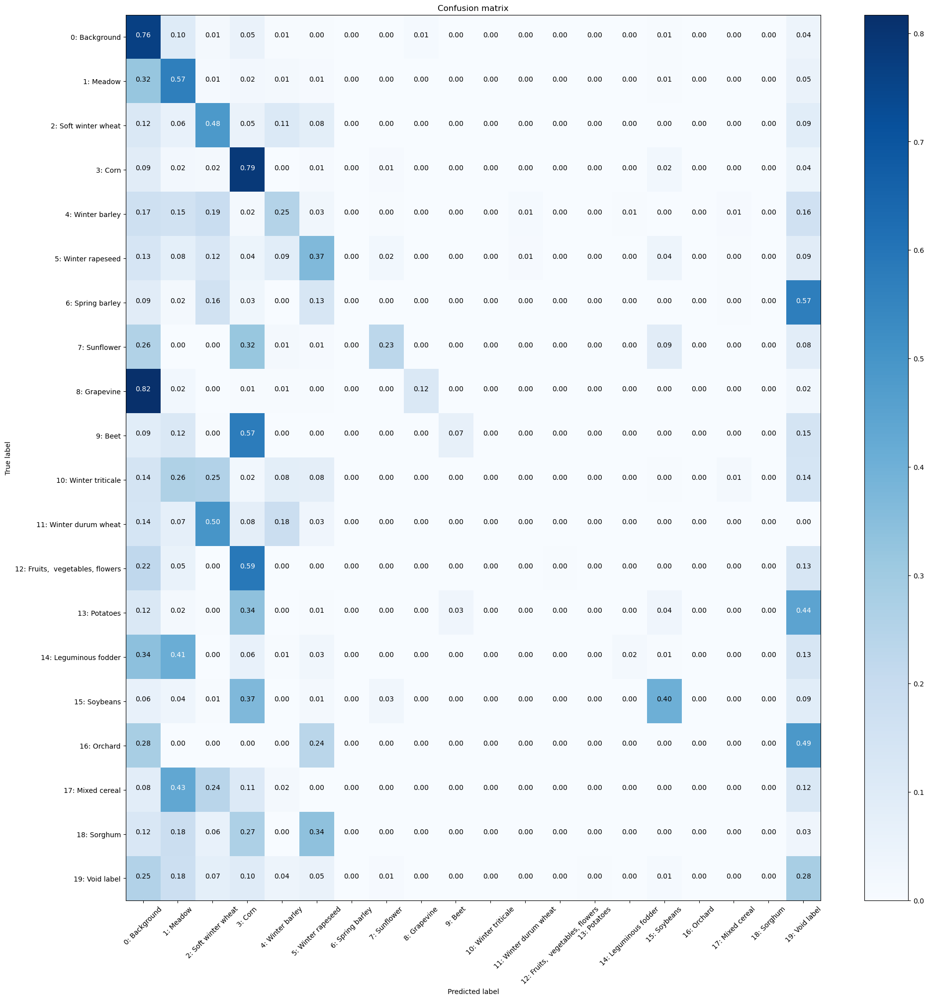

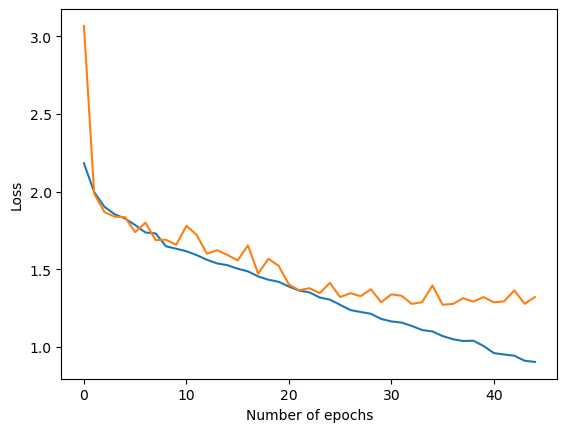

Checking accuracy on validation/test set
Got 490946 / 819200 correct (59.93)
Loss=1.37
Iteration 0, loss = 0.8225
Checking accuracy on validation/test set
Got 490569 / 819200 correct (59.88)
Loss=1.36
Normalized confusion matrix


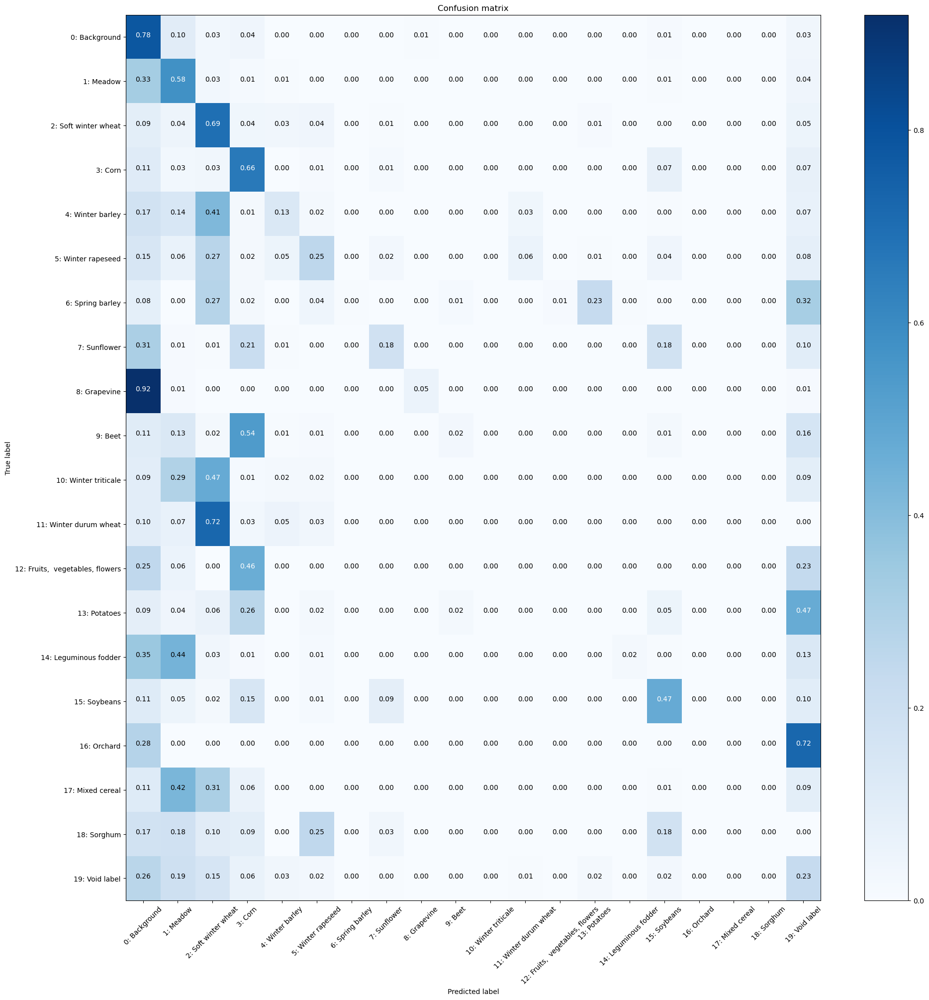

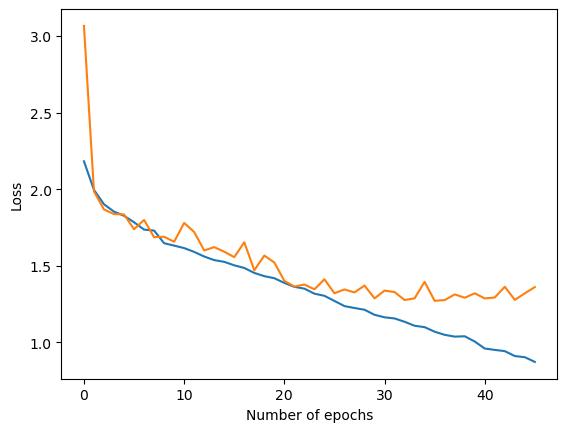

Checking accuracy on validation/test set
Got 483669 / 819200 correct (59.04)
Loss=1.36
Checking accuracy on validation/test set
Got 474882 / 819200 correct (57.97)
Loss=1.37


/tmp/ipykernel_29641/2517505415.py:36: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


Normalized confusion matrix


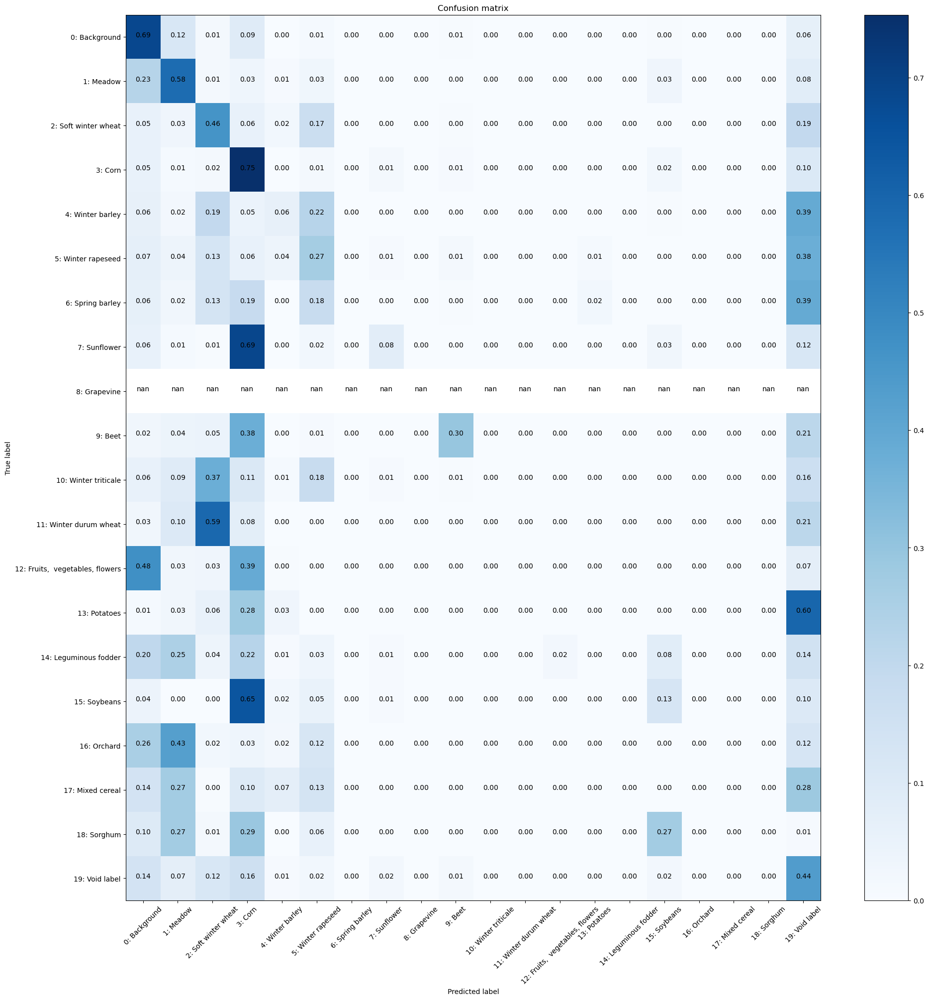

In [25]:
##############################################################
# - - - WRITE YOUR CODE HERE - - -
##############################################################
lstm_hidden_units = 512
learning_rate = 1e-4

# Training phase
model = LSTMSegNet(10, lstm_hidden_units, 20)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
training_loop_early_stopping(model, optimizer, epochs=100, stop_epochs=10, device = torch.device('cuda'))

# Test phase
acc, mean_loss, cm = eval_model_cm(PASTIS_test_dataloader, model)

**Visualization of semantic segmentation maps for the test set**


---
### [EXERCISE 14]
---

Make use of the PASTIS test subset data loader and the trained model obtained to visualize some semantic segmentation maps.



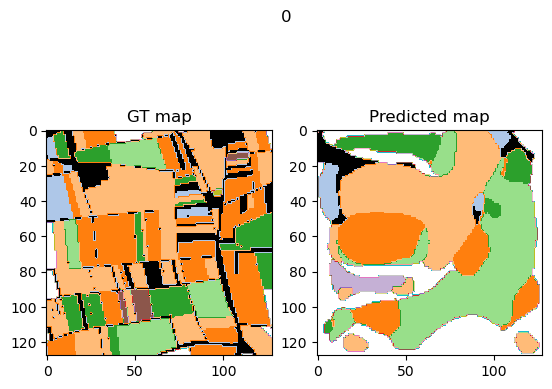

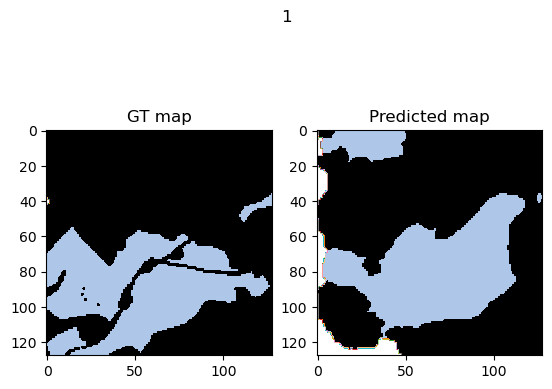

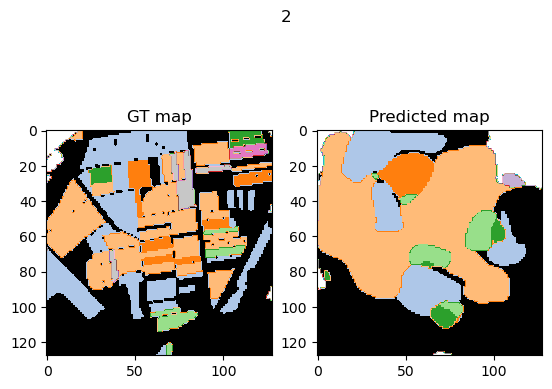

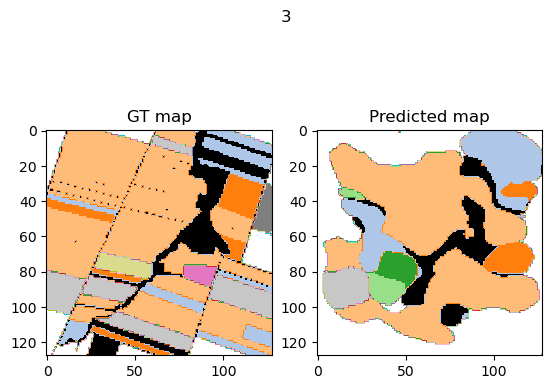

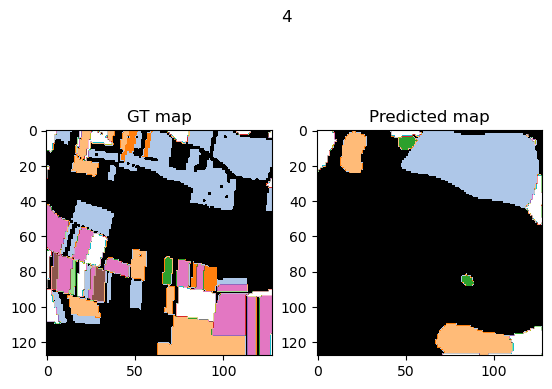

...

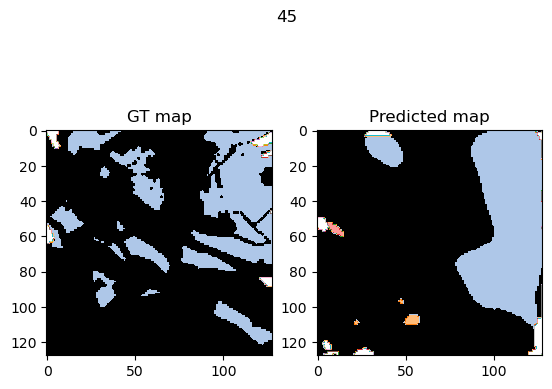

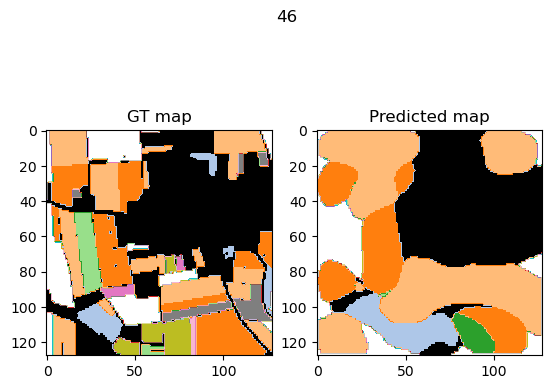

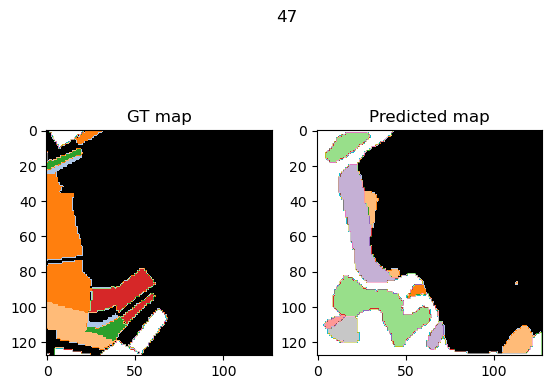

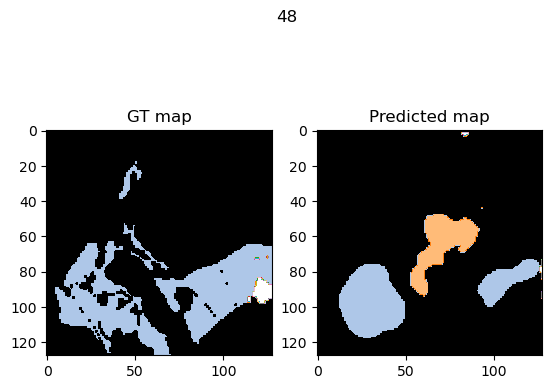

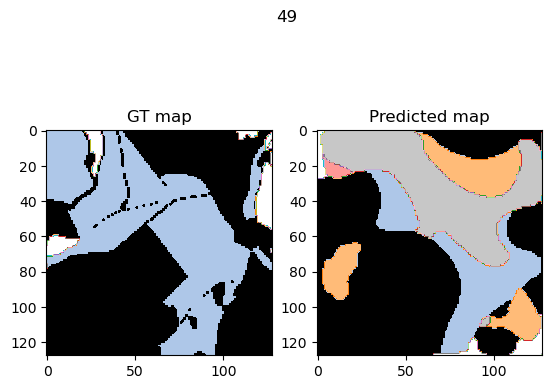

In [26]:
PASTIS_test_dataloader = DataLoader(PASTIS_test, batch_size=1, shuffle=False)

with torch.no_grad():
  for t, (data, dates, target) in enumerate(PASTIS_test_dataloader):
      data = data.to(device=torch.device('cuda'), dtype=torch.float32)  # move to device, e.g. GPU
      target = target.to(device=torch.device('cuda'), dtype=torch.long)
      scores = model(data)
      _, preds = scores.max(1)
      plt.figure()
      plt.subplot(1,2,1)
      plt.imshow(target[0].cpu().numpy(), cmap=PASTIS_colormap)
      plt.title('GT map')
      plt.subplot(1,2,2)
      plt.imshow(preds[0].cpu().numpy(), cmap=PASTIS_colormap)
      plt.title('Predicted map')
      plt.suptitle(t)
      plt.show()

## **Model improvement**


Repeat the previous exercises trying to improve the performance of the implemented models. Some ideas:

- Try to increase the complexity of the architectures, increasing the number of hidden layers and/or hidden units per layer.
- Try using Batch Normalization 2D layers in between the convolutional layers.
- Try using regularization over weights (L1, L2) or Dropout.
- Study how data is distributed over classes and, in case of imbalanced classes, use weights to control the contribution of each pixel/sample to the loss function.
- Review this interesting blog post:
[37 reasons why your neural network is not working](https://blog.slavv.com/37-reasons-why-your-neural-network-is-not-working-4020854bd607)